In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import re
from scipy.io import loadmat
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.ensemble import GradientBoostingRegressor
from lightgbm import LGBMRegressor



# PART 1 - EDA, Data Cleaning, Data Preprocessing, Feature Engineering, Statistical Analysis & Statistical Tests



## First step is to decide which cells we will be using, as there are 10 cells and a total of 250 gigbyte of data, we will be using the compressed .mat versions which consists of 6.7% of the 249 Gb approximately coming down to 25 GB. Each cell has approximately 10-30 GB of data decompressed so we can not do our tests on all of the cells. From these 10 cells some of them did not go through all the cycling or they had issues in the diagnistic tests so we will first find which cells are useable for us.

First step is to import all the compressed data files for each of the cells in each cycle decompress it, analyse the data and decide on which cells will be used and convert the data of those cells to .csv to be used later.

In [2]:
# Initialize dictionary to store data for each cell
cell_combined_data = {}

# Add file paths for each cell manually
file_paths = {
    'G1': [
        'Cycling/G1/Cycling1G1.mat',
        'Cycling/G1/Cycling2G1.mat',
        'Cycling/G1/Cycling3G1.mat',
        'Cycling/G1/Cycling4G1.mat',
        'Cycling/G1/Cycling5G1.mat',
        'Cycling/G1/Cycling6G1.mat',
        'Cycling/G1/Cycling7G1.mat',
        'Cycling/G1/Cycling8G1.mat',
        'Cycling/G1/Cycling9G1.mat',
        'Cycling/G1/Cycling10G1.mat',        
    ],
    'V4': [
        'Cycling/V4/Cycling1V4.mat',
        'Cycling/V4/Cycling2V4.mat',
        'Cycling/V4/Cycling3V4.mat',
        'Cycling/V4/Cycling4V4.mat',
        'Cycling/V4/Cycling5V4.mat',
        'Cycling/V4/Cycling6V4.mat',
        'Cycling/V4/Cycling7V4.mat',
        'Cycling/V4/Cycling8V4.mat',
        'Cycling/V4/Cycling9V4.mat',
        'Cycling/V4/Cycling10V4.mat',
    ],
    'V5': [
        'Cycling/V5/Cycling1V5.mat',
        'Cycling/V5/Cycling2V5.mat',
        'Cycling/V5/Cycling3V5.mat',
    ], 
    'W3': [
        'Cycling/W3/Cycling1W3.mat',
        'Cycling/W3/Cycling2W3.mat',
    ],
    'W4': [
        'Cycling/W4/Cycling1W4.mat',
        'Cycling/W4/Cycling2W4.mat',
        'Cycling/W4/Cycling3W4.mat',
        'Cycling/W4/Cycling4W4.mat',
        'Cycling/W4/Cycling5W4.mat',
        'Cycling/W4/Cycling6W4.mat',
        'Cycling/W4/Cycling7W4.mat',
    ],
    'W5': [
        'Cycling/W5/Cycling1W5.mat',
        'Cycling/W5/Cycling2W5.mat',
        'Cycling/W5/Cycling3W5.mat',
        'Cycling/W5/Cycling4W5.mat',
        'Cycling/W5/Cycling5W5.mat',
        'Cycling/W5/Cycling6W5.mat',
        'Cycling/W5/Cycling7W5.mat',
        'Cycling/W5/Cycling8W5.mat',
        'Cycling/W5/Cycling9W5.mat',
        'Cycling/W5/Cycling10W5.mat',
        'Cycling/W5/Cycling11W5.mat',
        'Cycling/W5/Cycling12W5.mat',
        'Cycling/W5/Cycling13W5.mat',
        'Cycling/W5/Cycling14W5.mat',
    ], 
    'W7': [
        'Cycling/W7/Cycling1W7.mat',
        'Cycling/W7/Cycling2W7.mat',
        'Cycling/W7/Cycling3W7.mat',
        'Cycling/W7/Cycling4W7.mat',
    ], 
    'W8': [
        'Cycling/W8/Cycling1W8.mat',
        'Cycling/W8/Cycling2W8.mat',
        'Cycling/W8/Cycling3W8.mat',
        'Cycling/W8/Cycling4W8.mat',
        'Cycling/W8/Cycling5W8.mat',
        'Cycling/W8/Cycling6W8.mat',
        'Cycling/W8/Cycling7W8.mat',
        'Cycling/W8/Cycling8W8.mat',
        'Cycling/W8/Cycling9W8.mat',
        'Cycling/W8/Cycling10W8.mat',
        'Cycling/W8/Cycling11W8.mat',
        'Cycling/W8/Cycling12W8.mat',
        'Cycling/W8/Cycling13W8.mat',
        'Cycling/W8/Cycling14W8.mat',
    ], 
    'W9': [
        'Cycling/W9/Cycling1W9.mat',
        'Cycling/W9/Cycling2W9.mat',
        'Cycling/W9/Cycling3W9.mat',
        'Cycling/W9/Cycling4W9.mat',
        'Cycling/W9/Cycling5W9.mat',
        'Cycling/W9/Cycling6W9.mat',
        'Cycling/W9/Cycling7W9.mat',
        'Cycling/W9/Cycling8W9.mat',
        'Cycling/W9/Cycling9W9.mat',
        'Cycling/W9/Cycling10W9.mat',
        'Cycling/W9/Cycling11W9.mat',
        'Cycling/W9/Cycling12W9.mat',
        'Cycling/W9/Cycling13W9.mat',
        'Cycling/W9/Cycling14W9.mat',
    ], 
    'W10': [
        'Cycling/W10/Cycling1W10.mat',
        'Cycling/W10/Cycling2W10.mat',
        'Cycling/W10/Cycling3W10.mat',
        'Cycling/W10/Cycling4W10.mat',
        'Cycling/W10/Cycling5W10.mat',
        'Cycling/W10/Cycling6W10.mat',
        'Cycling/W10/Cycling7W10.mat',
        'Cycling/W10/Cycling8W10.mat',
        'Cycling/W10/Cycling9W10.mat',
        'Cycling/W10/Cycling10W10.mat',
        'Cycling/W10/Cycling11W10.mat',
        'Cycling/W10/Cycling12W10.mat',
        'Cycling/W10/Cycling13W10.mat',
        'Cycling/W10/Cycling14W10.mat',
    ], 
    }

In [13]:

folder_name = 'G1'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

# Example visualization or save combined data
# Save combined data for further analysis (optional)
output_csv_path = f"{folder_name}_combined_data.csv"
combined_data.to_csv(output_csv_path, index=False)
print(f"Combined data for {folder_name} saved to {output_csv_path}.")

Processing folder: G1
Loading file: Cycling/G1/Cycling1G1.mat
Loaded and processed data for Cycling/G1/Cycling1G1.mat. Cycle index: 1
Loading file: Cycling/G1/Cycling2G1.mat
Loaded and processed data for Cycling/G1/Cycling2G1.mat. Cycle index: 2
Loading file: Cycling/G1/Cycling3G1.mat
Loaded and processed data for Cycling/G1/Cycling3G1.mat. Cycle index: 3
Loading file: Cycling/G1/Cycling4G1.mat
Loaded and processed data for Cycling/G1/Cycling4G1.mat. Cycle index: 4
Loading file: Cycling/G1/Cycling5G1.mat
Loaded and processed data for Cycling/G1/Cycling5G1.mat. Cycle index: 5
Loading file: Cycling/G1/Cycling6G1.mat
Loaded and processed data for Cycling/G1/Cycling6G1.mat. Cycle index: 6
Loading file: Cycling/G1/Cycling7G1.mat
Loaded and processed data for Cycling/G1/Cycling7G1.mat. Cycle index: 7
Loading file: Cycling/G1/Cycling8G1.mat
Loaded and processed data for Cycling/G1/Cycling8G1.mat. Cycle index: 8
Loading file: Cycling/G1/Cycling9G1.mat
Loaded and processed data for Cycling/G1/C

### Cell cycle analysis

In [116]:
G1_combined_data = pd.read_csv('G1_combined_data.csv')

In [22]:
G1_combined_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98804585 entries, 0 to 98804584
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          uint8  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(1), uint8(1)
memory usage: 4.5 GB


In [5]:
G1_combined_data.shape

(98804585, 7)

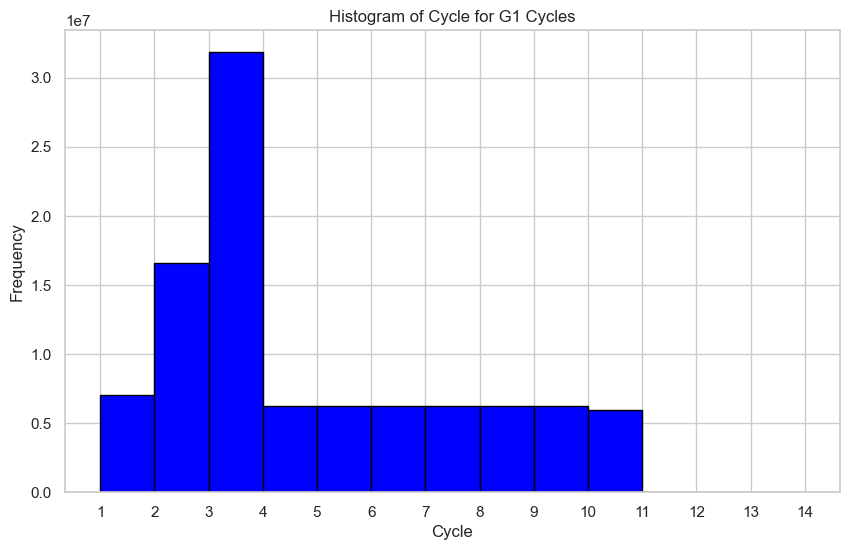

In [117]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(G1_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for G1 Cycles')
plt.show()


In [19]:
combined_data.columns[combined_data.isnull().any()]

Index([], dtype='object')

In [18]:
combined_data.isnull().sum()

Current               0
Voltage               0
Step_Index            0
Charge_Capacity       0
Discharge_Capacity    0
Time                  0
Cycle                 0
dtype: int64

In [ ]:
# Step 1: Remove voltage values below 3V
G1_filtered_data = G1_combined_data[G1_combined_data['Voltage'] >= 3]

In [114]:
# Step 2: Plot the filtered data
plt.figure(figsize=(10, 6))
for cycle in G1_filtered_data['Cycle'].unique():
    cycle_data = G1_filtered_data[G1_filtered_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (s)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for G1 Cycles (Voltage >= 3V)')
plt.legend()
plt.show()


NameError: name 'G1_filtered_data' is not defined

<Figure size 1000x600 with 0 Axes>

In [28]:
#Importing V4 cell data
folder_name = 'V4'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

# Example visualization or save combined data
# Save combined data for further analysis (optional)
output_csv_path = f"{folder_name}_combined_data.csv"
combined_data.to_csv(output_csv_path, index=False)
print(f"Combined data for {folder_name} saved to {output_csv_path}.")

V4_combined_data = combined_data

Processing folder: V4
Loading file: Cycling/V4/Cycling1V4.mat
Loaded and processed data for Cycling/V4/Cycling1V4.mat. Cycle index: 1
Loading file: Cycling/V4/Cycling2V4.mat
Loaded and processed data for Cycling/V4/Cycling2V4.mat. Cycle index: 2
Loading file: Cycling/V4/Cycling3V4.mat
Loaded and processed data for Cycling/V4/Cycling3V4.mat. Cycle index: 3
Loading file: Cycling/V4/Cycling4V4.mat
Loaded and processed data for Cycling/V4/Cycling4V4.mat. Cycle index: 4
Loading file: Cycling/V4/Cycling5V4.mat
Loaded and processed data for Cycling/V4/Cycling5V4.mat. Cycle index: 5
Loading file: Cycling/V4/Cycling6V4.mat
Loaded and processed data for Cycling/V4/Cycling6V4.mat. Cycle index: 6
Loading file: Cycling/V4/Cycling7V4.mat
Loaded and processed data for Cycling/V4/Cycling7V4.mat. Cycle index: 7
Loading file: Cycling/V4/Cycling8V4.mat
Loaded and processed data for Cycling/V4/Cycling8V4.mat. Cycle index: 8
Loading file: Cycling/V4/Cycling9V4.mat
Loaded and processed data for Cycling/V4/C

In [118]:
V4_combined_data = pd.read_csv('V4_combined_data.csv')

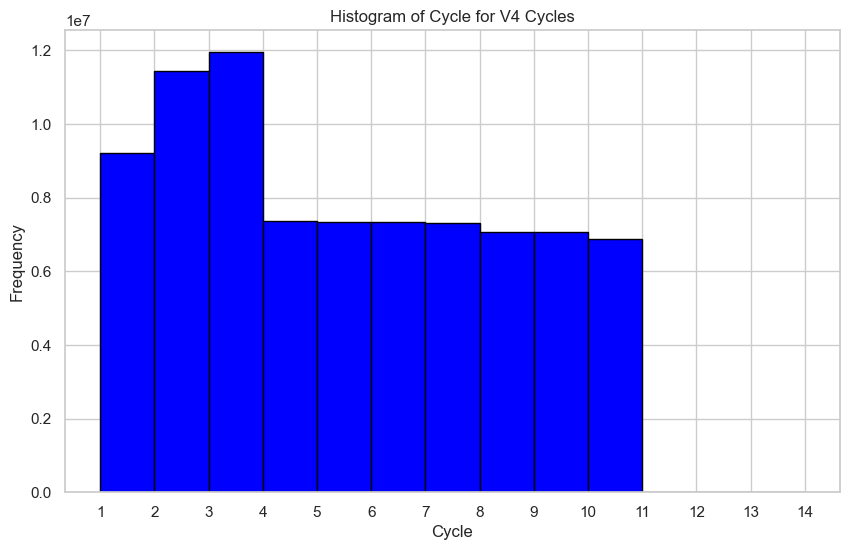

In [119]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(V4_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for V4 Cycles')
plt.show()


In [120]:
#Importing V5 cell 
folder_name = 'V5'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

V5_combined_data = combined_data

Processing folder: V5
Loading file: Cycling/V5/Cycling1V5.mat
Loaded and processed data for Cycling/V5/Cycling1V5.mat. Cycle index: 1
Loading file: Cycling/V5/Cycling2V5.mat
Loaded and processed data for Cycling/V5/Cycling2V5.mat. Cycle index: 2
Loading file: Cycling/V5/Cycling3V5.mat
Loaded and processed data for Cycling/V5/Cycling3V5.mat. Cycle index: 3
Combined data for V5 has 61446991 rows.


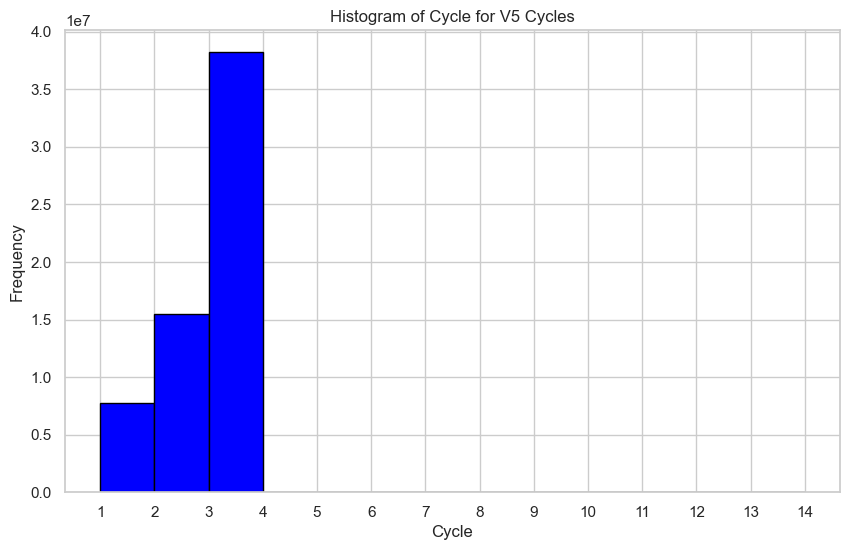

In [121]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(V5_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for V5 Cycles')
plt.show()


In [16]:
#Importing V5 cell 
folder_name = 'W3'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")


W3_combined_data = combined_data

Processing folder: W3
Loading file: Cycling/W3/Cycling1W3.mat
Loaded and processed data for Cycling/W3/Cycling1W3.mat. Cycle index: 1
Loading file: Cycling/W3/Cycling2W3.mat
Loaded and processed data for Cycling/W3/Cycling2W3.mat. Cycle index: 2
Combined data for W3 has 20954818 rows.


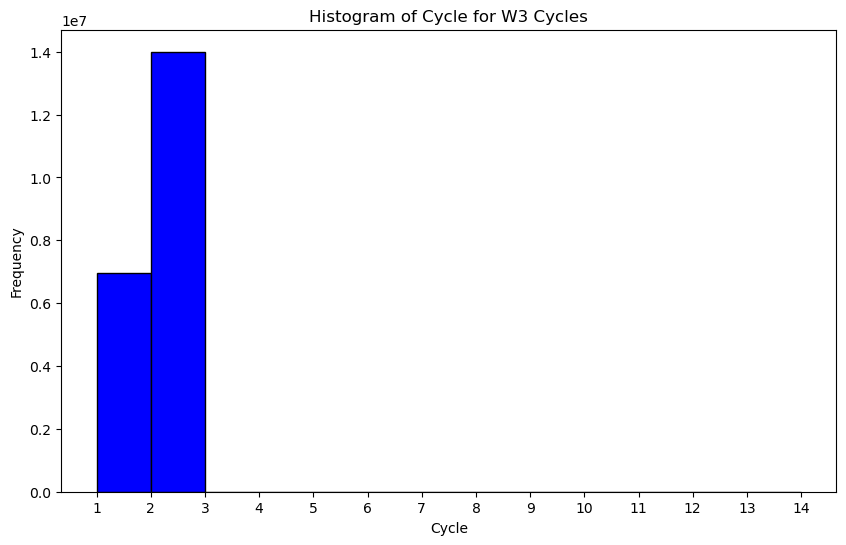

In [18]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W3_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W3 Cycles')
plt.show()


In [17]:
#Importing V5 cell 
folder_name = 'W4'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")


W4_combined_data = combined_data

Processing folder: W4
Loading file: Cycling/W4/Cycling1W4.mat
Loaded and processed data for Cycling/W4/Cycling1W4.mat. Cycle index: 1
Loading file: Cycling/W4/Cycling2W4.mat
Loaded and processed data for Cycling/W4/Cycling2W4.mat. Cycle index: 2
Loading file: Cycling/W4/Cycling3W4.mat
Loaded and processed data for Cycling/W4/Cycling3W4.mat. Cycle index: 3
Loading file: Cycling/W4/Cycling4W4.mat
Loaded and processed data for Cycling/W4/Cycling4W4.mat. Cycle index: 4
Loading file: Cycling/W4/Cycling5W4.mat
Loaded and processed data for Cycling/W4/Cycling5W4.mat. Cycle index: 5
Loading file: Cycling/W4/Cycling6W4.mat
Loaded and processed data for Cycling/W4/Cycling6W4.mat. Cycle index: 6
Loading file: Cycling/W4/Cycling7W4.mat
Loaded and processed data for Cycling/W4/Cycling7W4.mat. Cycle index: 7
Combined data for W4 has 159785871 rows.


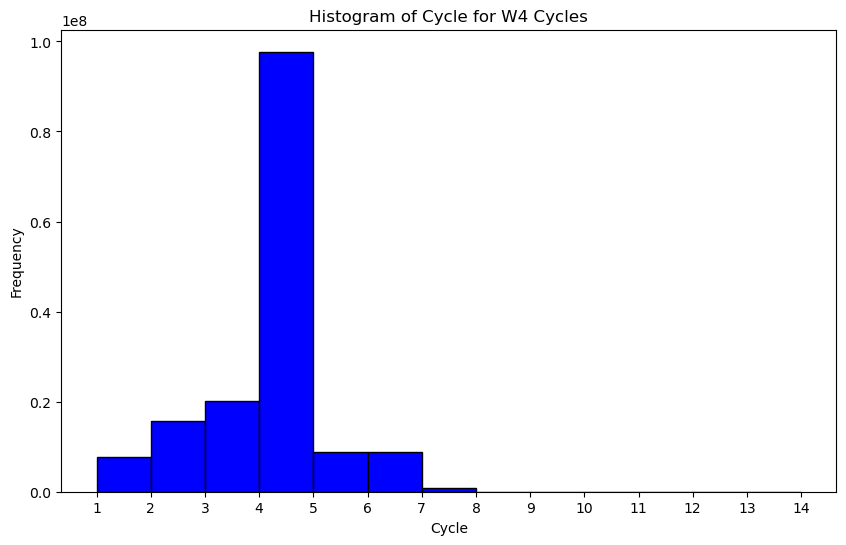

In [19]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W4_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W4 Cycles')
plt.show()


In [20]:
#Importing V5 cell 
folder_name = 'W5'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")


W5_combined_data = combined_data

Processing folder: W5
Loading file: Cycling/W5/Cycling1W5.mat
Loaded and processed data for Cycling/W5/Cycling1W5.mat. Cycle index: 1
Loading file: Cycling/W5/Cycling2W5.mat
Loaded and processed data for Cycling/W5/Cycling2W5.mat. Cycle index: 2
Loading file: Cycling/W5/Cycling3W5.mat
Loaded and processed data for Cycling/W5/Cycling3W5.mat. Cycle index: 3
Loading file: Cycling/W5/Cycling4W5.mat
Loaded and processed data for Cycling/W5/Cycling4W5.mat. Cycle index: 4
Loading file: Cycling/W5/Cycling5W5.mat
Loaded and processed data for Cycling/W5/Cycling5W5.mat. Cycle index: 5
Loading file: Cycling/W5/Cycling6W5.mat
Loaded and processed data for Cycling/W5/Cycling6W5.mat. Cycle index: 6
Loading file: Cycling/W5/Cycling7W5.mat
Loaded and processed data for Cycling/W5/Cycling7W5.mat. Cycle index: 7
Loading file: Cycling/W5/Cycling8W5.mat
Loaded and processed data for Cycling/W5/Cycling8W5.mat. Cycle index: 8
Loading file: Cycling/W5/Cycling9W5.mat
Loaded and processed data for Cycling/W5/C

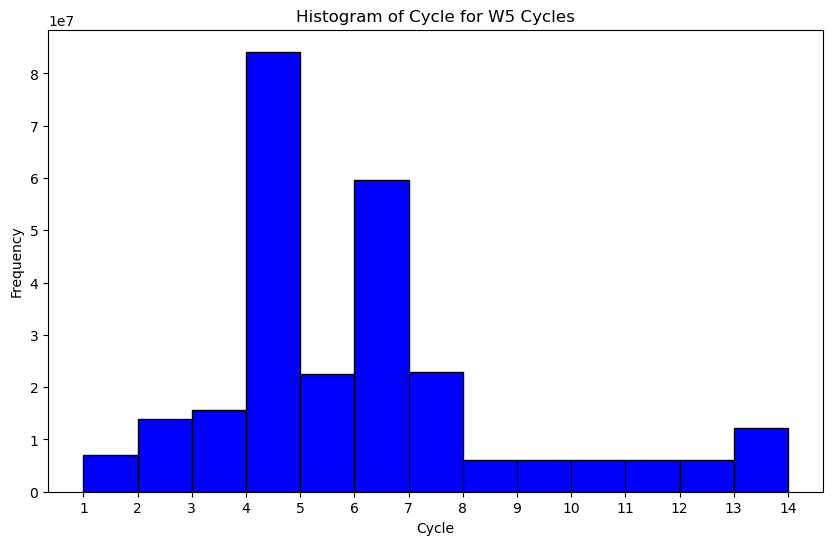

In [21]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W5_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W5 Cycles')
plt.show()


In [22]:
#Importing V5 cell 
folder_name = 'W7'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")


W7_combined_data = combined_data

Processing folder: W7
Loading file: Cycling/W7/Cycling1W7.mat
Loaded and processed data for Cycling/W7/Cycling1W7.mat. Cycle index: 1
Loading file: Cycling/W7/Cycling2W7.mat
Loaded and processed data for Cycling/W7/Cycling2W7.mat. Cycle index: 2
Loading file: Cycling/W7/Cycling3W7.mat
Loaded and processed data for Cycling/W7/Cycling3W7.mat. Cycle index: 3
Loading file: Cycling/W7/Cycling4W7.mat
Loaded and processed data for Cycling/W7/Cycling4W7.mat. Cycle index: 4
Combined data for W7 has 44766371 rows.


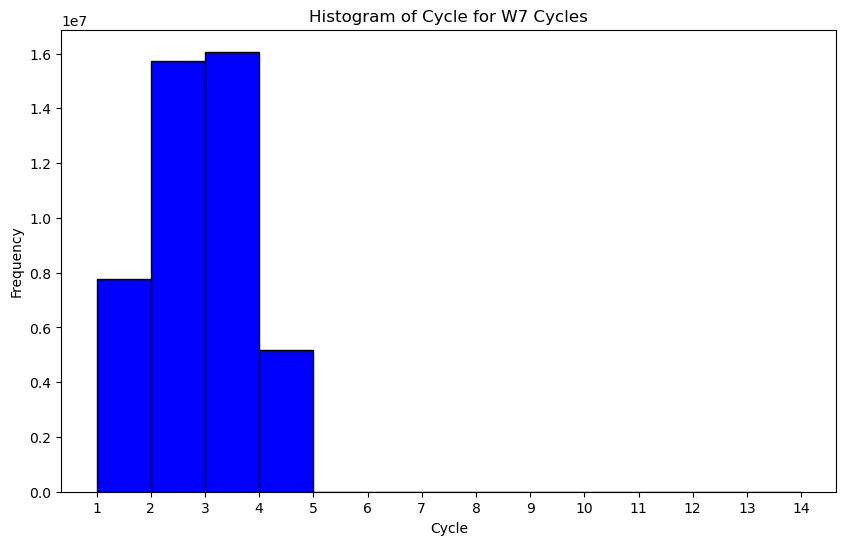

In [23]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W7_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W7 Cycles')
plt.show()


In [9]:
#Importing W8 cell 
folder_name = 'W8'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

# Example visualization or save combined data
# Save combined data for further analysis (optional)
output_csv_path = f"{folder_name}_combined_data.csv"
combined_data.to_csv(output_csv_path, index=False)
print(f"Combined data for {folder_name} saved to {output_csv_path}.")

W8_combined_data = combined_data

Processing folder: W8
Loading file: Cycling/W8/Cycling1W8.mat
Loaded and processed data for Cycling/W8/Cycling1W8.mat. Cycle index: 1
Loading file: Cycling/W8/Cycling2W8.mat
Loaded and processed data for Cycling/W8/Cycling2W8.mat. Cycle index: 2
Loading file: Cycling/W8/Cycling3W8.mat
Loaded and processed data for Cycling/W8/Cycling3W8.mat. Cycle index: 3
Loading file: Cycling/W8/Cycling4W8.mat
Loaded and processed data for Cycling/W8/Cycling4W8.mat. Cycle index: 4
Loading file: Cycling/W8/Cycling5W8.mat
Loaded and processed data for Cycling/W8/Cycling5W8.mat. Cycle index: 5
Loading file: Cycling/W8/Cycling6W8.mat
Loaded and processed data for Cycling/W8/Cycling6W8.mat. Cycle index: 6
Loading file: Cycling/W8/Cycling7W8.mat
Loaded and processed data for Cycling/W8/Cycling7W8.mat. Cycle index: 7
Loading file: Cycling/W8/Cycling8W8.mat
Loaded and processed data for Cycling/W8/Cycling8W8.mat. Cycle index: 8
Loading file: Cycling/W8/Cycling9W8.mat
Loaded and processed data for Cycling/W8/C

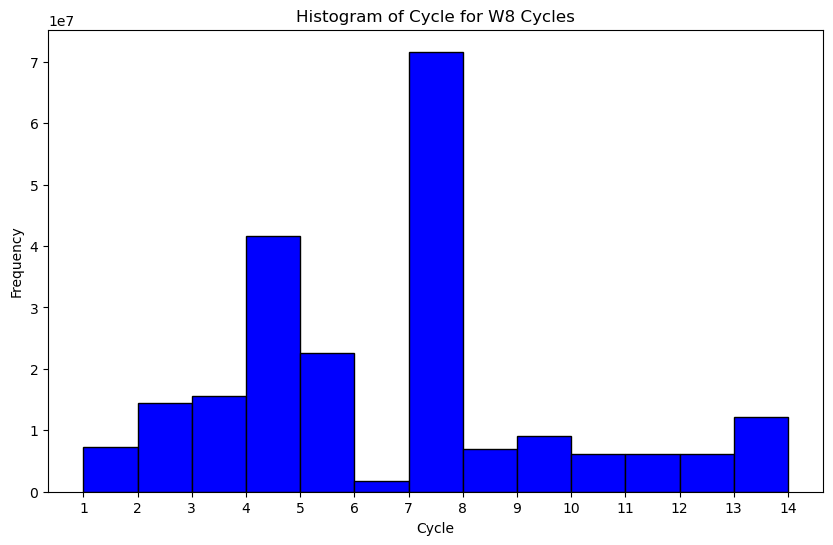

In [10]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W8_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W8 Cycles')
plt.show()


In [11]:
#Importing V5 cell 
folder_name = 'W9'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

# Example visualization or save combined data
# Save combined data for further analysis (optional)
output_csv_path = f"{folder_name}_combined_data.csv"
combined_data.to_csv(output_csv_path, index=False)
print(f"Combined data for {folder_name} saved to {output_csv_path}.")

W9_combined_data = combined_data

Processing folder: W9
Loading file: Cycling/W9/Cycling1W9.mat
Loaded and processed data for Cycling/W9/Cycling1W9.mat. Cycle index: 1
Loading file: Cycling/W9/Cycling2W9.mat
Loaded and processed data for Cycling/W9/Cycling2W9.mat. Cycle index: 2
Loading file: Cycling/W9/Cycling3W9.mat
Loaded and processed data for Cycling/W9/Cycling3W9.mat. Cycle index: 3
Loading file: Cycling/W9/Cycling4W9.mat
Loaded and processed data for Cycling/W9/Cycling4W9.mat. Cycle index: 4
Loading file: Cycling/W9/Cycling5W9.mat
Loaded and processed data for Cycling/W9/Cycling5W9.mat. Cycle index: 5
Loading file: Cycling/W9/Cycling6W9.mat
Loaded and processed data for Cycling/W9/Cycling6W9.mat. Cycle index: 6
Loading file: Cycling/W9/Cycling7W9.mat
Loaded and processed data for Cycling/W9/Cycling7W9.mat. Cycle index: 7
Loading file: Cycling/W9/Cycling8W9.mat
Loaded and processed data for Cycling/W9/Cycling8W9.mat. Cycle index: 8
Loading file: Cycling/W9/Cycling9W9.mat
Loaded and processed data for Cycling/W9/C

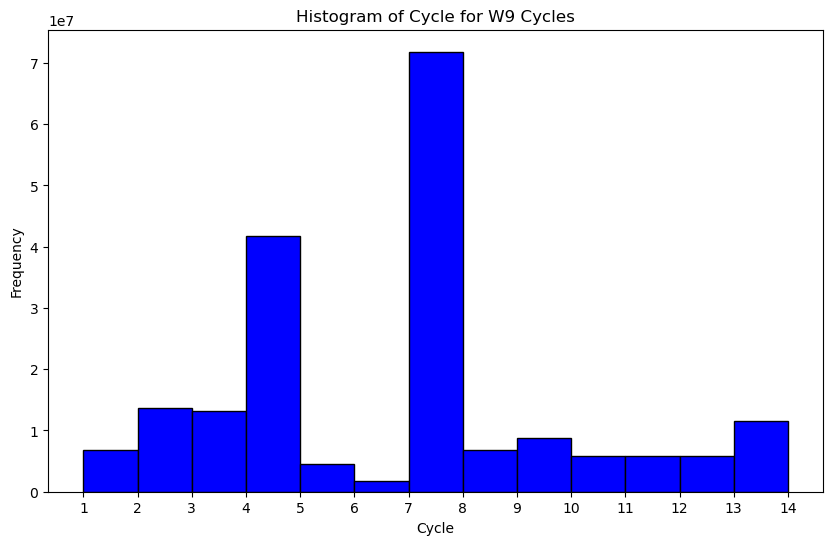

In [12]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W9_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W9 Cycles')
plt.show()


In [13]:
#Importing V5 cell 
folder_name = 'W10'
files_to_process = file_paths[folder_name]

# Initialize a list to store all cycle data for the selected cell
all_cycle_data = []

print(f"Processing folder: {folder_name}")

for file_path in files_to_process:
    print(f"Loading file: {file_path}")
    try:
        # Load .mat file
        data = loadmat(file_path)
        
        # Create a DataFrame for the current cycle
        if all(key in data for key in [
            'I_full_vec_M1_NMC25degC', 
            'V_full_vec_M1_NMC25degC', 
            'Step_Index_full_vec_M1_NMC25degC', 
            'ch_cap_full_vec_M1_NMC25degC', 
            'dis_cap_full_vec_M1_NMC25degC', 
            't_full_vec_M1_NMC25degC'
        ]):
            cycle_data = pd.DataFrame({
                'Current': data['I_full_vec_M1_NMC25degC'].squeeze(),
                'Voltage': data['V_full_vec_M1_NMC25degC'].squeeze(),
                'Step_Index': data['Step_Index_full_vec_M1_NMC25degC'].squeeze(),
                'Charge_Capacity': data['ch_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Discharge_Capacity': data['dis_cap_full_vec_M1_NMC25degC'].squeeze(),
                'Time': data['t_full_vec_M1_NMC25degC'].squeeze(),
            })
            
            # Extract cycle index from file name using regex
            cycle_index = int(re.search(r'(\d+)', file_path.split('/')[-1]).group(0))  # Extract number after "Cycling"
            cycle_data['Cycle'] = cycle_index
            
            all_cycle_data.append(cycle_data)
            
            print(f"Loaded and processed data for {file_path}. Cycle index: {cycle_index}")
        else:
            print(f"Required variables not found in {file_path}. Skipping.")
    
    except Exception as e:
        print(f"Error processing {file_path}: {e}")

# Combine all cycles' data into one DataFrame for the cell
if all_cycle_data:
    combined_data = pd.concat(all_cycle_data, ignore_index=True)
    cell_combined_data[folder_name] = combined_data
    print(f"Combined data for {folder_name} has {len(combined_data)} rows.")
else:
    print(f"No data processed for {folder_name}.")

# Example visualization or save combined data
# Save combined data for further analysis (optional)
output_csv_path = f"{folder_name}_combined_data.csv"
combined_data.to_csv(output_csv_path, index=False)
print(f"Combined data for {folder_name} saved to {output_csv_path}.")

W10_combined_data = combined_data

Processing folder: W10
Loading file: Cycling/W10/Cycling1W10.mat
Loaded and processed data for Cycling/W10/Cycling1W10.mat. Cycle index: 1
Loading file: Cycling/W10/Cycling2W10.mat
Loaded and processed data for Cycling/W10/Cycling2W10.mat. Cycle index: 2
Loading file: Cycling/W10/Cycling3W10.mat
Loaded and processed data for Cycling/W10/Cycling3W10.mat. Cycle index: 3
Loading file: Cycling/W10/Cycling4W10.mat
Loaded and processed data for Cycling/W10/Cycling4W10.mat. Cycle index: 4
Loading file: Cycling/W10/Cycling5W10.mat
Loaded and processed data for Cycling/W10/Cycling5W10.mat. Cycle index: 5
Loading file: Cycling/W10/Cycling6W10.mat
Loaded and processed data for Cycling/W10/Cycling6W10.mat. Cycle index: 6
Loading file: Cycling/W10/Cycling7W10.mat
Loaded and processed data for Cycling/W10/Cycling7W10.mat. Cycle index: 7
Loading file: Cycling/W10/Cycling8W10.mat
Loaded and processed data for Cycling/W10/Cycling8W10.mat. Cycle index: 8
Loading file: Cycling/W10/Cycling9W10.mat
Loaded 

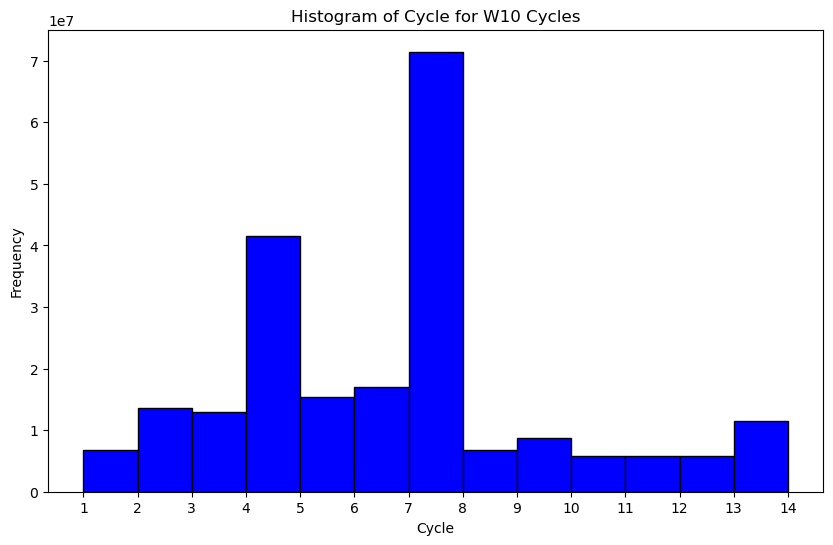

In [14]:
# Step 1: Plot histogram of Cycle values with bins for each cycle (1 to 14)
plt.figure(figsize=(10, 6))
bins = np.arange(1, 15, 1)  # Bins for cycles from 1 to 14, with a step of 1
plt.hist(W10_combined_data['Cycle'], bins=bins, color='blue', alpha=1, edgecolor='black', density=False)

plt.xticks(bins)  # Set x-axis ticks to match the bins
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W10 Cycles')
plt.show()



As per the above Histogram graphs of the cycles the cells went through, we can see that only cells W5, W8, W9, and W10 went through all the 14 cycles without encountering any issues so we will be selecting these cells for the next tests.

### Diagnostic Tests Analysis 

#### Capacity Tests for each cell


In [ ]:
# Load Capacity test data
capacity_test_data = loadmat('diagnostic_tests/processed_mat/capacity_test.mat')
print(capacity_test_data.keys())  # Explore structure of .mat file


dict_keys(['__header__', '__version__', '__globals__', 'cap', 'col_cell_label', 'curr', 'row_diag_number', 'time', 'vcell'])


In [53]:
# Inspect the shapes of the arrays to understand their dimensions
print("Shape of col_cell_label:", capacity_test_data['col_cell_label'].shape)
print("Shape of row_diag_number:", capacity_test_data['row_diag_number'].shape)
print("Shape of cap:", capacity_test_data['cap'].shape)
print("Shape of curr:", capacity_test_data['curr'].shape)
print("Shape of vcell:", capacity_test_data['vcell'].shape)
print("Shape of time:", capacity_test_data['time'].shape)

Shape of col_cell_label: (1, 10)
Shape of row_diag_number: (1, 15)
Shape of cap: (15, 10)
Shape of curr: (15, 10)
Shape of vcell: (15, 10)
Shape of time: (15, 10)


In [83]:
# Extract relevant data
data = capacity_test_data
time = data['time']
vcell = data['vcell']
cap = data['cap']
col_cell_label = ['W3', 'W4', 'W5', 'W7', 'W8', 'W9', 'W10', 'G1', 'V4', 'V5']  # example labels

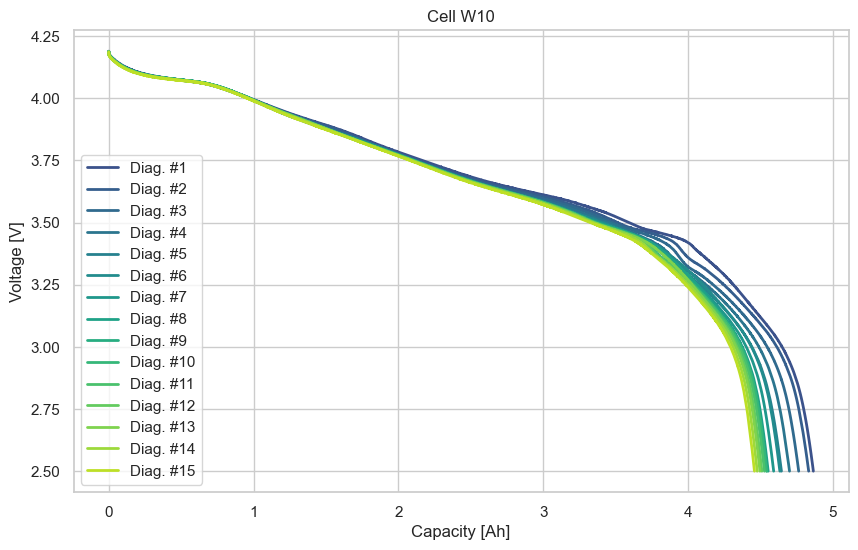

In [88]:
# User selection
sel_cell = 6  # Cell 'G1'

# Define the colors (same as MATLAB)
rgb_num = np.linspace(0.25, 0.9, time.shape[0])  # Adjust size based on time array
my_colormap = plt.cm.viridis(rgb_num)

# Plotting the Capacity Test
plt.figure(figsize=(10, 6))
for i in range(time.shape[0]):
    # Check if any value in vcell[i, sel_cell] is NaN
    if np.any(np.isnan(vcell[i, sel_cell].ravel())):
        break
    plt.plot(cap[i, sel_cell], vcell[i, sel_cell].ravel(), linewidth=2, color=my_colormap[i % len(my_colormap)])

plt.xlabel('Capacity [Ah]')
plt.ylabel('Voltage [V]')
plt.title(f'Cell {col_cell_label[sel_cell]}')
plt.legend([f'Diag. #{i+1}' for i in range(time.shape[0])], loc='best')
plt.show()


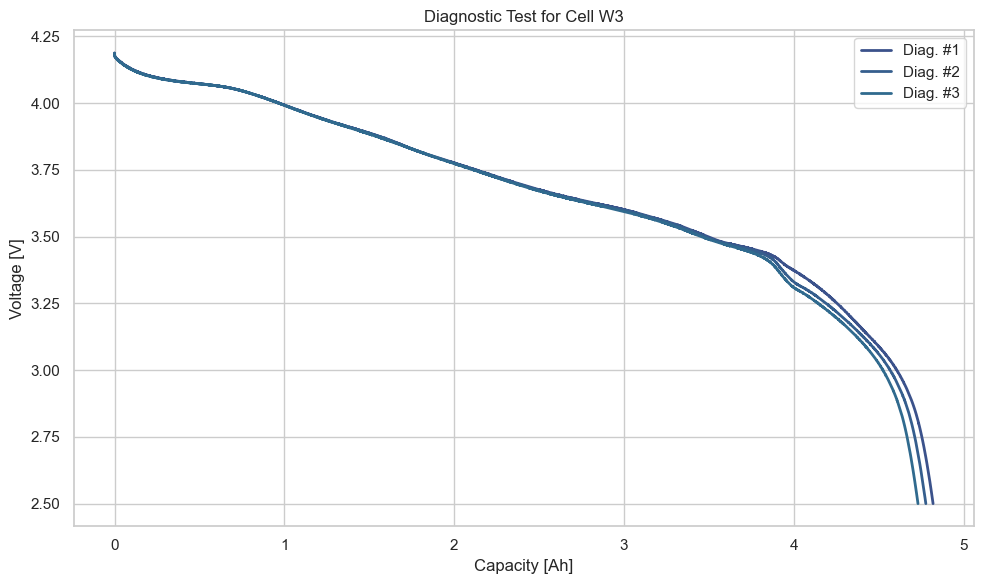

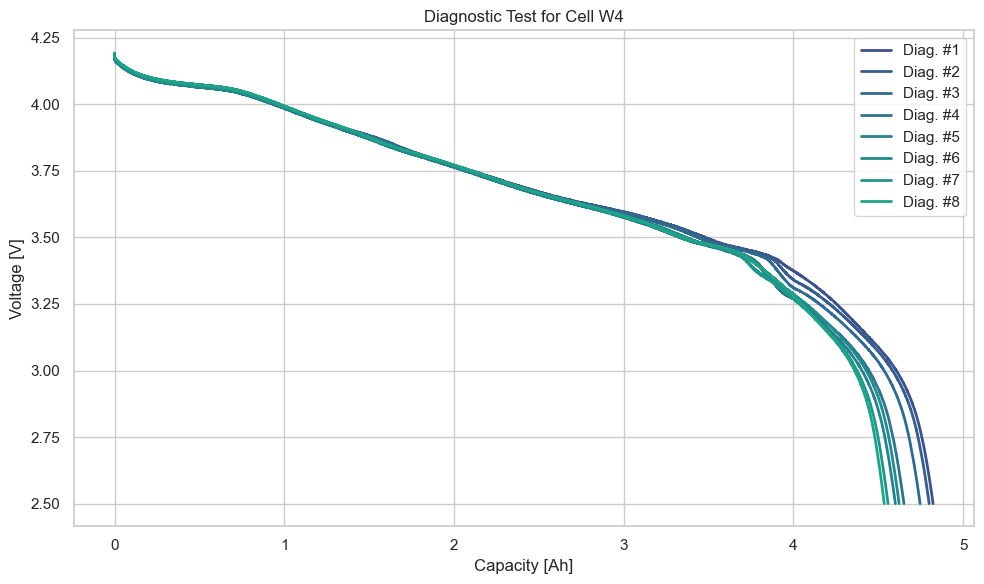

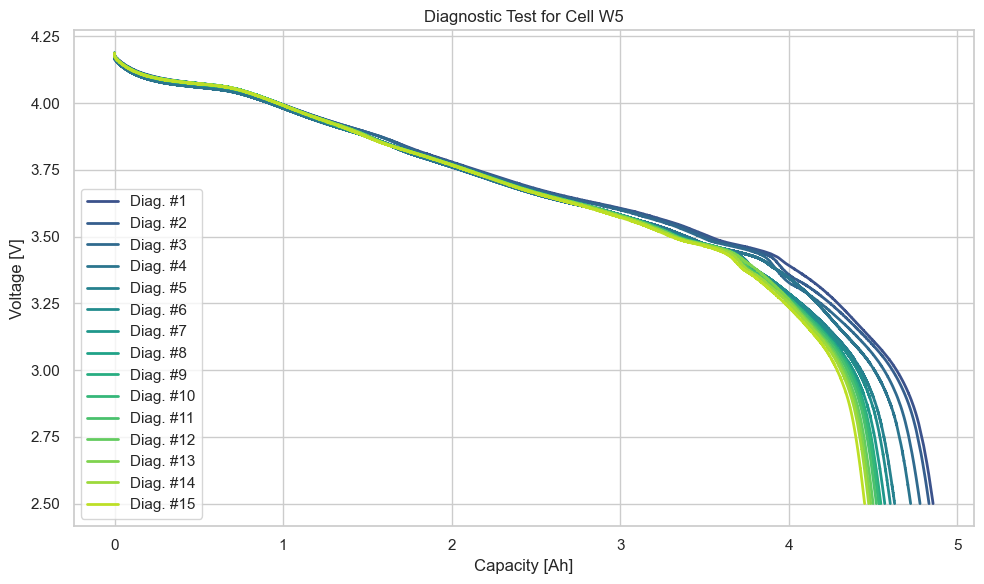

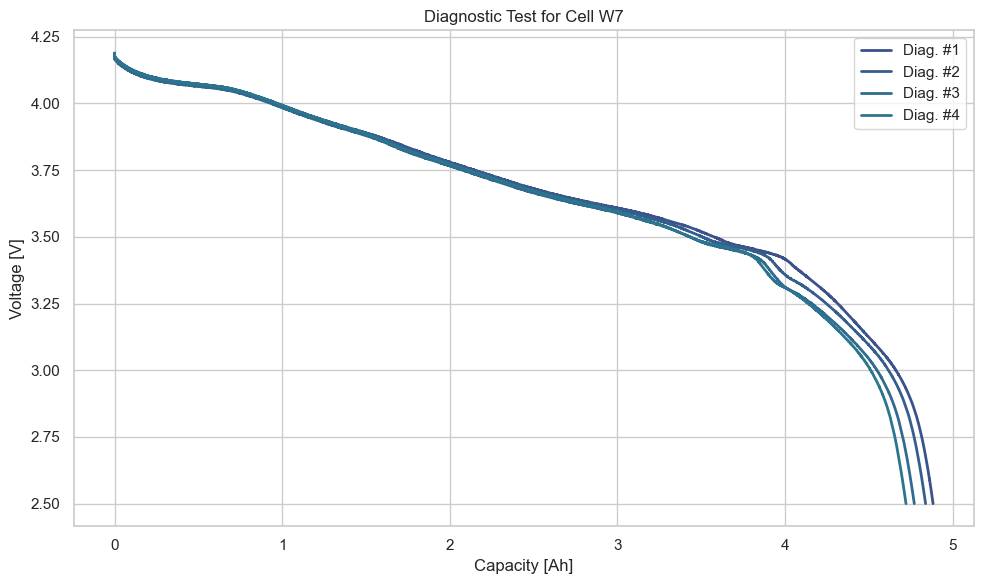

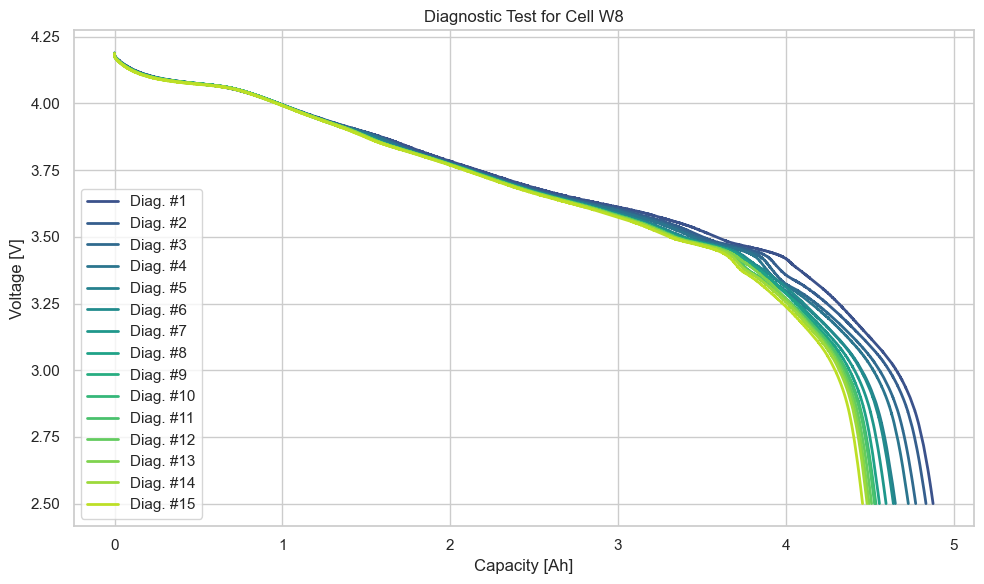

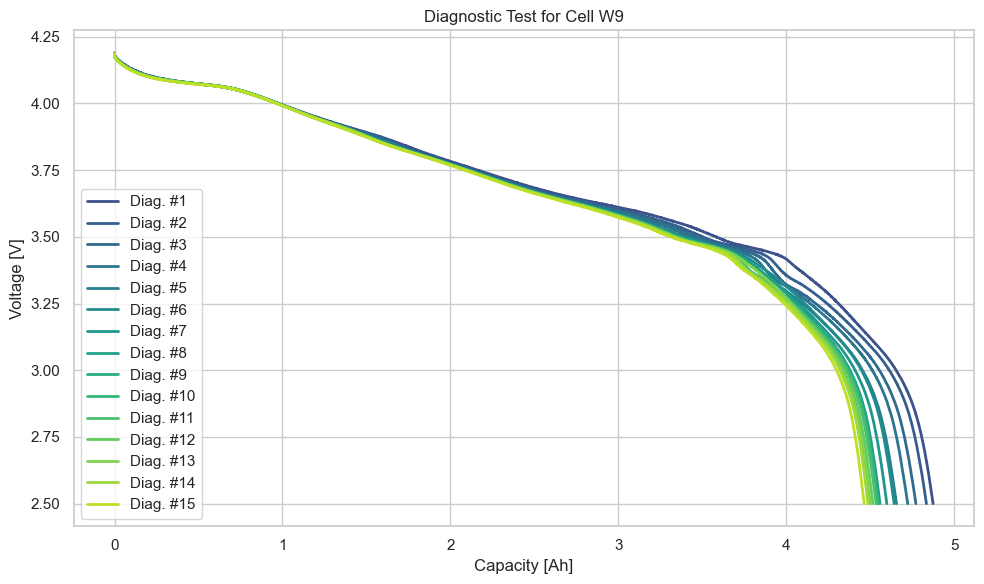

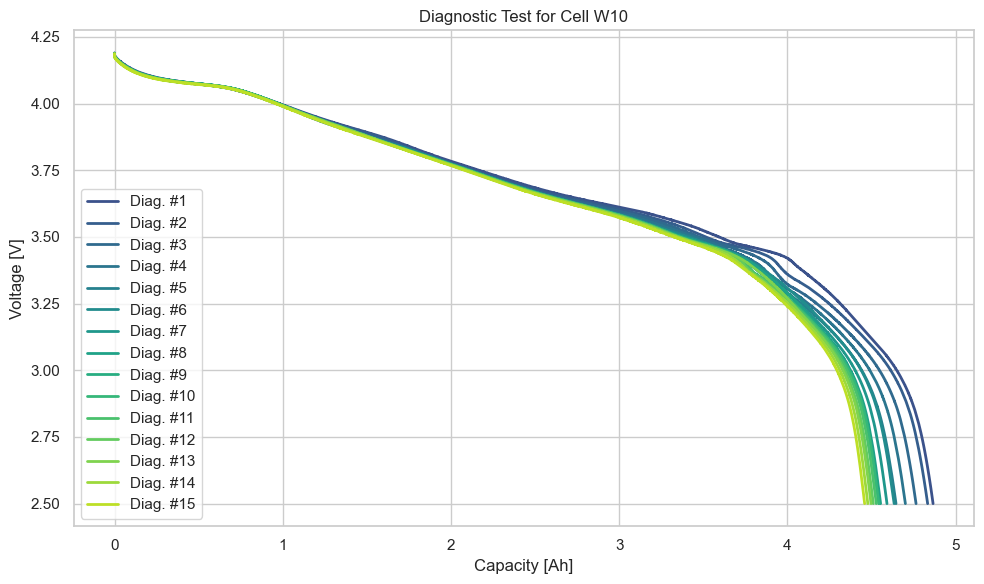

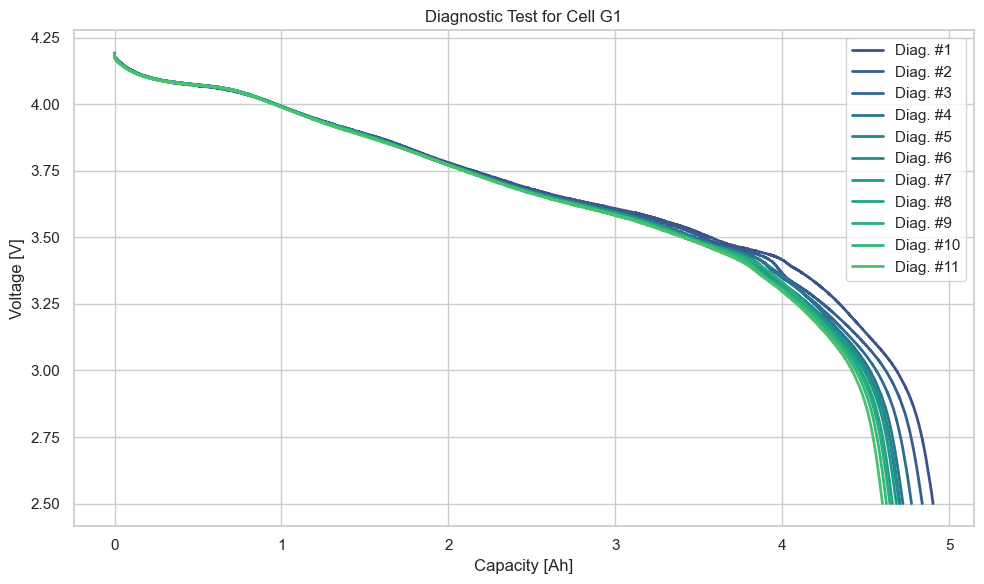

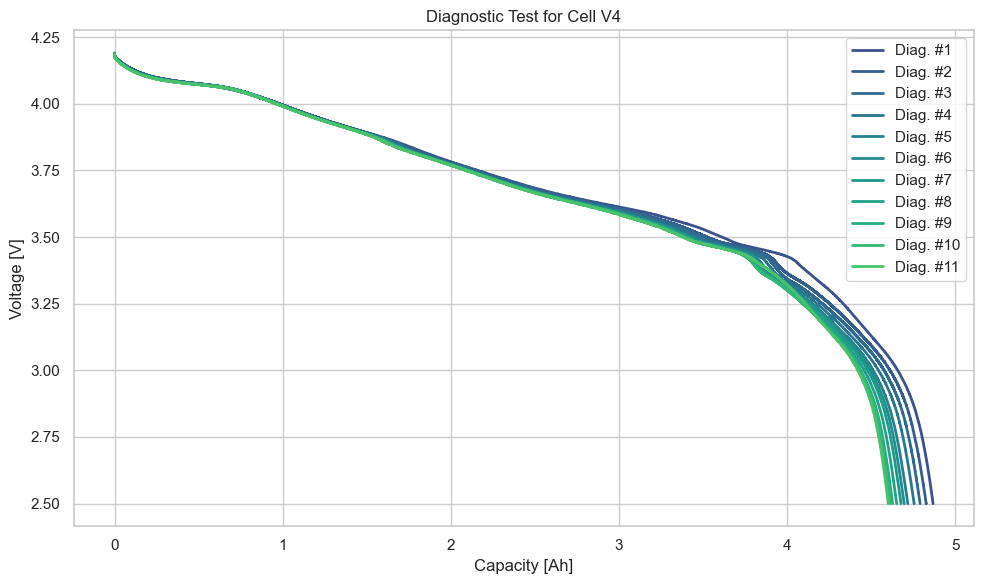

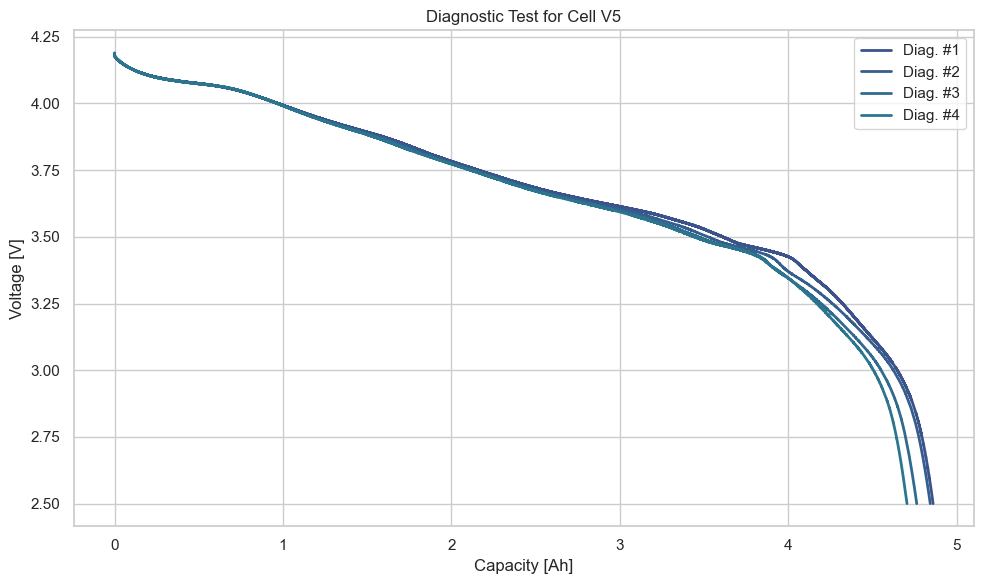

In [ ]:
# Define the colors (same as MATLAB)
rgb_num = np.linspace(0.25, 0.9, time.shape[0])  # Adjust size based on time array
my_colormap = plt.cm.viridis(rgb_num)

# Plotting each cell's diagnostic tests
for sel_cell in range(len(col_cell_label)):
    plt.figure(figsize=(10, 6))
    
    # Plot the voltage vs. capacity for each diagnostic (cell)
    for i in range(time.shape[0]):
        # Check if any value in vcell[i, sel_cell] is NaN
        if np.any(np.isnan(vcell[i, sel_cell].ravel())):
            break
        plt.plot(cap[i, sel_cell], vcell[i, sel_cell].ravel(), linewidth=2, color=my_colormap[i % len(my_colormap)])
    
    # Customizing the x-axis to display the cell label and its values
    plt.xlabel('Capacity [Ah]')
    plt.ylabel('Voltage [V]')
    plt.title(f'Diagnostic Test for Cell {col_cell_label[sel_cell]}')
    
    # Add the legend to indicate the diagnostic tests
    plt.legend([f'Diag. #{i+1}' for i in range(time.shape[0])], loc='best')
    
    # Show the plot for the current cell
    plt.tight_layout()
    plt.show()


#### EIS Tests for each cell

In [89]:
# Load EIS test data
EIS_test_data = loadmat('diagnostic_tests/processed_mat/EIS_test.mat')
print(EIS_test_data.keys())  # Explore structure of .mat file


dict_keys(['__header__', '__version__', '__globals__', 'col_cell_label', 'freq', 'im_z', 're_z', 'row_diag_number', 'soc_level'])


In [93]:
for key, value in EIS_test_data.items():
    print(f"{key}: {type(value)}")


__header__: <class 'bytes'>
__version__: <class 'str'>
__globals__: <class 'list'>
col_cell_label: <class 'numpy.ndarray'>
freq: <class 'numpy.ndarray'>
im_z: <class 'numpy.ndarray'>
re_z: <class 'numpy.ndarray'>
row_diag_number: <class 'numpy.ndarray'>
soc_level: <class 'numpy.ndarray'>


In [98]:
# Extracting data from the .mat file
re_z = EIS_test_data['re_z']  # Real impedance (list of arrays)
im_z = EIS_test_data['im_z']  # Imaginary impedance (list of arrays)
row_diag_number = EIS_test_data['row_diag_number'].flatten()  # Diagnostic numbers
col_cell_label = [label[0] for label in EIS_test_data['col_cell_label'][0]]  # Cell labels
soc_level = EIS_test_data['soc_level'].flatten()  # State of Charge (SOC) levels
# Fallback option if 'legend_str' is missing
legend_str = [f"Diag. #{i+1}" for i in range(len(row_diag_number))]


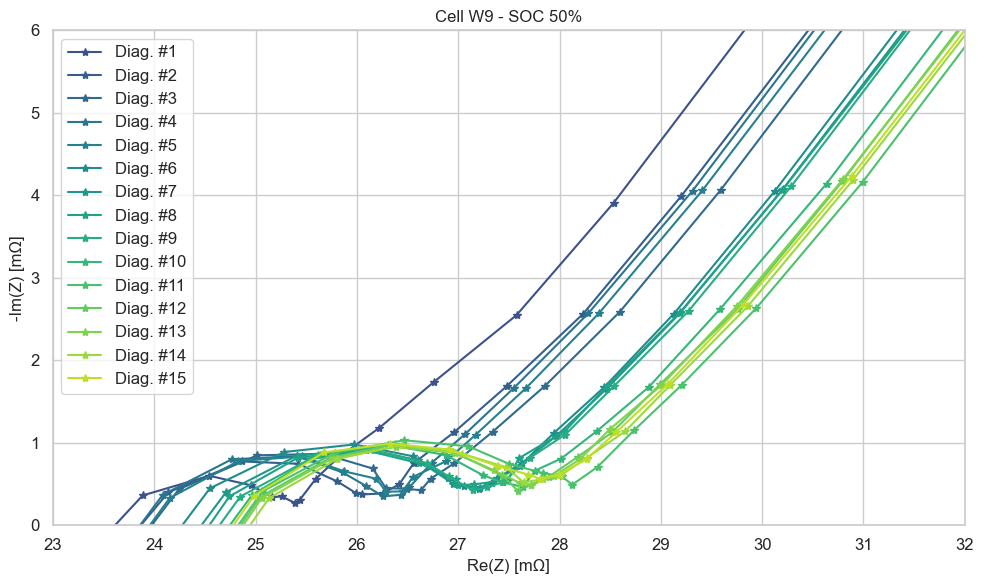

In [ ]:
#TO BE USED LATER

# User selection
sel_cell = 5  # Example: Cell 'G1'
sel_SOC = 1   # Example SOC level

# Define colors (similar to MATLAB's colormap)
rgb_num = np.linspace(0.25, 0.9, len(row_diag_number))  # Adjust size
my_colormap = plt.cm.viridis(rgb_num)

# Initialize lists to track data range
x_vals = []
y_vals = []

# Plotting EIS data
plt.figure(figsize=(10, 6))

for i, diag_num in enumerate(row_diag_number):
    if (
        sel_cell < len(re_z[i])  # Ensure cell index is within bounds
        and re_z[i, sel_cell].size > 0  # Non-empty data
        and not np.isnan(re_z[i, sel_cell]).all()  # Valid data
    ):
        x_data = 1000 * re_z[i, sel_cell][:, sel_SOC]  # Convert to mΩ
        y_data = -1000 * im_z[i, sel_cell][:, sel_SOC]  # Convert to mΩ
        
        # Collect valid data points
        x_vals.extend(x_data)
        y_vals.extend(y_data)
        
        plt.plot(
            x_data,
            y_data,
            '-*',
            linewidth=1.5,
            color=my_colormap[i % len(my_colormap)],
            label=legend_str[i] if i < len(legend_str) else f"Diag. #{diag_num}",
        )

# Ensure valid axis limits
if x_vals and y_vals:  # Only set limits if data exists
    plt.xlim([23, 32])  # x-axis range to match MATLAB plot
    plt.ylim([0, 6])  # y-axis range to match MATLAB plot

# Customize plot
plt.title(f'Cell {col_cell_label[sel_cell]} - SOC {soc_level[sel_SOC]}%')
plt.xlabel('Re(Z) [mΩ]')
plt.ylabel('-Im(Z) [mΩ]')
plt.legend(loc='best', fontsize=12)
plt.grid(True)

# Improve formatting
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.tight_layout()

# Show plot
plt.show()


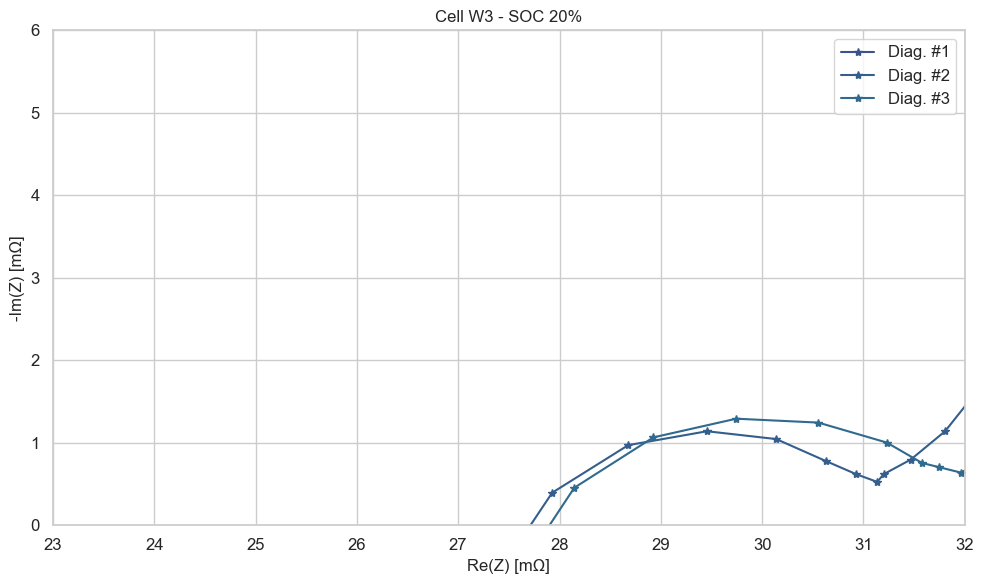

C:\Users\ymuba\AppData\Local\Temp\ipykernel_27268\2636322833.py:41: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(loc='best', fontsize=12)


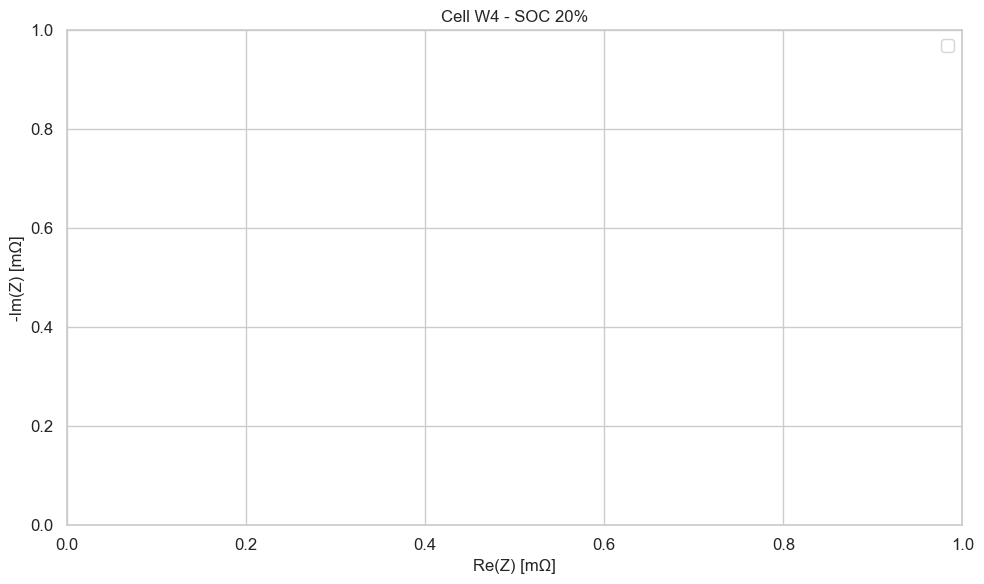

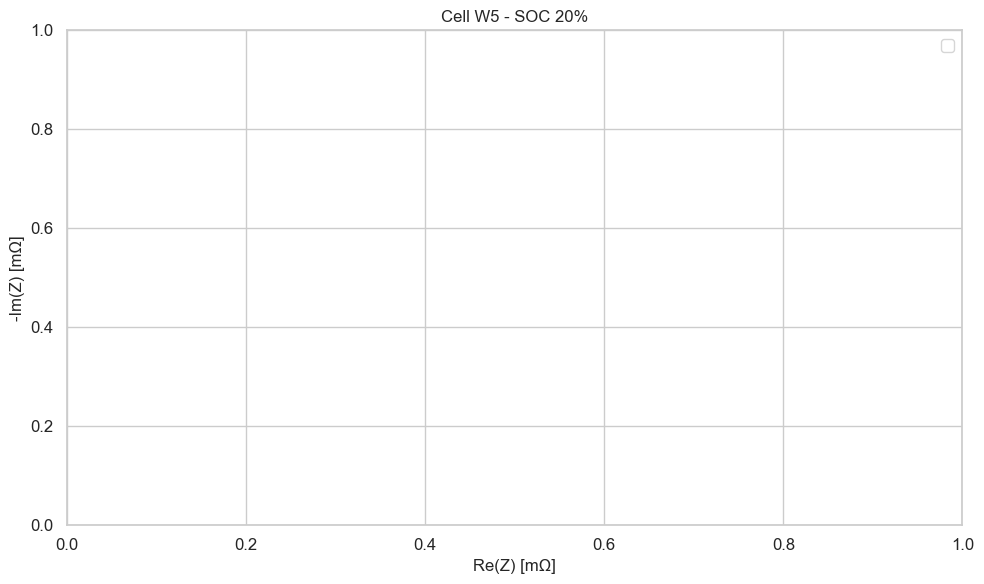

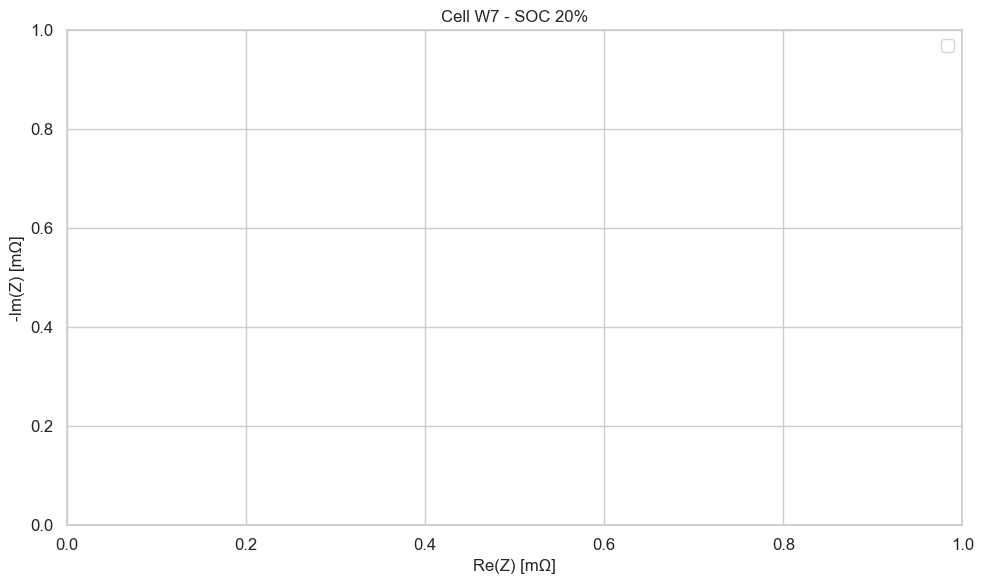

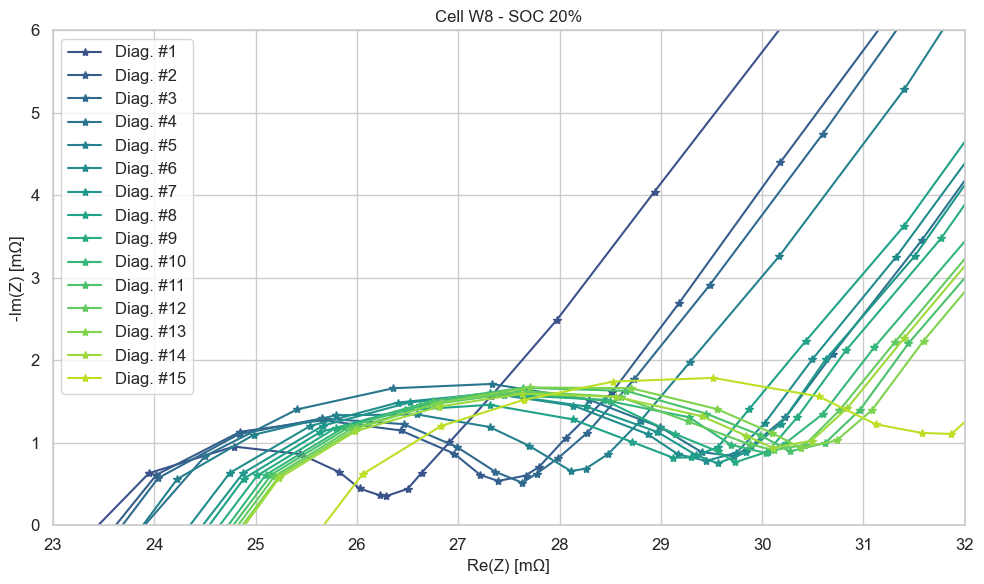

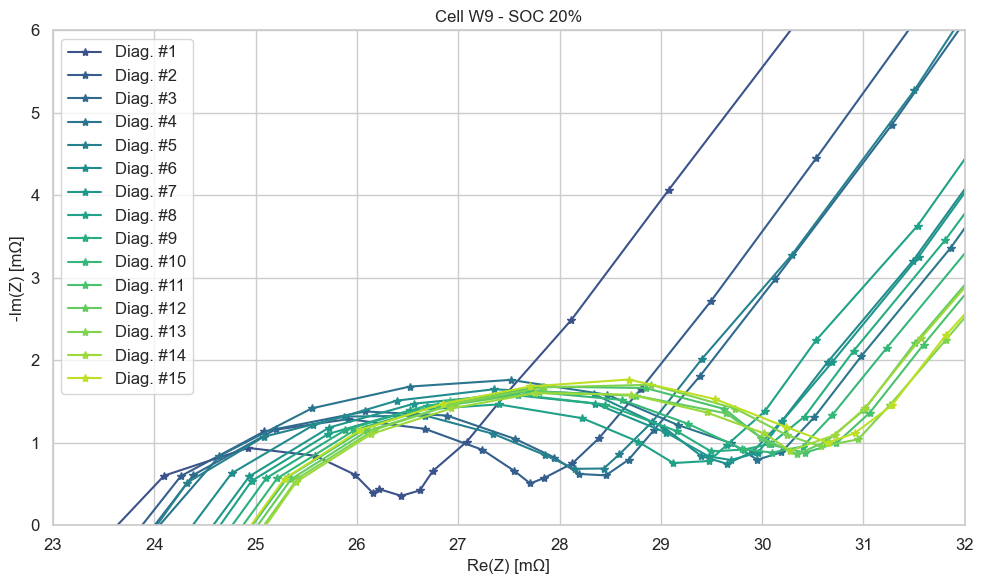

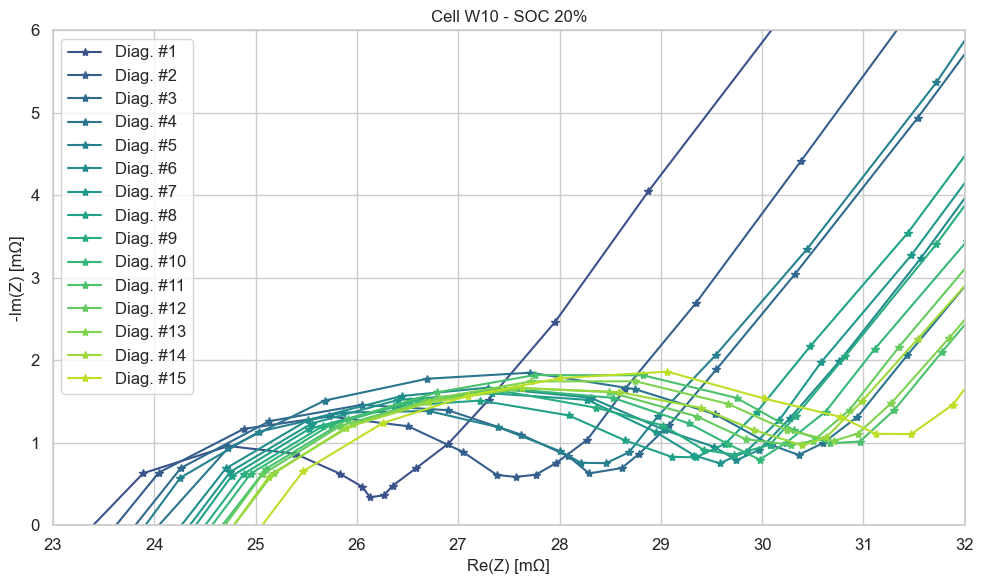

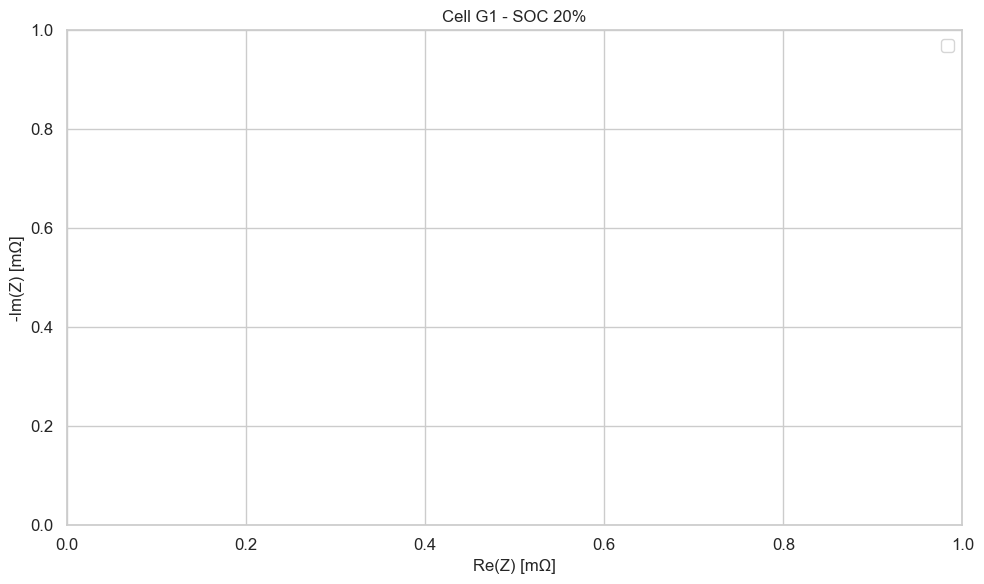

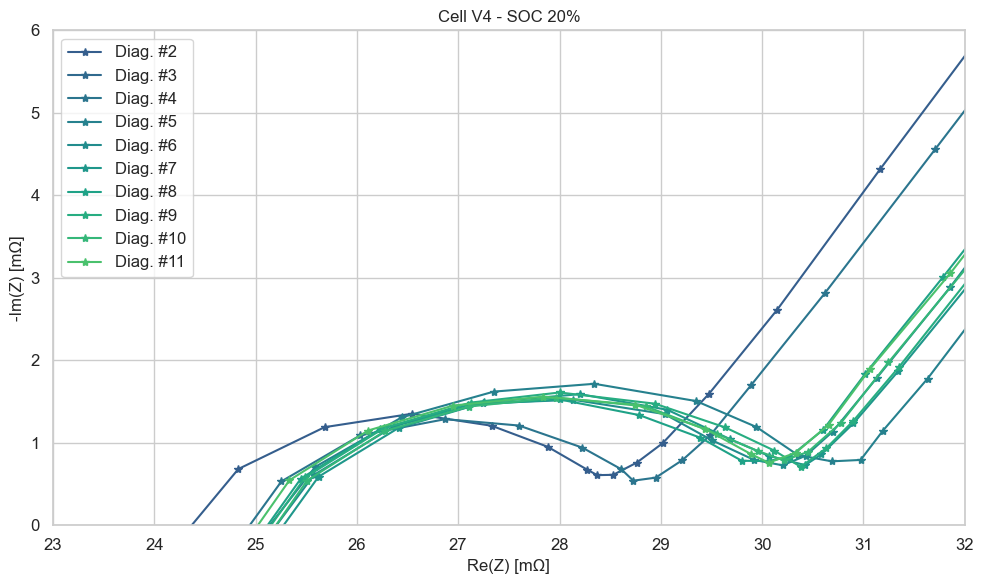

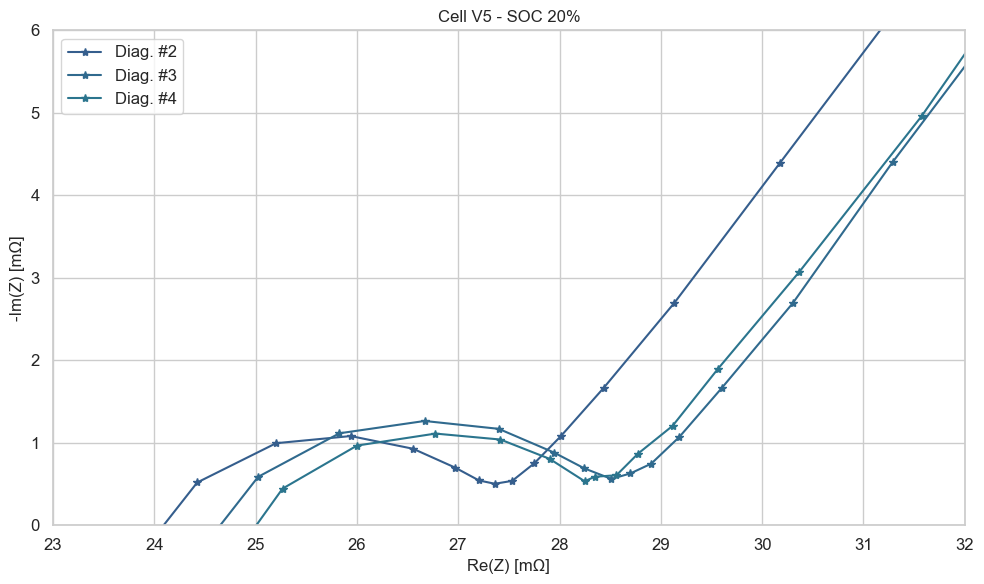

In [112]:
# Iterate over all cells to create separate plots for each one
for sel_cell in range(re_z.shape[1]):  # Iterate over all cells
    # Initialize lists to track data range for the current cell
    x_vals = []
    y_vals = []
    
    # Plotting EIS data for the current cell
    plt.figure(figsize=(10, 6))

    for i, diag_num in enumerate(row_diag_number):
        if (
            re_z[i, sel_cell].size > 0  # Non-empty data
            and not np.isnan(re_z[i, sel_cell]).all()  # Valid data
        ):
            # Assuming SOC level 0 for simplicity
            x_data = 1000 * re_z[i, sel_cell][:, 0]  # Convert to mΩ
            y_data = -1000 * im_z[i, sel_cell][:, 0]  # Convert to mΩ

            # Collect valid data points
            x_vals.extend(x_data)
            y_vals.extend(y_data)

            plt.plot(
                x_data,
                y_data,
                '-*',
                linewidth=1.5,
                color=my_colormap[i % len(my_colormap)],
                label=legend_str[i] if i < len(legend_str) else f"Diag. #{diag_num}",
            )

    # Ensure valid axis limits
    if x_vals and y_vals:  # Only set limits if data exists
        plt.xlim([23, 32])  # x-axis range to match MATLAB plot
        plt.ylim([0, 6])  # y-axis range to match MATLAB plot

    # Customize plot
    plt.title(f'Cell {col_cell_label[sel_cell]} - SOC {soc_level[0]}%')  # Title with SOC level
    plt.xlabel('Re(Z) [mΩ]')
    plt.ylabel('-Im(Z) [mΩ]')
    plt.legend(loc='best', fontsize=12)
    plt.grid(True)

    # Improve formatting
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.tight_layout()

    # Show plot for each cell
    plt.show()

As we can see above in the EIS Tests only W8, W9 and W10 have completed the 15 diagrams.

#### HPPC Tests for each cell

In [31]:
# Load cycling test data
cycling_data = loadmat('diagnostic_tests/processed_mat/HPPC_test.mat')
print(cycling_data.keys())  # Explore structure of .mat file


dict_keys(['__header__', '__version__', '__globals__', 'cap', 'col_cell_label', 'curr', 'row_diag_number', 'time', 'vcell'])


In [32]:
print(cycling_data['col_cell_label'])

[[array(['W3'], dtype='<U2') array(['W4'], dtype='<U2')
  array(['W5'], dtype='<U2') array(['W7'], dtype='<U2')
  array(['W8'], dtype='<U2') array(['W9'], dtype='<U2')
  array(['W10'], dtype='<U3') array(['G1'], dtype='<U2')
  array(['V4'], dtype='<U2') array(['V5'], dtype='<U2')]]


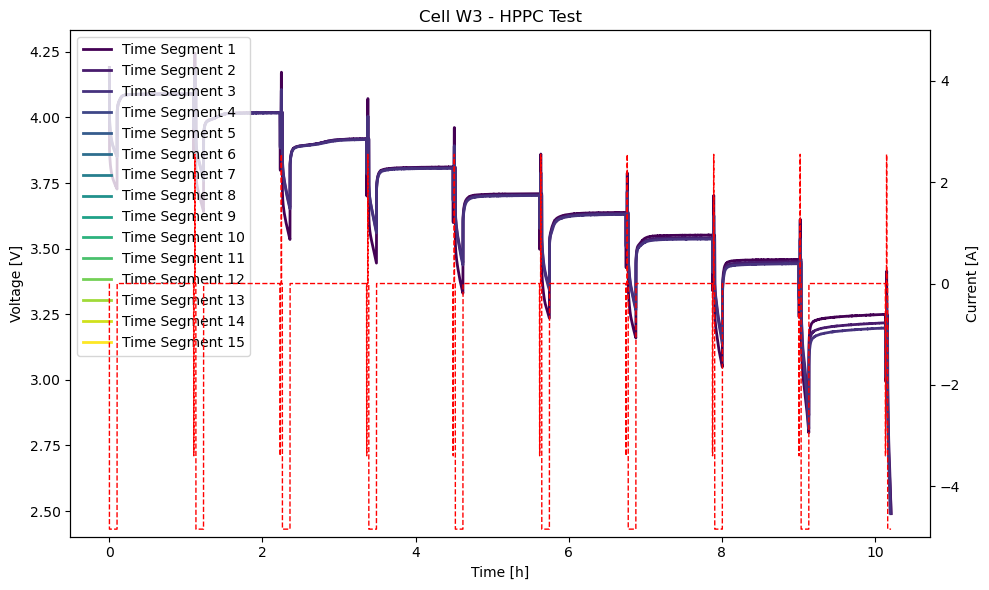

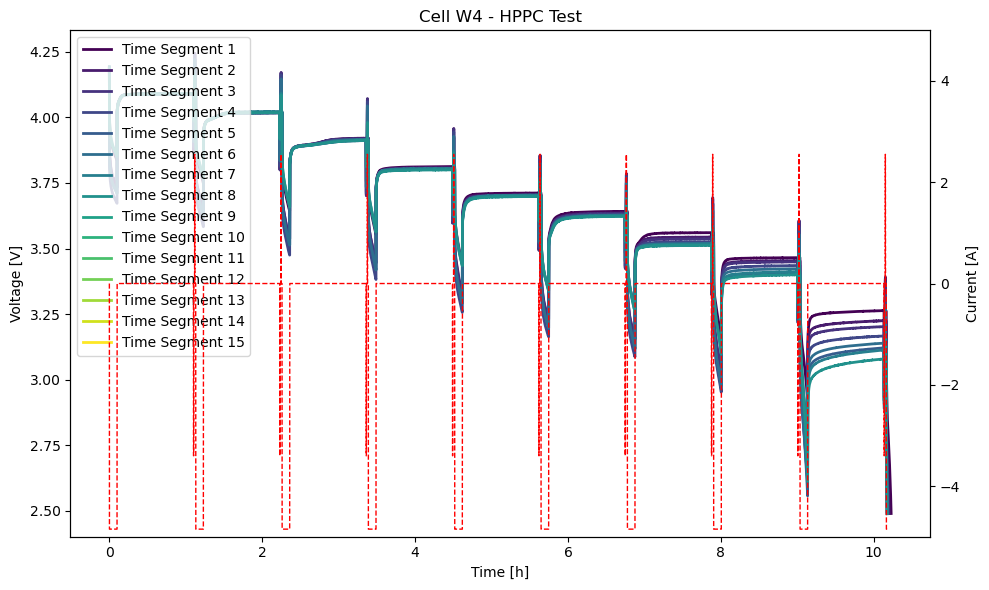

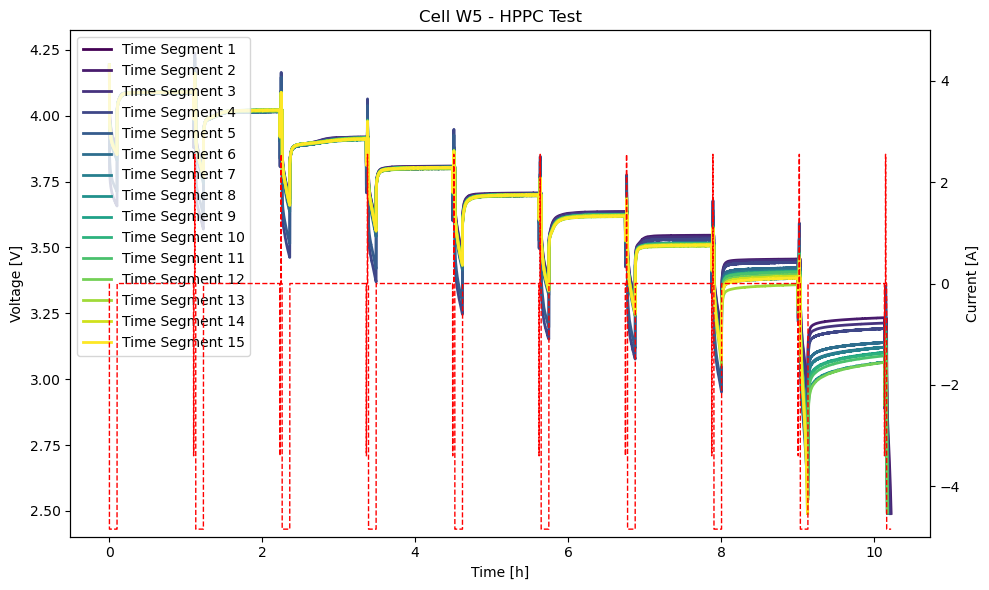

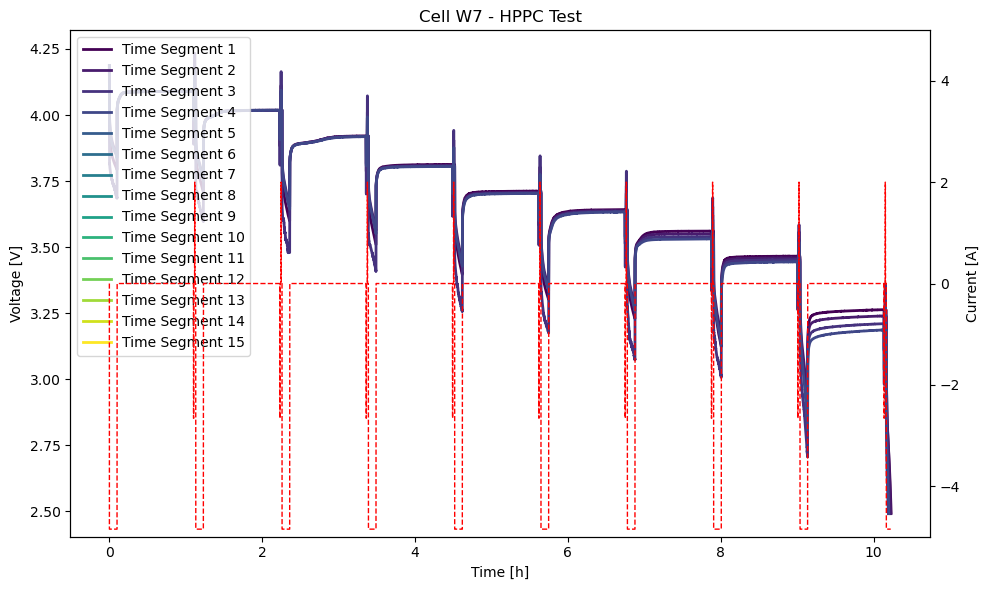

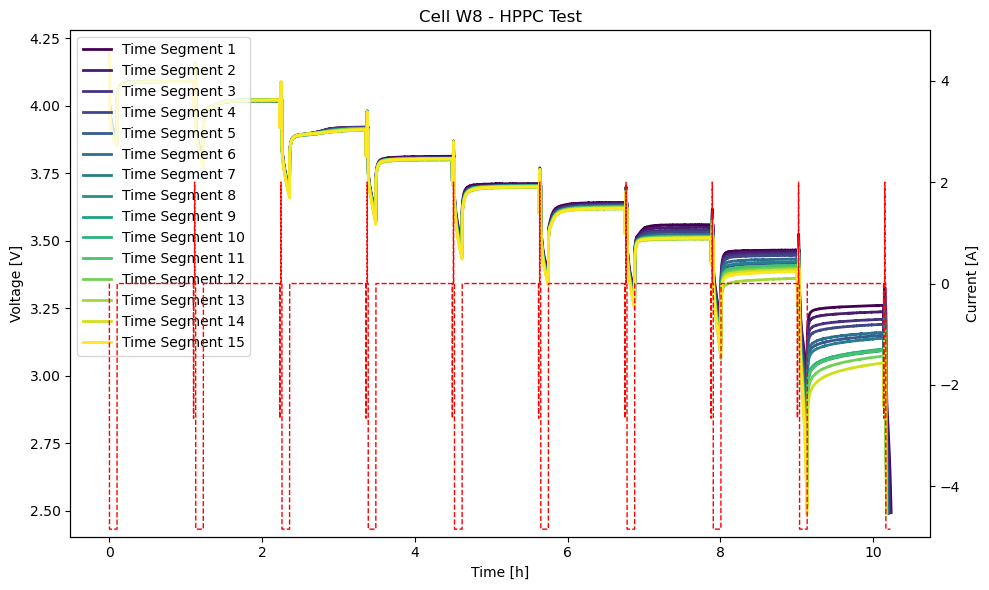

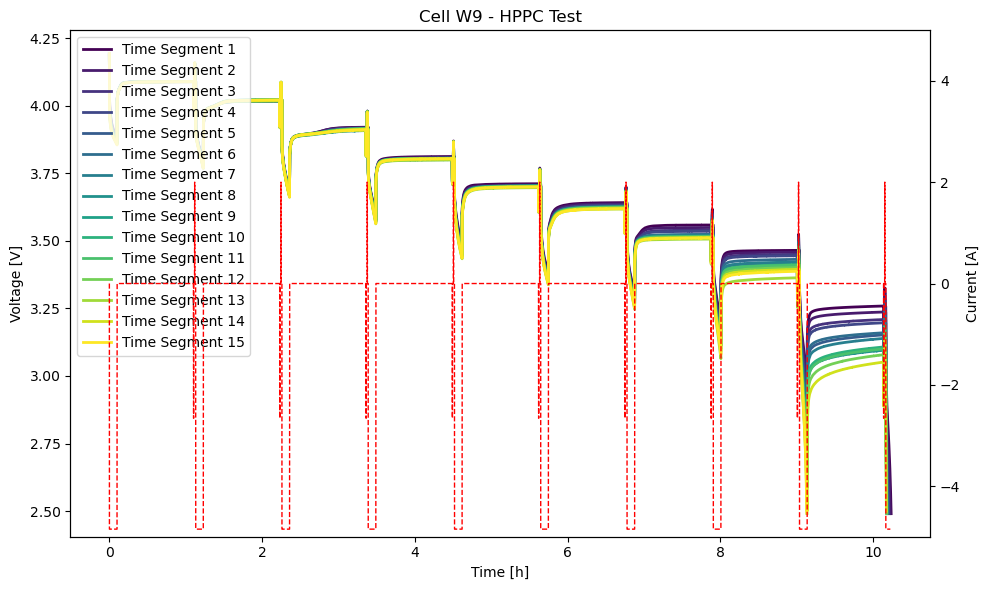

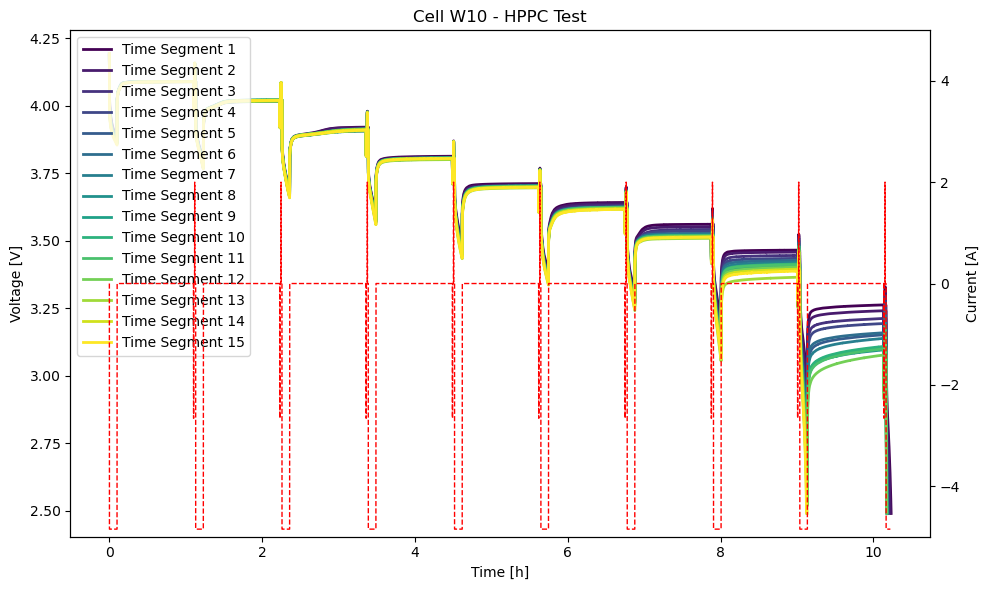

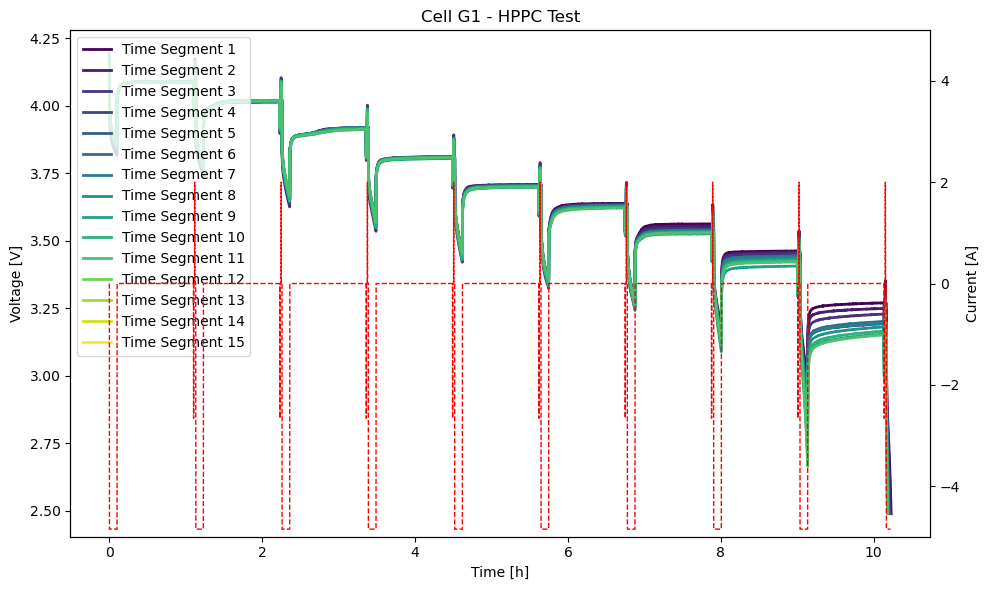

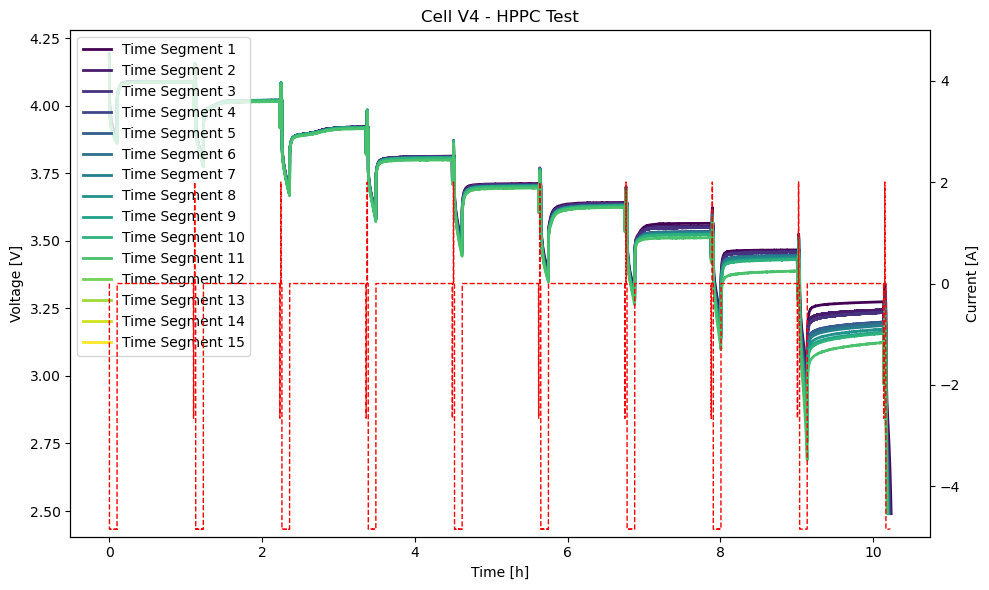

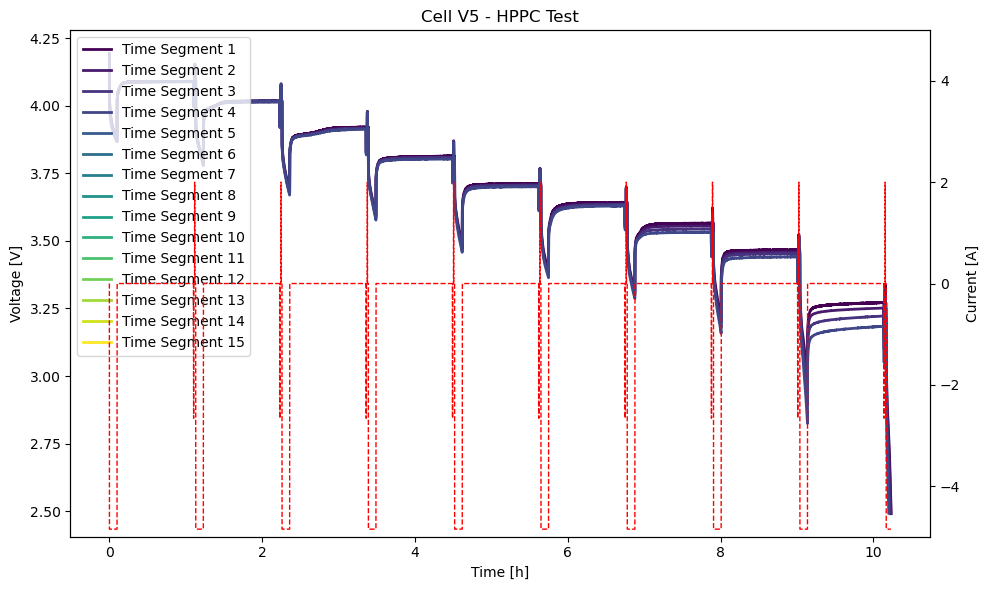

In [34]:
import matplotlib.pyplot as plt
import numpy as np

# Assume cycling_data is a dictionary with keys and preloaded arrays
# cycling_data['time'], cycling_data['vcell'], cycling_data['curr'], cycling_data['col_cell_label']
# my_colormap and legend_str are predefined lists for colors and labels.

# Define colormap and legend strings (customize as needed)
my_colormap = plt.cm.viridis(np.linspace(0, 1, len(cycling_data['time'])))
legend_str = [f'Time Segment {i+1}' for i in range(len(cycling_data['time']))]

# Iterate through all cells in 'col_cell_label'
for sel_cell in range(cycling_data['col_cell_label'].shape[1]):
    try:
        # Access cell label correctly
        cell_label = cycling_data['col_cell_label'][0, sel_cell][0]  # Adjust indexing
    except IndexError:
        cell_label = f"Unknown Cell {sel_cell}"

    # Initialize figure for the current cell
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Plot voltage data for each time segment
    for i in range(len(cycling_data['time'])):
        if cycling_data['vcell'][i, sel_cell].size > 0:  # Check if data exists
            ax1.plot(cycling_data['time'][i, sel_cell] / 3600, cycling_data['vcell'][i, sel_cell],
                     linewidth=2, color=my_colormap[i], label=legend_str[i])

    # Customize voltage y-axis
    ax1.set_xlabel('Time [h]')
    ax1.set_ylabel('Voltage [V]', color='k')
    ax1.tick_params(axis='y', labelcolor='k')

    # Add second y-axis for current
    ax2 = ax1.twinx()
    if cycling_data['curr'][1, sel_cell].size > 0:  # Check if current data exists
        ax2.plot(cycling_data['time'][1, sel_cell] / 3600, cycling_data['curr'][1, sel_cell],
                 linewidth=1, color='r', label='Current', linestyle='--')
    ax2.set_ylabel('Current [A]')
    ax2.set_ylim([-5, 5])  # Set y-axis limits for current

    # Add title and legend
    ax1.set_title(f'Cell {cell_label} - HPPC Test')
    ax1.legend(loc='upper left', fontsize=10)

    # Layout adjustment and show
    plt.tight_layout()
    plt.show()


 After analyising the Diagnostic tests: Cycling, HPPC and EIS tests we can see that only cells W8, W9 and W10 successfully go through all 15 Diagnostics so we will do our tests on these 3 cells. We are Starting with Cell W8

## Visualising and cleaning up data for Cell W8

In [47]:
W8_combined_data = pd.read_csv('W8_combined_data.csv')

In [142]:
W8_combined_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221293227 entries, 0 to 221293226
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 11.5 GB


In [143]:
W8_combined_data.shape

(221293227, 7)

In [144]:
W8_combined_data.columns[W8_combined_data.isnull().any()]

Index([], dtype='object')

In [145]:
W8_combined_data.isnull().sum()

Current               0
Voltage               0
Step_Index            0
Charge_Capacity       0
Discharge_Capacity    0
Time                  0
Cycle                 0
dtype: int64

In [6]:
duplicates = W8_combined_data.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")

Number of duplicate rows: 0


In [3]:
# Summary statistics
print(W8_combined_data.describe())


            Current       Voltage    Step_Index  Charge_Capacity  \
count  2.212932e+08  2.212932e+08  2.212932e+08     2.212932e+08   
mean  -8.061765e-03  3.902366e+00  9.657077e+00     1.983250e+00   
std    8.538351e-01  1.712200e-01  2.742494e+00     1.081043e+00   
min   -4.849548e+00  0.000000e+00  0.000000e+00     0.000000e+00   
25%   -7.259791e-04  3.834540e+00  8.000000e+00     6.863967e-01   
50%    9.098405e-05  3.999949e+00  8.000000e+00     2.681045e+00   
75%    9.537548e-04  4.000036e+00  1.400000e+01     2.749881e+00   
max    4.860508e+00  4.311186e+00  1.400000e+01     4.822381e+00   

       Discharge_Capacity          Time         Cycle  
count        2.212932e+08  2.212932e+08  2.212932e+08  
mean         7.989654e-01  1.969493e+06  6.220019e+00  
std          1.344501e+00  1.859937e+06  3.058165e+00  
min          0.000000e+00  0.000000e+00  1.000000e+00  
25%          2.077446e-02  5.366813e+05  4.000000e+00  
50%          4.757782e-02  1.281512e+06  7.000000e+

In [21]:
W8_combined_data['Current'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
221293222   -4.726364
221293223   -4.716759
221293224   -4.709518
221293225   -4.706367
221293226   -4.698074
Name: Current, Length: 221293227, dtype: float64>

In [25]:
W8_combined_data['Voltage'].describe

<bound method NDFrame.describe of 0            0.000000
1            3.096483
2            3.096541
3            3.096607
4            3.096365
               ...   
221293222    3.250176
221293223    3.250122
221293224    3.249741
221293225    3.249525
221293226    3.249765
Name: Voltage, Length: 221293227, dtype: float64>

In [26]:
W8_combined_data['Step_Index'].describe

<bound method NDFrame.describe of 0             0
1             1
2             1
3             1
4             1
             ..
221293222    14
221293223    14
221293224    14
221293225    14
221293226    14
Name: Step_Index, Length: 221293227, dtype: int64>

In [27]:
W8_combined_data['Charge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
221293222    0.803627
221293223    0.803627
221293224    0.803627
221293225    0.803627
221293226    0.803627
Name: Charge_Capacity, Length: 221293227, dtype: float64>

In [28]:
W8_combined_data['Discharge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
221293222    4.390116
221293223    4.390247
221293224    4.390378
221293225    4.390509
221293226    4.390588
Name: Discharge_Capacity, Length: 221293227, dtype: float64>

In [29]:
W8_combined_data['Time'].describe

<bound method NDFrame.describe of 0                 0.000000
1                 0.100800
2                 0.200800
3                 0.300200
4                 0.400400
                 ...      
221293222    836396.806912
221293223    836396.906412
221293224    836397.006012
221293225    836397.106012
221293226    836397.166612
Name: Time, Length: 221293227, dtype: float64>

In [30]:
W8_combined_data['Cycle'].describe

<bound method NDFrame.describe of 0             1
1             1
2             1
3             1
4             1
             ..
221293222    14
221293223    14
221293224    14
221293225    14
221293226    14
Name: Cycle, Length: 221293227, dtype: int64>

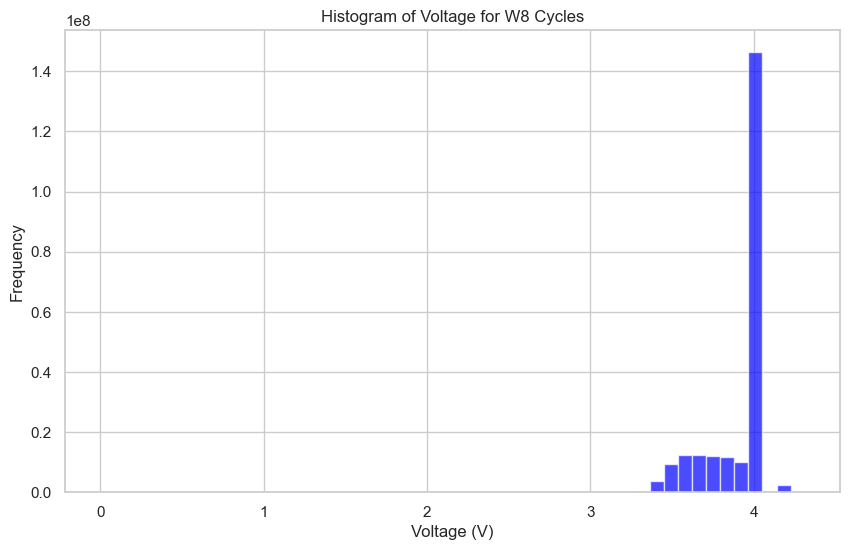

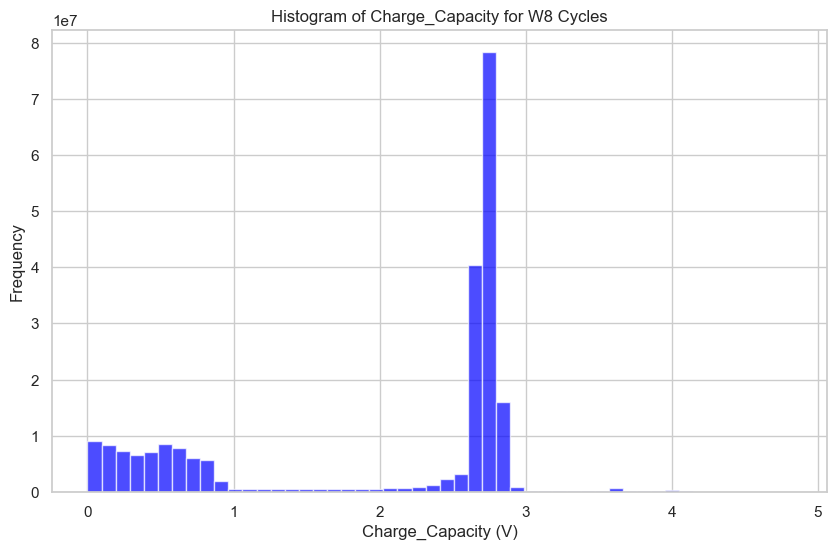

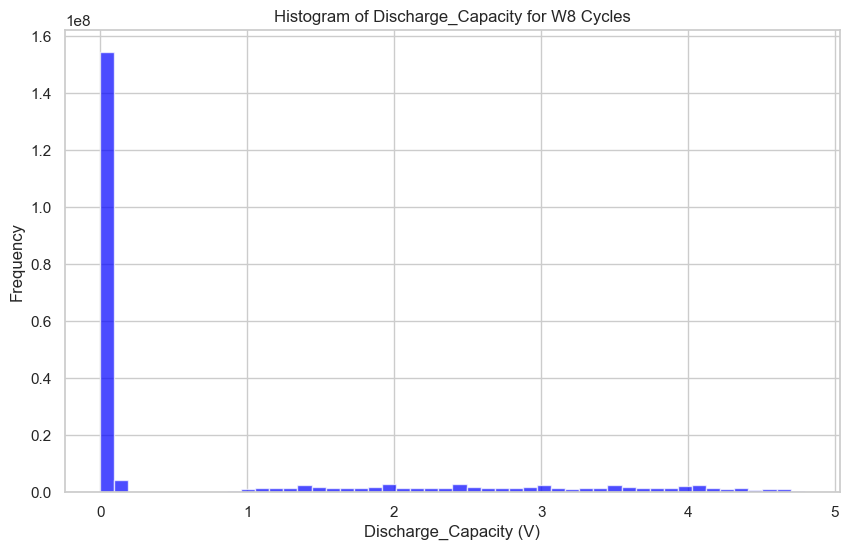

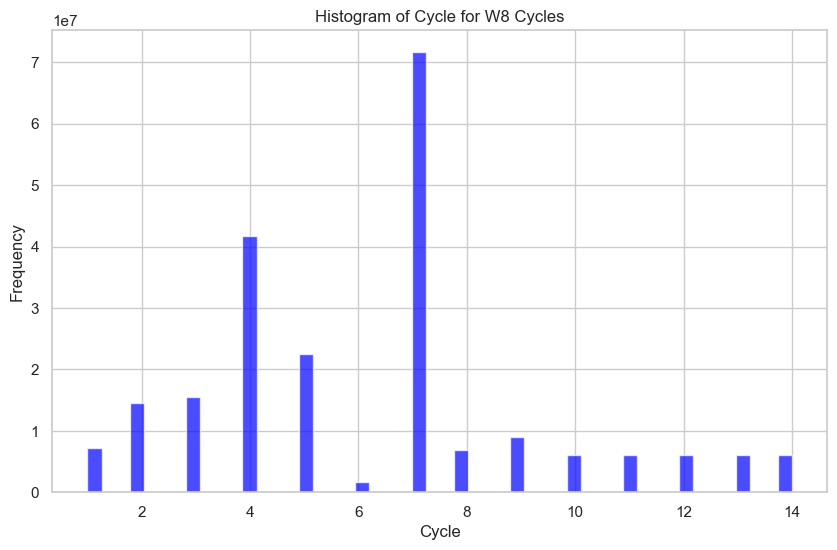

In [148]:
# Step 1: Plot histogram of voltage values
plt.figure(figsize=(10, 6))
plt.hist(W8_combined_data['Voltage'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Voltage (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Voltage for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Charge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W8_combined_data['Charge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Charge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Charge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Discharge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W8_combined_data['Discharge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Discharge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Discharge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Cycle values
plt.figure(figsize=(10, 6))
plt.hist(W8_combined_data['Cycle'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W8 Cycles')
plt.show()

d:\SN750\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


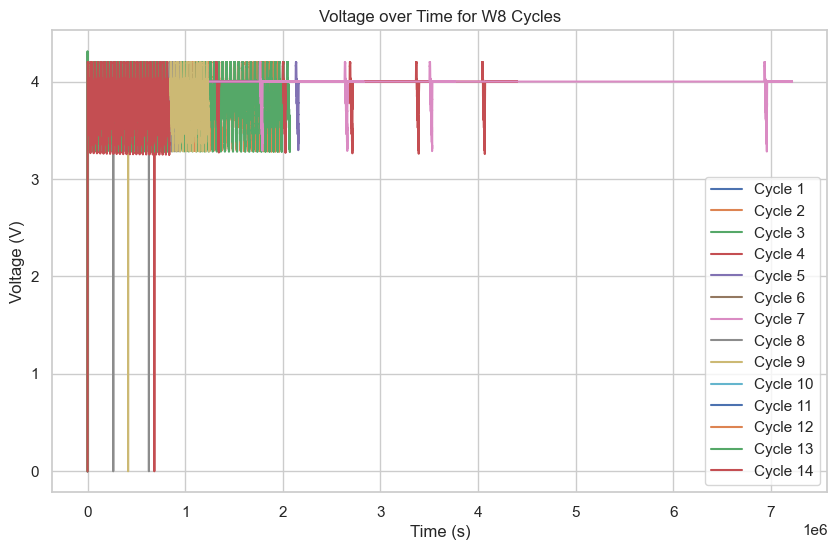

In [ ]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W8_combined_data['Cycle'].unique():
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

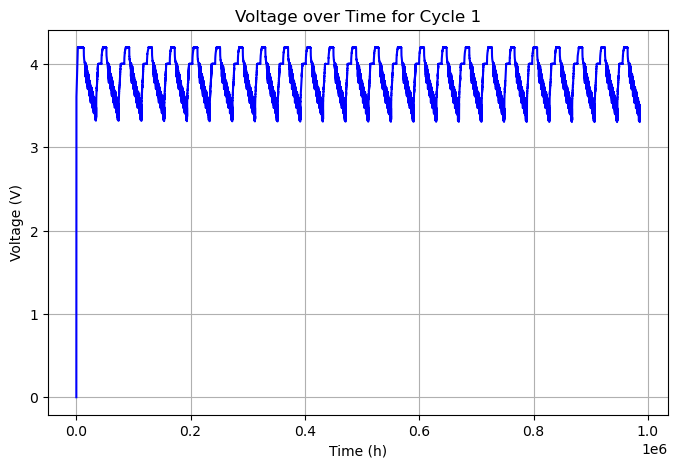

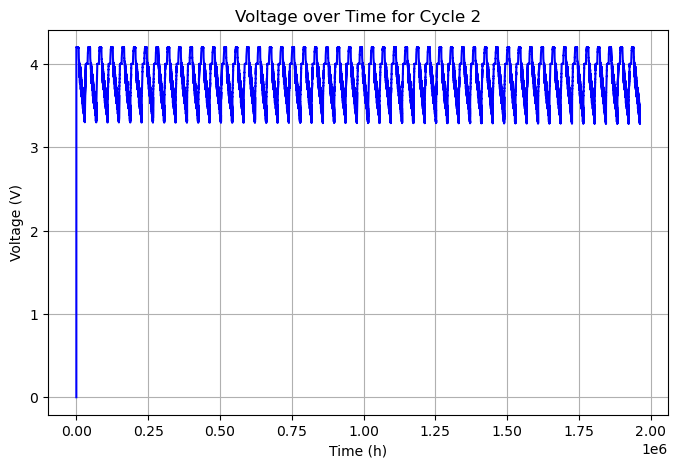

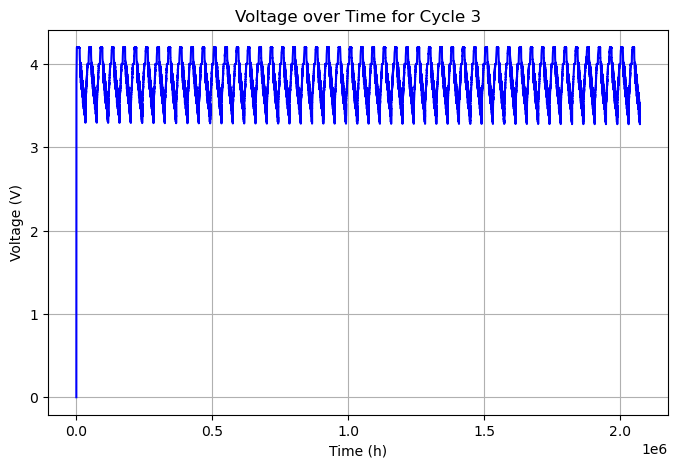

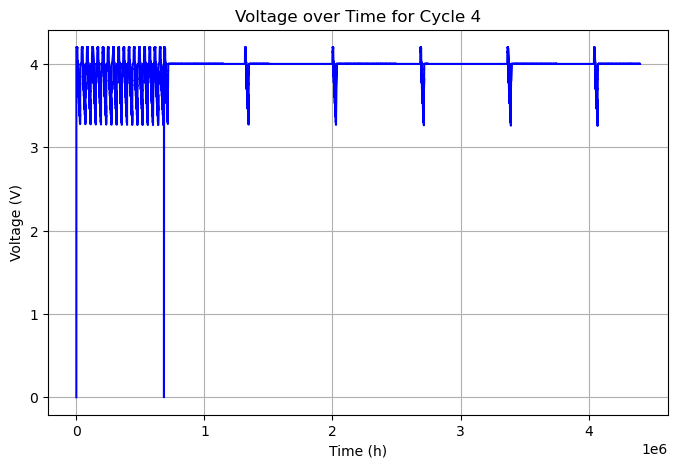

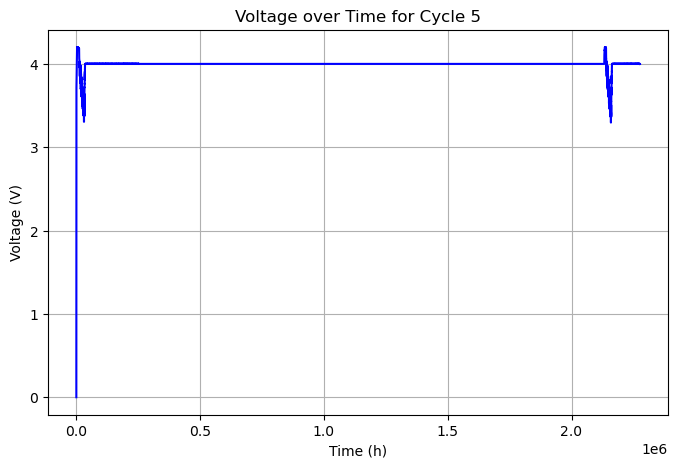

...

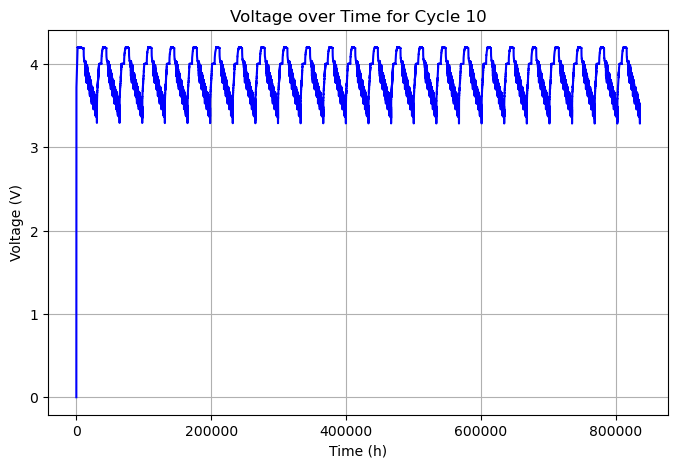

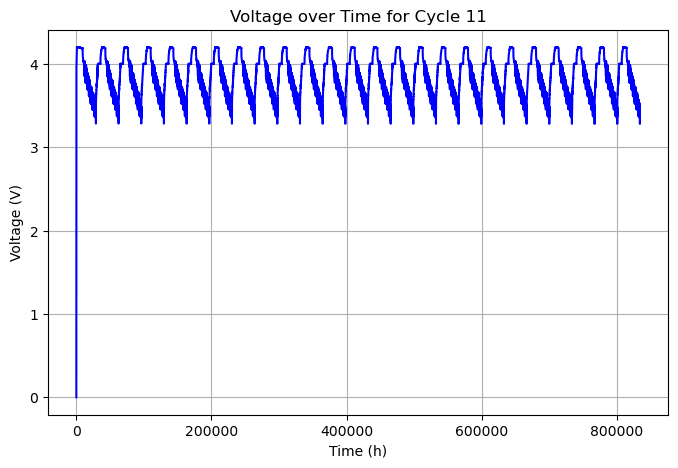

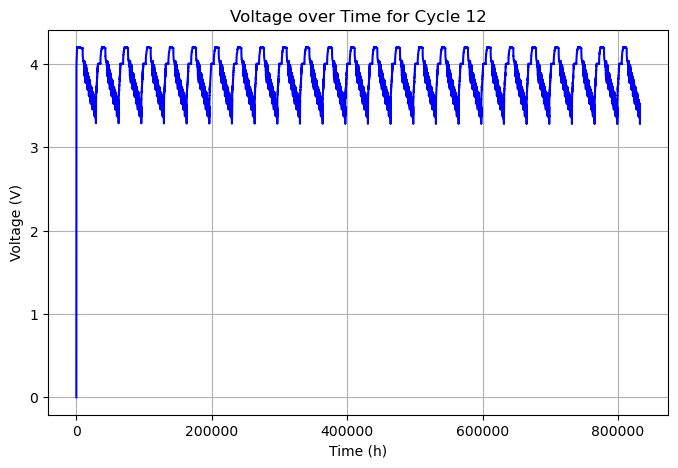

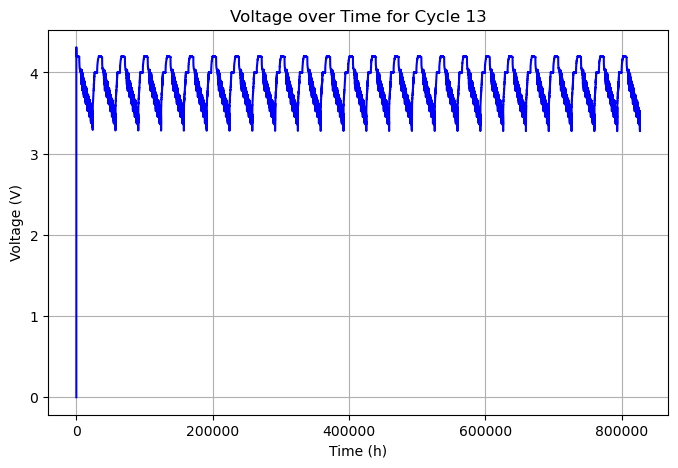

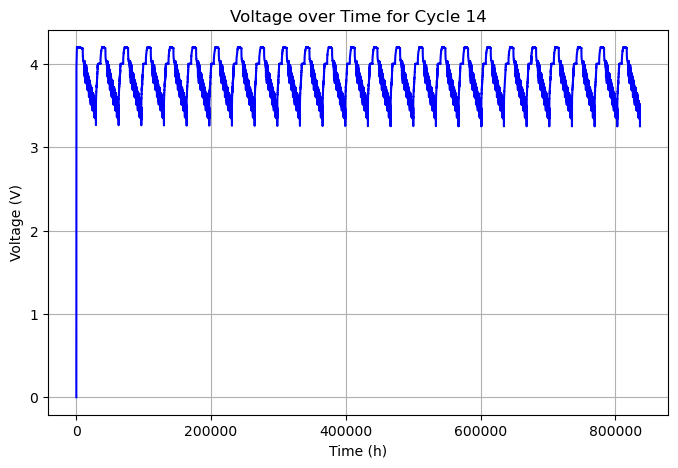

In [14]:
# Loop through each unique cycle and create a separate plot
for cycle in W8_combined_data['Cycle'].unique():
    # Filter data for the current cycle
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))  # Adjust figure size if needed
    
    # Plot Voltage vs. Time for the current cycle
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], color='blue', linewidth=1.5)
    
    # Add labels, title, and formatting
    plt.xlabel('Time (h)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage over Time for Cycle {cycle}')
    
    # Optional: Add grid for better visibility
    plt.grid(True)
    
    # Show the plot
    plt.show()


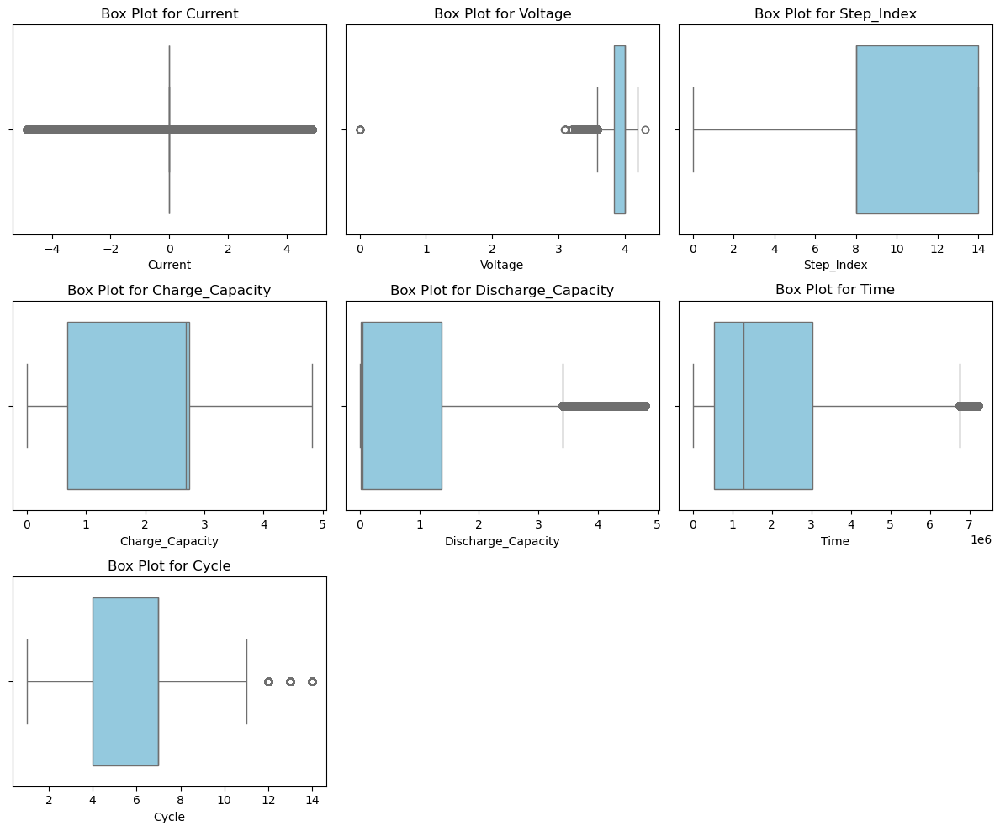

In [ ]:
numerical_columns = ['Current', 'Voltage', 'Step_Index', 'Charge_Capacity', 
                     'Discharge_Capacity', 'Time', 'Cycle']

# Create a figure and a grid of subplots for boxplots
plt.figure(figsize=(12, 10))
for idx, column in enumerate(numerical_columns, 1):
    plt.subplot(3, 3, idx)  # 3x3 grid layout
    sns.boxplot(x=W8_combined_data[column], color='skyblue')
    plt.title(f'Box Plot for {column}')
    plt.xlabel(column)

# Adjust layout to avoid overlap
plt.tight_layout()
plt.show()

In [4]:
# Filter rows where Voltage is 0
voltage_zeros = W8_combined_data[W8_combined_data['Voltage'] == 0]
print(f"Rows with Voltage = 0:\n{voltage_zeros}")

Rows with Voltage = 0:
           Current  Voltage  Step_Index  Charge_Capacity  Discharge_Capacity  \
0              0.0      0.0           0              0.0                 0.0   
7239558        0.0      0.0           0              0.0                 0.0   
21724672       0.0      0.0           0              0.0                 0.0   
37266595       0.0      0.0           0              0.0                 0.0   
42357902       0.0      0.0           0              0.0                 0.0   
78972444       0.0      0.0           0              0.0                 0.0   
101522247      0.0      0.0           0              0.0                 0.0   
103208210      0.0      0.0           0              0.0                 0.0   
174860603      0.0      0.0           0              0.0                 0.0   
176811940      0.0      0.0           0              0.0                 0.0   
179484236      0.0      0.0           0              0.0                 0.0   
181769771      0.

In [10]:
# Remove rows where Voltage is 0
W8_combined_data_cleaned = W8_combined_data[W8_combined_data['Voltage'] > 0]

# Remove rows where Time is 2
#W8_combined_data_cleaned = W8_combined_data_cleaned[W8_combined_data_cleaned['Time'] < 3]

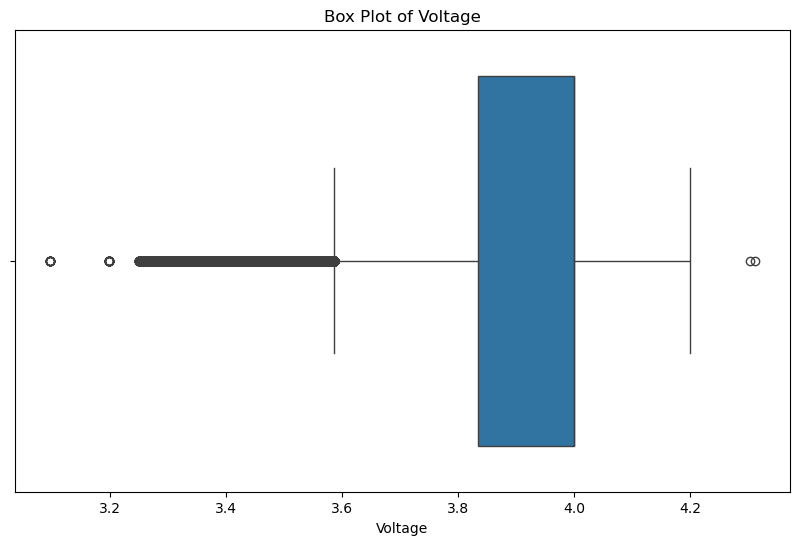

In [ ]:
# Create a box plot of the 'Voltage' column after remove the 0 values
plt.figure(figsize=(10, 6))
sns.boxplot(x='Voltage', data=W8_combined_data_cleaned)
plt.title('Box Plot of Voltage')
plt.xlabel('Voltage')
plt.show()

In [5]:
# Filter rows where Time is 2
time_at_2 = W8_combined_data[W8_combined_data['Time'] > 2]
print(f"Rows with Time = 2:\n{time_at_2}")


Rows with Time = 2:
            Current   Voltage  Step_Index  Charge_Capacity  \
12         4.835693  3.278803           2         0.001335   
13         4.839722  3.288605           2         0.002679   
14         4.839813  3.296411           2         0.004027   
15         4.838257  3.303043           2         0.005370   
16         4.839325  3.309290           2         0.006709   
...             ...       ...         ...              ...   
221293222 -4.726364  3.250176          14         0.803627   
221293223 -4.716759  3.250122          14         0.803627   
221293224 -4.709518  3.249741          14         0.803627   
221293225 -4.706367  3.249525          14         0.803627   
221293226 -4.698074  3.249765          14         0.803627   

           Discharge_Capacity           Time  Cycle  
12                   0.000053       2.050300      1  
13                   0.000053       3.049900      1  
14                   0.000053       4.050000      1  
15                 

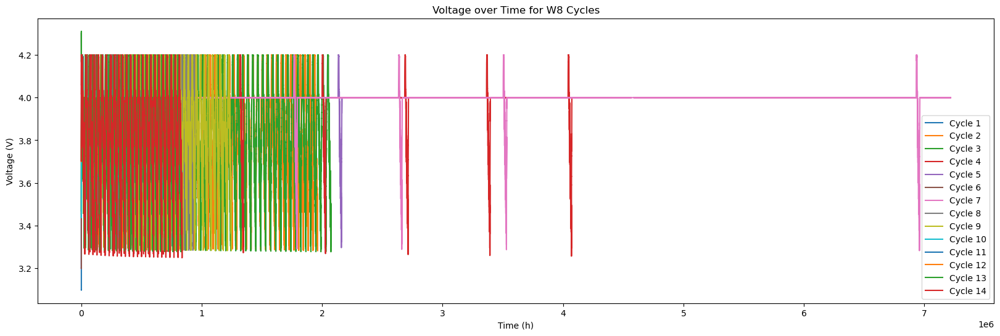

In [15]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(20, 6))
for cycle in W8_combined_data_cleaned['Cycle'].unique():
    cycle_data = W8_combined_data_cleaned[W8_combined_data_cleaned['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

d:\SN750\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


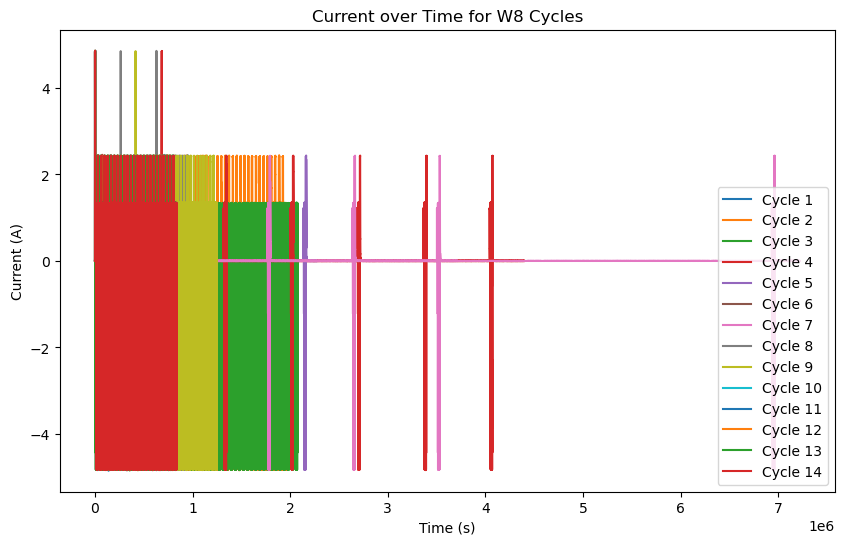

In [ ]:
# Current vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W8_combined_data['Cycle'].unique():
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Current'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Current (A)')
plt.title('Current over Time for W8 Cycles')
plt.legend()
plt.show()



C:\Users\ymuba\AppData\Local\Temp\ipykernel_17596\3940001502.py:32: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
d:\SN750\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


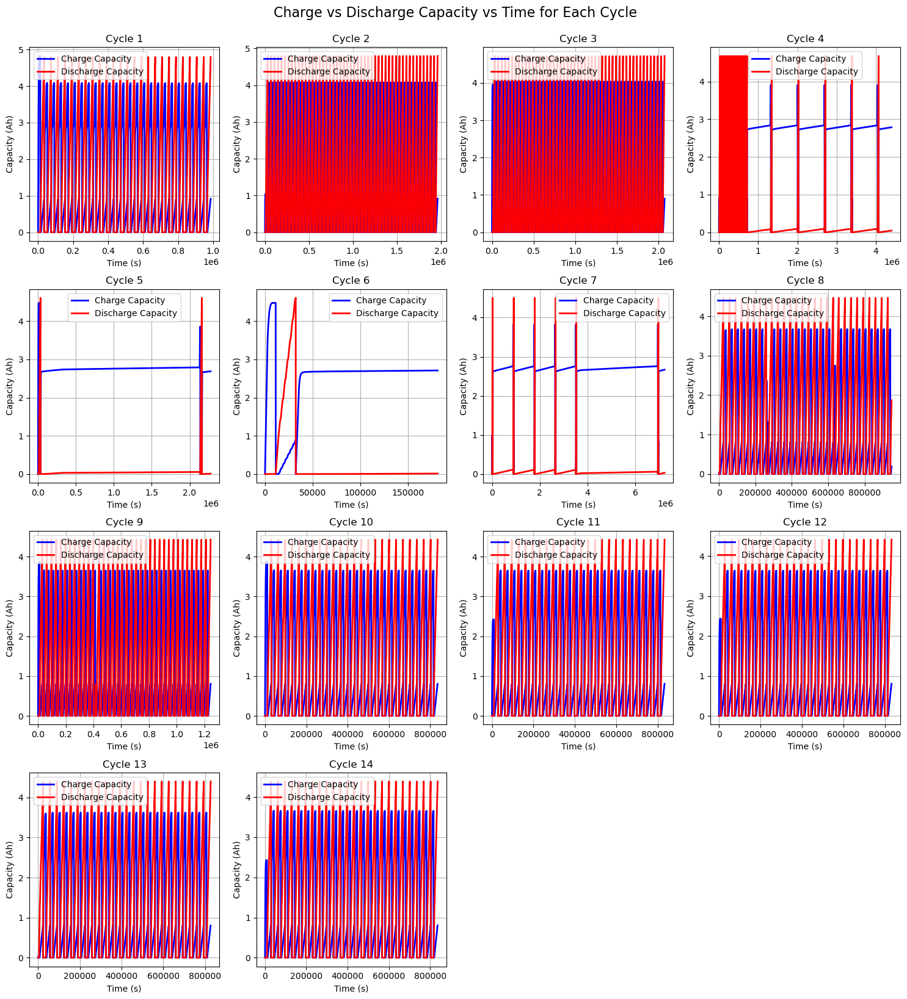

In [ ]:
# Get unique cycles
unique_cycles = W8_combined_data['Cycle'].unique()
num_cycles = len(unique_cycles)

# Determine grid layout for subplots
rows = (num_cycles + 3) // 4  # Adjust rows based on number of cycles
cols = min(4, num_cycles)  # Up to 4 graphs per row

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 4))
axes = axes.flatten()  # Flatten axes for easy iteration

# Plot each cycle's Charge and Discharge Capacity vs. Time
for i, cycle in enumerate(unique_cycles):
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    ax = axes[i]
    ax.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    ax.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    ax.set_title(f'Cycle {cycle}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Capacity (Ah)')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.suptitle('Charge vs Discharge Capacity vs Time for Each Cycle', fontsize=16, y=1.02)
plt.show()


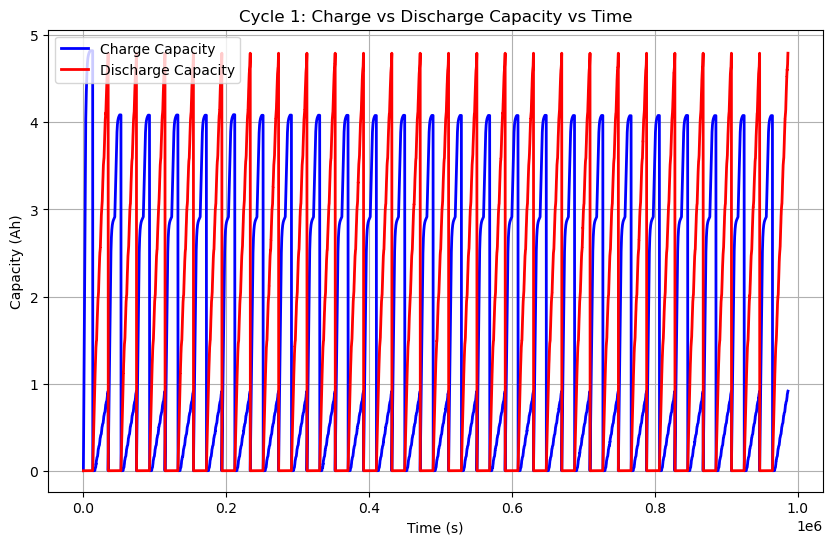

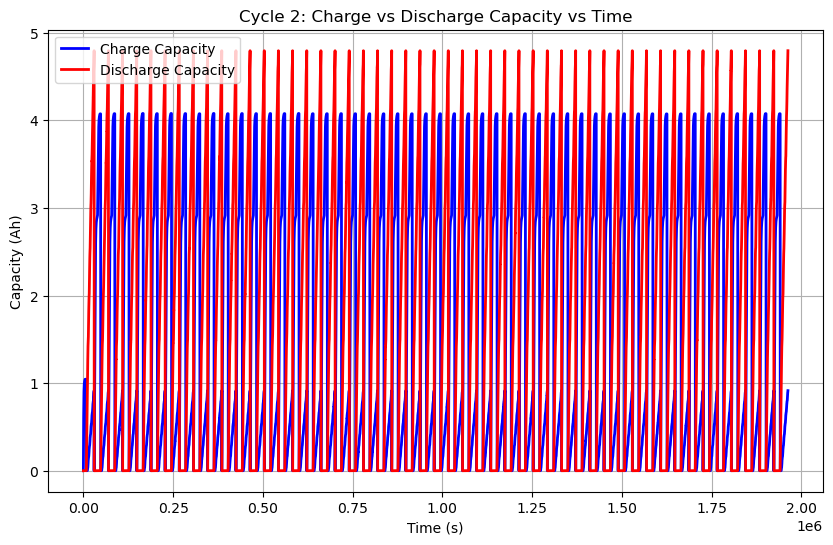

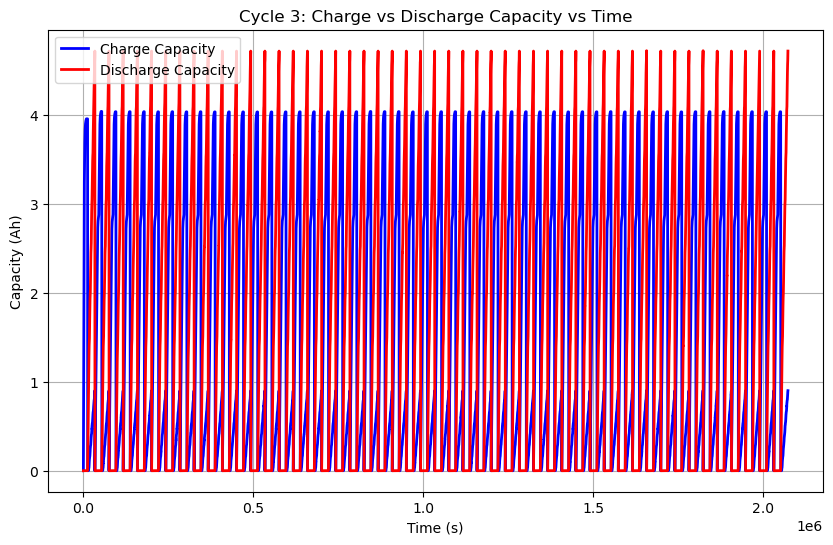

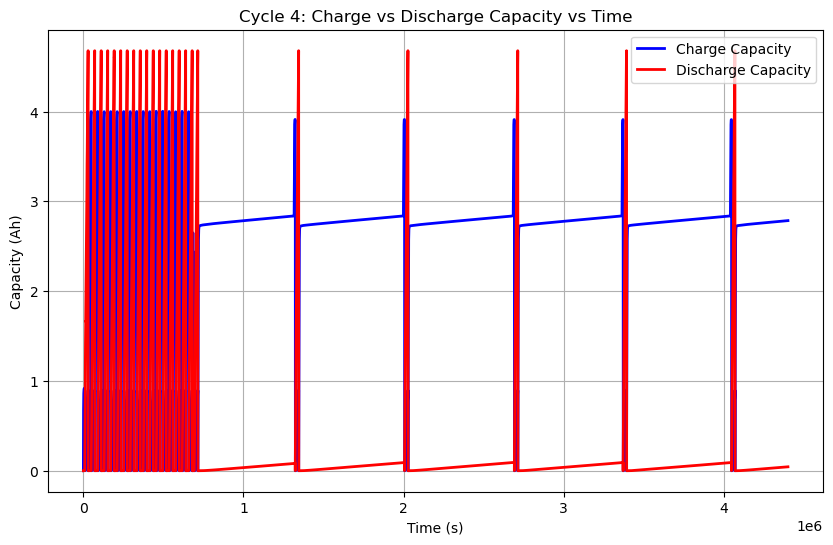

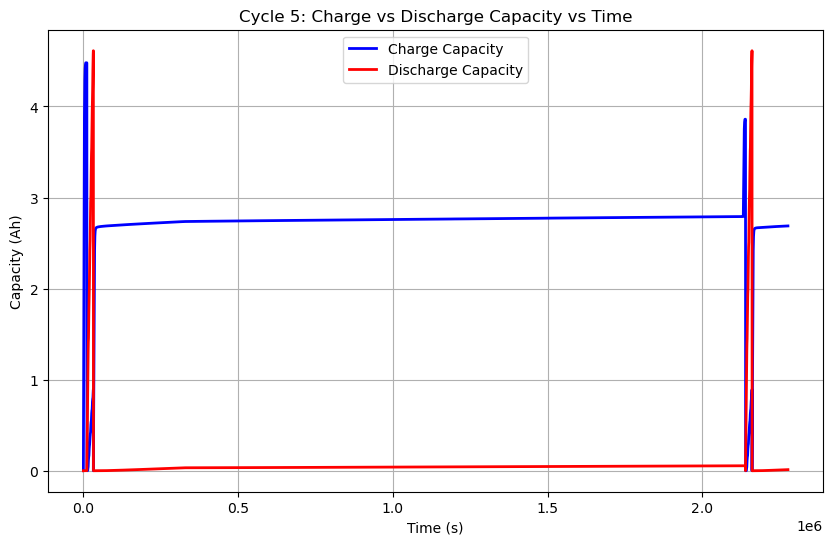

...

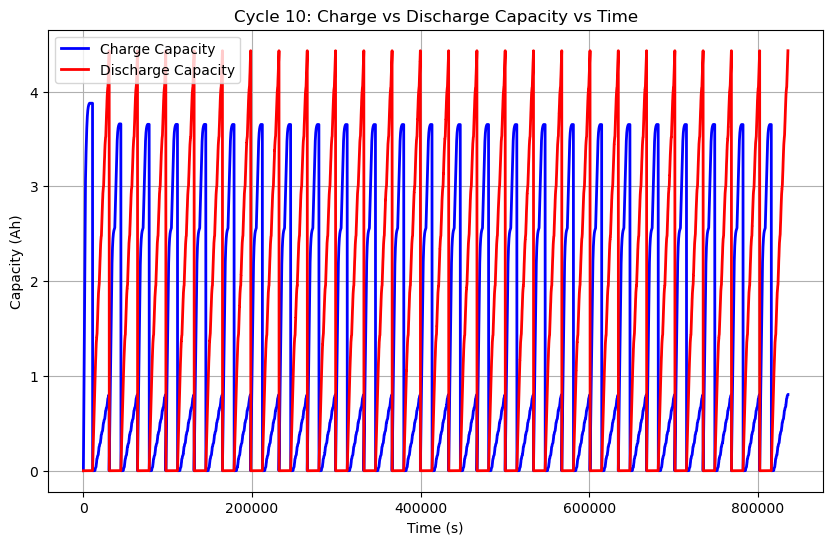

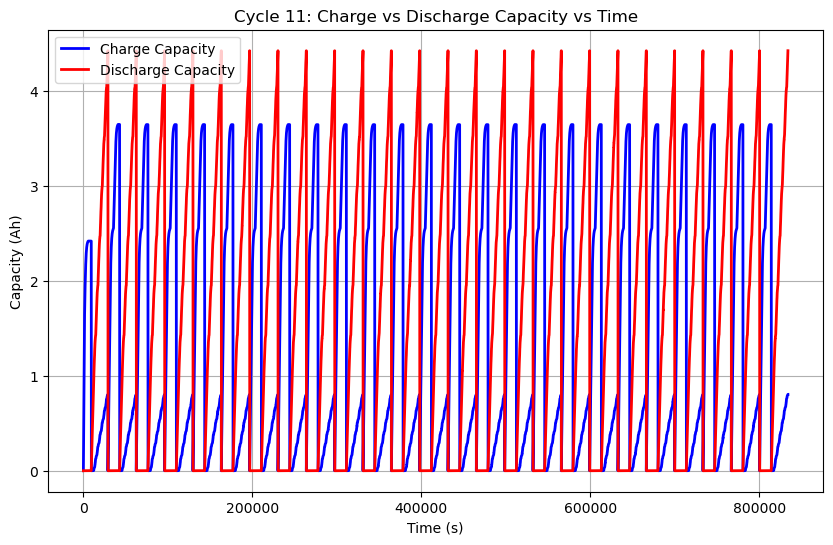

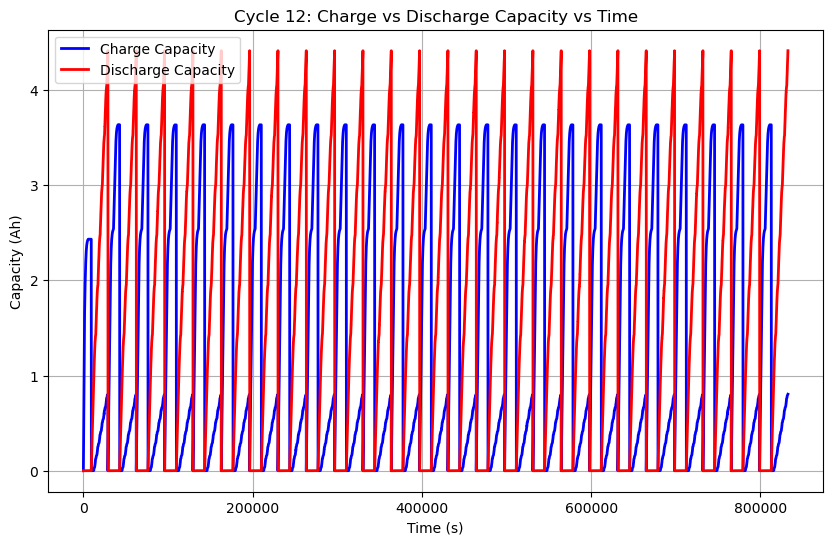

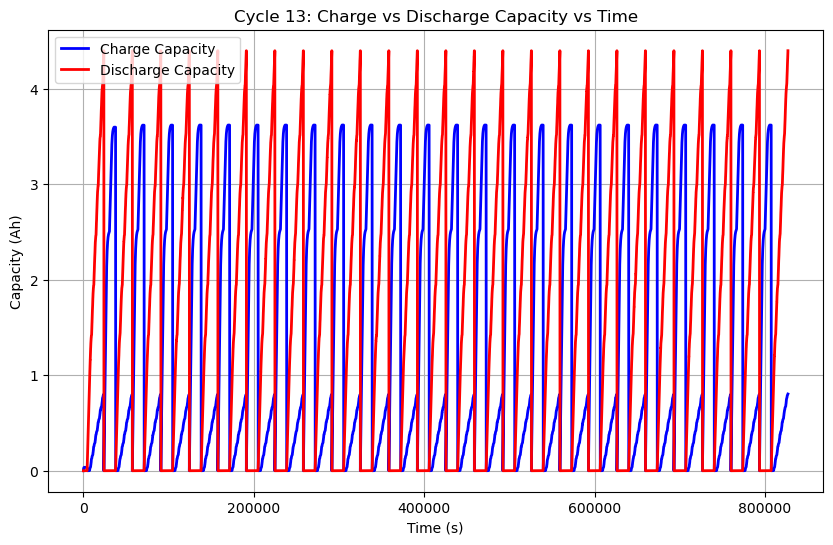

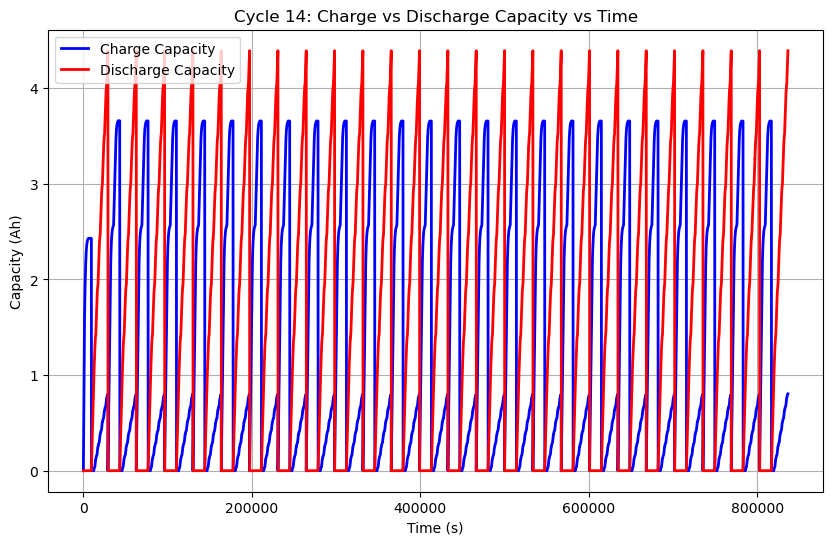

In [5]:
for cycle in unique_cycles:
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(10, 6))  # Create a new figure for each cycle
    plt.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    plt.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    
    plt.title(f'Cycle {cycle}: Charge vs Discharge Capacity vs Time')
    plt.xlabel('Time (s)')
    plt.ylabel('Capacity (Ah)')
    plt.legend()
    plt.grid(True)
    
    plt.show() 

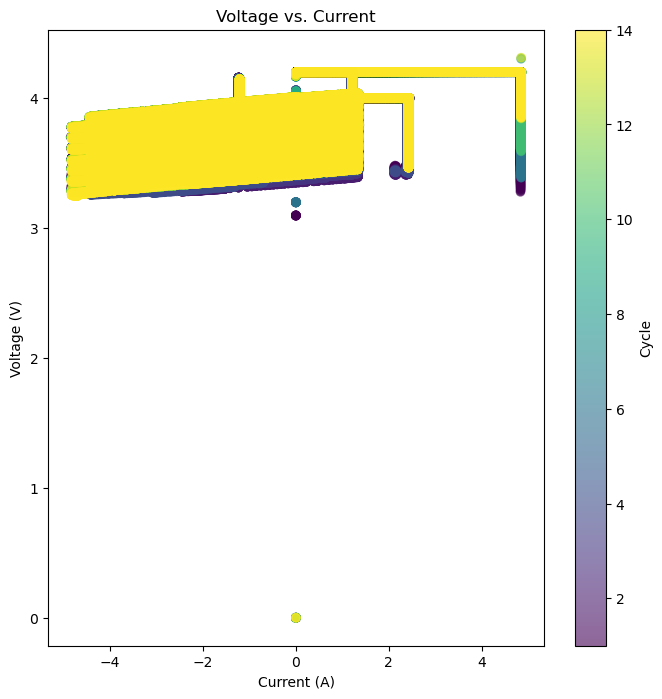

In [6]:
# Voltage vs. Current scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(W8_combined_data['Current'], W8_combined_data['Voltage'], alpha=0.6, c=W8_combined_data['Cycle'], cmap='viridis')
plt.colorbar(label='Cycle')
plt.xlabel('Current (A)')
plt.ylabel('Voltage (V)')
plt.title('Voltage vs. Current')
plt.show()


In [17]:
# Group data by cycle and normalize Charge_Capacity to calculate SoC
W8_combined_data['SoC'] = W8_combined_data.groupby('Cycle')['Charge_Capacity'].transform(
    lambda x: x / x.max()
)


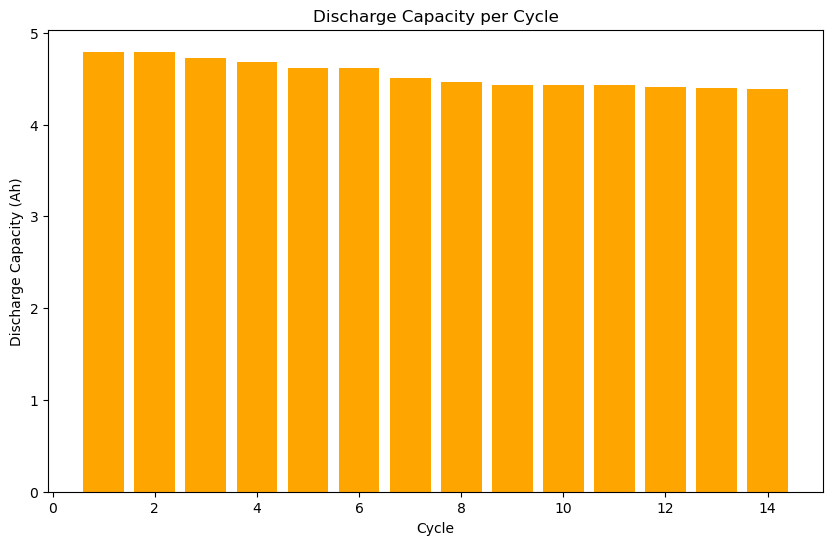

In [18]:
# Calculate total discharge capacity per cycle
discharge_capacity_per_cycle = W8_combined_data.groupby('Cycle')['Discharge_Capacity'].max()

# Plot Discharge Capacity per Cycle
plt.figure(figsize=(10, 6))
plt.bar(discharge_capacity_per_cycle.index, discharge_capacity_per_cycle.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (Ah)')
plt.title('Discharge Capacity per Cycle')
plt.show()


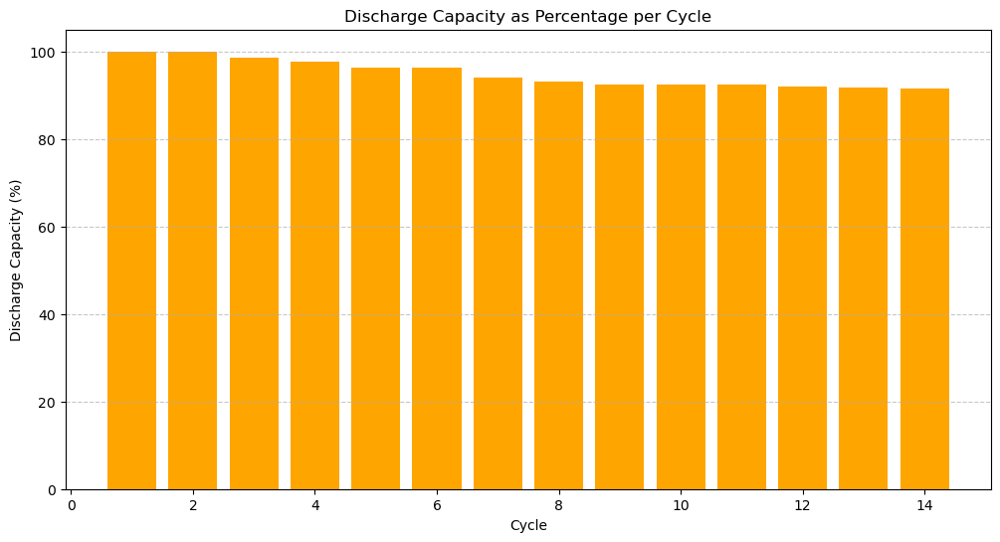

In [22]:
# Calculate the maximum discharge capacity across all cycles
max_discharge_capacity = W8_combined_data['Discharge_Capacity'].max()

# Calculate the maximum discharge capacity per cycle and convert to percentage
discharge_capacity_per_cycle = W8_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

# Plot Discharge Capacity as Percentage per Cycle
plt.figure(figsize=(12, 6))
plt.bar(discharge_capacity_percentage.index, discharge_capacity_percentage.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle')
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add grid for better readability
plt.show()


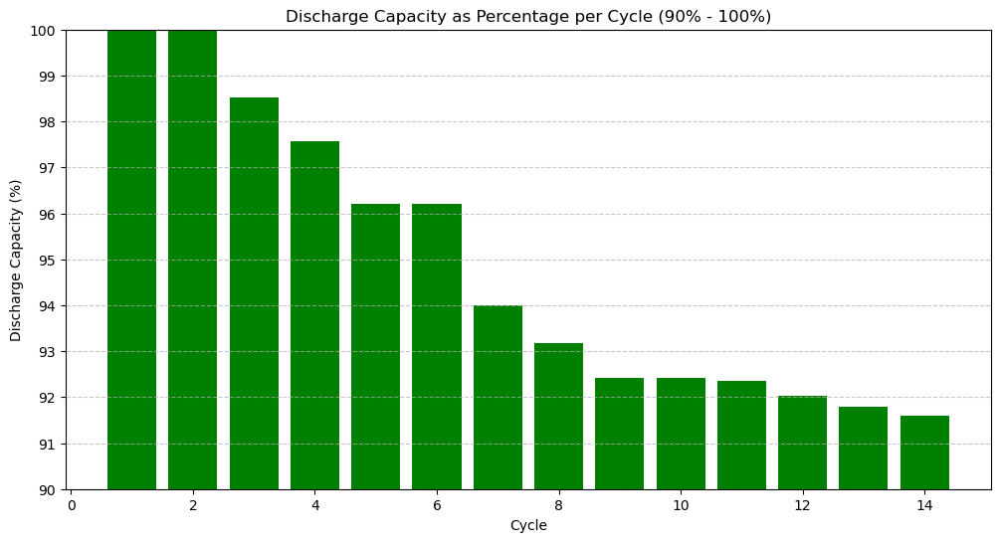

In [27]:
# Filter to keep only values between 90% and 100%
filtered_capacity_percentage = discharge_capacity_percentage[
    (discharge_capacity_percentage >= 90) & (discharge_capacity_percentage <= 100)
]

# Plot Discharge Capacity as Percentage (90% to 100%)
plt.figure(figsize=(12, 6))
plt.bar(filtered_capacity_percentage.index, filtered_capacity_percentage.values, color='green')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Set y-axis limits to zoom in between 90% and 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks at every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



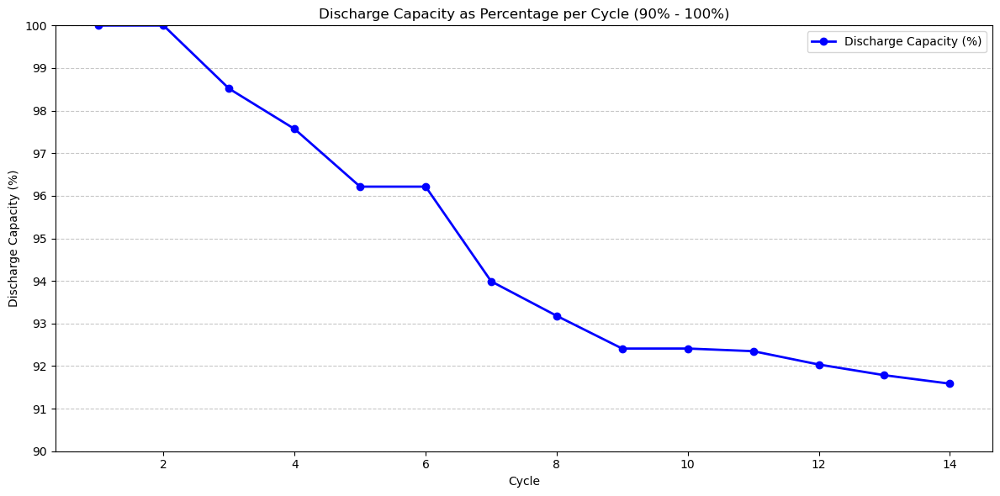

In [25]:
plt.figure(figsize=(12, 6))
plt.plot(filtered_capacity_percentage.index, filtered_capacity_percentage.values, 
         color='blue', marker='o', linestyle='-', linewidth=2, markersize=6, label='Discharge Capacity (%)')

# Add labels, title, grid, and ticks
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Focus on 90% to 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.show()

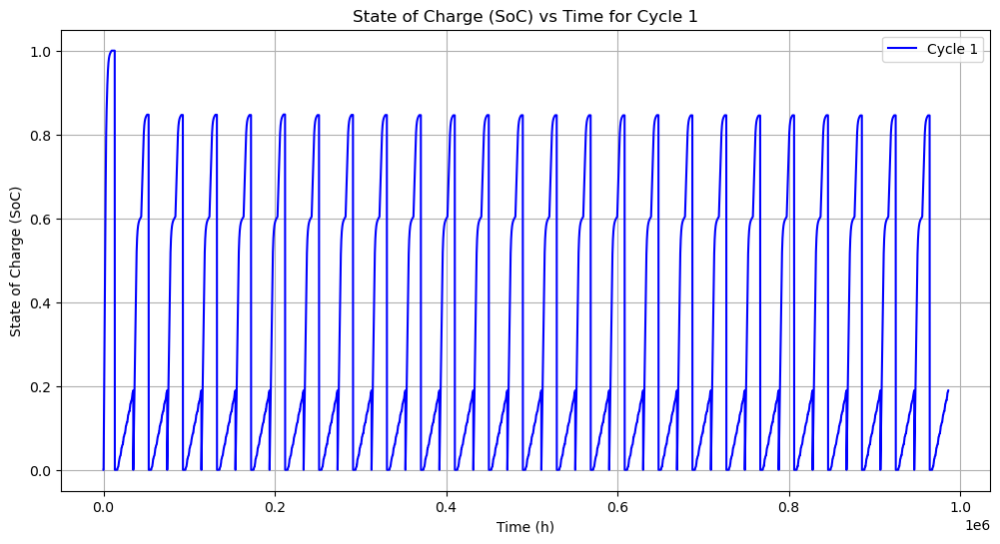

d:\SN750\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


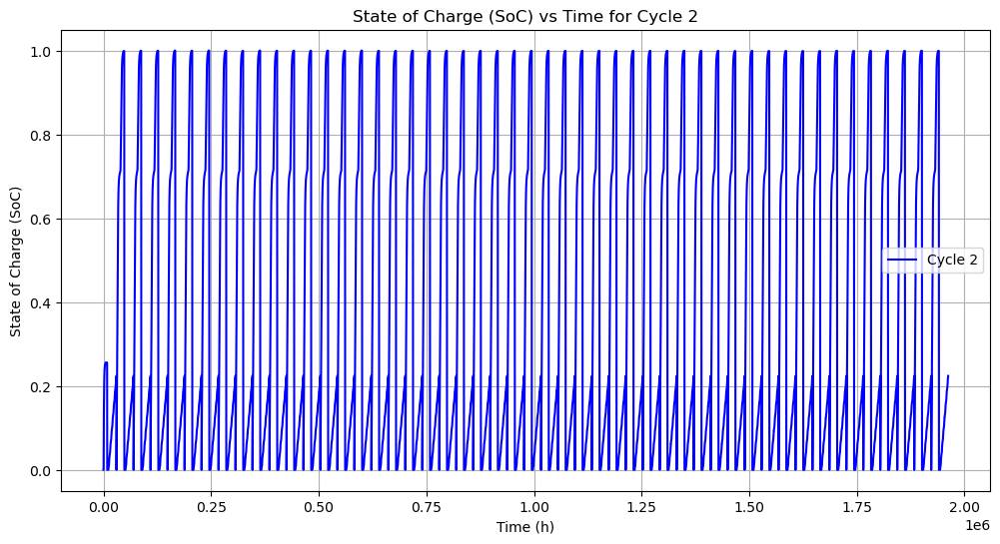

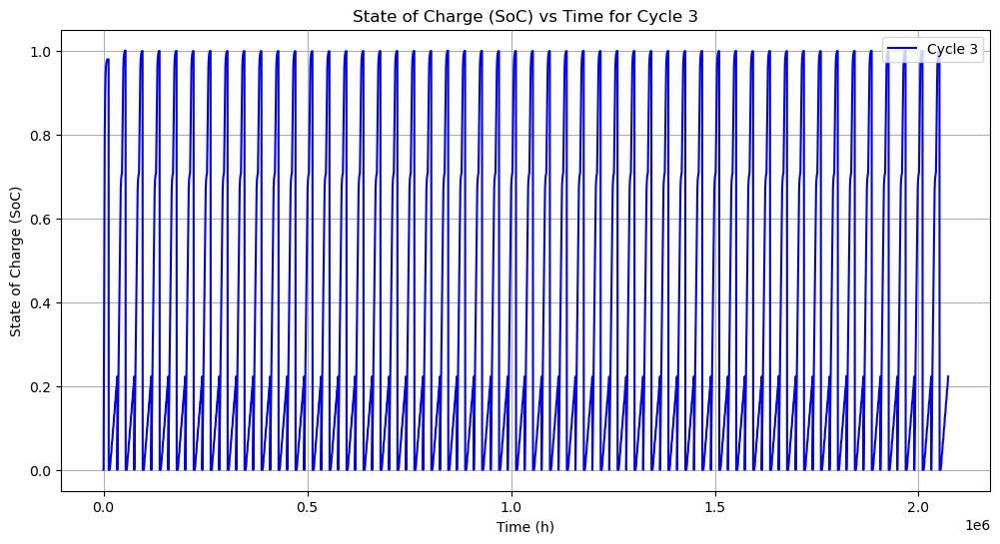

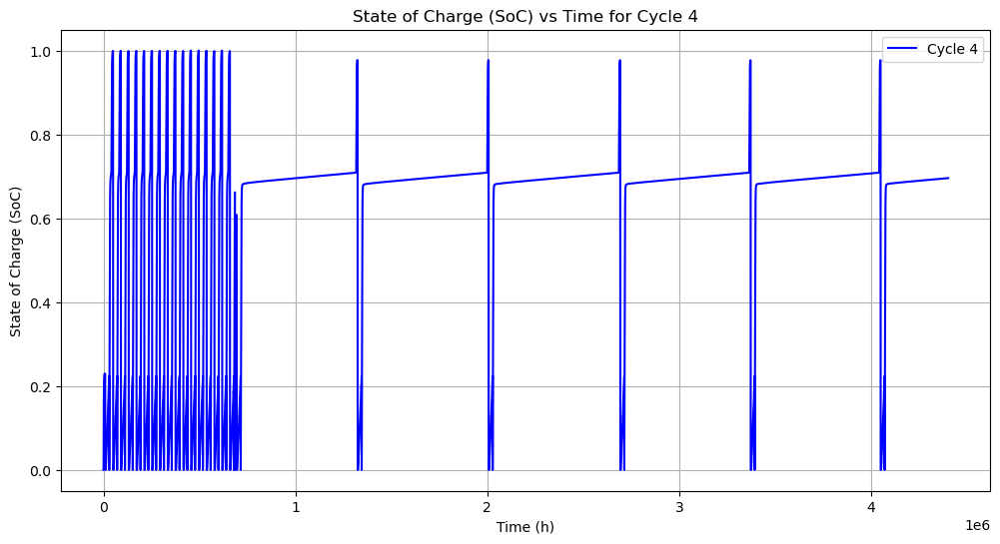

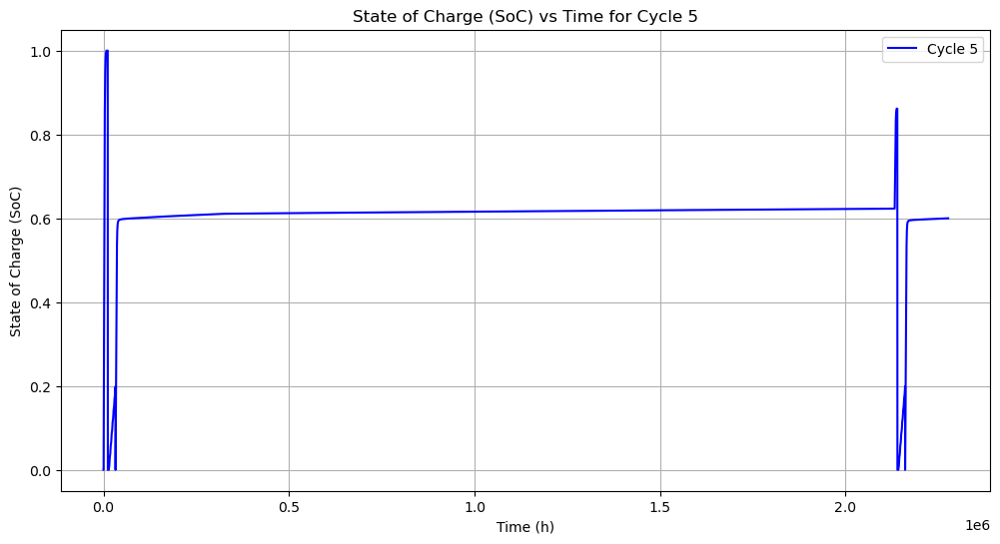

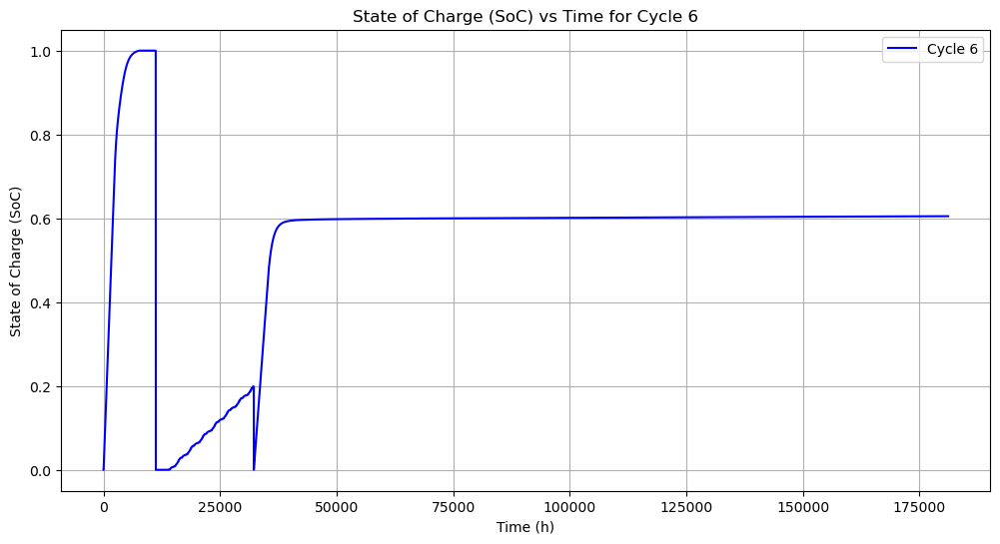

...

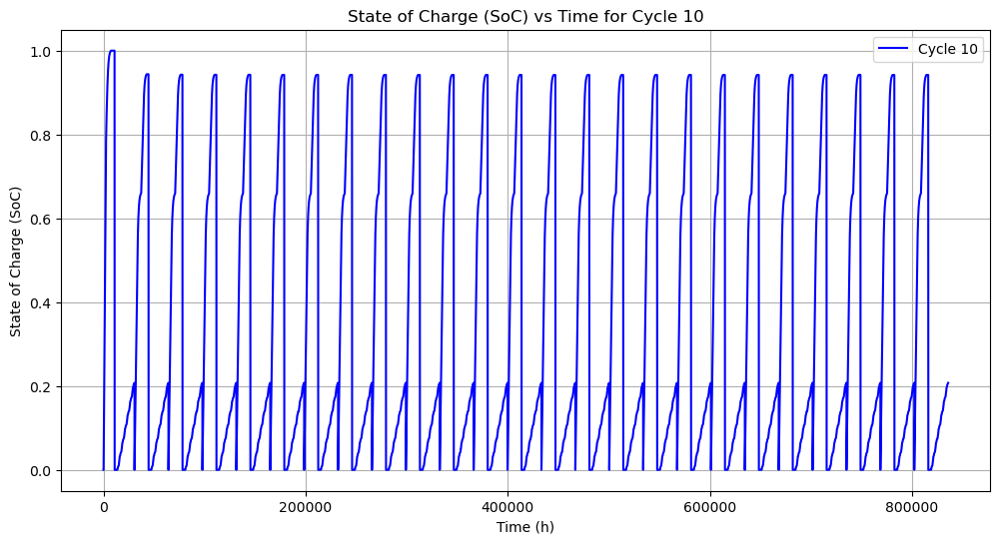

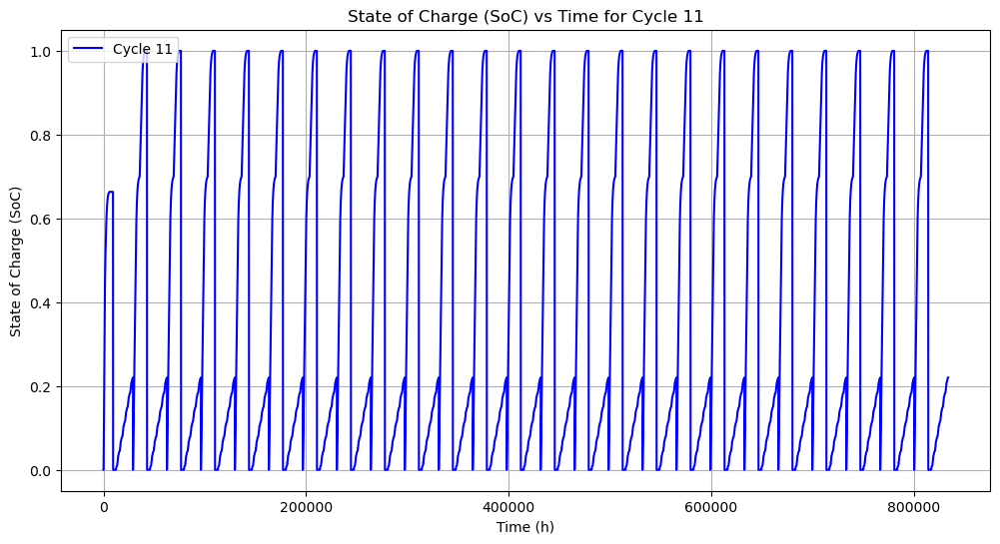

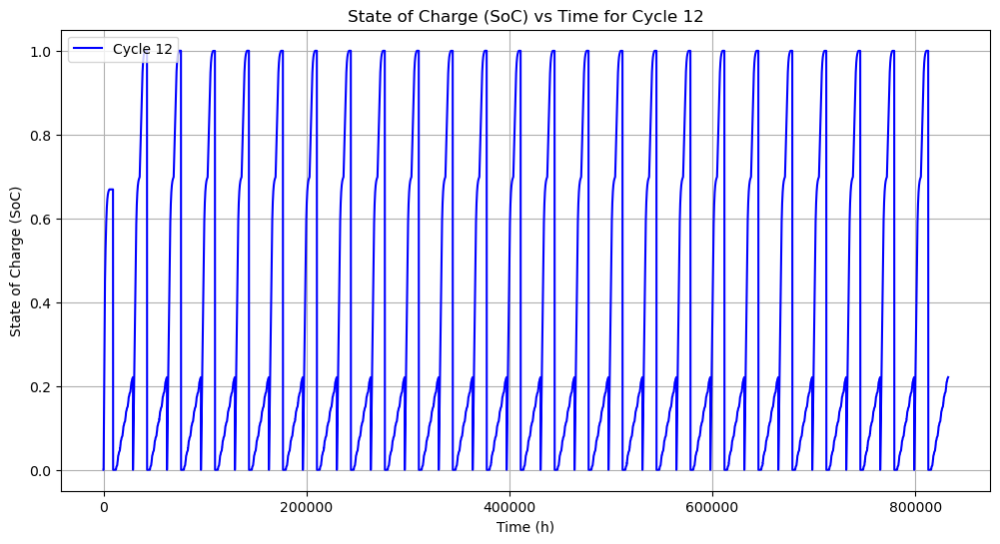

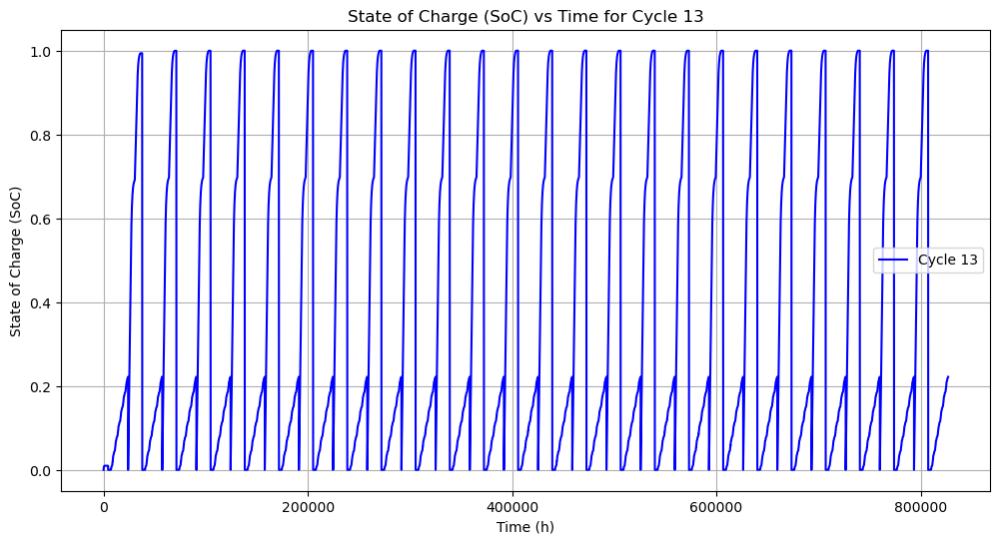

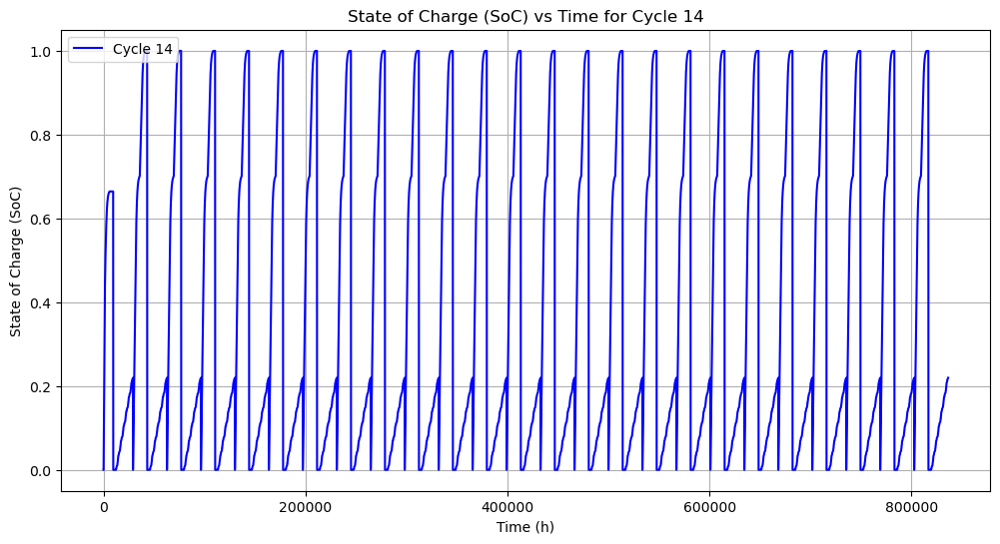

In [21]:
# Loop through each unique cycle and plot SoC vs. Time
for cycle in W8_combined_data['Cycle'].unique():
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(12, 6))  # Adjust the figure size for better visibility
    plt.plot(cycle_data['Time'], cycle_data['SoC'], label=f'Cycle {cycle}', color='blue')
    plt.xlabel('Time (h)')
    plt.ylabel('State of Charge (SoC)')
    plt.title(f'State of Charge (SoC) vs Time for Cycle {cycle}')
    plt.legend()
    plt.grid()
    plt.show()



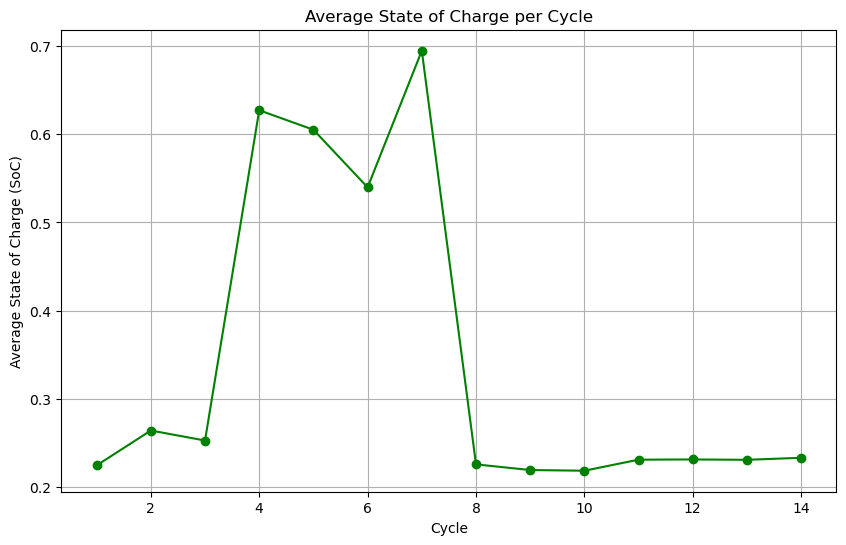

In [19]:
# Calculate average SoC per cycle
average_soc_per_cycle = W8_combined_data.groupby('Cycle')['SoC'].mean()

# Plot Average SoC per Cycle
plt.figure(figsize=(10, 6))
plt.plot(average_soc_per_cycle.index, average_soc_per_cycle.values, marker='o', color='green', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Average State of Charge (SoC)')
plt.title('Average State of Charge per Cycle')
plt.grid()
plt.show()


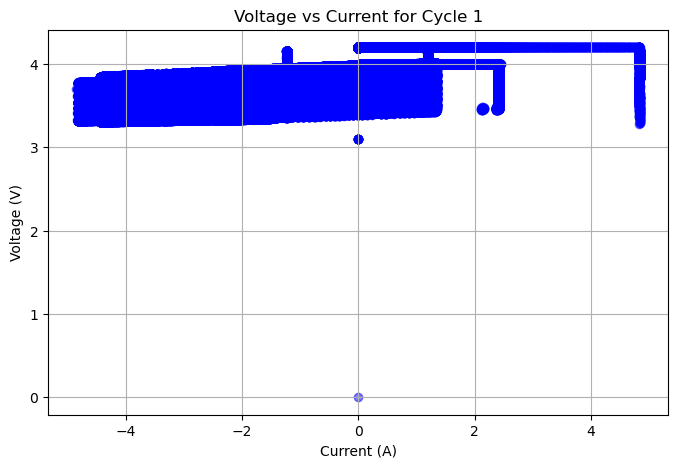

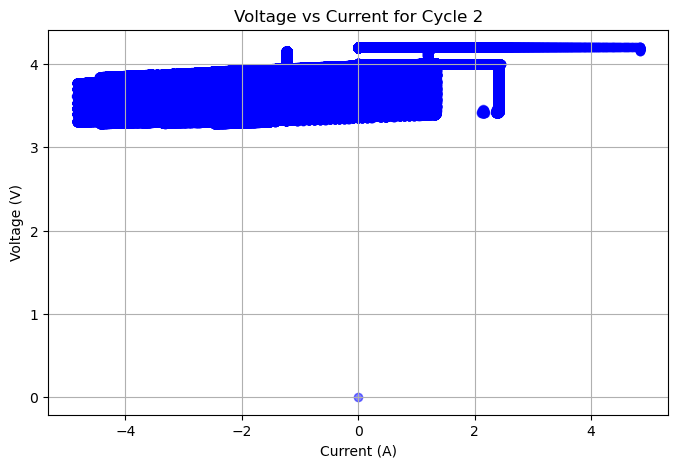

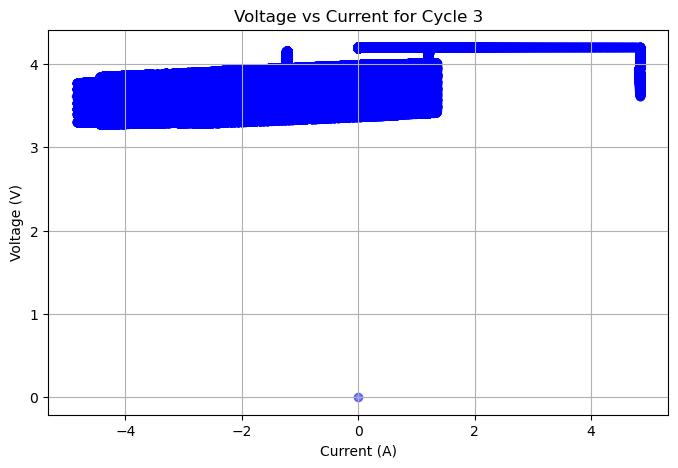

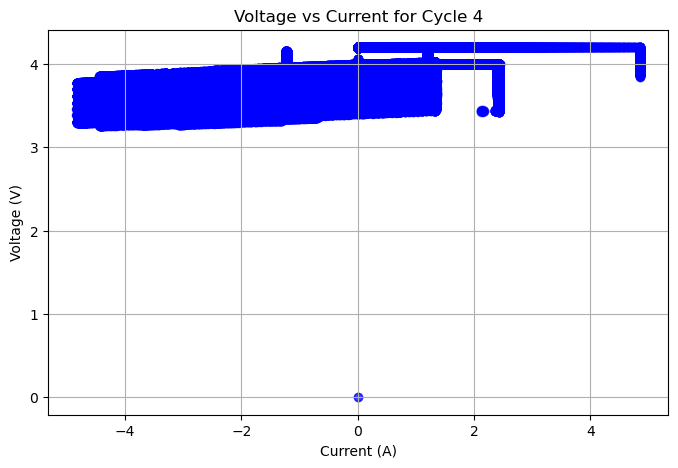

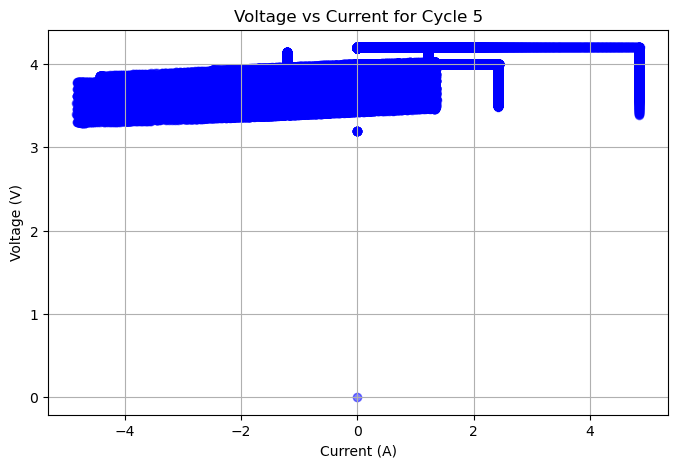

...

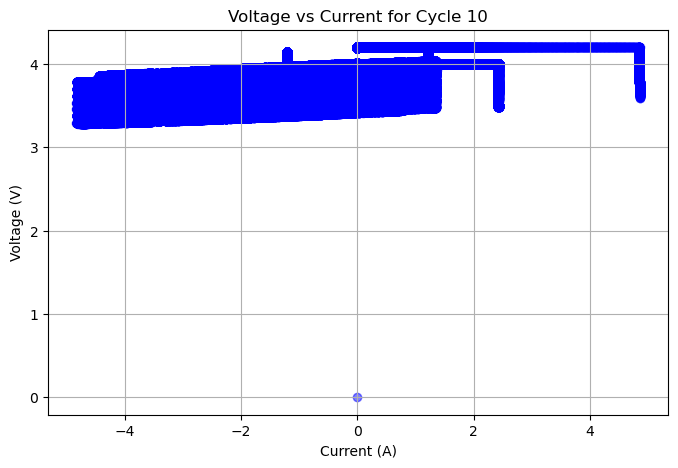

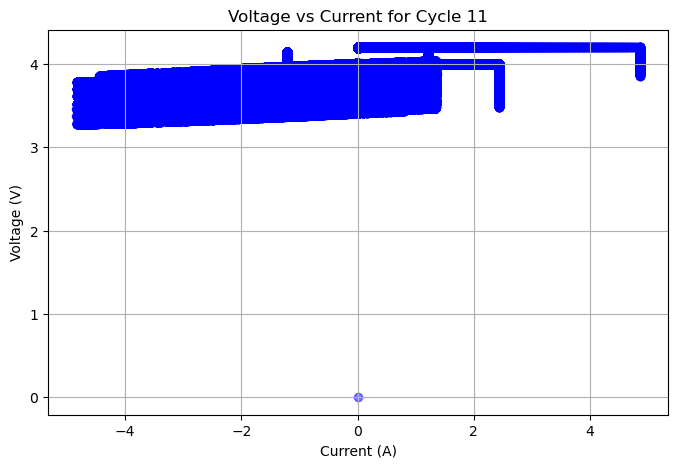

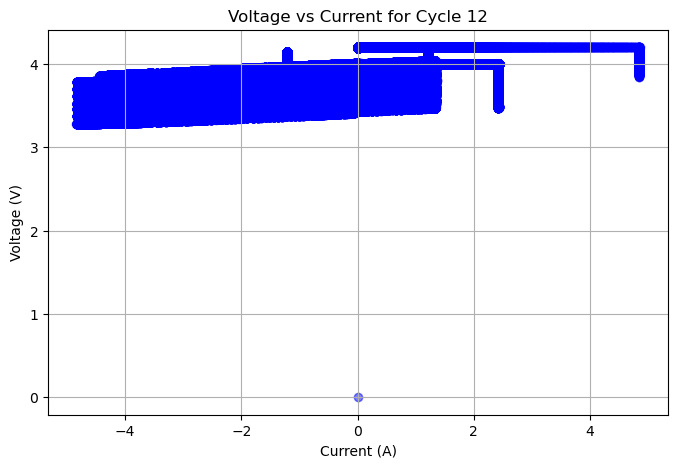

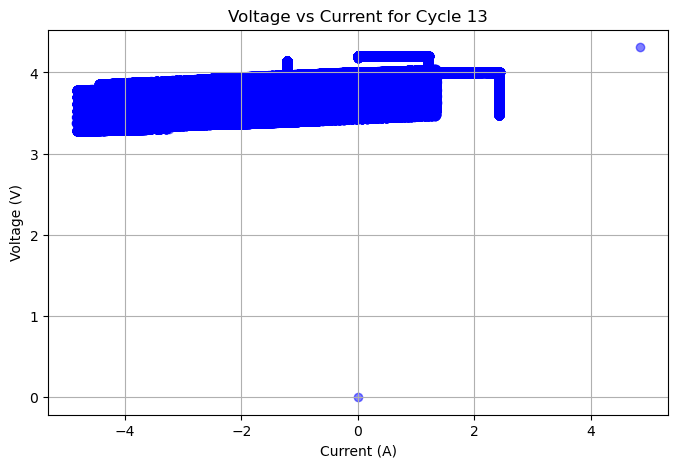

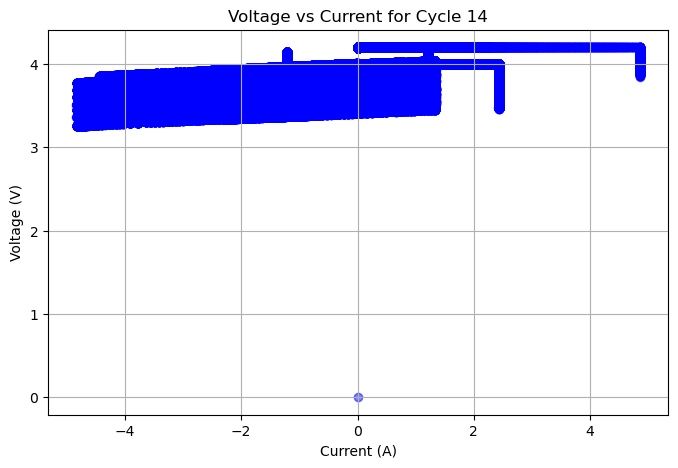

In [4]:
# Visualize the relationship between voltage and current for each cycle separately
for cycle in W8_combined_data['Cycle'].unique():
    cycle_data = W8_combined_data[W8_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))
    plt.scatter(cycle_data['Current'], cycle_data['Voltage'], color='blue', alpha=0.5)
    
    plt.xlabel('Current (A)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage vs Current for Cycle {cycle}')
    plt.grid()
    plt.show()


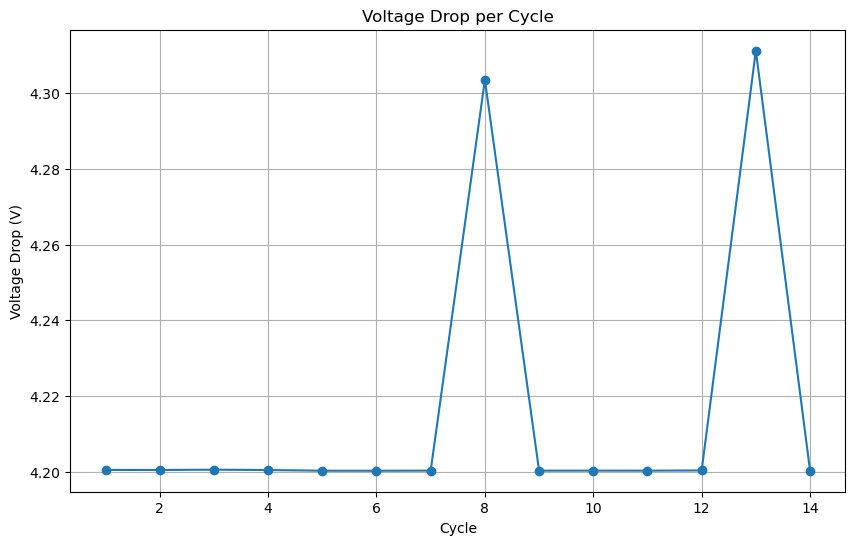

In [3]:
#Analyze how much the voltage drops within each cycle, which helps track battery degradation.
voltage_drop_per_cycle = W8_combined_data.groupby('Cycle').agg(
    max_voltage=('Voltage', 'max'),
    min_voltage=('Voltage', 'min')
)
voltage_drop_per_cycle['voltage_drop'] = voltage_drop_per_cycle['max_voltage'] - voltage_drop_per_cycle['min_voltage']

# Plot
plt.figure(figsize=(10, 6))
plt.plot(voltage_drop_per_cycle.index, voltage_drop_per_cycle['voltage_drop'], marker='o', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Voltage Drop (V)')
plt.title('Voltage Drop per Cycle')
plt.grid()
plt.show()


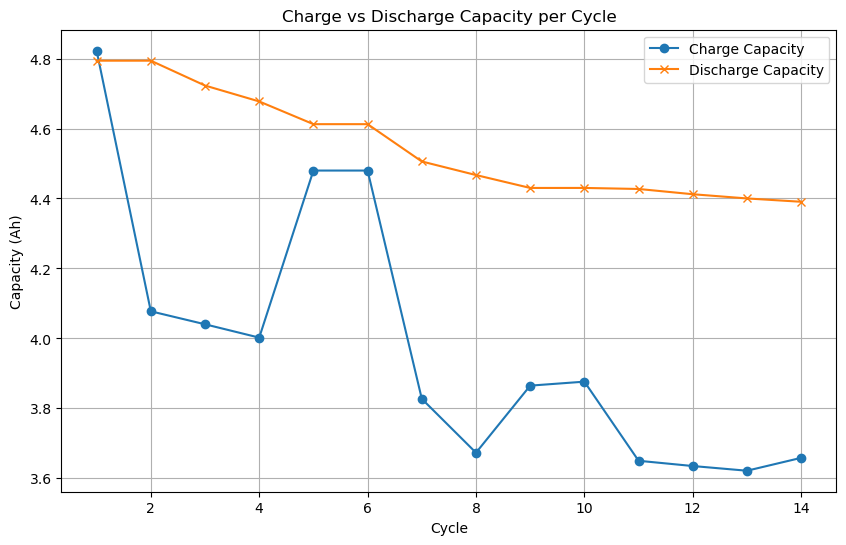

In [5]:
#Compare the charge and discharge capacity for each cycle. If there’s a growing difference, it indicates capacity loss.
capacity_per_cycle = W8_combined_data.groupby('Cycle').agg({
    'Charge_Capacity': 'max',
    'Discharge_Capacity': 'max'
})

plt.figure(figsize=(10, 6))
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Charge_Capacity'], label='Charge Capacity', marker='o')
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Discharge_Capacity'], label='Discharge Capacity', marker='x')
plt.xlabel('Cycle')
plt.ylabel('Capacity (Ah)')
plt.title('Charge vs Discharge Capacity per Cycle')
plt.legend()
plt.grid()
plt.show()


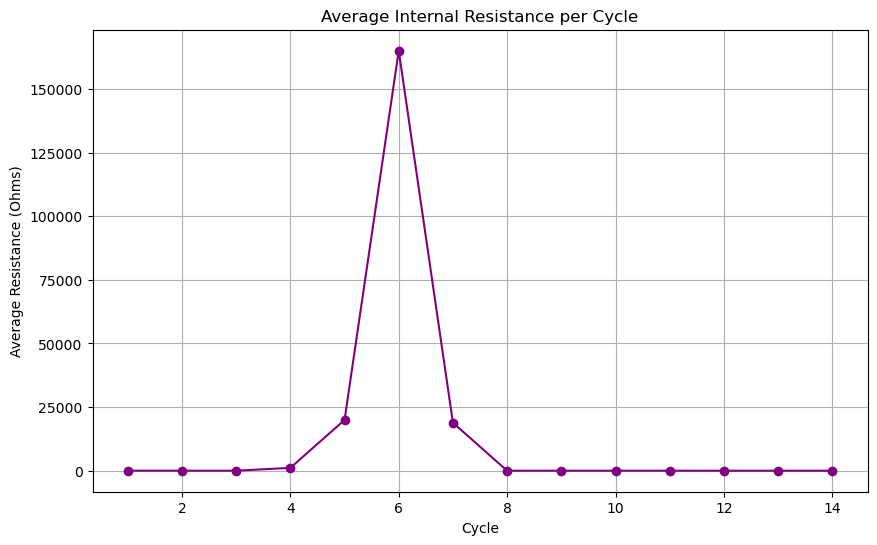

In [6]:
#Internal Resistance Over Time
W8_combined_data['Resistance'] = W8_combined_data['Voltage'] / W8_combined_data['Current']
W8_combined_data = W8_combined_data.replace([np.inf, -np.inf], np.nan).dropna(subset=['Resistance'])

# Average resistance per cycle
avg_resistance = W8_combined_data.groupby('Cycle')['Resistance'].mean()

# Plot
plt.figure(figsize=(10, 6))
plt.plot(avg_resistance.index, avg_resistance.values, marker='o', linestyle='-', color='purple')
plt.xlabel('Cycle')
plt.ylabel('Average Resistance (Ohms)')
plt.title('Average Internal Resistance per Cycle')
plt.grid()
plt.show()


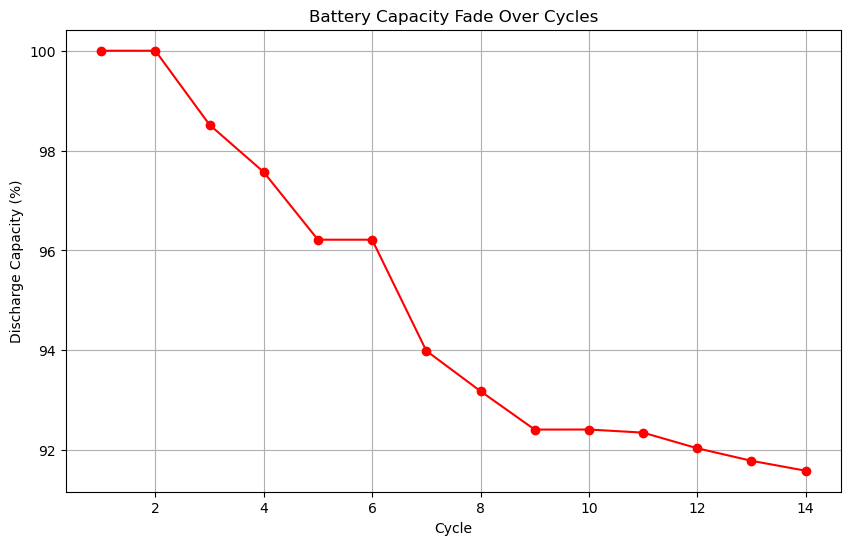

In [12]:
max_discharge_capacity = W8_combined_data['Discharge_Capacity'].max()

discharge_capacity_per_cycle = W8_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

#Visualize how discharge capacity decreases over time (cycle aging).
plt.figure(figsize=(10, 6))
plt.plot(discharge_capacity_percentage.index, discharge_capacity_percentage.values, 
         marker='o', linestyle='-', color='red')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Battery Capacity Fade Over Cycles')
plt.grid()
plt.show()


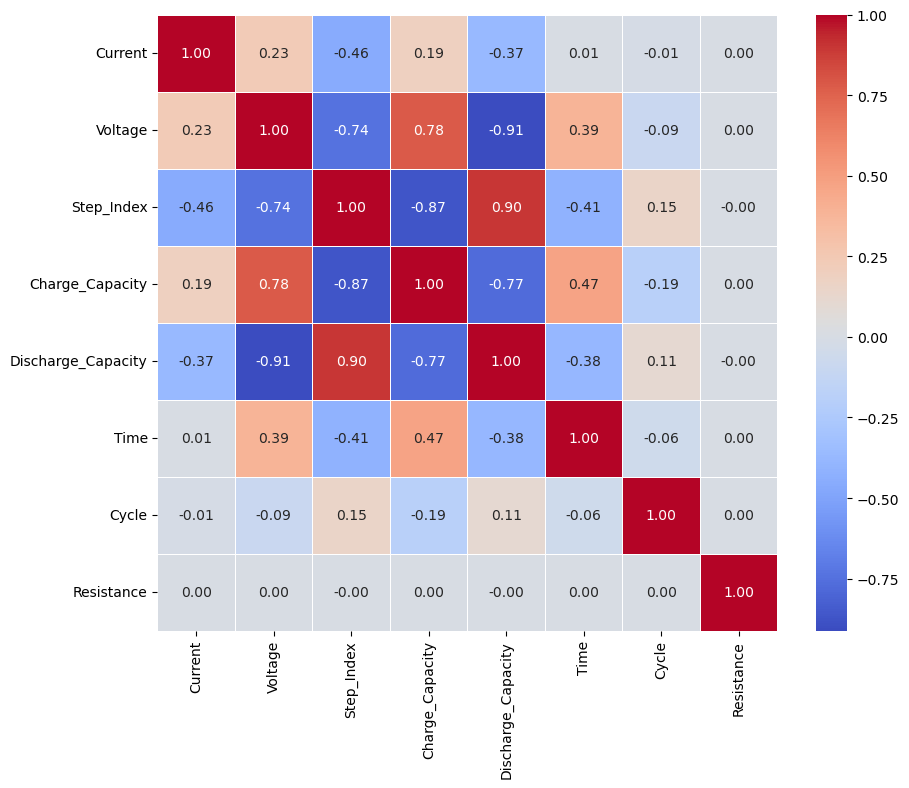

In [9]:
#Correlation analysis Check for correlations between numerical variables using a correlation matrix.
corr_matrix = W8_combined_data.corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.show()

In [13]:
#Normality tests Test whether certain columns (like Voltage, Current) follow a normal distribution using statistical tests such as Shapiro-Wilk.
from scipy.stats import shapiro

# Example: Shapiro-Wilk test for normality
stat, p_value = shapiro(W8_combined_data['Voltage'])
print(f"Shapiro-Wilk Test: Stat={stat}, P-value={p_value}")


Shapiro-Wilk Test: Stat=0.6821217100047254, P-value=5.305033824260401e-140


d:\SN750\Anaconda\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 220631023.
  res = hypotest_fun_out(*samples, **kwds)


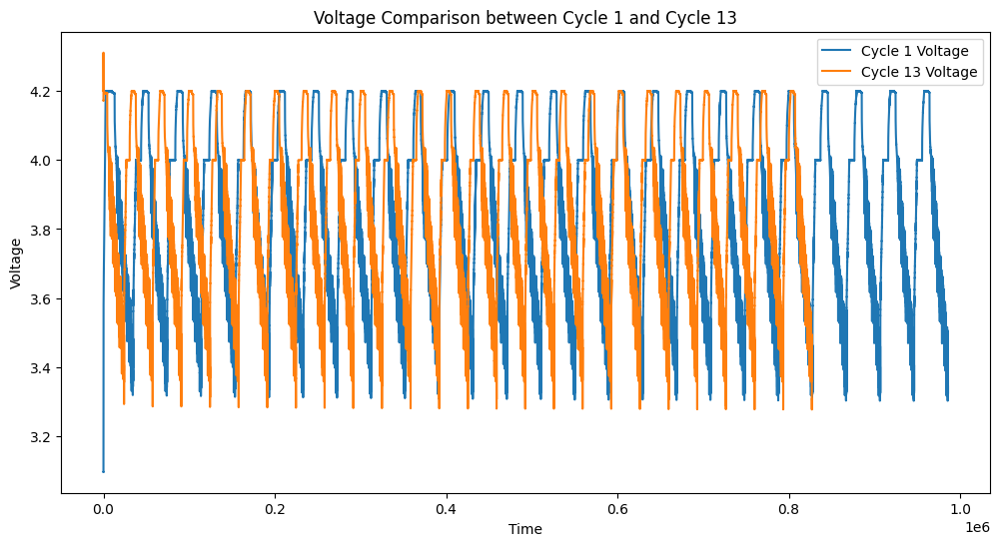

In [11]:
#Cycle-wise analysis Visualize data for different cycles separately to see if there are patterns or anomalies.
cycle_1 = W8_combined_data_cleaned[W8_combined_data_cleaned['Cycle'] == 1]
cycle_2 = W8_combined_data_cleaned[W8_combined_data_cleaned['Cycle'] == 2]
cycle_13 = W8_combined_data_cleaned[W8_combined_data_cleaned['Cycle'] == 13]
cycle_14 = W8_combined_data_cleaned[W8_combined_data_cleaned['Cycle'] == 14]


# Plot Voltage for Cycle 1 and Cycle 2
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_13['Time'], cycle_13['Voltage'], label='Cycle 13 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 13')
plt.legend()
plt.show()




In [19]:
W8_combined_data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 221293209 entries, 1 to 221293226
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 13.2 GB


In [4]:
from scipy import stats

# Two-sample t-test between Charge Capacity and Discharge Capacity
t_stat, p_value = stats.ttest_ind(W8_combined_data['Charge_Capacity'], W8_combined_data['Discharge_Capacity'])
print(f"T-statistic: {t_stat}, P-value: {p_value}")


T-statistic: 10211.724784222828, P-value: 0.0


In [5]:
# ANOVA test for comparing discharge capacity over cycles
from scipy import stats

f_stat, p_value = stats.f_oneway(*[W8_combined_data[W8_combined_data['Cycle'] == cycle]['Discharge_Capacity'] for cycle in W8_combined_data['Cycle'].unique()])
print(f"ANOVA test: F-statistic = {f_stat}, P-value = {p_value}")


ANOVA test: F-statistic = 10316961.746483797, P-value = 0.0


In [49]:
from scipy import stats
# Pearson correlation test
pearson_corr, _ = stats.pearsonr(W8_combined_data['Discharge_Capacity'], W8_combined_data['Charge_Capacity'])
print(f"Pearson correlation: {pearson_corr}")


Pearson correlation: -0.76862702490113


## Visualising and cleaning up data for Cell W9

In [3]:
W9_combined_data = pd.read_csv('W9_combined_data.csv')

In [31]:
W9_combined_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198233894 entries, 0 to 198233893
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 10.3 GB


In [32]:
W9_combined_data.shape

(198233894, 7)

In [33]:
W9_combined_data.columns[W9_combined_data.isnull().any()]

Index([], dtype='object')

In [34]:
W9_combined_data.isnull().sum()

Current               0
Voltage               0
Step_Index            0
Charge_Capacity       0
Discharge_Capacity    0
Time                  0
Cycle                 0
dtype: int64

In [35]:
duplicates = W9_combined_data.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")



Number of duplicate rows: 1288854


In [36]:
# Summary statistics
print(W9_combined_data.describe())


            Current       Voltage    Step_Index  Charge_Capacity  \
count  1.982339e+08  1.982339e+08  1.982339e+08     1.982339e+08   
mean  -9.275875e-03  3.903657e+00  9.858000e+00     1.970097e+00   
std    1.035969e+00  1.730028e-01  2.784134e+00     1.099393e+00   
min   -4.835007e+00  0.000000e+00  0.000000e+00     0.000000e+00   
25%   -1.008349e-03  3.842968e+00  8.000000e+00     6.638798e-01   
50%   -3.509525e-05  3.999962e+00  8.000000e+00     2.700147e+00   
75%    6.655562e-04  4.000021e+00  1.400000e+01     2.747270e+00   
max    4.868741e+00  4.310834e+00  1.400000e+01     4.842170e+00   

       Discharge_Capacity          Time         Cycle  
count        1.982339e+08  1.982339e+08  1.982339e+08  
mean         8.900155e-01  2.047016e+06  6.351060e+00  
std          1.373576e+00  1.945957e+06  3.128868e+00  
min          0.000000e+00  0.000000e+00  1.000000e+00  
25%          2.892657e-02  4.916090e+05  4.000000e+00  
50%          9.953937e-02  1.267454e+06  7.000000e+

In [37]:
W9_combined_data['Current'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
198233889   -4.501915
198233890   -4.462578
198233891   -4.431702
198233892   -4.362900
198233893   -4.364609
Name: Current, Length: 198233894, dtype: float64>

In [38]:
W9_combined_data['Voltage'].describe

<bound method NDFrame.describe of 0            0.000000
1            3.095433
2            3.095472
3            3.095478
4            3.095448
               ...   
198233889    3.290081
198233890    3.290710
198233891    3.291940
198233892    3.293313
198233893    3.293377
Name: Voltage, Length: 198233894, dtype: float64>

In [39]:
W9_combined_data['Step_Index'].describe

<bound method NDFrame.describe of 0             0
1             1
2             1
3             1
4             1
             ..
198233889    14
198233890    14
198233891    14
198233892    14
198233893    14
Name: Step_Index, Length: 198233894, dtype: int64>

In [40]:
W9_combined_data['Charge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
198233889    0.803514
198233890    0.803514
198233891    0.803514
198233892    0.803514
198233893    0.803514
Name: Charge_Capacity, Length: 198233894, dtype: float64>

In [41]:
W9_combined_data['Discharge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
198233889    4.392200
198233890    4.392325
198233891    4.392446
198233892    4.392569
198233893    4.392636
Name: Discharge_Capacity, Length: 198233894, dtype: float64>

In [42]:
W9_combined_data['Time'].describe

<bound method NDFrame.describe of 0                 0.000000
1                 0.100300
2                 0.201000
3                 0.301000
4                 0.400000
                 ...      
198233889    806056.376012
198233890    806056.477612
198233891    806056.576812
198233892    806056.676912
198233893    806056.731612
Name: Time, Length: 198233894, dtype: float64>

In [43]:
W9_combined_data['Cycle'].describe

<bound method NDFrame.describe of 0             1
1             1
2             1
3             1
4             1
             ..
198233889    14
198233890    14
198233891    14
198233892    14
198233893    14
Name: Cycle, Length: 198233894, dtype: int64>

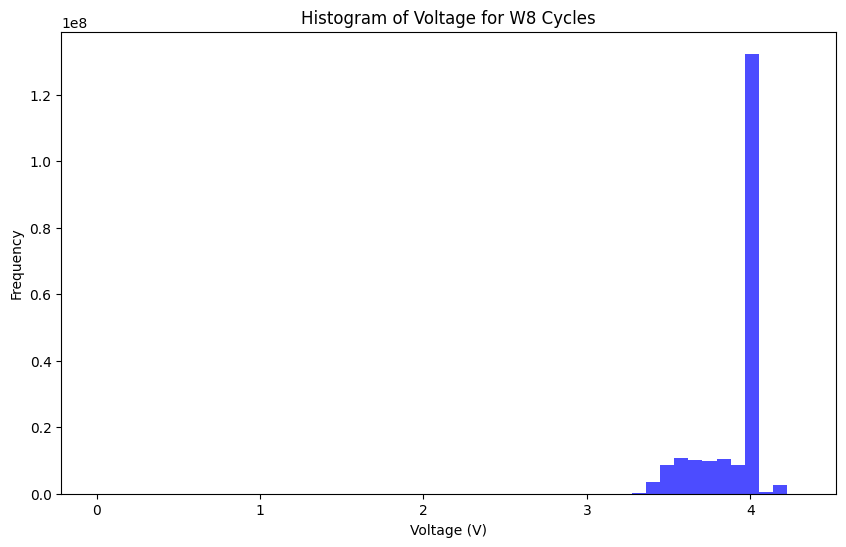

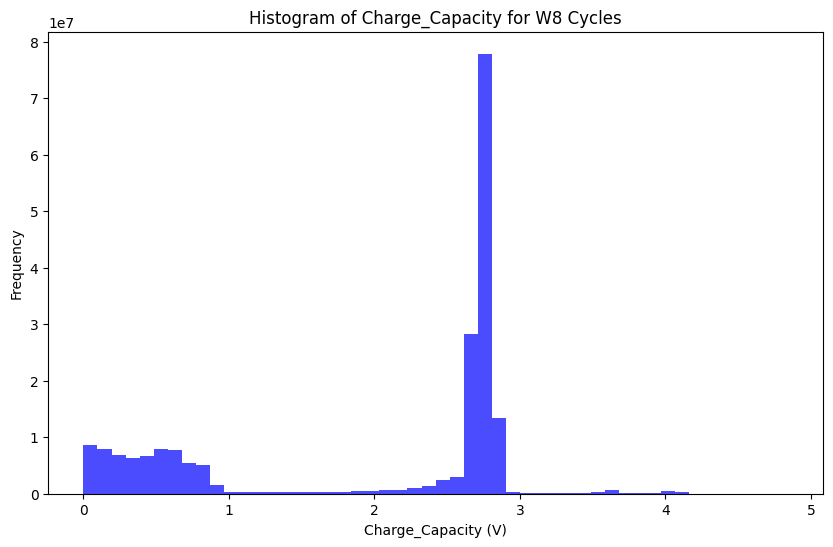

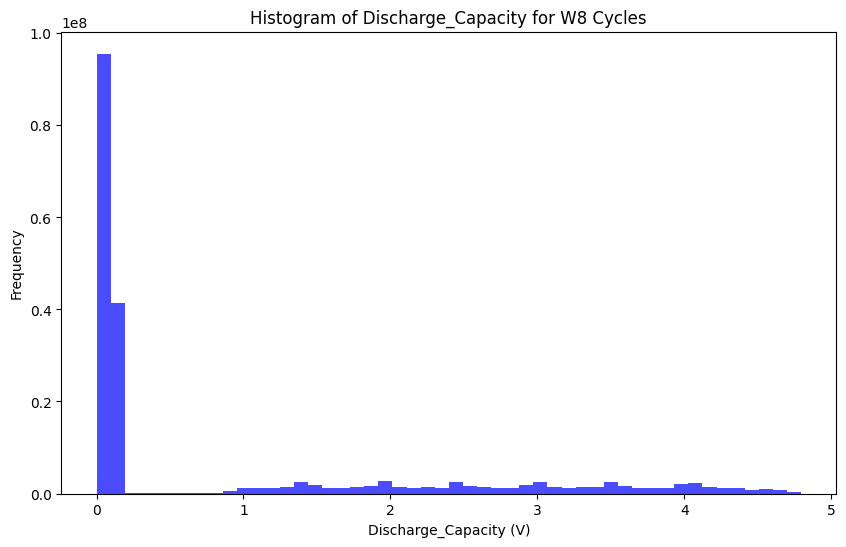

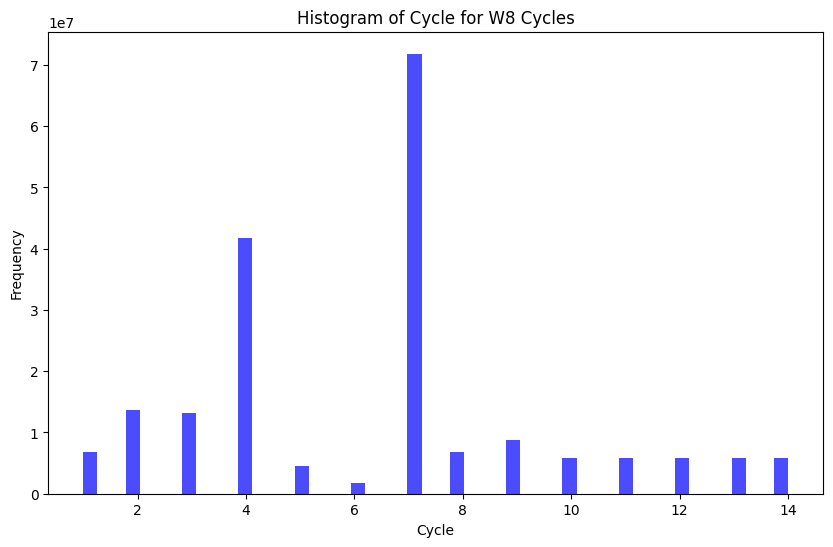

In [44]:
# Step 1: Plot histogram of voltage values
plt.figure(figsize=(10, 6))
plt.hist(W9_combined_data['Voltage'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Voltage (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Voltage for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Charge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W9_combined_data['Charge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Charge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Charge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Discharge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W9_combined_data['Discharge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Discharge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Discharge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Cycle values
plt.figure(figsize=(10, 6))
plt.hist(W9_combined_data['Cycle'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W8 Cycles')
plt.show()

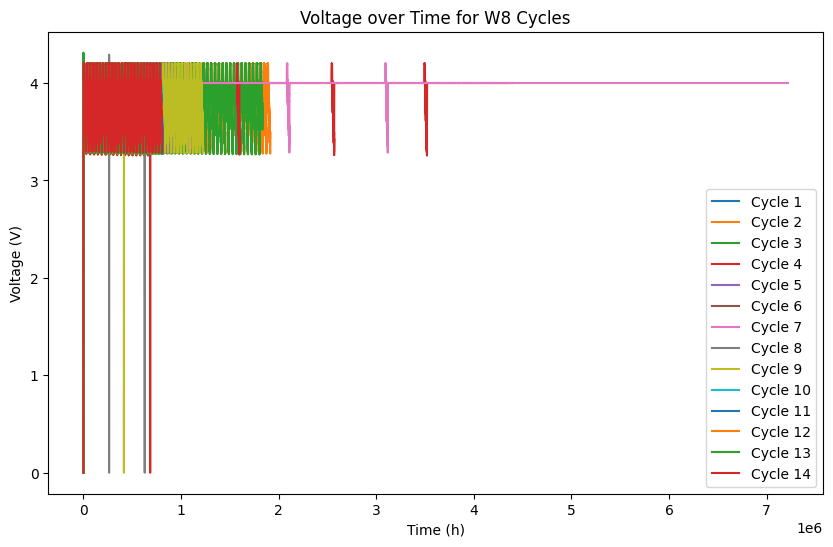

In [45]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W9_combined_data['Cycle'].unique():
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

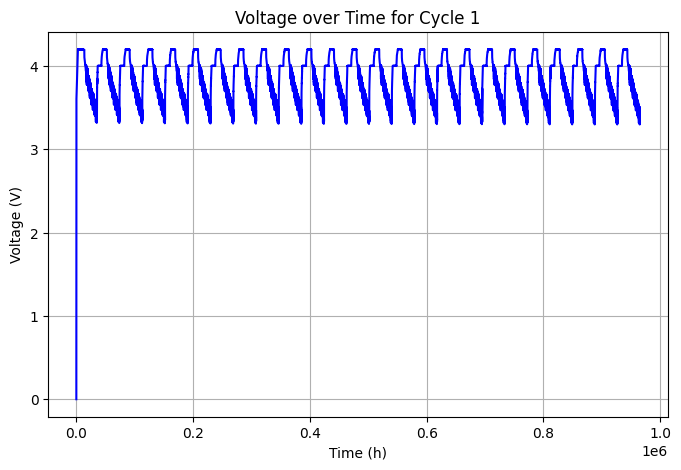

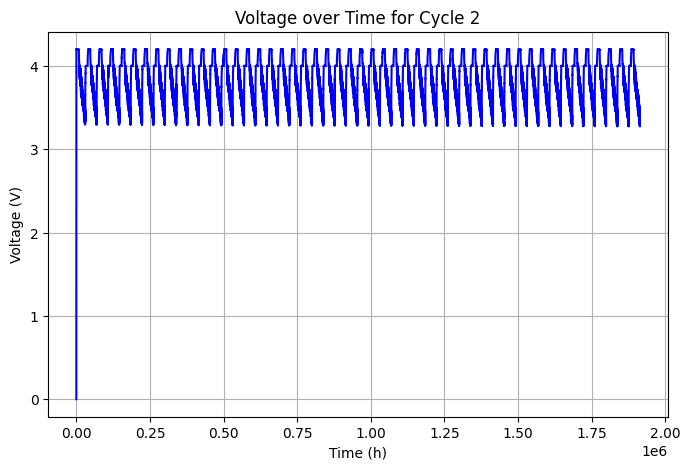

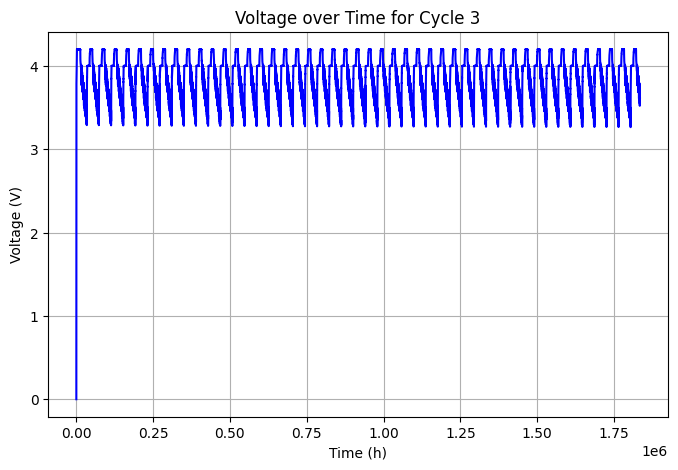

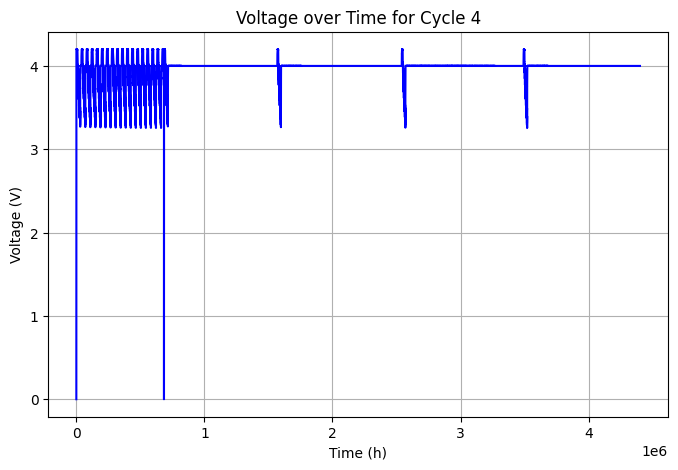

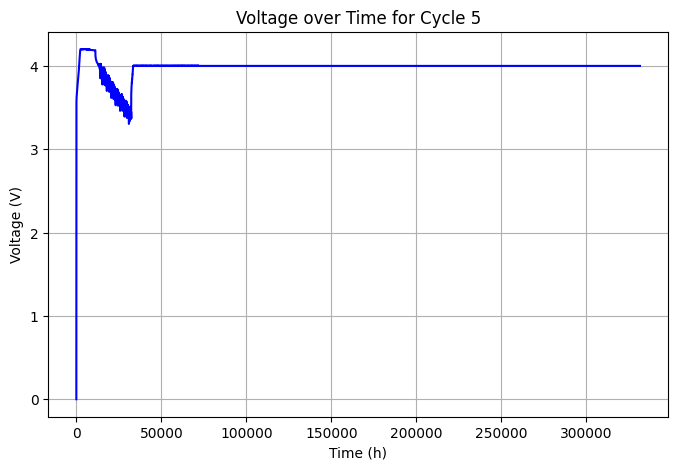

...

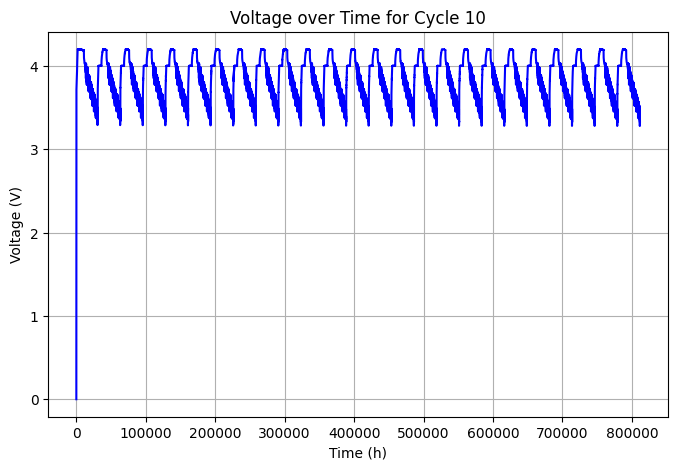

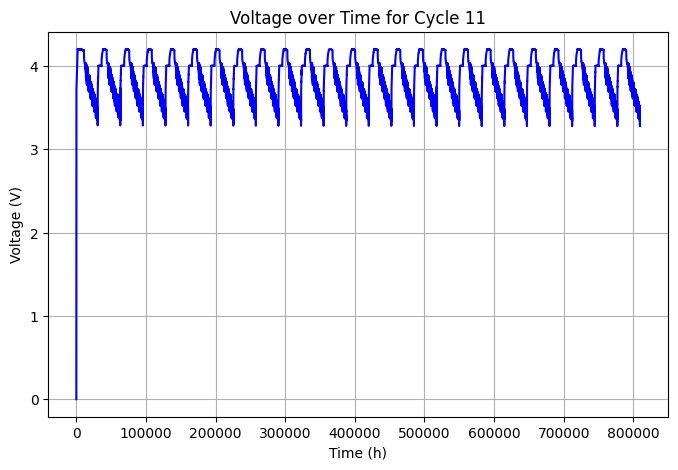

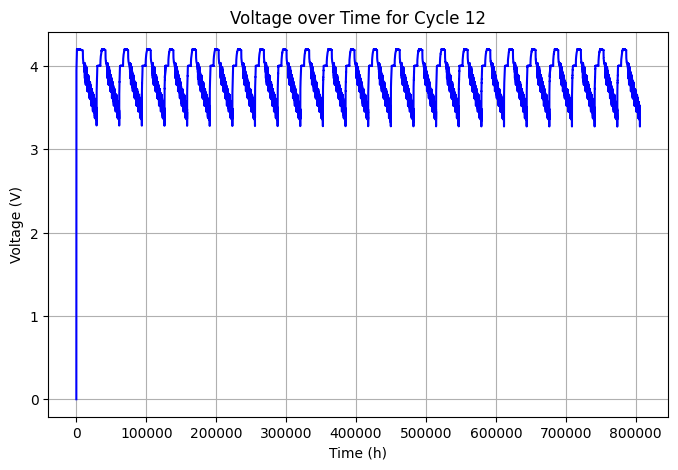

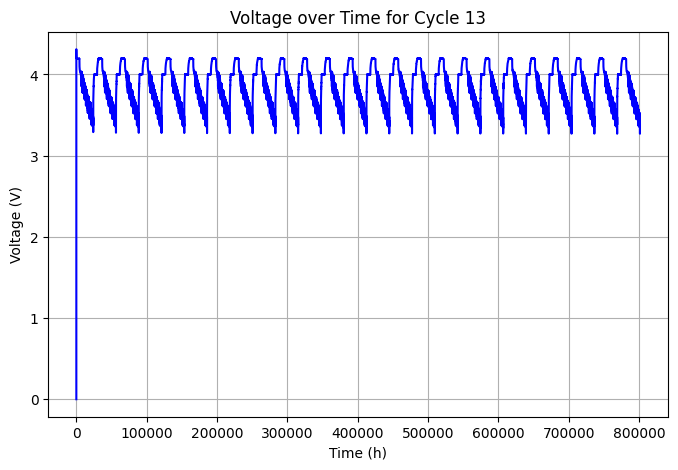

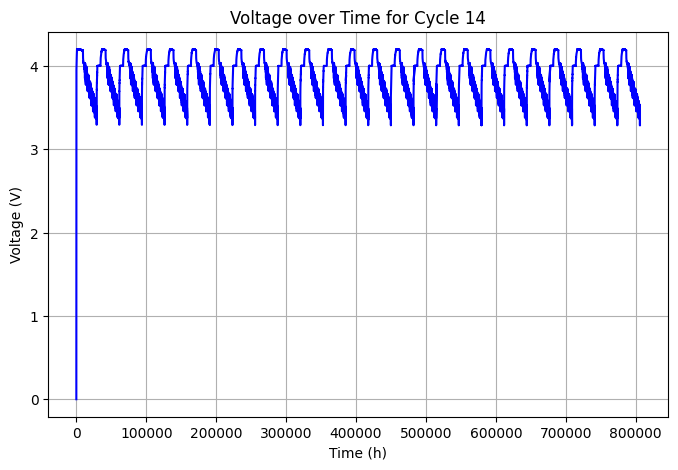

In [46]:
# Loop through each unique cycle and create a separate plot
for cycle in W9_combined_data['Cycle'].unique():
    # Filter data for the current cycle
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))  # Adjust figure size if needed
    
    # Plot Voltage vs. Time for the current cycle
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], color='blue', linewidth=1.5)
    
    # Add labels, title, and formatting
    plt.xlabel('Time (h)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage over Time for Cycle {cycle}')
    
    # Optional: Add grid for better visibility
    plt.grid(True)
    
    # Show the plot
    plt.show()


In [47]:
# Filter rows where Voltage is 0
voltage_zeros = W9_combined_data[W9_combined_data['Voltage'] == 0]
print(f"Rows with Voltage = 0:\n{voltage_zeros}")

Rows with Voltage = 0:
           Current  Voltage  Step_Index  Charge_Capacity  Discharge_Capacity  \
0              0.0      0.0           0              0.0                 0.0   
6886970        0.0      0.0           0              0.0                 0.0   
20596973       0.0      0.0           0              0.0                 0.0   
33844337       0.0      0.0           0              0.0                 0.0   
38719478       0.0      0.0           0              0.0                 0.0   
75511952       0.0      0.0           0              0.0                 0.0   
79990458       0.0      0.0           0              0.0                 0.0   
81676421       0.0      0.0           0              0.0                 0.0   
153504915      0.0      0.0           0              0.0                 0.0   
155392665      0.0      0.0           0              0.0                 0.0   
158009953      0.0      0.0           0              0.0                 0.0   
160310900      0.

In [48]:
# Filter rows where Time is 2
time_at_2 = W9_combined_data[W9_combined_data['Time'] > 2]
print(f"Rows with Time = 2:\n{time_at_2}")


Rows with Time = 2:
            Current   Voltage  Step_Index  Charge_Capacity  \
12         4.834259  3.278934           2         0.001327   
13         4.835480  3.288715           2         0.002670   
14         4.835266  3.296495           2         0.004015   
15         4.835022  3.303201           2         0.005359   
16         4.834595  3.309358           2         0.006702   
...             ...       ...         ...              ...   
198233889 -4.501915  3.290081          14         0.803514   
198233890 -4.462578  3.290710          14         0.803514   
198233891 -4.431702  3.291940          14         0.803514   
198233892 -4.362900  3.293313          14         0.803514   
198233893 -4.364609  3.293377          14         0.803514   

           Discharge_Capacity           Time  Cycle  
12                   0.000001       2.046300      1  
13                   0.000001       3.046100      1  
14                   0.000001       4.046600      1  
15                 

In [52]:
# Remove rows where Voltage is 0
W9_combined_data_cleaned = W9_combined_data[W9_combined_data['Voltage'] > 0]

# Remove rows where Time is 2
#W9_combined_data_cleaned = W9_combined_data_cleaned[W9_combined_data_cleaned['Time'] < 3]

In [50]:
W9_combined_data

,Current,Voltage,Step_Index,Charge_Capacity,Discharge_Capacity,Time,Cycle
1,0.000000,3.095433,1,0.000000,0.000000,0.100300,1
2,0.000000,3.095472,1,0.000000,0.000000,0.201000,1
3,0.000000,3.095478,1,0.000000,0.000000,0.301000,1
4,0.000000,3.095448,1,0.000000,0.000000,0.400000,1
5,0.000000,3.095481,1,0.000000,0.000000,0.500200,1
...,...,...,...,...,...,...,...
198233889,-4.501915,3.290081,14,0.803514,4.392200,806056.376012,14
198233890,-4.462578,3.290710,14,0.803514,4.392325,806056.477612,14
198233891,-4.431702,3.291940,14,0.803514,4.392446,806056.576812,14
198233892,-4.362900,3.293313,14,0.803514,4.392569,806056.676912,14


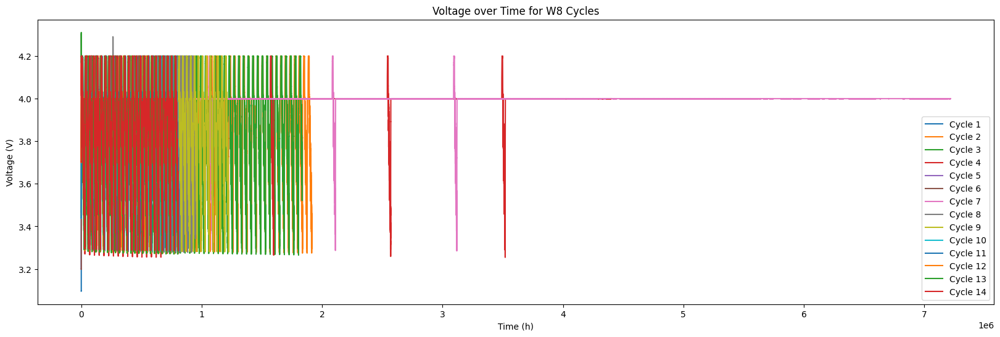

In [53]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(20, 6))
for cycle in W9_combined_data_cleaned['Cycle'].unique():
    cycle_data = W9_combined_data_cleaned[W9_combined_data_cleaned['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

C:\Users\ymuba\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


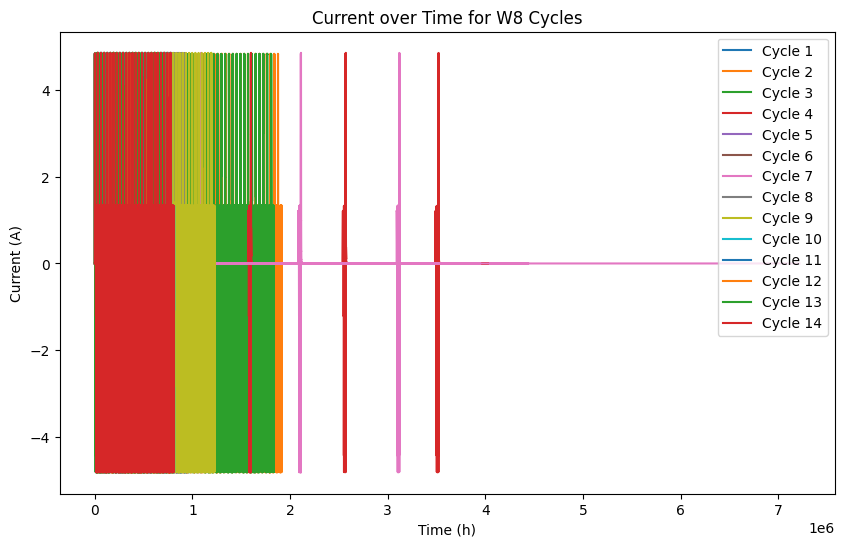

In [54]:
# Current vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W9_combined_data['Cycle'].unique():
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Current'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Current (A)')
plt.title('Current over Time for W8 Cycles')
plt.legend()
plt.show()



C:\Users\ymuba\AppData\Local\Temp\ipykernel_14028\2149167573.py:30: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


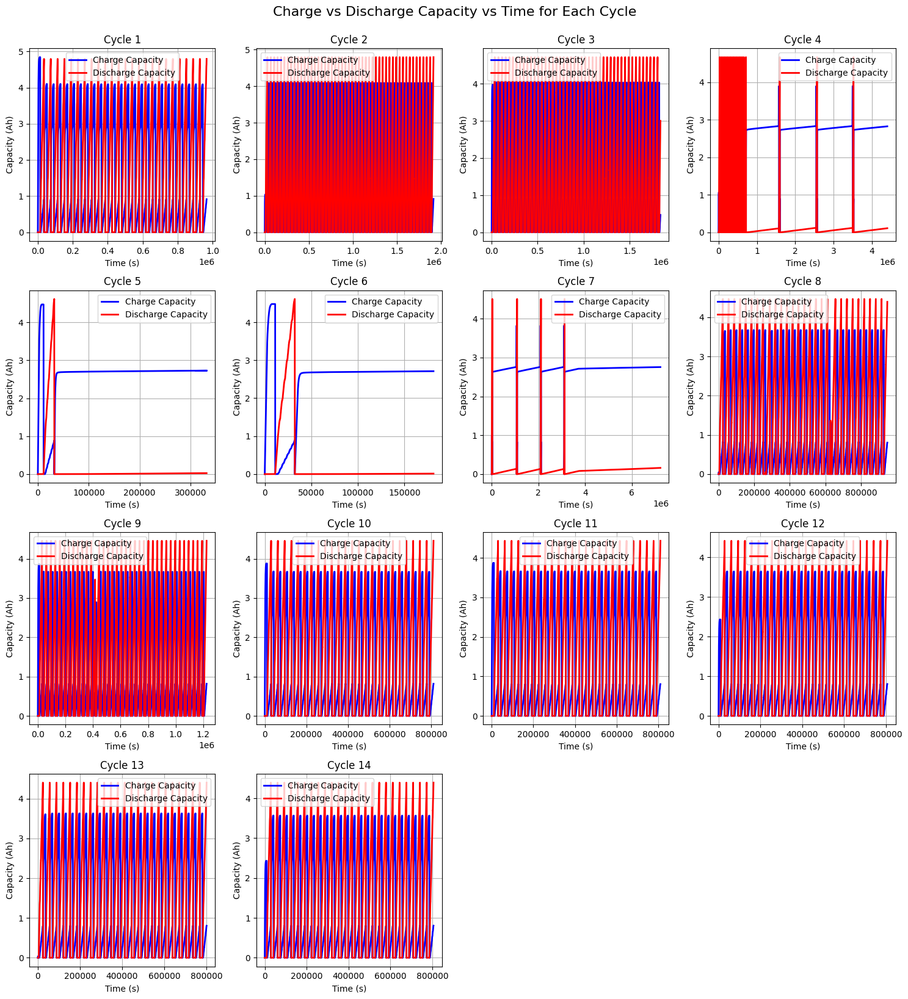

In [55]:
# Get unique cycles
unique_cycles = W9_combined_data['Cycle'].unique()
num_cycles = len(unique_cycles)

# Determine grid layout for subplots
rows = (num_cycles + 3) // 4  # Adjust rows based on number of cycles
cols = min(4, num_cycles)  # Up to 4 graphs per row

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 4))
axes = axes.flatten()  # Flatten axes for easy iteration

# Plot each cycle's Charge and Discharge Capacity vs. Time
for i, cycle in enumerate(unique_cycles):
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    ax = axes[i]
    ax.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    ax.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    ax.set_title(f'Cycle {cycle}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Capacity (Ah)')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.suptitle('Charge vs Discharge Capacity vs Time for Each Cycle', fontsize=16, y=1.02)
plt.show()


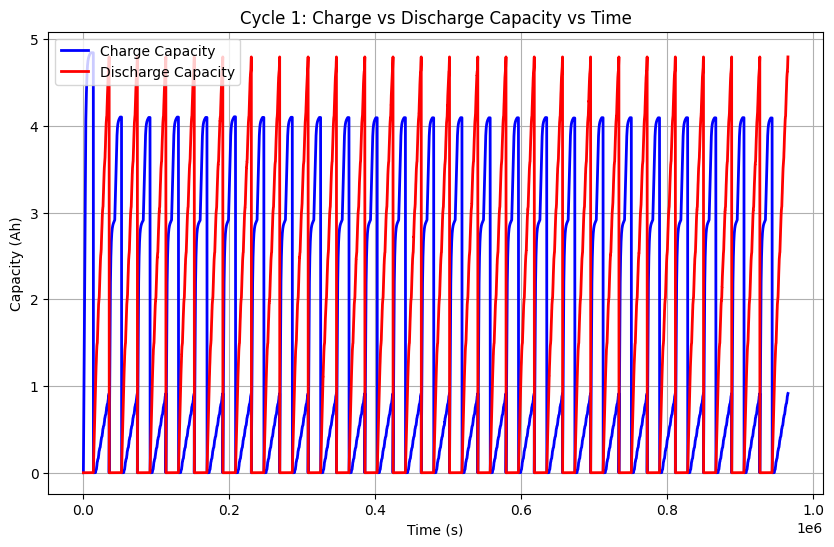

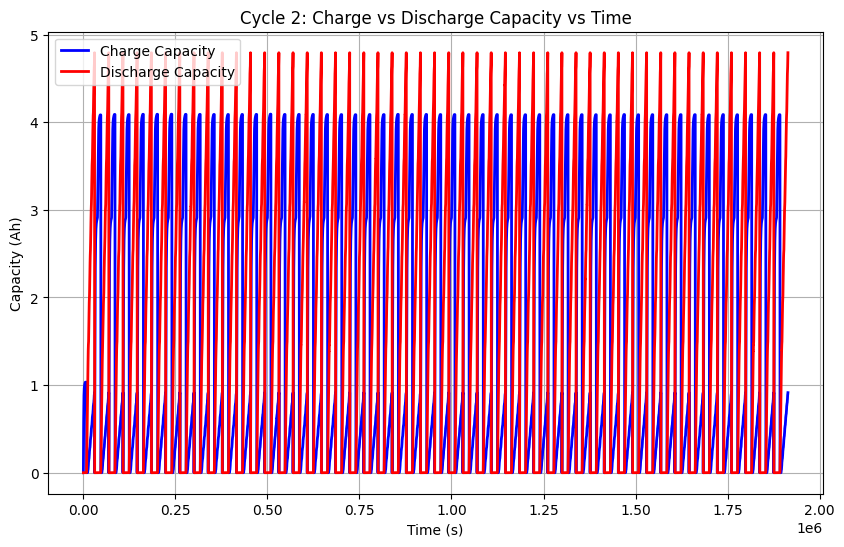

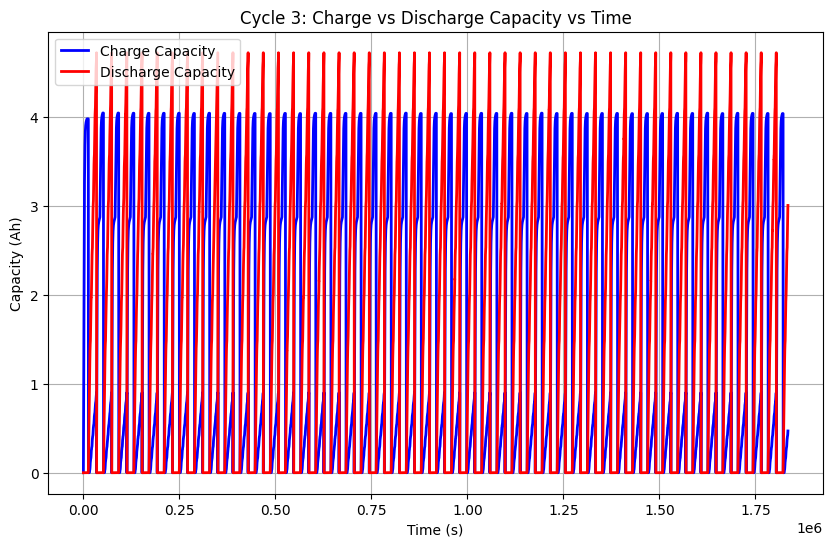

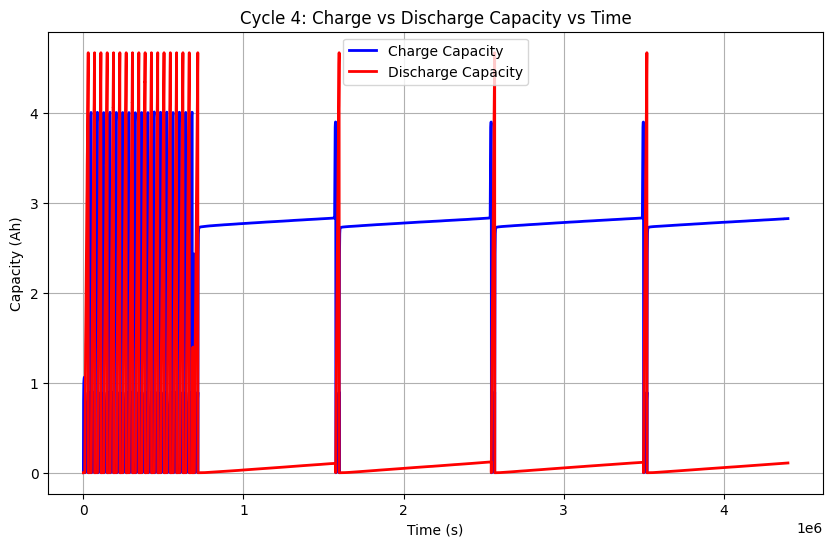

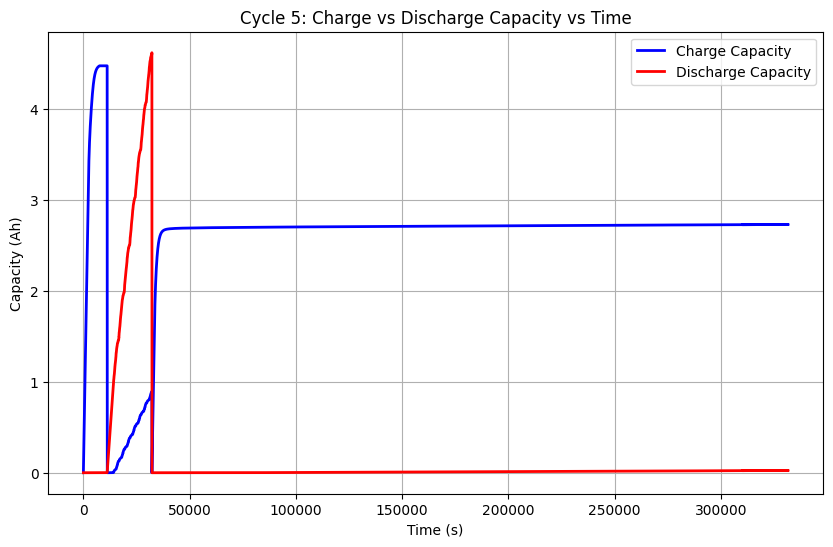

...

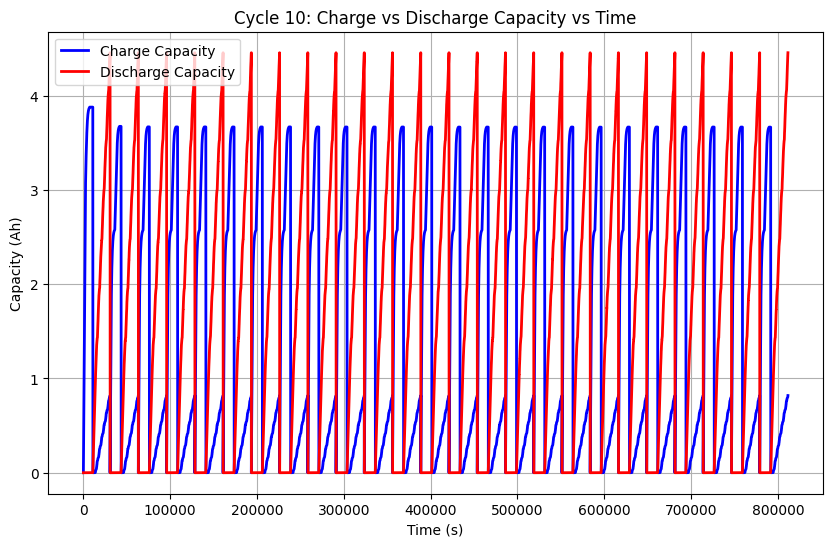

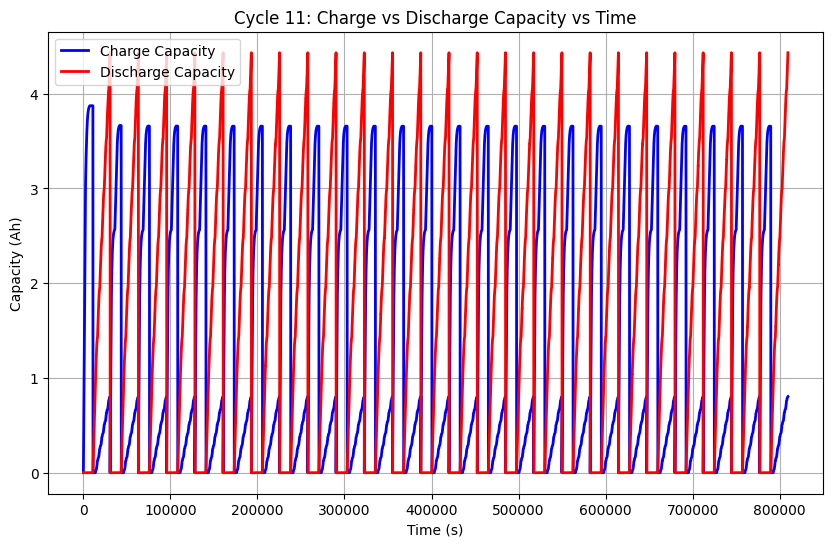

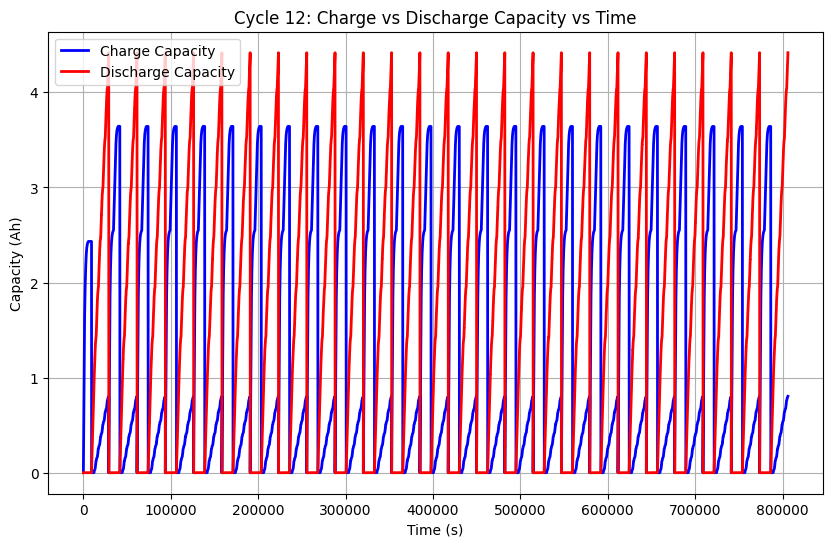

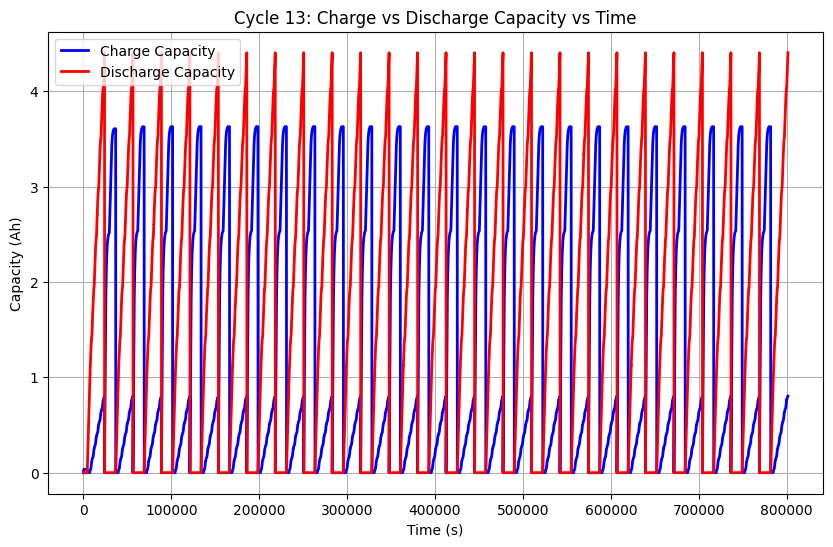

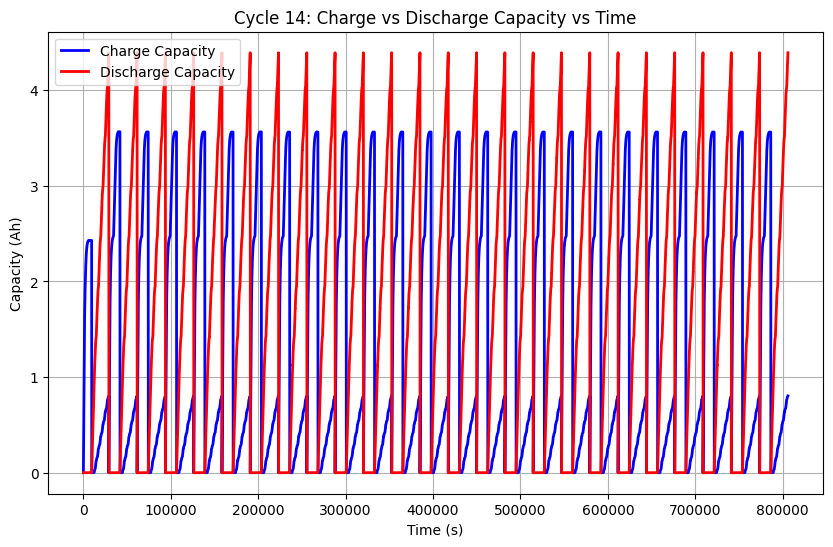

In [56]:
for cycle in unique_cycles:
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(10, 6))  # Create a new figure for each cycle
    plt.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    plt.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    
    plt.title(f'Cycle {cycle}: Charge vs Discharge Capacity vs Time')
    plt.xlabel('Time (s)')
    plt.ylabel('Capacity (Ah)')
    plt.legend()
    plt.grid(True)
    
    plt.show() 

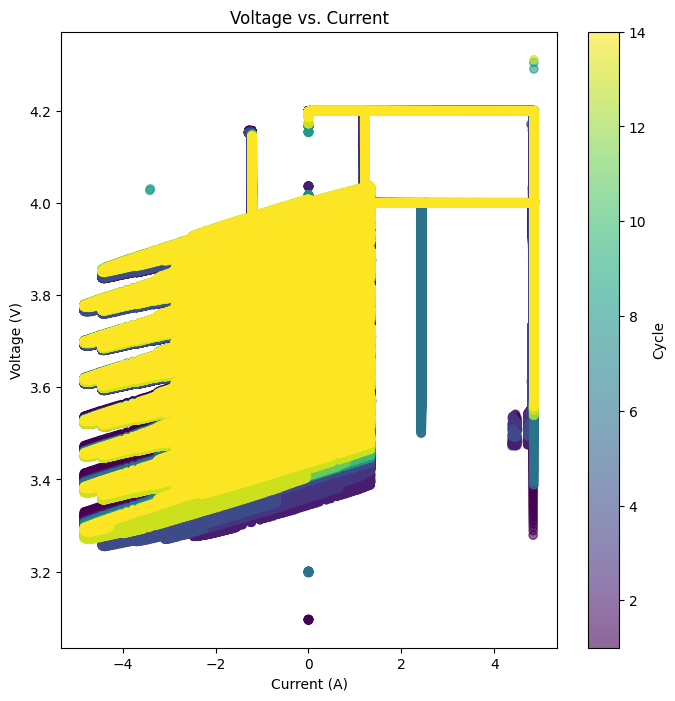

In [57]:
# Voltage vs. Current scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(W9_combined_data['Current'], W9_combined_data['Voltage'], alpha=0.6, c=W9_combined_data['Cycle'], cmap='viridis')
plt.colorbar(label='Cycle')
plt.xlabel('Current (A)')
plt.ylabel('Voltage (V)')
plt.title('Voltage vs. Current')
plt.show()


In [58]:
# Group data by cycle and normalize Charge_Capacity to calculate SoC
W9_combined_data['SoC'] = W9_combined_data.groupby('Cycle')['Charge_Capacity'].transform(
    lambda x: x / x.max()
)


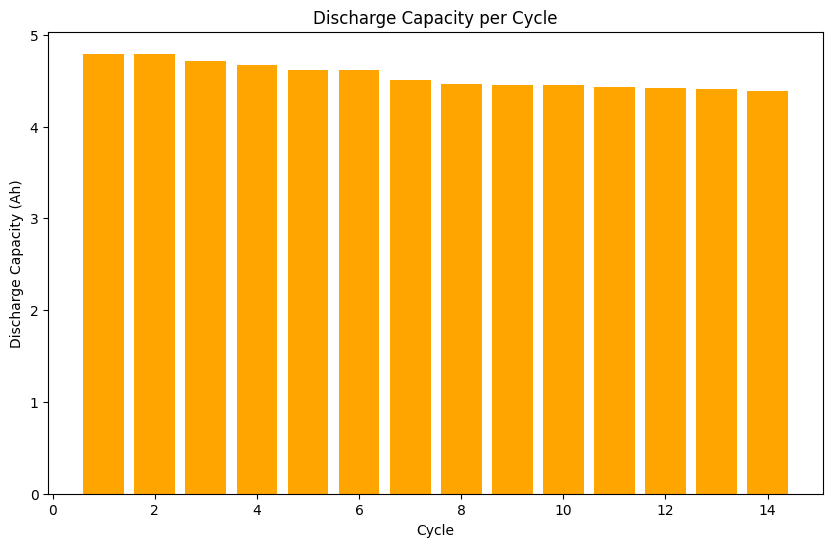

In [59]:
# Calculate total discharge capacity per cycle
discharge_capacity_per_cycle = W9_combined_data.groupby('Cycle')['Discharge_Capacity'].max()

# Plot Discharge Capacity per Cycle
plt.figure(figsize=(10, 6))
plt.bar(discharge_capacity_per_cycle.index, discharge_capacity_per_cycle.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (Ah)')
plt.title('Discharge Capacity per Cycle')
plt.show()


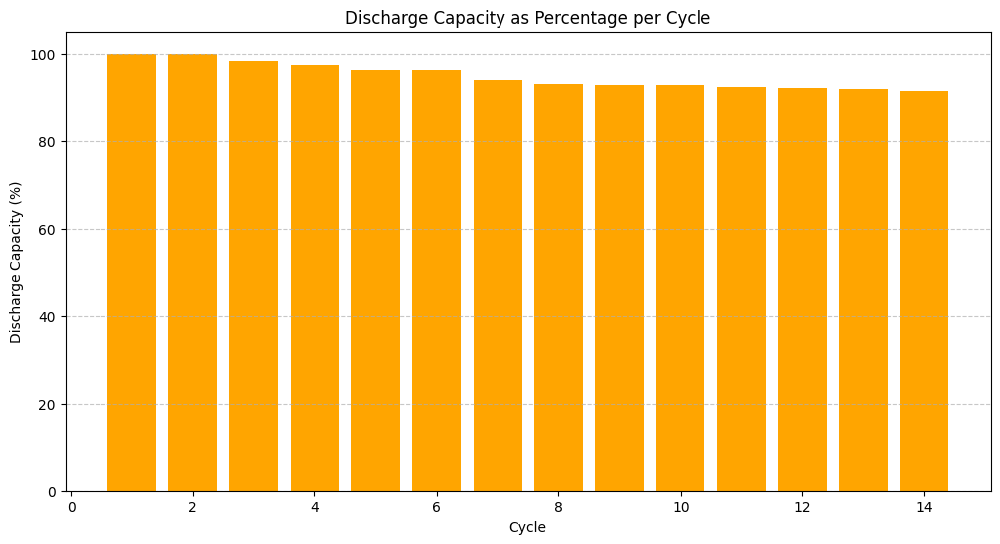

In [60]:
# Calculate the maximum discharge capacity across all cycles
max_discharge_capacity = W9_combined_data['Discharge_Capacity'].max()

# Calculate the maximum discharge capacity per cycle and convert to percentage
discharge_capacity_per_cycle = W9_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

# Plot Discharge Capacity as Percentage per Cycle
plt.figure(figsize=(12, 6))
plt.bar(discharge_capacity_percentage.index, discharge_capacity_percentage.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle')
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add grid for better readability
plt.show()


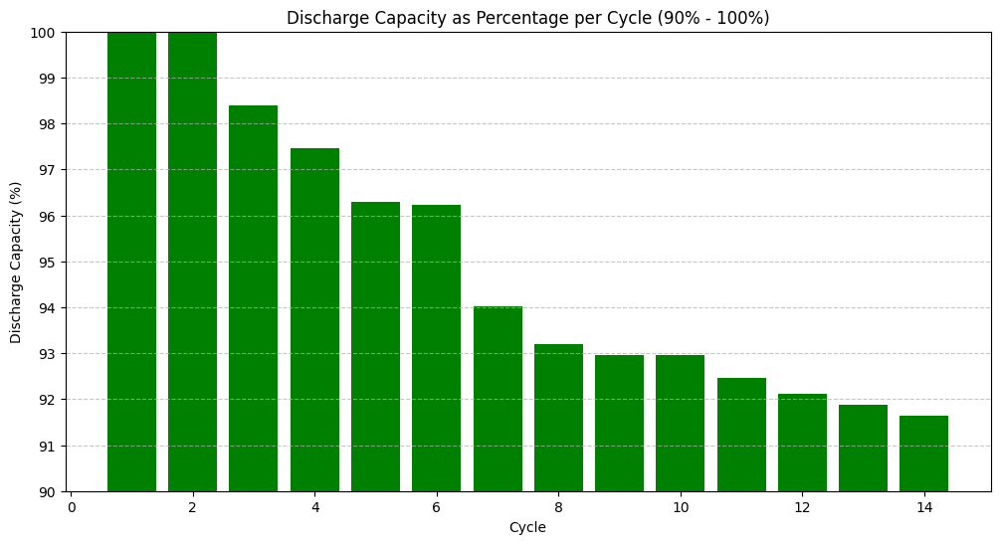

In [61]:
# Filter to keep only values between 90% and 100%
filtered_capacity_percentage = discharge_capacity_percentage[
    (discharge_capacity_percentage >= 90) & (discharge_capacity_percentage <= 100)
]

# Plot Discharge Capacity as Percentage (90% to 100%)
plt.figure(figsize=(12, 6))
plt.bar(filtered_capacity_percentage.index, filtered_capacity_percentage.values, color='green')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Set y-axis limits to zoom in between 90% and 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks at every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



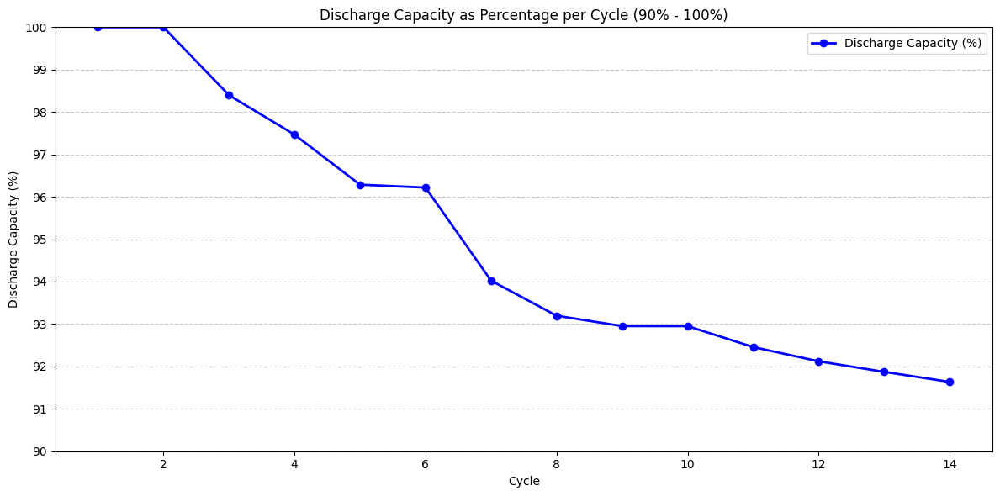

In [62]:
plt.figure(figsize=(12, 6))
plt.plot(filtered_capacity_percentage.index, filtered_capacity_percentage.values, 
         color='blue', marker='o', linestyle='-', linewidth=2, markersize=6, label='Discharge Capacity (%)')

# Add labels, title, grid, and ticks
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Focus on 90% to 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.show()

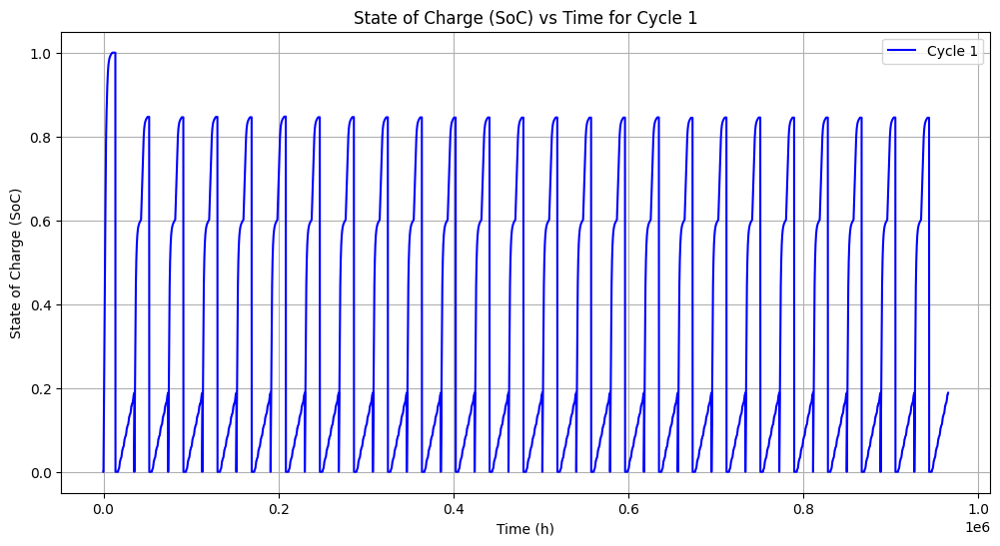

C:\Users\ymuba\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


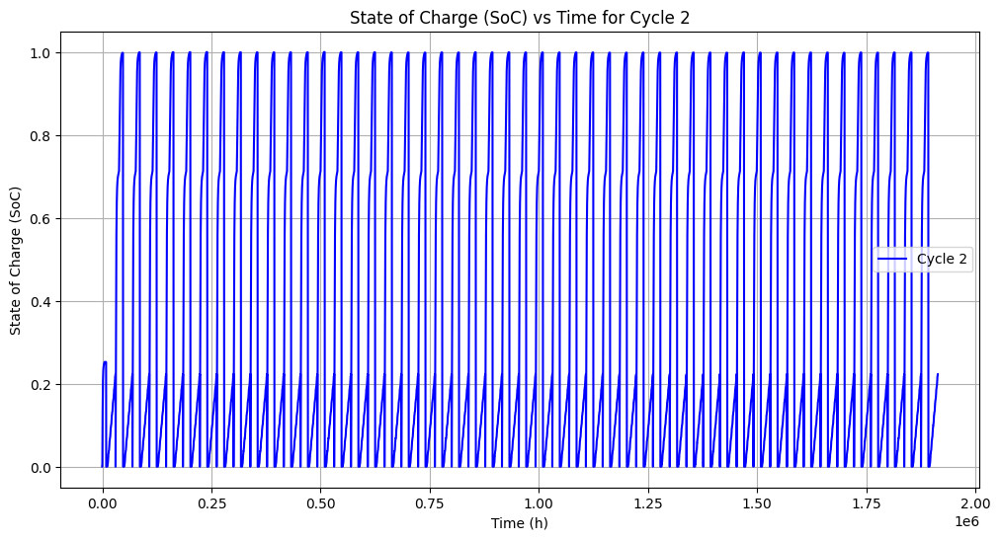

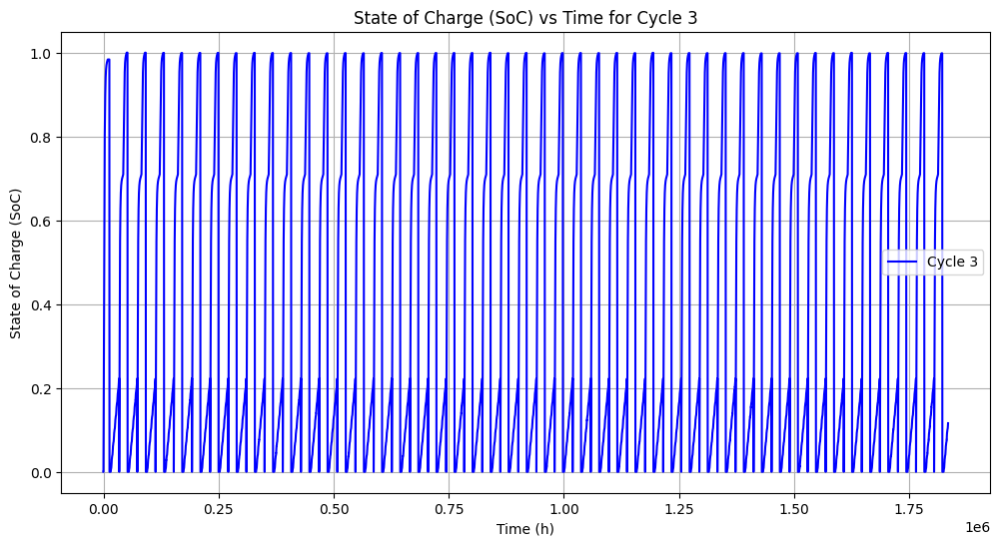

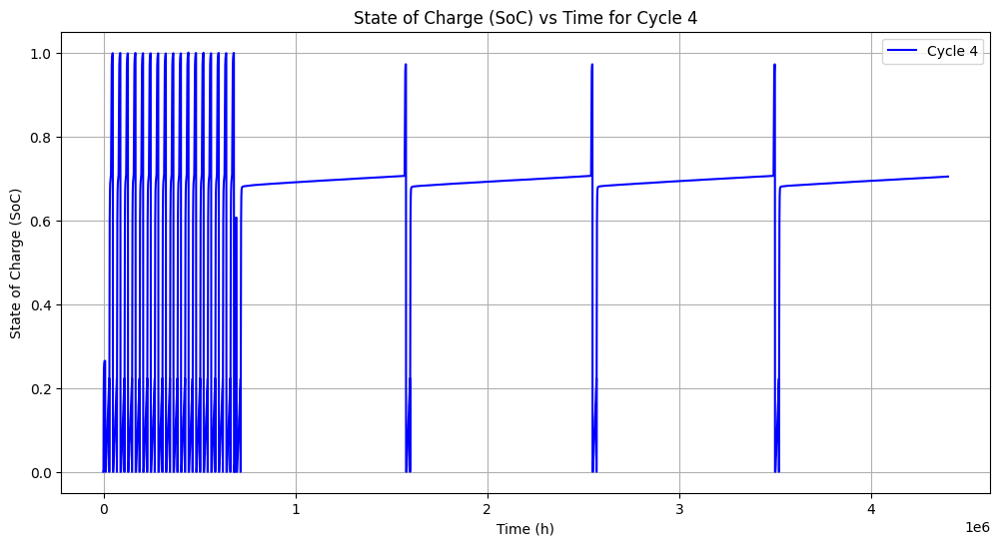

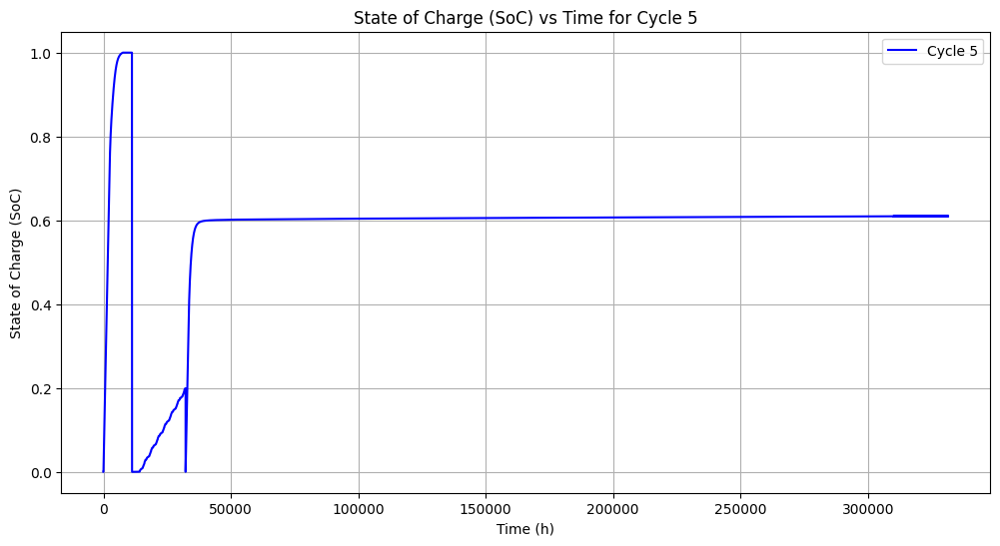

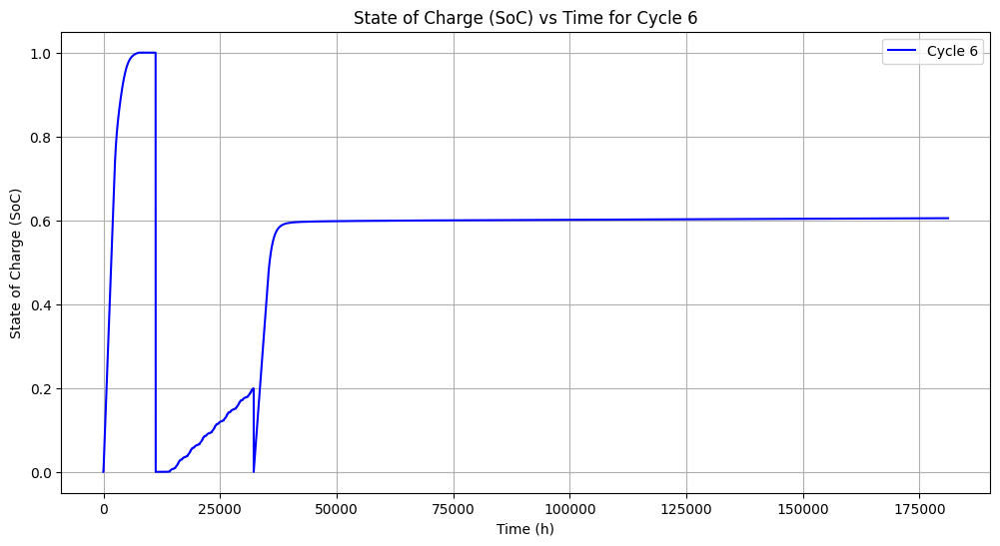

...

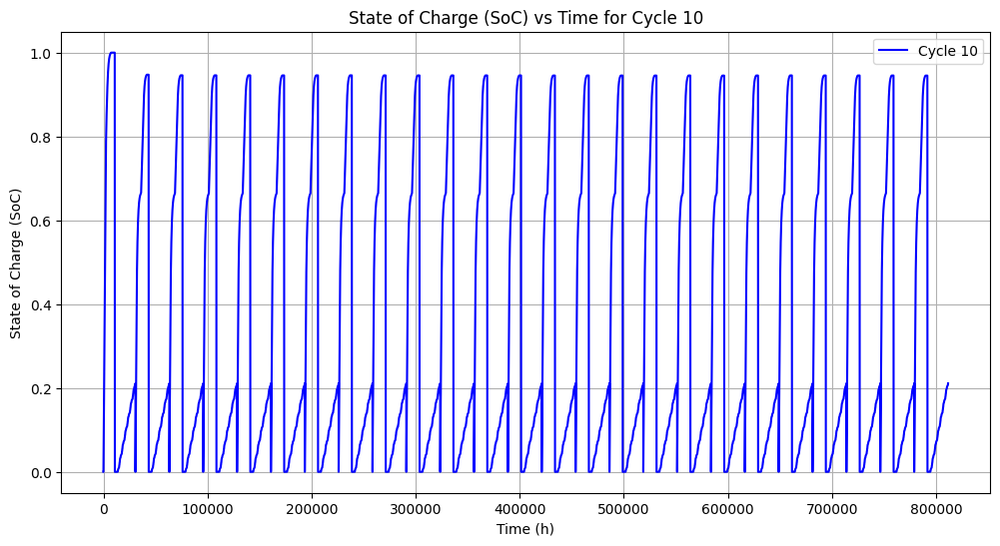

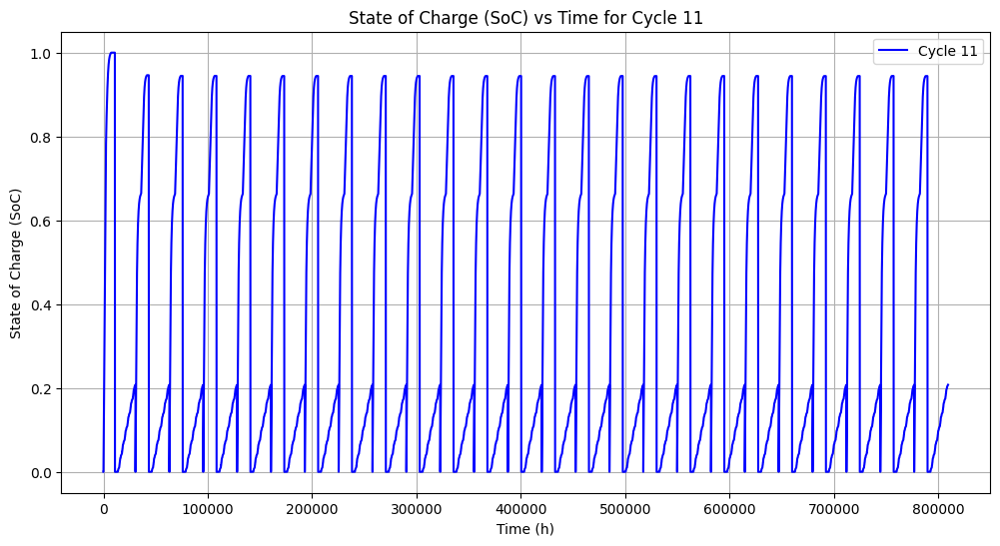

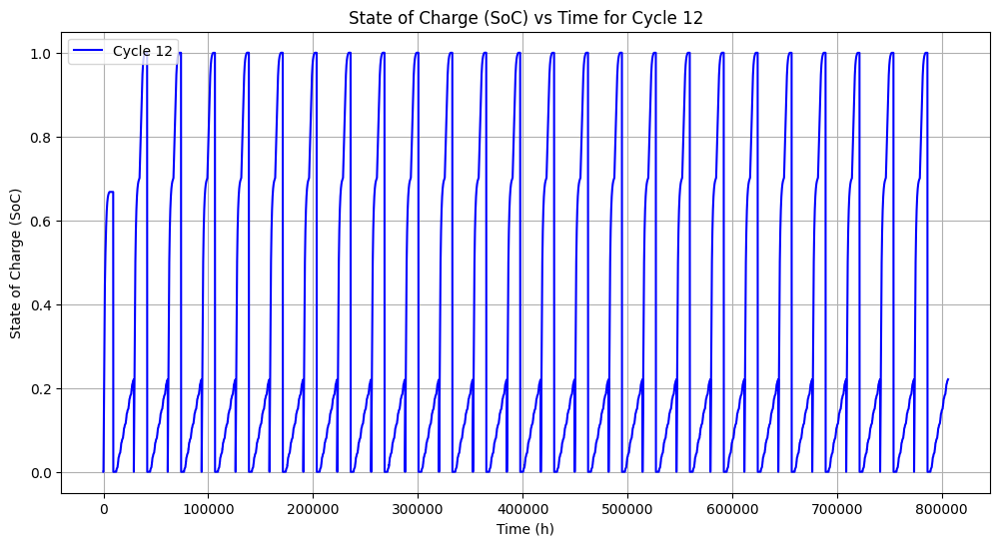

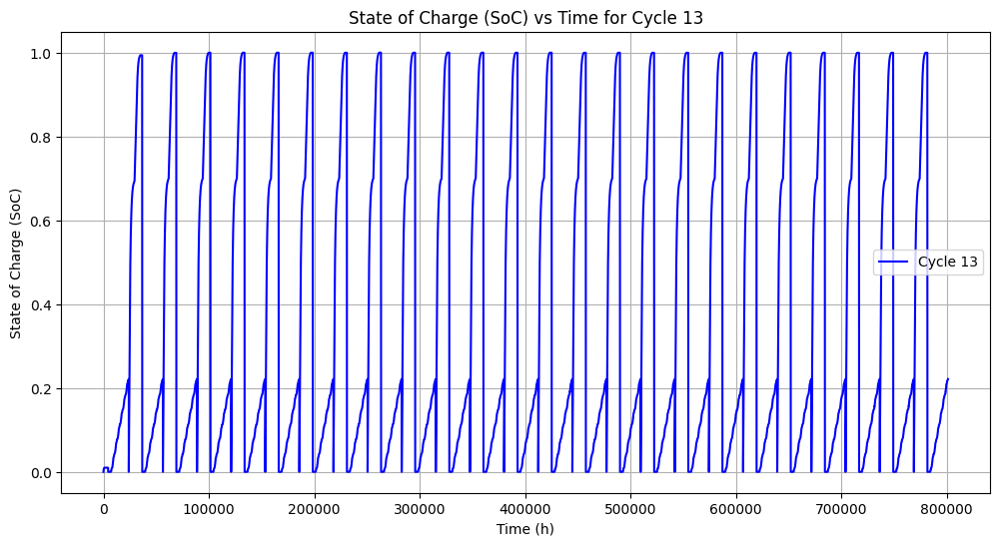

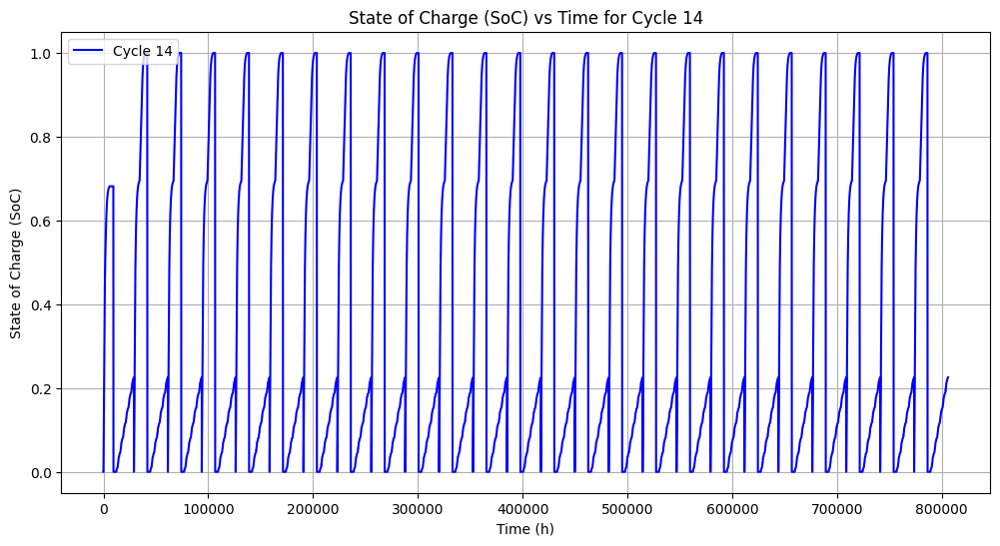

In [63]:
# Loop through each unique cycle and plot SoC vs. Time
for cycle in W9_combined_data['Cycle'].unique():
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(12, 6))  # Adjust the figure size for better visibility
    plt.plot(cycle_data['Time'], cycle_data['SoC'], label=f'Cycle {cycle}', color='blue')
    plt.xlabel('Time (h)')
    plt.ylabel('State of Charge (SoC)')
    plt.title(f'State of Charge (SoC) vs Time for Cycle {cycle}')
    plt.legend()
    plt.grid()
    plt.show()



The history saving thread hit an unexpected error (OperationalError('database or disk is full')).History will not be written to the database.


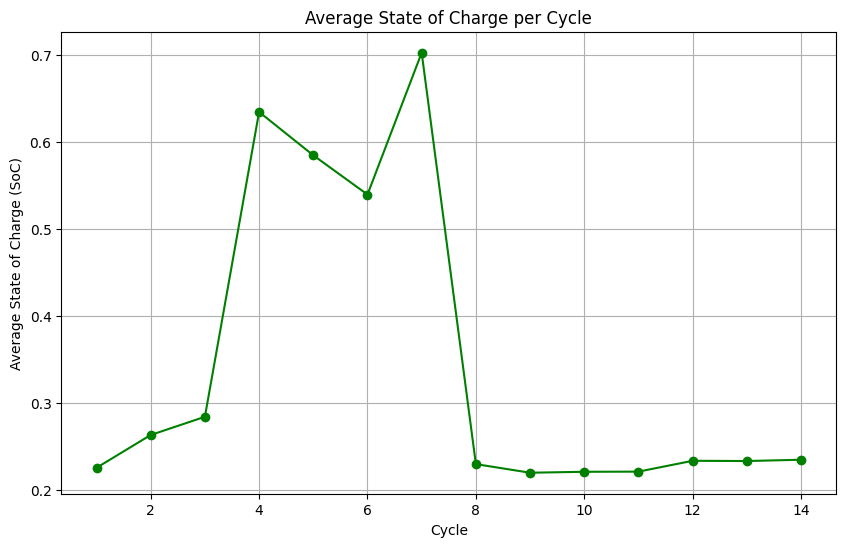

In [64]:
# Calculate average SoC per cycle
average_soc_per_cycle = W9_combined_data.groupby('Cycle')['SoC'].mean()

# Plot Average SoC per Cycle
plt.figure(figsize=(10, 6))
plt.plot(average_soc_per_cycle.index, average_soc_per_cycle.values, marker='o', color='green', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Average State of Charge (SoC)')
plt.title('Average State of Charge per Cycle')
plt.grid()
plt.show()


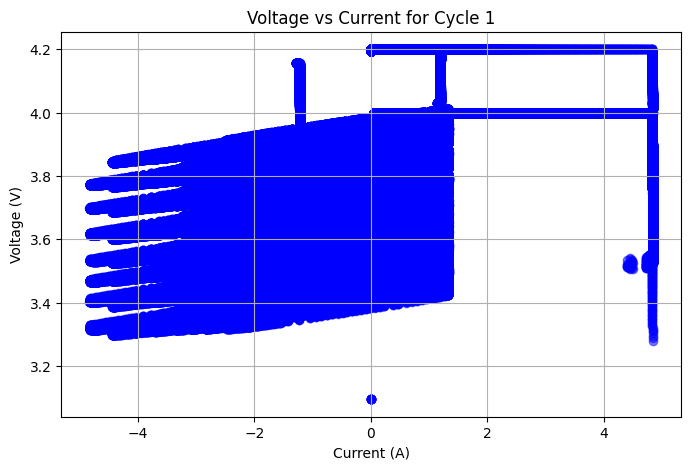

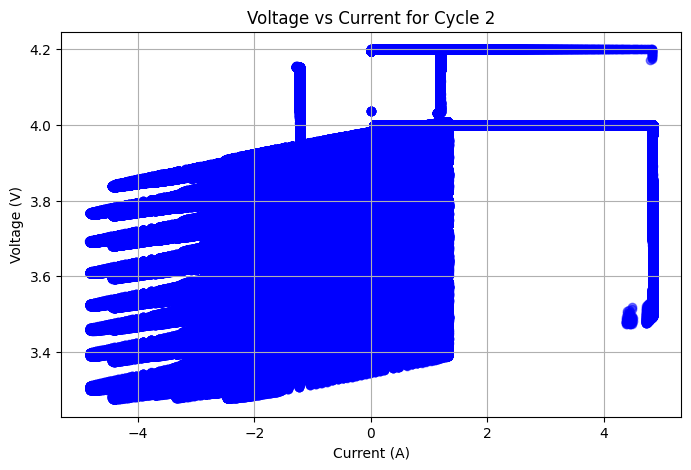

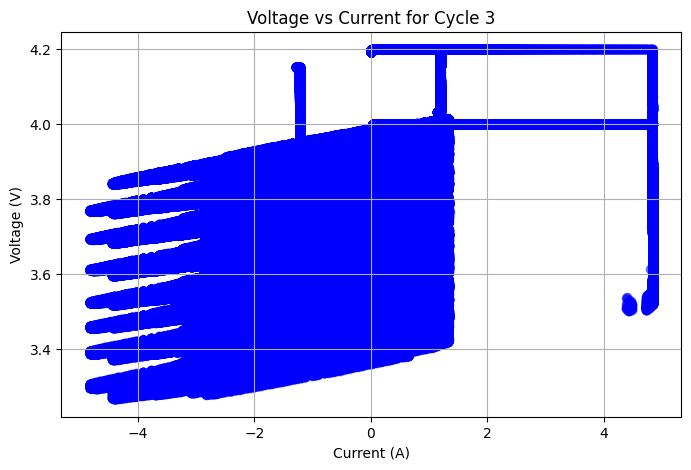

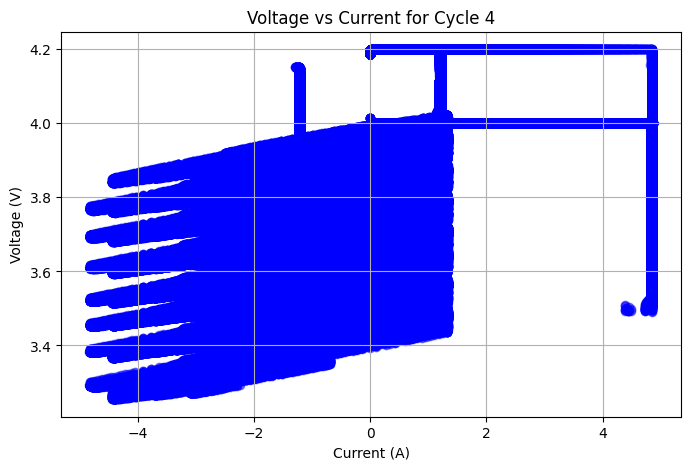

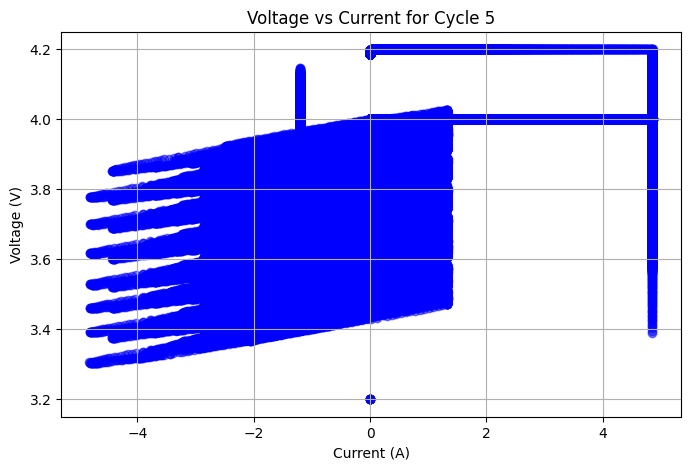

...

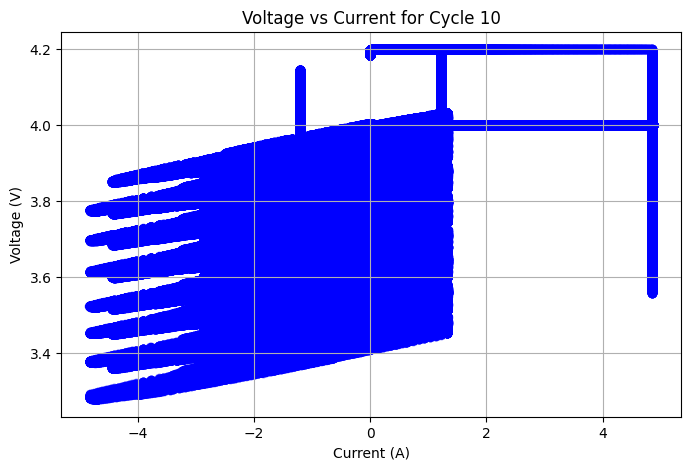

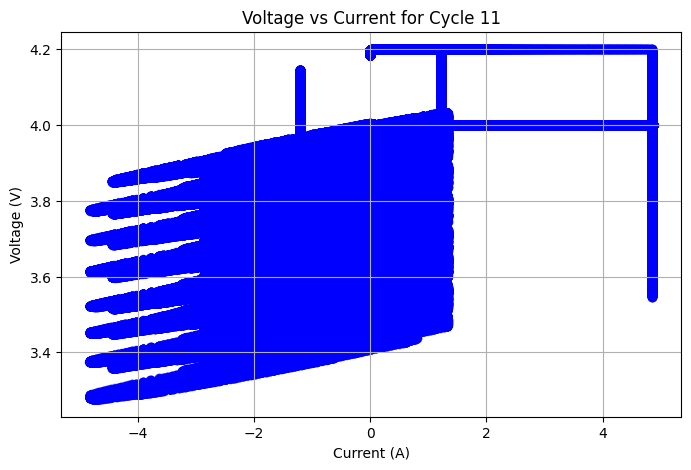

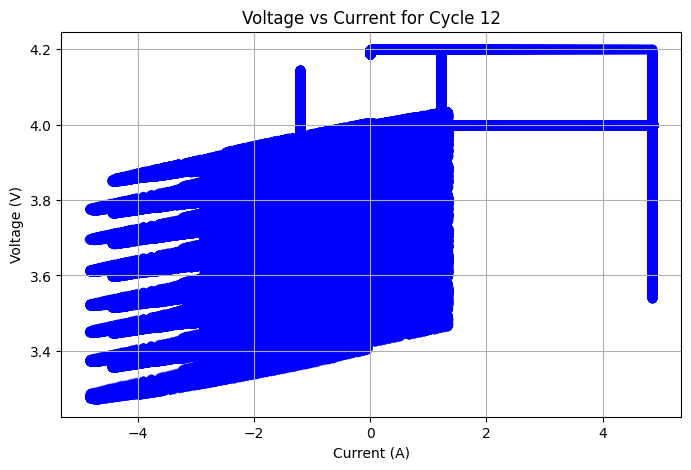

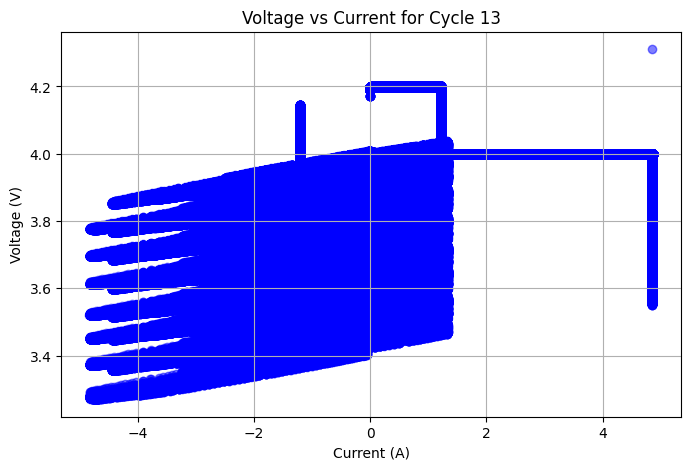

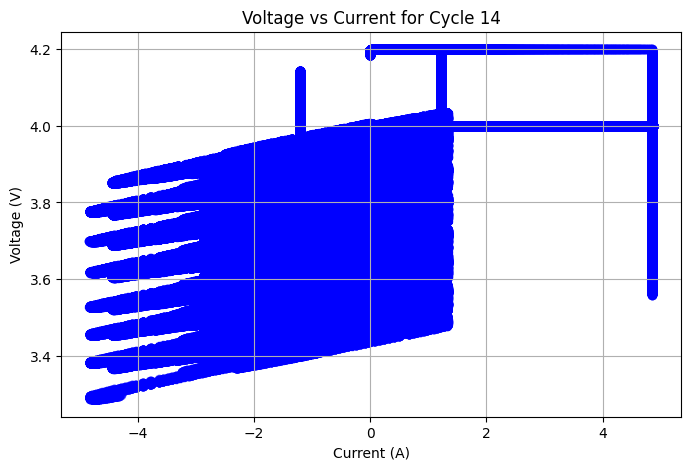

In [65]:
# Visualize the relationship between voltage and current for each cycle separately
for cycle in W9_combined_data['Cycle'].unique():
    cycle_data = W9_combined_data[W9_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))
    plt.scatter(cycle_data['Current'], cycle_data['Voltage'], color='blue', alpha=0.5)
    
    plt.xlabel('Current (A)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage vs Current for Cycle {cycle}')
    plt.grid()
    plt.show()


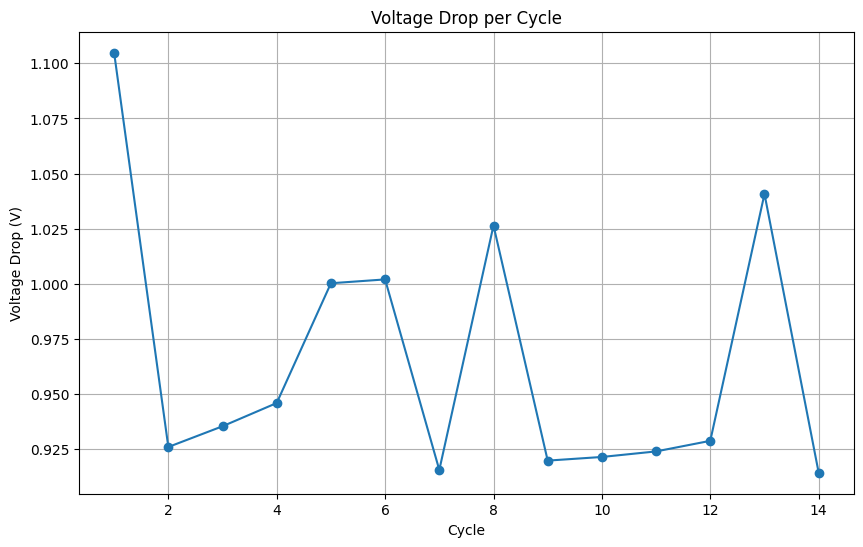

In [66]:
#Analyze how much the voltage drops within each cycle, which helps track battery degradation.
voltage_drop_per_cycle = W9_combined_data.groupby('Cycle').agg(
    max_voltage=('Voltage', 'max'),
    min_voltage=('Voltage', 'min')
)
voltage_drop_per_cycle['voltage_drop'] = voltage_drop_per_cycle['max_voltage'] - voltage_drop_per_cycle['min_voltage']

# Plot
plt.figure(figsize=(10, 6))
plt.plot(voltage_drop_per_cycle.index, voltage_drop_per_cycle['voltage_drop'], marker='o', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Voltage Drop (V)')
plt.title('Voltage Drop per Cycle')
plt.grid()
plt.show()


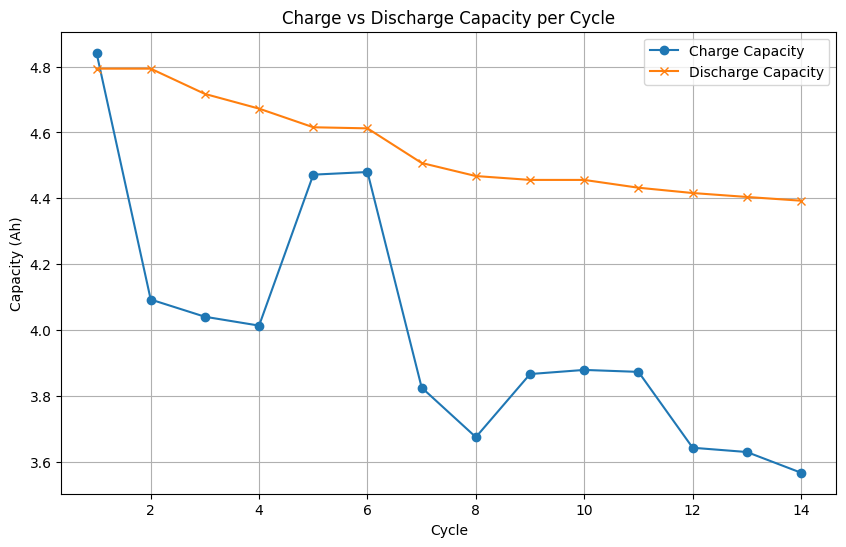

In [67]:
#Compare the charge and discharge capacity for each cycle. If there’s a growing difference, it indicates capacity loss.
capacity_per_cycle = W9_combined_data.groupby('Cycle').agg({
    'Charge_Capacity': 'max',
    'Discharge_Capacity': 'max'
})

plt.figure(figsize=(10, 6))
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Charge_Capacity'], label='Charge Capacity', marker='o')
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Discharge_Capacity'], label='Discharge Capacity', marker='x')
plt.xlabel('Cycle')
plt.ylabel('Capacity (Ah)')
plt.title('Charge vs Discharge Capacity per Cycle')
plt.legend()
plt.grid()
plt.show()


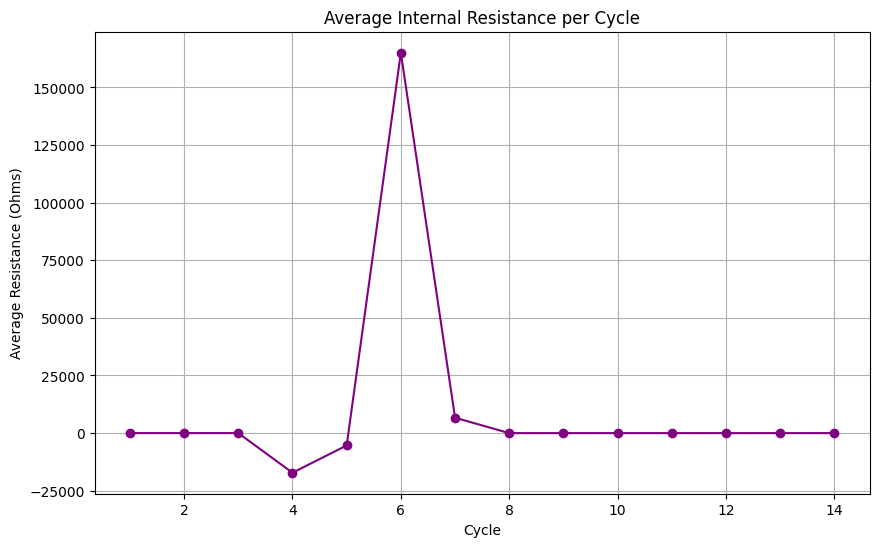

In [68]:
#Internal Resistance Over Time
W9_combined_data['Resistance'] = W9_combined_data['Voltage'] / W9_combined_data['Current']
W9_combined_data = W9_combined_data.replace([np.inf, -np.inf], np.nan).dropna(subset=['Resistance'])

# Average resistance per cycle
avg_resistance = W9_combined_data.groupby('Cycle')['Resistance'].mean()

# Plot
plt.figure(figsize=(10, 6))
plt.plot(avg_resistance.index, avg_resistance.values, marker='o', linestyle='-', color='purple')
plt.xlabel('Cycle')
plt.ylabel('Average Resistance (Ohms)')
plt.title('Average Internal Resistance per Cycle')
plt.grid()
plt.show()


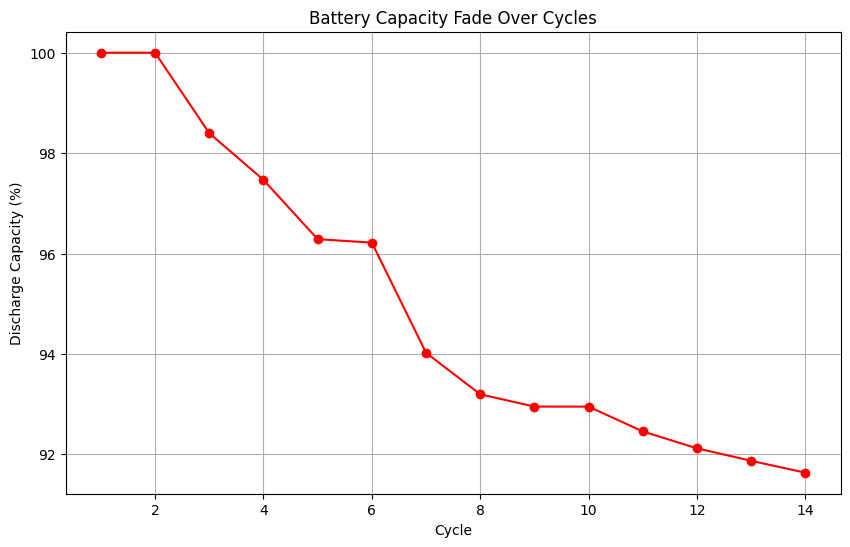

In [69]:
max_discharge_capacity = W9_combined_data['Discharge_Capacity'].max()

discharge_capacity_per_cycle = W9_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

#Visualize how discharge capacity decreases over time (cycle aging).
plt.figure(figsize=(10, 6))
plt.plot(discharge_capacity_percentage.index, discharge_capacity_percentage.values, 
         marker='o', linestyle='-', color='red')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Battery Capacity Fade Over Cycles')
plt.grid()
plt.show()


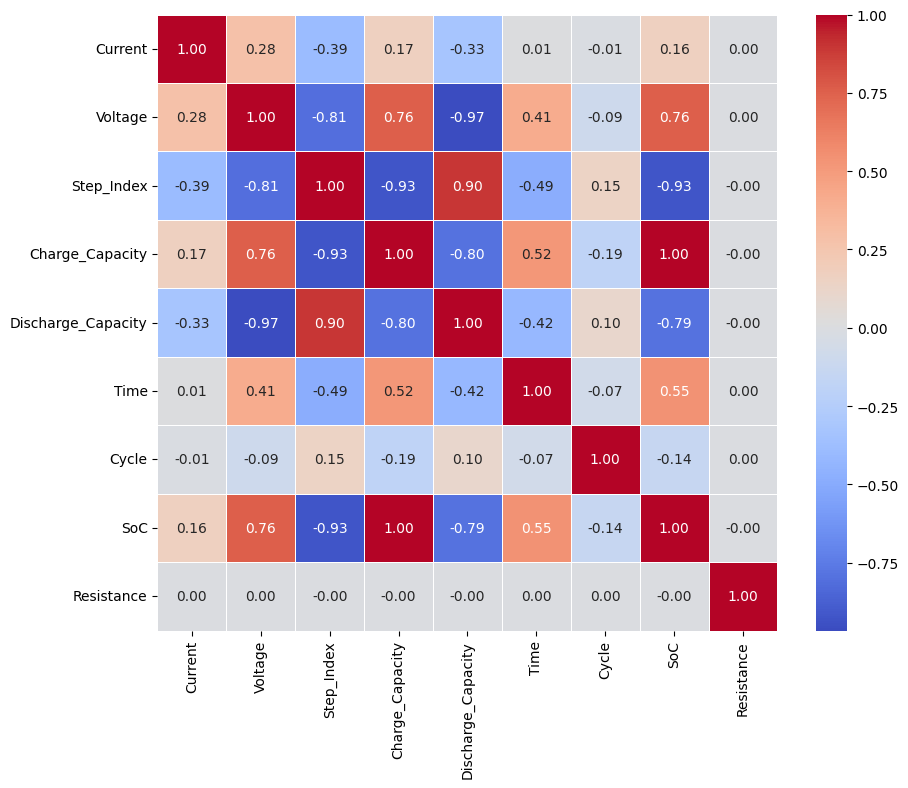

In [70]:
#Correlation analysis Check for correlations between numerical variables using a correlation matrix.
corr_matrix = W9_combined_data.corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.show()

In [ ]:
#Normality tests Test whether certain columns (like Voltage, Current) follow a normal distribution using statistical tests such as Shapiro-Wilk.
from scipy.stats import shapiro

# Example: Shapiro-Wilk test for normality
stat, p_value = shapiro(W9_combined_data['Voltage'])
print(f"Shapiro-Wilk Test: Stat={stat}, P-value={p_value}")


Shapiro-Wilk Test: Stat=0.6821217100047254, P-value=5.305033824260401e-140


d:\SN750\Anaconda\Lib\site-packages\scipy\stats\_axis_nan_policy.py:531: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 220631023.
  res = hypotest_fun_out(*samples, **kwds)


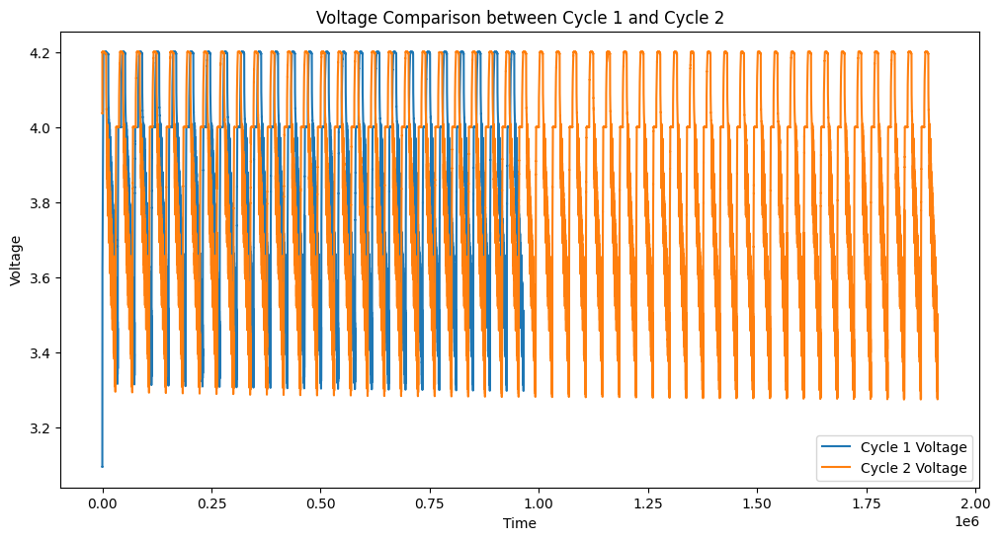

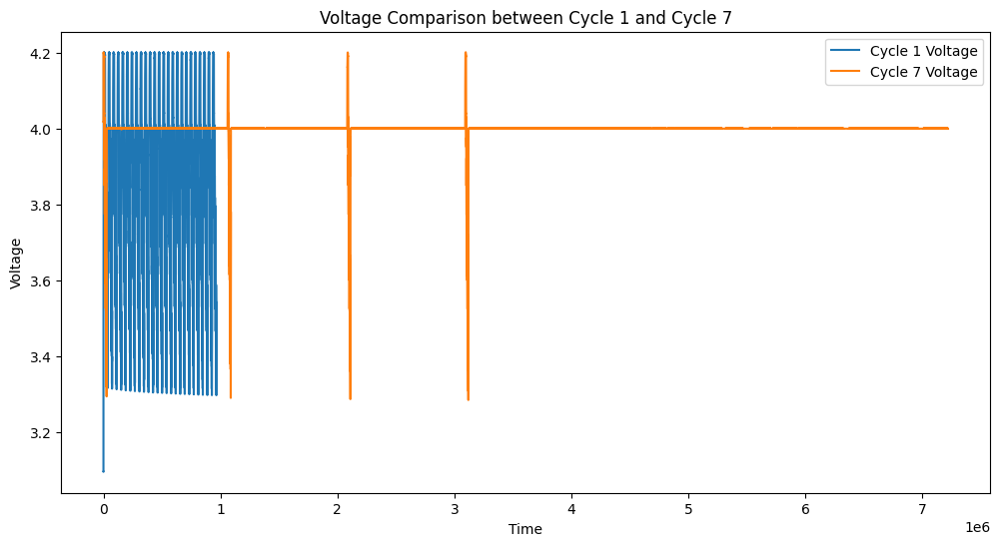

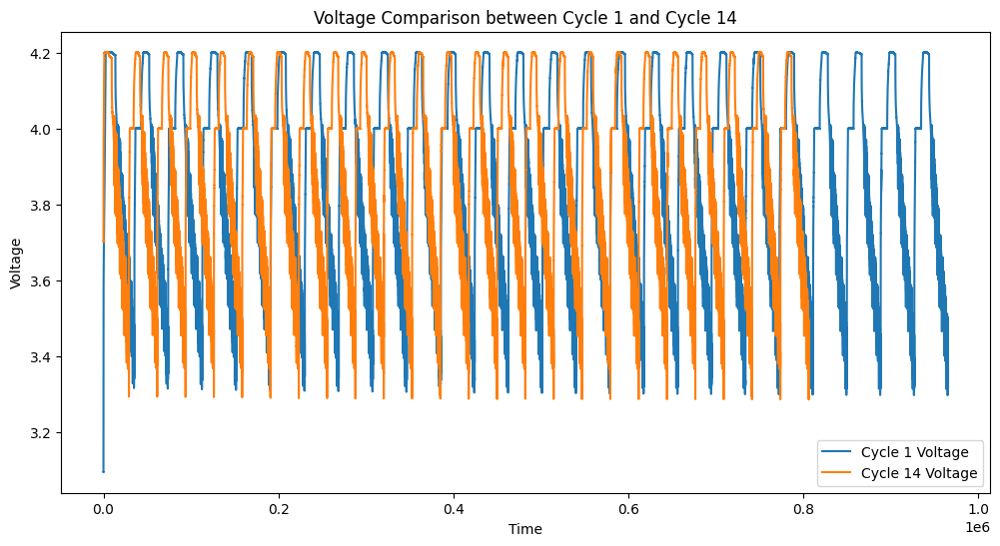

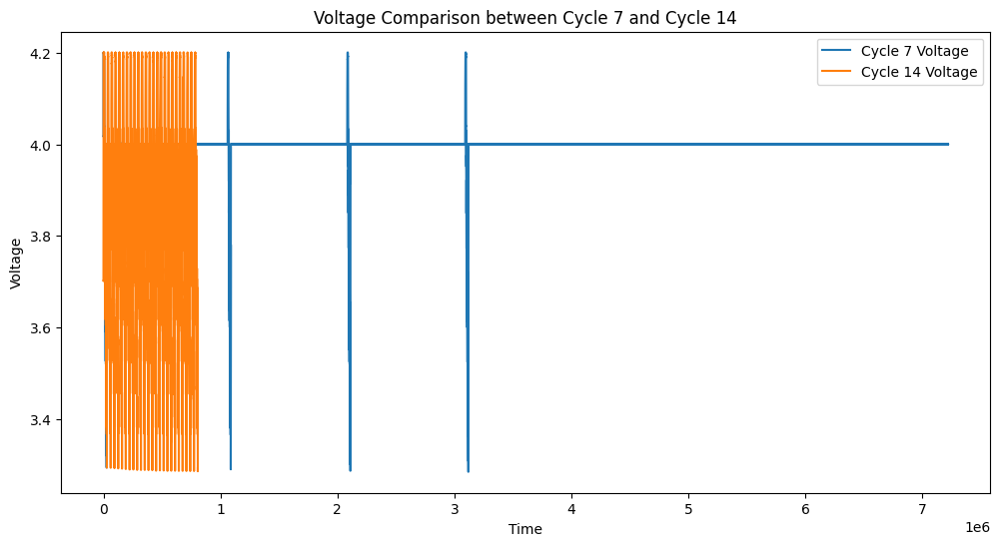

In [71]:
#Cycle-wise analysis Visualize data for different cycles separately to see if there are patterns or anomalies.
cycle_1 = W9_combined_data_cleaned[W9_combined_data_cleaned['Cycle'] == 1]
cycle_2 = W9_combined_data_cleaned[W9_combined_data_cleaned['Cycle'] == 2]
cycle_7 = W9_combined_data_cleaned[W9_combined_data_cleaned['Cycle'] == 7]
cycle_14 = W9_combined_data_cleaned[W9_combined_data_cleaned['Cycle'] == 14]


# Plot Voltage for Cycle 1 and Cycle 2
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_2['Time'], cycle_2['Voltage'], label='Cycle 2 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 2')
plt.legend()
plt.show()

# Plot Voltage for Cycle 1 and Cycle 7
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_7['Time'], cycle_7['Voltage'], label='Cycle 7 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 7')
plt.legend()
plt.show()

# Plot Voltage for Cycle 1 and Cycle 14
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_14['Time'], cycle_14['Voltage'], label='Cycle 14 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 14')
plt.legend()
plt.show()

# Plot Voltage for Cycle 7 and Cycle 14
plt.figure(figsize=(12, 6))
plt.plot(cycle_7['Time'], cycle_7['Voltage'], label='Cycle 7 Voltage')
plt.plot(cycle_14['Time'], cycle_14['Voltage'], label='Cycle 14 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 7 and Cycle 14')
plt.legend()
plt.show()

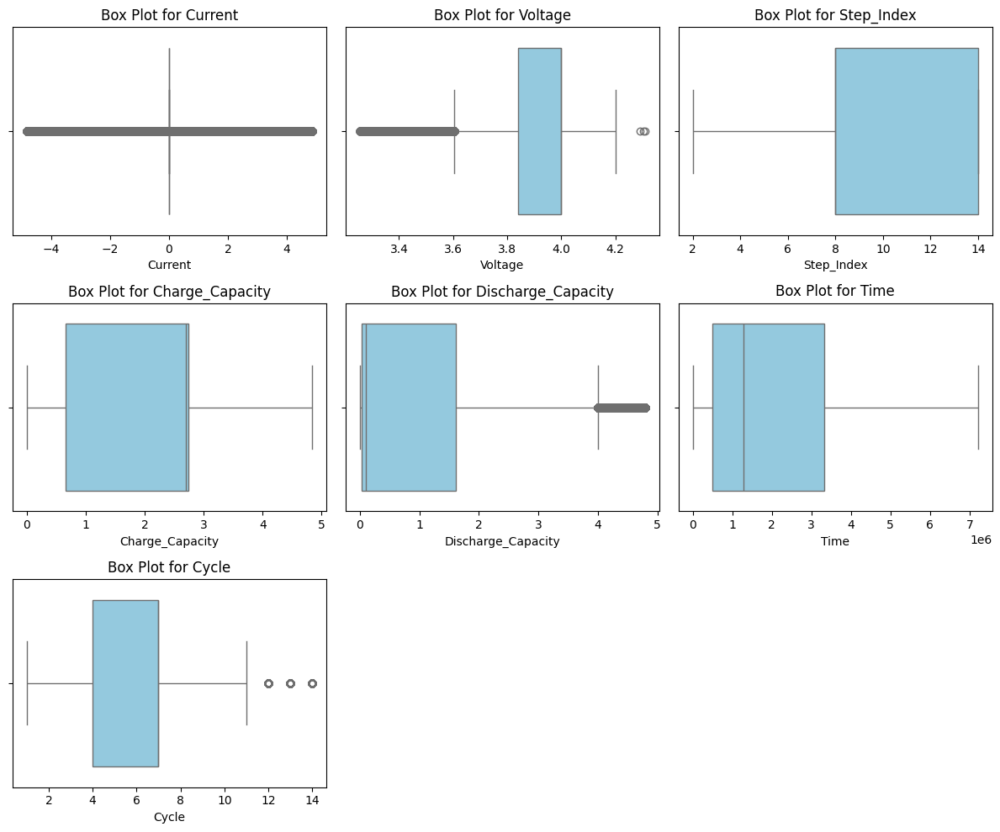

In [72]:
numerical_columns = ['Current', 'Voltage', 'Step_Index', 'Charge_Capacity', 
                     'Discharge_Capacity', 'Time', 'Cycle']

# Create a figure and a grid of subplots for boxplots
plt.figure(figsize=(12, 10))
for idx, column in enumerate(numerical_columns, 1):
    plt.subplot(3, 3, idx)  # 3x3 grid layout
    sns.boxplot(x=W9_combined_data[column], color='skyblue')
    plt.title(f'Box Plot for {column}')
    plt.xlabel(column)

# Adjust layout to avoid overlap
plt.tight_layout()
plt.show()

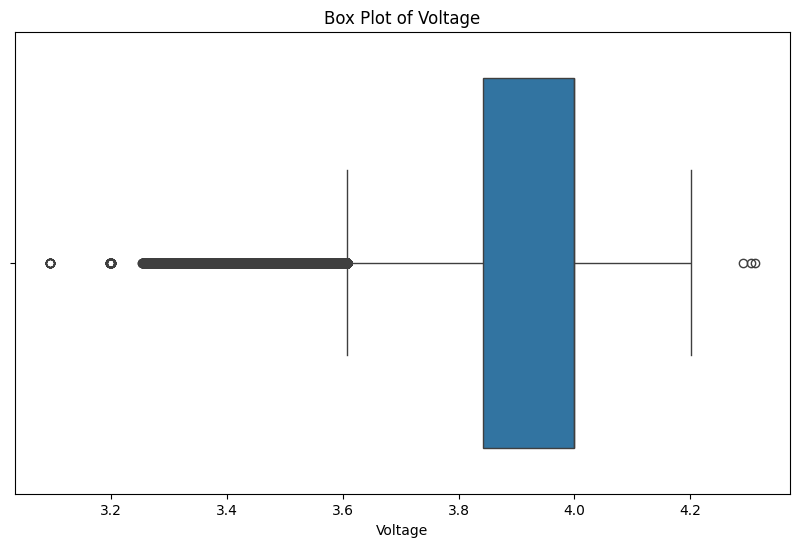

In [73]:
# Create a box plot of the 'Voltage' column after remove the 0 values
plt.figure(figsize=(10, 6))
sns.boxplot(x='Voltage', data=W9_combined_data_cleaned)
plt.title('Box Plot of Voltage')
plt.xlabel('Voltage')
plt.show()

In [74]:
W9_combined_data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 198233876 entries, 1 to 198233893
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 11.8 GB


In [ ]:
#split the dataset into training and testing sets and use algorithms Random Forest, XGBoost, or LSTM (if the data is sequential) for regression or classification tasks.

## Visualising and cleaning up data for Cell W10

In [4]:
W10_combined_data = pd.read_csv('W10_combined_data.csv')

In [23]:
W10_combined_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 223007889 entries, 0 to 223007888
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 11.6 GB


In [24]:
W10_combined_data.shape

(223007889, 7)

In [25]:
W10_combined_data.columns[W10_combined_data.isnull().any()]

Index([], dtype='object')

In [26]:
W10_combined_data.isnull().sum()

Current               0
Voltage               0
Step_Index            0
Charge_Capacity       0
Discharge_Capacity    0
Time                  0
Cycle                 0
dtype: int64

In [27]:
duplicates = W10_combined_data.duplicated().sum()
print(f"Number of duplicate rows: {duplicates}")



Number of duplicate rows: 0


In [28]:
# Summary statistics
print(W10_combined_data.describe())


            Current       Voltage    Step_Index  Charge_Capacity  \
count  2.230079e+08  2.230079e+08  2.230079e+08     2.230079e+08   
mean  -8.348142e-03  3.914411e+00  9.717351e+00     2.041304e+00   
std    1.151782e+00  1.676143e-01  2.699400e+00     1.061904e+00   
min   -4.839447e+00  0.000000e+00  0.000000e+00     0.000000e+00   
25%   -6.170775e-04  3.902761e+00  8.000000e+00     7.506945e-01   
50%    1.899495e-04  3.999966e+00  8.000000e+00     2.688193e+00   
75%    8.665086e-04  4.000024e+00  1.400000e+01     2.744229e+00   
max    1.460964e+01  4.310228e+00  1.400000e+01     4.833402e+00   

       Discharge_Capacity          Time         Cycle  
count        2.230079e+08  2.230079e+08  2.230079e+08  
mean         7.948454e-01  1.920461e+06  6.262801e+00  
std          1.347106e+00  1.864627e+06  2.949979e+00  
min          0.000000e+00  0.000000e+00  1.000000e+00  
25%          1.409614e-02  5.179582e+05  4.000000e+00  
50%          3.922925e-02  1.169150e+06  7.000000e+

In [29]:
W10_combined_data['Current'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
223007884   -3.905632
223007885   -3.907097
223007886   -4.038940
223007887   -4.100693
223007888   -4.156906
Name: Current, Length: 223007889, dtype: float64>

In [30]:
W10_combined_data['Voltage'].describe

<bound method NDFrame.describe of 0            0.000000
1            3.117589
2            3.117629
3            3.117580
4            3.117582
               ...   
223007884    3.315635
223007885    3.315074
223007886    3.311043
223007887    3.308866
223007888    3.307459
Name: Voltage, Length: 223007889, dtype: float64>

In [31]:
W10_combined_data['Step_Index'].describe

<bound method NDFrame.describe of 0             0
1             1
2             1
3             1
4             1
             ..
223007884    14
223007885    14
223007886    14
223007887    14
223007888    14
Name: Step_Index, Length: 223007889, dtype: int64>

In [32]:
W10_combined_data['Charge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
223007884    0.803516
223007885    0.803516
223007886    0.803516
223007887    0.803516
223007888    0.803516
Name: Charge_Capacity, Length: 223007889, dtype: float64>

In [33]:
W10_combined_data['Discharge_Capacity'].describe

<bound method NDFrame.describe of 0            0.000000
1            0.000000
2            0.000000
3            0.000000
4            0.000000
               ...   
223007884    4.384711
223007885    4.384816
223007886    4.384920
223007887    4.385023
223007888    4.385121
Name: Discharge_Capacity, Length: 223007889, dtype: float64>

In [34]:
W10_combined_data['Time'].describe

<bound method NDFrame.describe of 0                 0.000000
1                 0.100600
2                 0.200700
3                 0.301100
4                 0.400500
                 ...      
223007884    799709.633904
223007885    799709.734204
223007886    799709.834004
223007887    799709.933404
223007888    799710.015804
Name: Time, Length: 223007889, dtype: float64>

In [35]:
W10_combined_data['Cycle'].describe

<bound method NDFrame.describe of 0             1
1             1
2             1
3             1
4             1
             ..
223007884    14
223007885    14
223007886    14
223007887    14
223007888    14
Name: Cycle, Length: 223007889, dtype: int64>

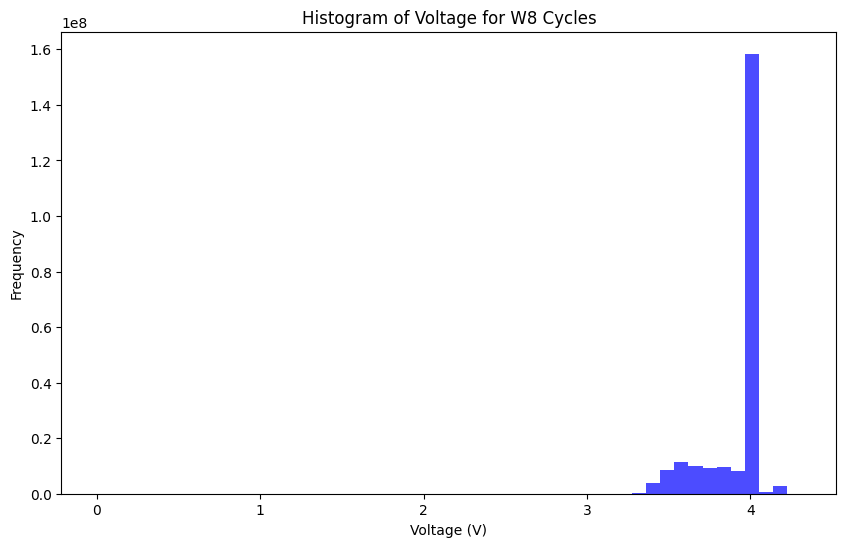

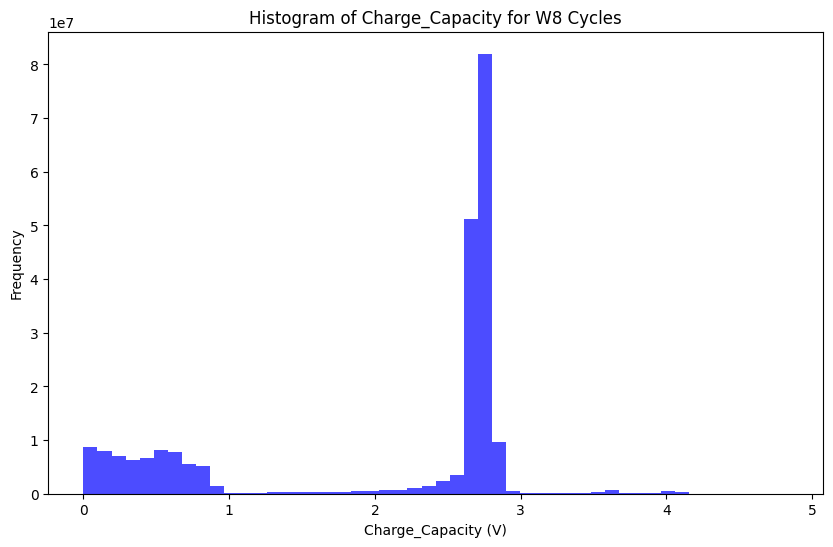

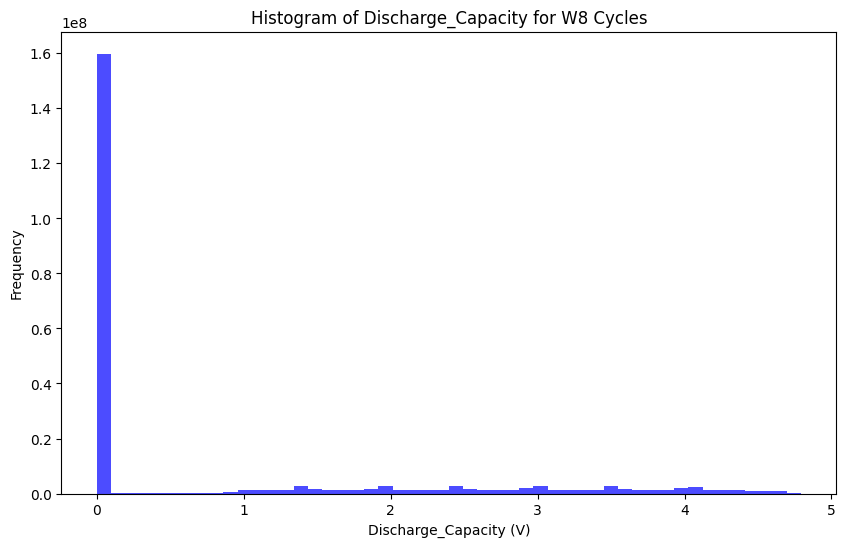

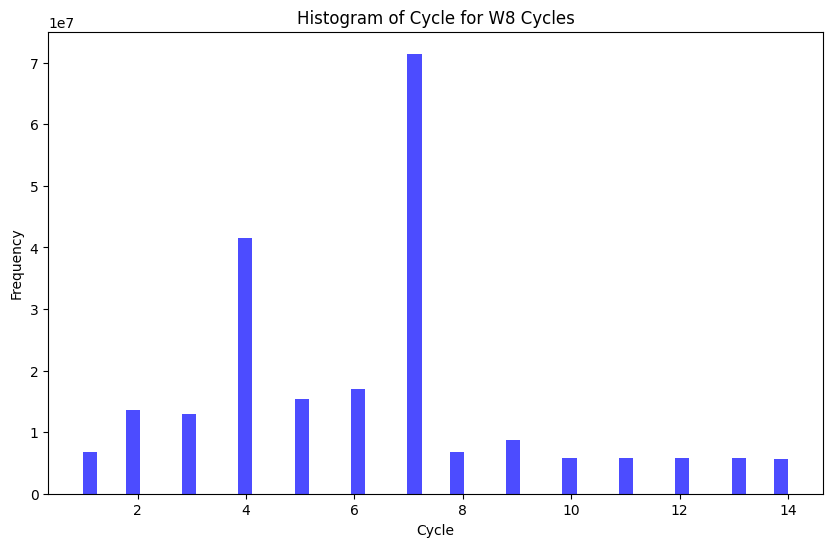

In [36]:
# Step 1: Plot histogram of voltage values
plt.figure(figsize=(10, 6))
plt.hist(W10_combined_data['Voltage'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Voltage (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Voltage for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Charge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W10_combined_data['Charge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Charge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Charge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Discharge_Capacity values
plt.figure(figsize=(10, 6))
plt.hist(W10_combined_data['Discharge_Capacity'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Discharge_Capacity (V)')
plt.ylabel('Frequency')
plt.title('Histogram of Discharge_Capacity for W8 Cycles')
plt.show()

# Step 1: Plot histogram of Cycle values
plt.figure(figsize=(10, 6))
plt.hist(W10_combined_data['Cycle'], bins=50, color='blue', alpha=0.7)
plt.xlabel('Cycle')
plt.ylabel('Frequency')
plt.title('Histogram of Cycle for W8 Cycles')
plt.show()

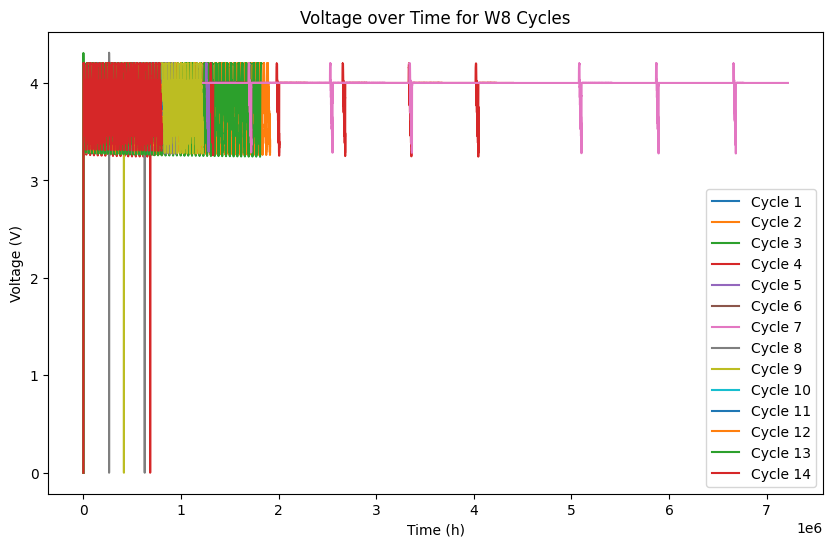

In [37]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W10_combined_data['Cycle'].unique():
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

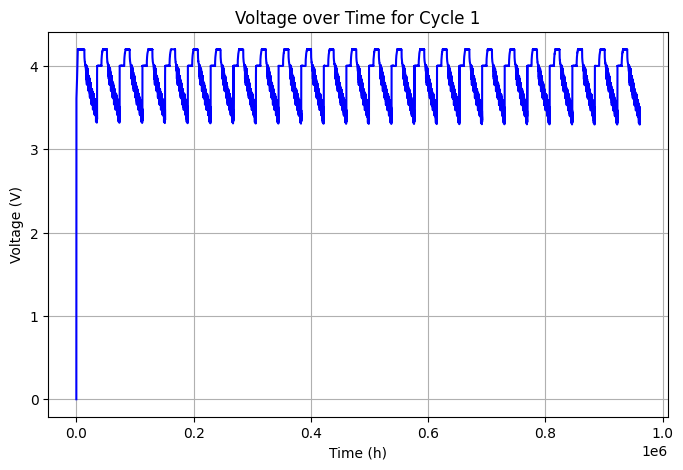

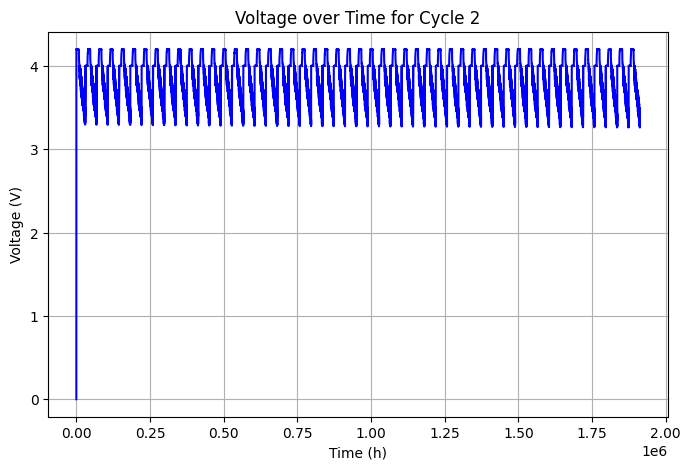

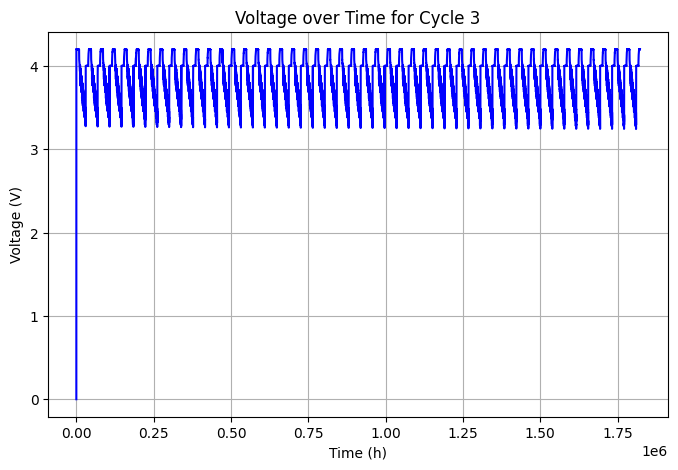

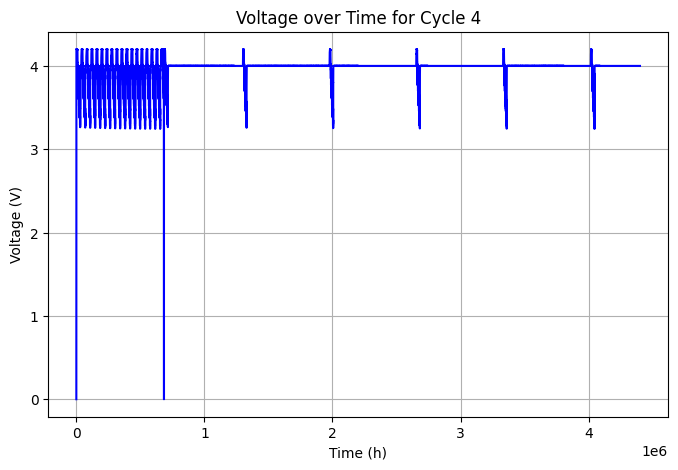

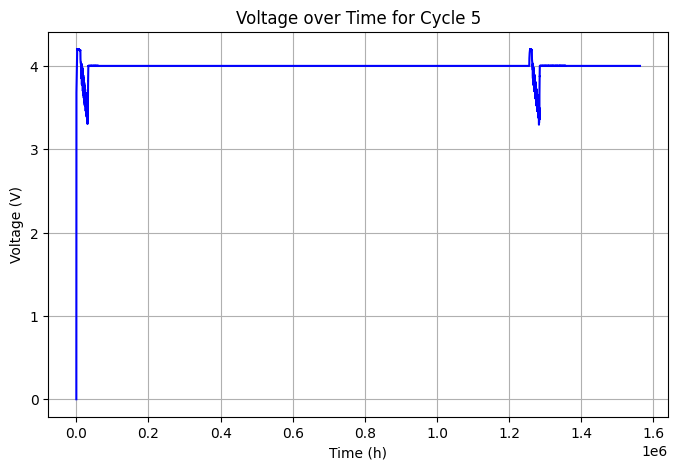

...

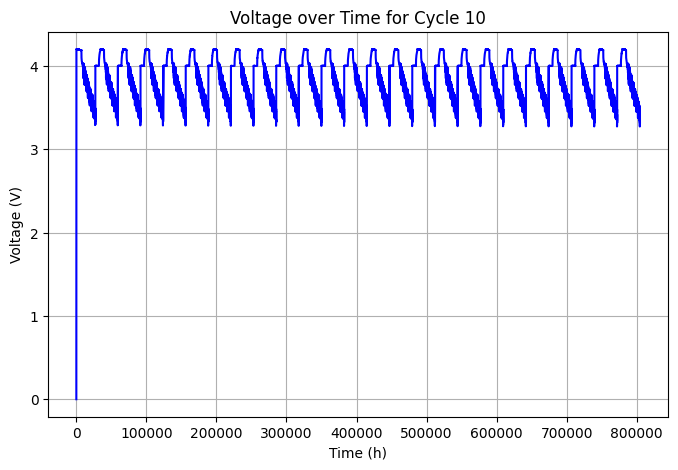

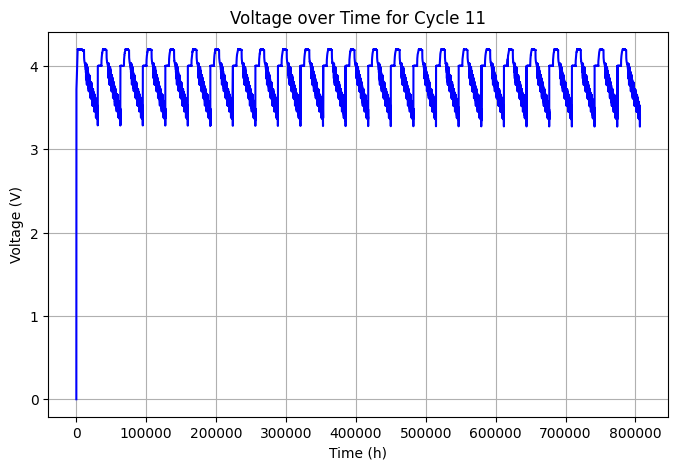

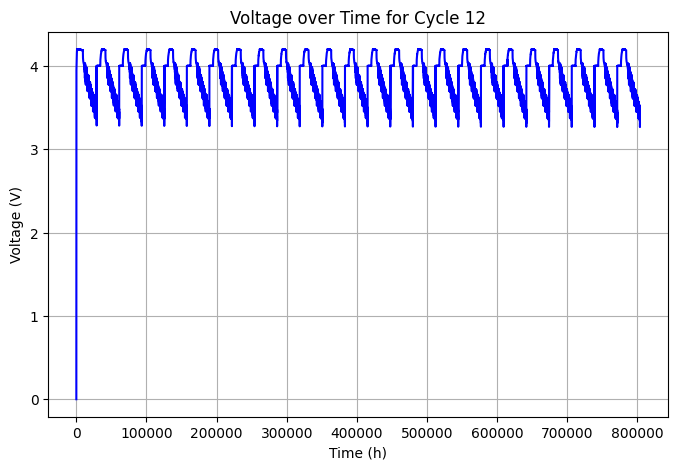

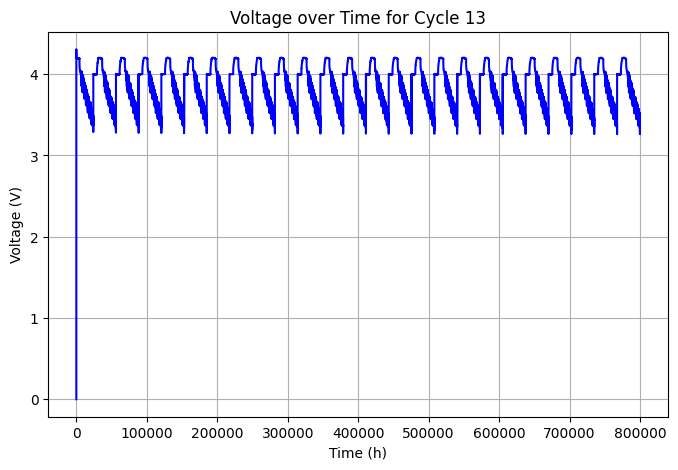

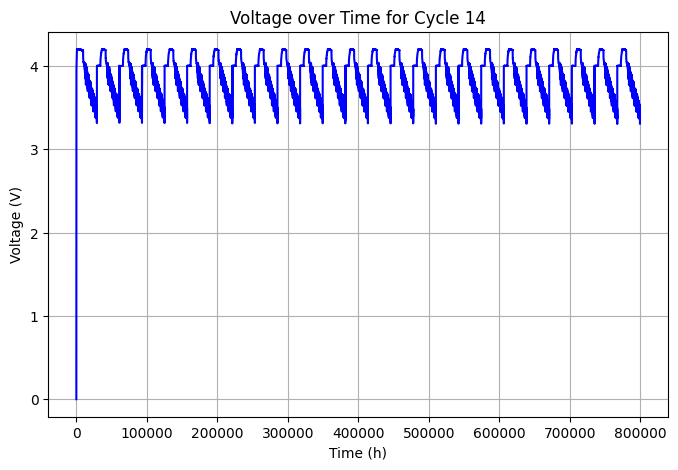

In [38]:
# Loop through each unique cycle and create a separate plot
for cycle in W10_combined_data['Cycle'].unique():
    # Filter data for the current cycle
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))  # Adjust figure size if needed
    
    # Plot Voltage vs. Time for the current cycle
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], color='blue', linewidth=1.5)
    
    # Add labels, title, and formatting
    plt.xlabel('Time (h)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage over Time for Cycle {cycle}')
    
    # Optional: Add grid for better visibility
    plt.grid(True)
    
    # Show the plot
    plt.show()


In [39]:
# Filter rows where Voltage is 0
voltage_zeros = W10_combined_data[W10_combined_data['Voltage'] == 0]
print(f"Rows with Voltage = 0:\n{voltage_zeros}")

Rows with Voltage = 0:
           Current  Voltage  Step_Index  Charge_Capacity  Discharge_Capacity  \
0              0.0      0.0           0              0.0                 0.0   
6819114        0.0      0.0           0              0.0                 0.0   
20357631       0.0      0.0           0              0.0                 0.0   
33324023       0.0      0.0           0              0.0                 0.0   
38182698       0.0      0.0           0              0.0                 0.0   
74796745       0.0      0.0           0              0.0                 0.0   
90207659       0.0      0.0           0              0.0                 0.0   
107179667      0.0      0.0           0              0.0                 0.0   
178654562      0.0      0.0           0              0.0                 0.0   
180518449      0.0      0.0           0              0.0                 0.0   
183130724      0.0      0.0           0              0.0                 0.0   
185416255      0.

In [40]:
# Filter rows where Time is 2
time_at_2 = W10_combined_data[W10_combined_data['Time'] > 2]
print(f"Rows with Time = 2:\n{time_at_2}")


Rows with Time = 2:
            Current   Voltage  Step_Index  Charge_Capacity  \
12         4.866150  3.302082           2         0.001338   
13         4.864563  3.311771           2         0.002694   
14         4.868103  3.319435           2         0.004052   
15         4.867859  3.326225           2         0.005396   
16         4.865234  3.332208           2         0.006746   
...             ...       ...         ...              ...   
223007884 -3.905632  3.315635          14         0.803516   
223007885 -3.907097  3.315074          14         0.803516   
223007886 -4.038940  3.311043          14         0.803516   
223007887 -4.100693  3.308866          14         0.803516   
223007888 -4.156906  3.307459          14         0.803516   

           Discharge_Capacity           Time  Cycle  
12                   0.000053       2.048500      1  
13                   0.000053       3.048500      1  
14                   0.000053       4.048900      1  
15                 

In [19]:
# Remove rows where Voltage is 0
W10_combined_data_cleaned = W10_combined_data[W10_combined_data['Voltage'] > 0]

# Remove rows where Time is 2
#W9_combined_data_cleaned = W9_combined_data_cleaned[W9_combined_data_cleaned['Time'] < 3]

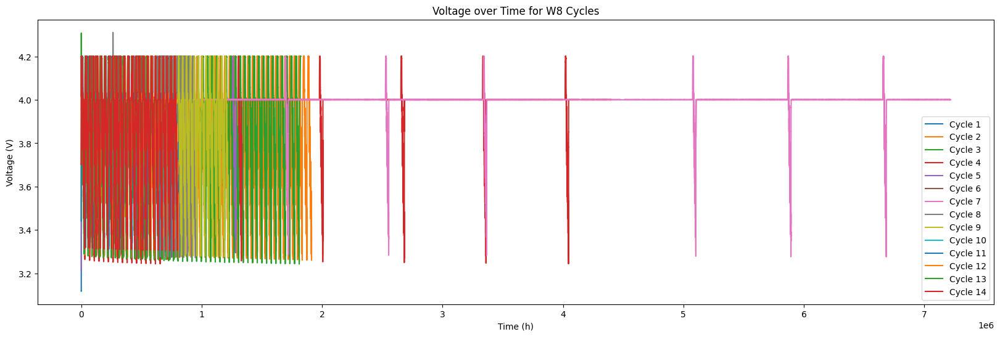

In [42]:
# Voltage vs. Time for each cycle
plt.figure(figsize=(20, 6))
for cycle in W10_combined_data_cleaned['Cycle'].unique():
    cycle_data = W10_combined_data_cleaned[W10_combined_data_cleaned['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Voltage'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Voltage (V)')
plt.title('Voltage over Time for W8 Cycles')
plt.legend()
plt.show()

C:\Users\ymuba\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


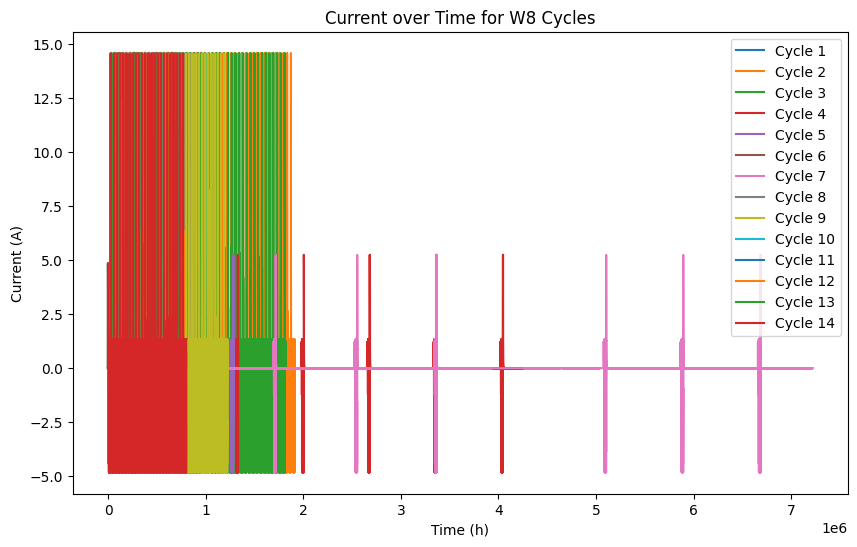

In [43]:
# Current vs. Time for each cycle
plt.figure(figsize=(10, 6))
for cycle in W10_combined_data['Cycle'].unique():
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    plt.plot(cycle_data['Time'], cycle_data['Current'], label=f'Cycle {cycle}')
plt.xlabel('Time (h)')
plt.ylabel('Current (A)')
plt.title('Current over Time for W8 Cycles')
plt.legend()
plt.show()



C:\Users\ymuba\AppData\Local\Temp\ipykernel_1372\404938033.py:30: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


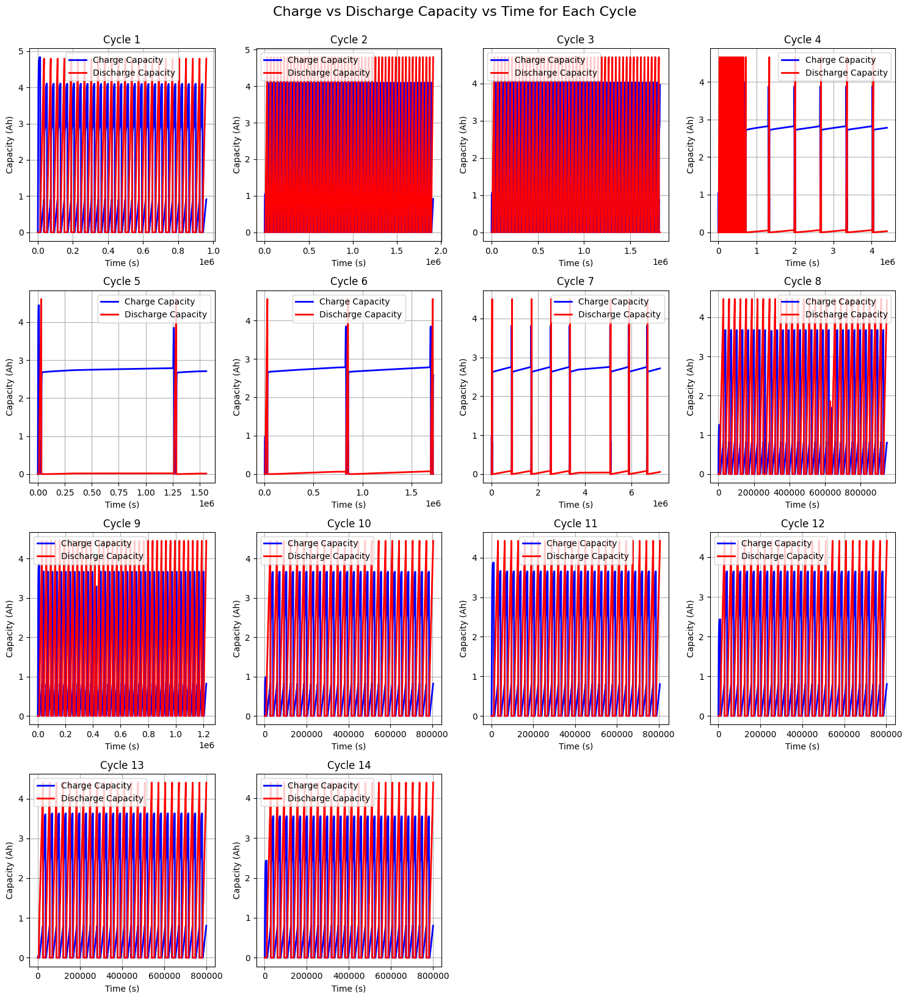

In [44]:
# Get unique cycles
unique_cycles = W10_combined_data['Cycle'].unique()
num_cycles = len(unique_cycles)

# Determine grid layout for subplots
rows = (num_cycles + 3) // 4  # Adjust rows based on number of cycles
cols = min(4, num_cycles)  # Up to 4 graphs per row

# Create subplots
fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 4))
axes = axes.flatten()  # Flatten axes for easy iteration

# Plot each cycle's Charge and Discharge Capacity vs. Time
for i, cycle in enumerate(unique_cycles):
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    ax = axes[i]
    ax.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    ax.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    ax.set_title(f'Cycle {cycle}')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Capacity (Ah)')
    ax.legend()
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjust layout
plt.tight_layout()
plt.suptitle('Charge vs Discharge Capacity vs Time for Each Cycle', fontsize=16, y=1.02)
plt.show()


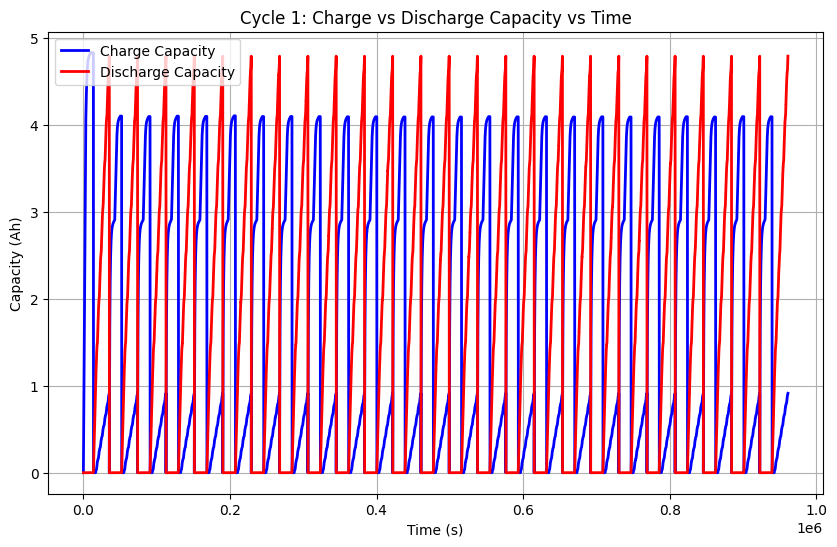

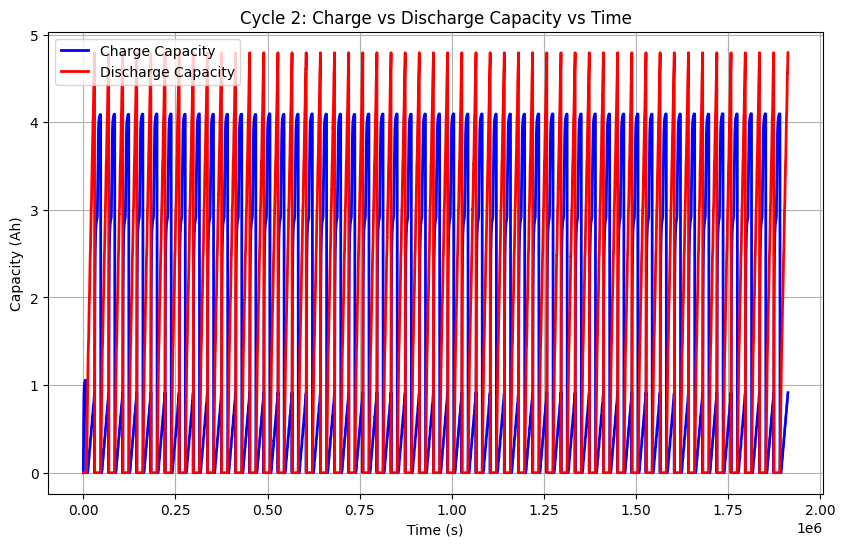

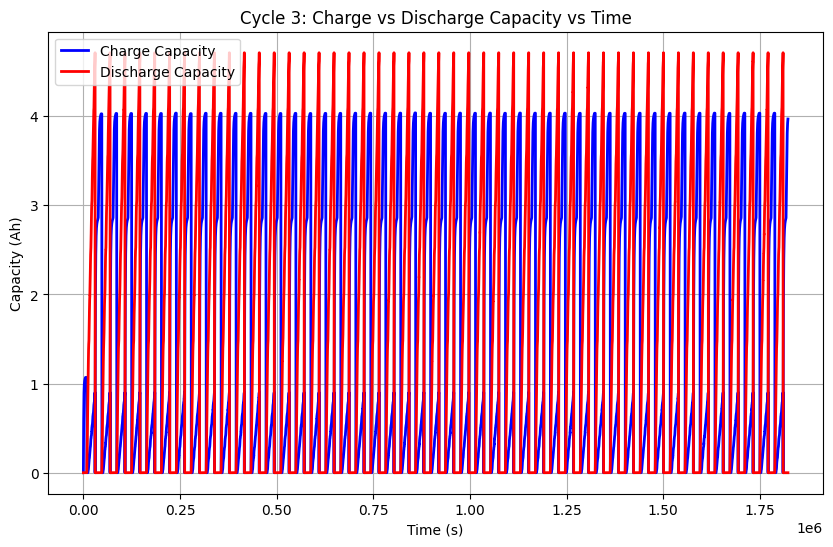

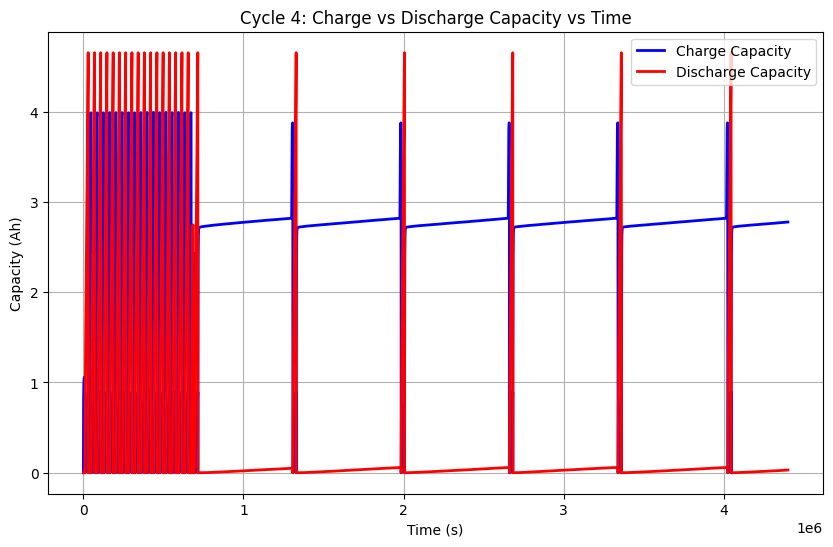

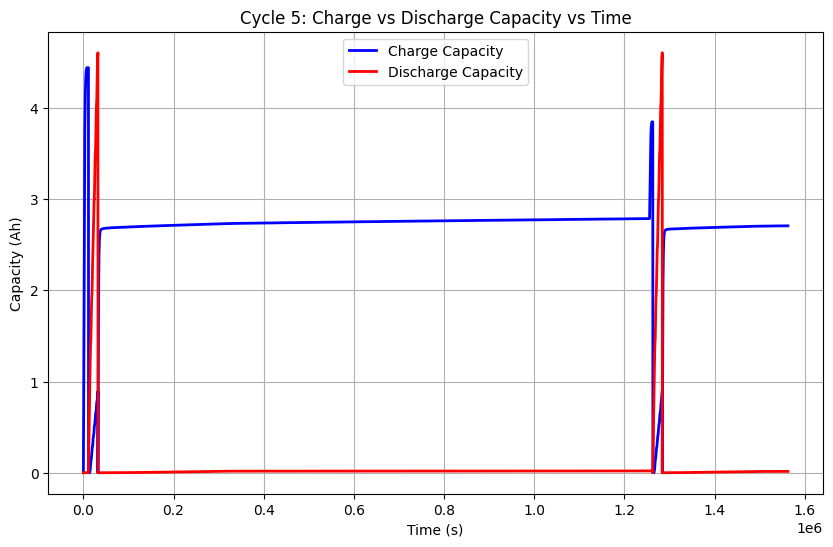

...

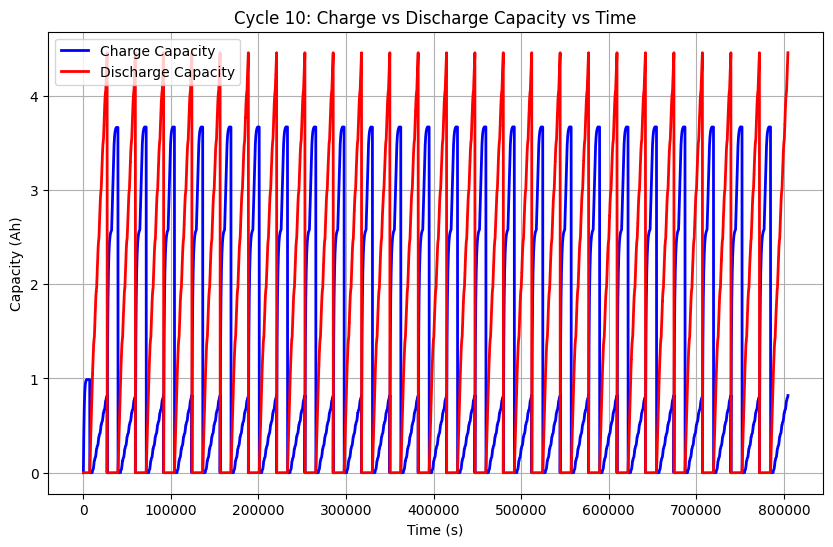

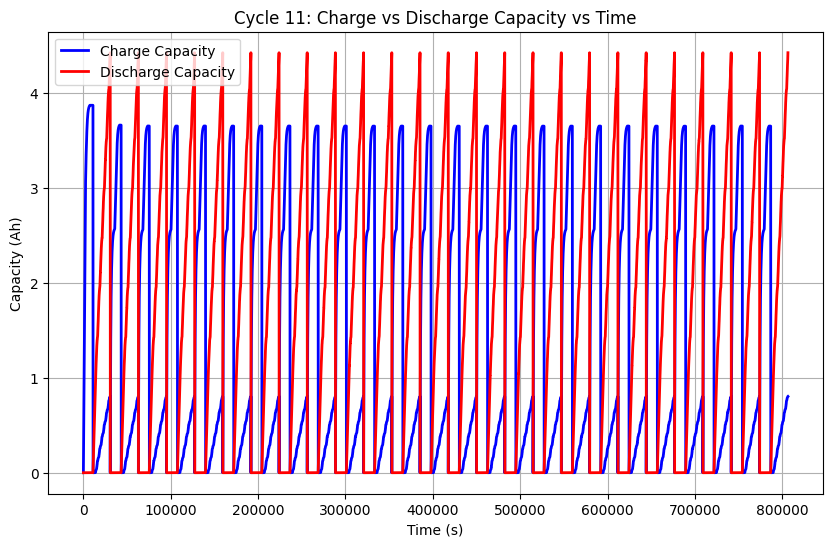

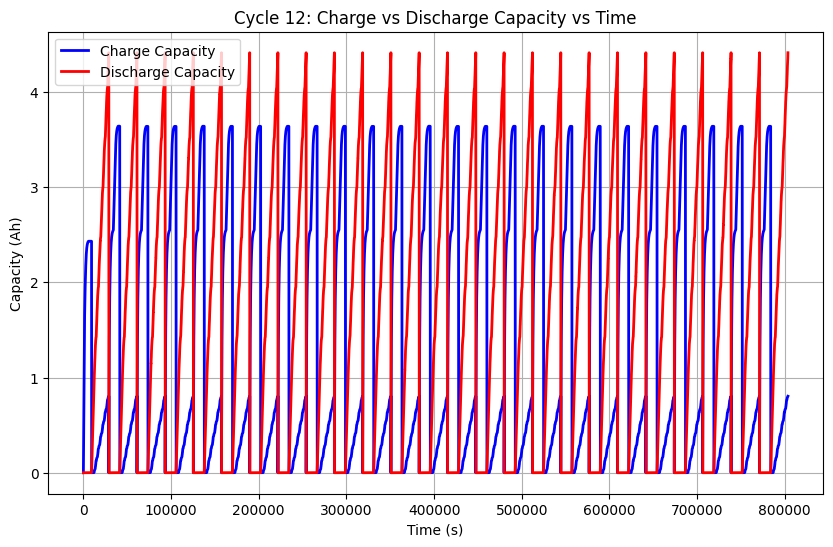

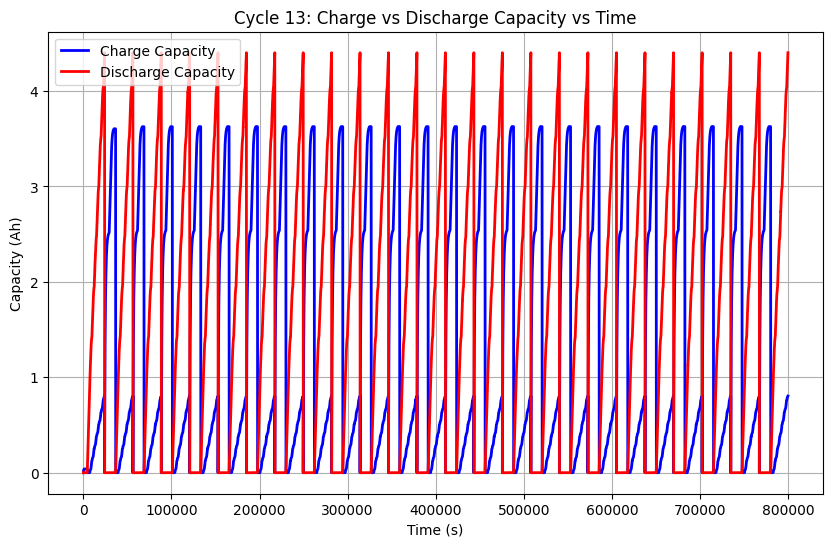

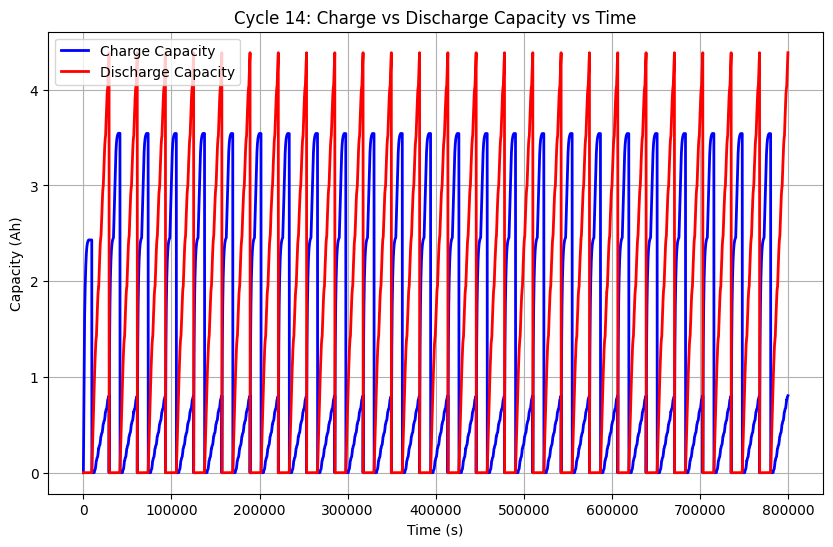

In [45]:
for cycle in unique_cycles:
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(10, 6))  # Create a new figure for each cycle
    plt.plot(cycle_data['Time'], cycle_data['Charge_Capacity'], label='Charge Capacity', color='b', linewidth=2)
    plt.plot(cycle_data['Time'], cycle_data['Discharge_Capacity'], label='Discharge Capacity', color='r', linewidth=2)
    
    plt.title(f'Cycle {cycle}: Charge vs Discharge Capacity vs Time')
    plt.xlabel('Time (s)')
    plt.ylabel('Capacity (Ah)')
    plt.legend()
    plt.grid(True)
    
    plt.show() 

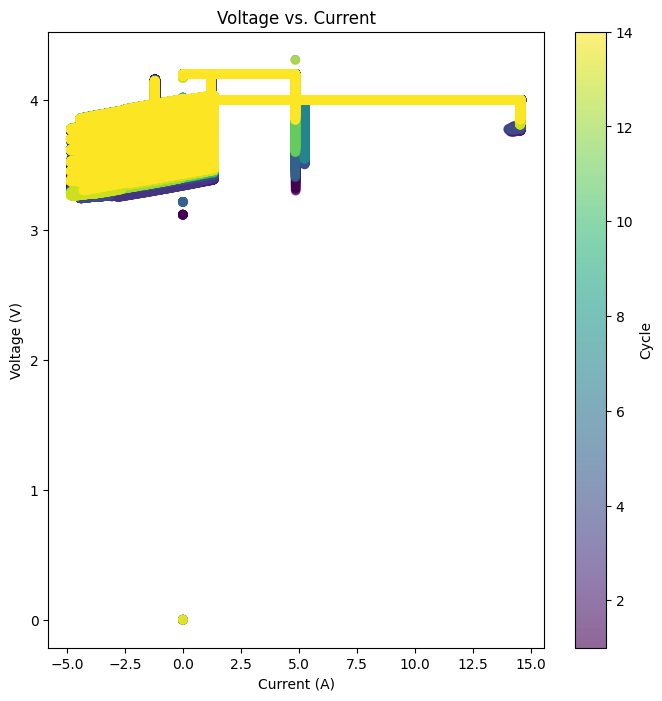

In [46]:
# Voltage vs. Current scatter plot
plt.figure(figsize=(8, 8))
plt.scatter(W10_combined_data['Current'], W10_combined_data['Voltage'], alpha=0.6, c=W10_combined_data['Cycle'], cmap='viridis')
plt.colorbar(label='Cycle')
plt.xlabel('Current (A)')
plt.ylabel('Voltage (V)')
plt.title('Voltage vs. Current')
plt.show()


In [47]:
# Group data by cycle and normalize Charge_Capacity to calculate SoC
W10_combined_data['SoC'] = W10_combined_data.groupby('Cycle')['Charge_Capacity'].transform(
    lambda x: x / x.max()
)


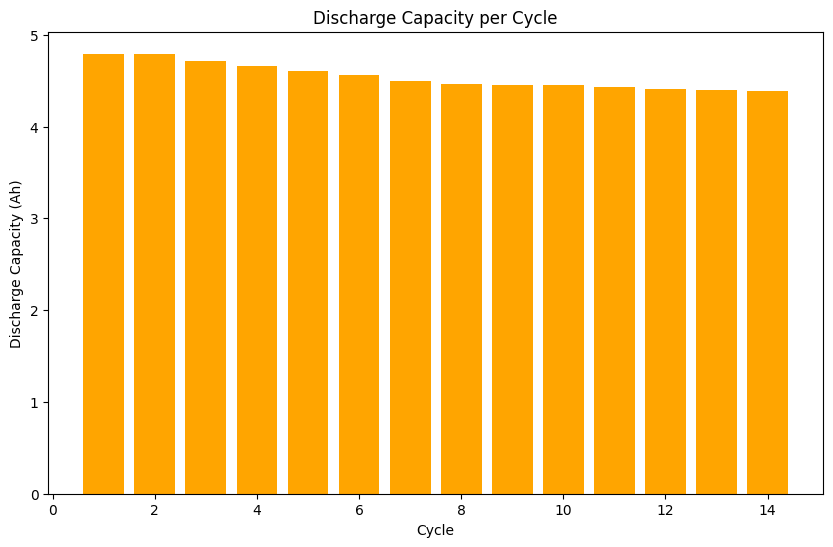

In [48]:
# Calculate total discharge capacity per cycle
discharge_capacity_per_cycle = W10_combined_data.groupby('Cycle')['Discharge_Capacity'].max()

# Plot Discharge Capacity per Cycle
plt.figure(figsize=(10, 6))
plt.bar(discharge_capacity_per_cycle.index, discharge_capacity_per_cycle.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (Ah)')
plt.title('Discharge Capacity per Cycle')
plt.show()


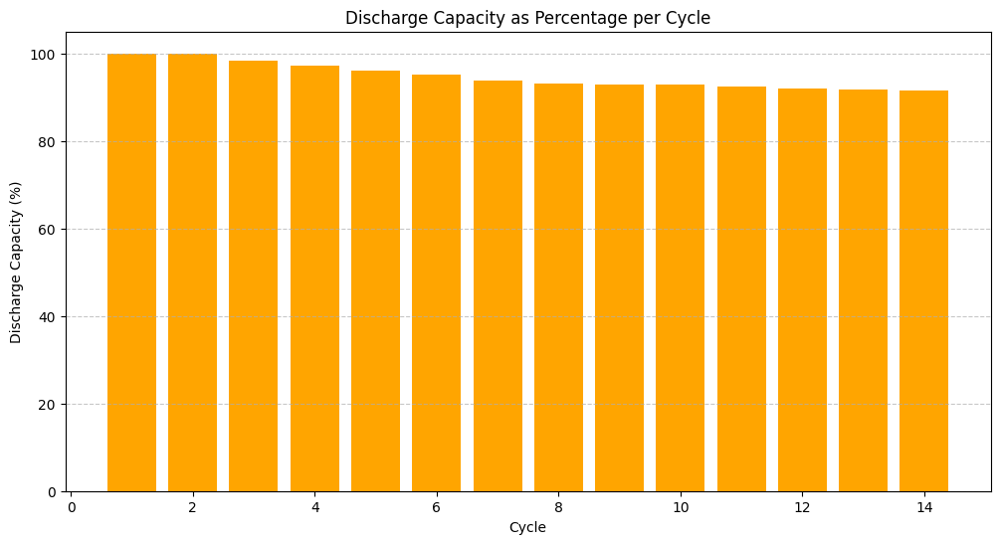

In [49]:
# Calculate the maximum discharge capacity across all cycles
max_discharge_capacity = W10_combined_data['Discharge_Capacity'].max()

# Calculate the maximum discharge capacity per cycle and convert to percentage
discharge_capacity_per_cycle = W10_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

# Plot Discharge Capacity as Percentage per Cycle
plt.figure(figsize=(12, 6))
plt.bar(discharge_capacity_percentage.index, discharge_capacity_percentage.values, color='orange')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle')
plt.grid(axis='y', linestyle='--', alpha=0.7)  # Add grid for better readability
plt.show()


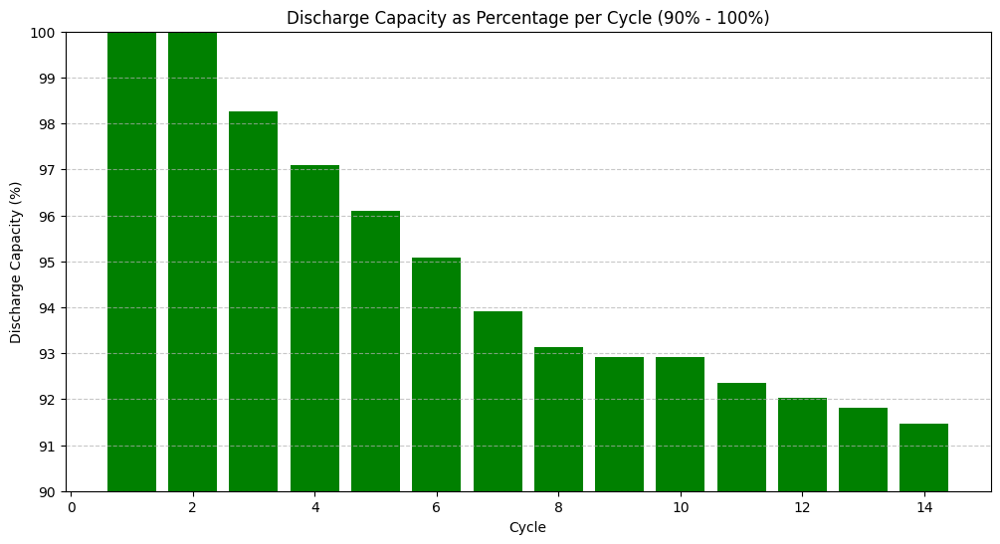

In [50]:
# Filter to keep only values between 90% and 100%
filtered_capacity_percentage = discharge_capacity_percentage[
    (discharge_capacity_percentage >= 90) & (discharge_capacity_percentage <= 100)
]

# Plot Discharge Capacity as Percentage (90% to 100%)
plt.figure(figsize=(12, 6))
plt.bar(filtered_capacity_percentage.index, filtered_capacity_percentage.values, color='green')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Set y-axis limits to zoom in between 90% and 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks at every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()



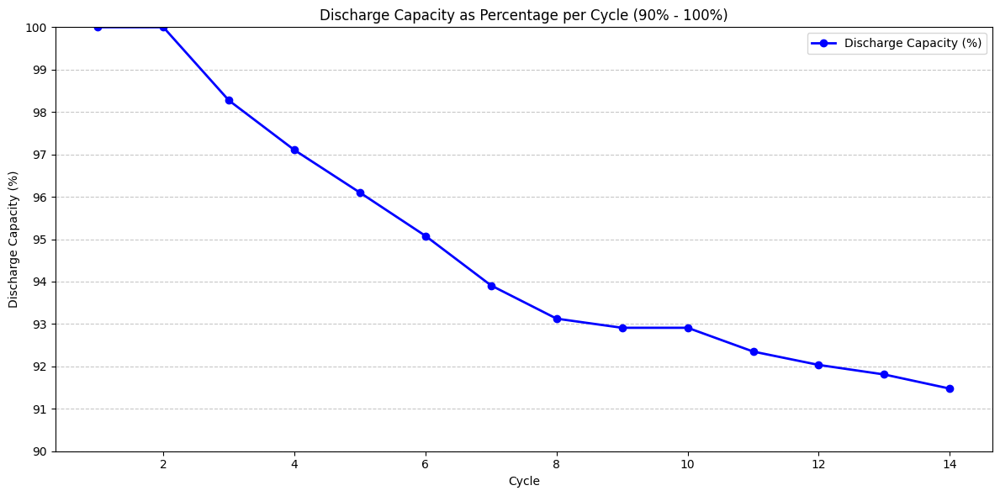

In [51]:
plt.figure(figsize=(12, 6))
plt.plot(filtered_capacity_percentage.index, filtered_capacity_percentage.values, 
         color='blue', marker='o', linestyle='-', linewidth=2, markersize=6, label='Discharge Capacity (%)')

# Add labels, title, grid, and ticks
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Discharge Capacity as Percentage per Cycle (90% - 100%)')
plt.ylim(90, 100)  # Focus on 90% to 100%
plt.yticks(np.arange(90, 101, 1.0))  # Set y-axis ticks every 1.0%
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend()
plt.tight_layout()
plt.show()

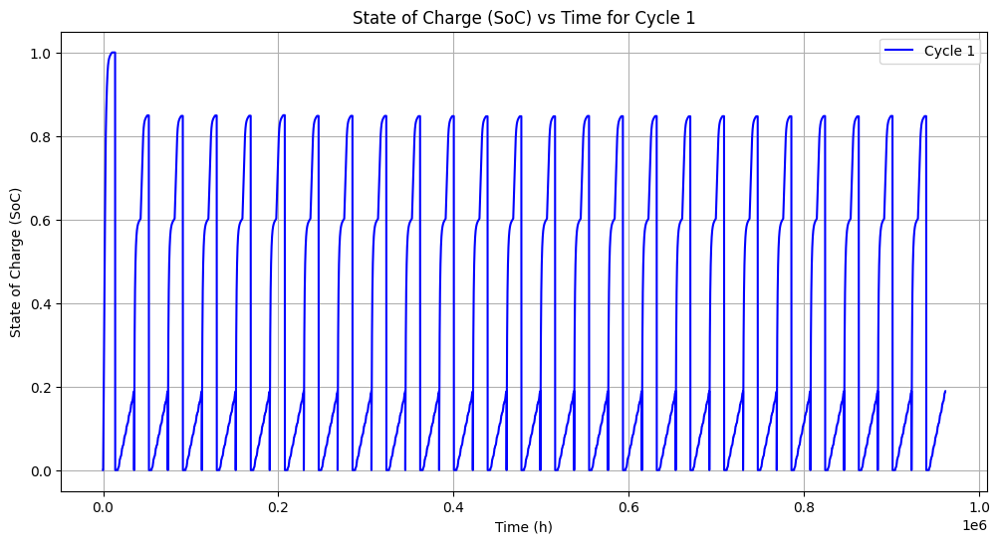

C:\Users\ymuba\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


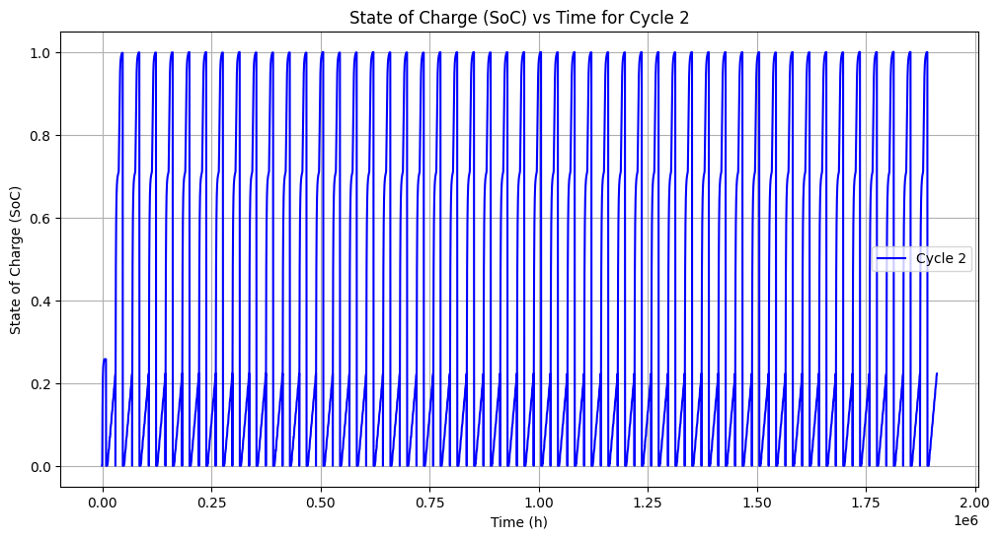

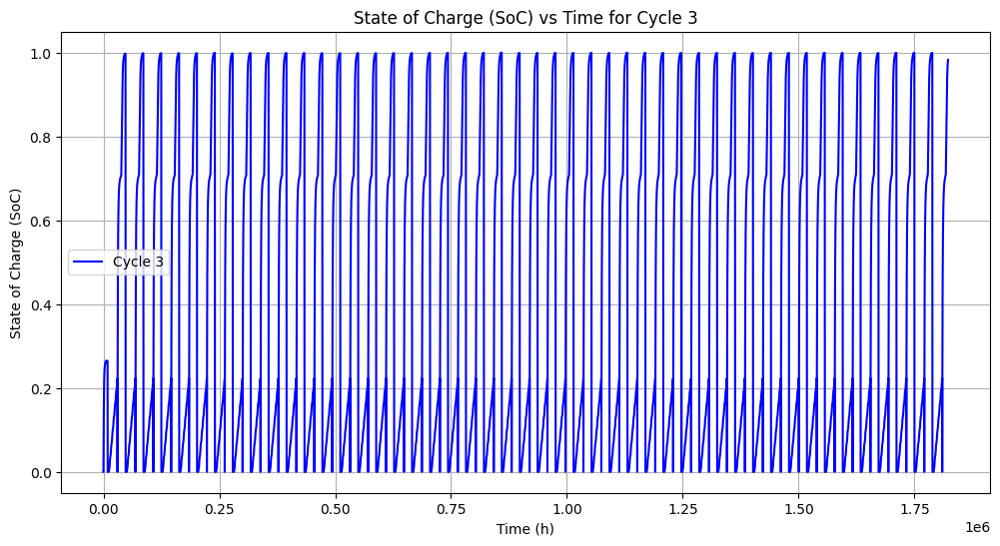

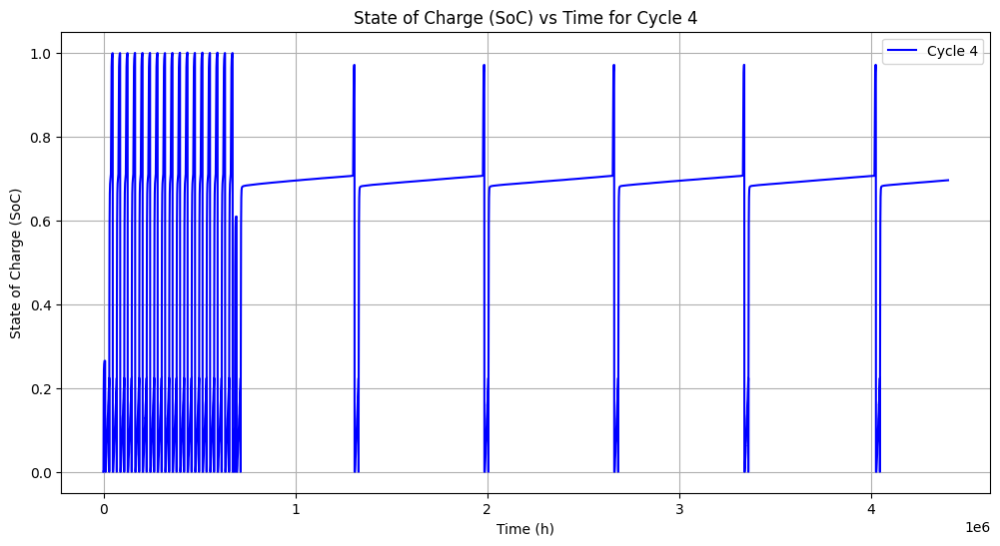

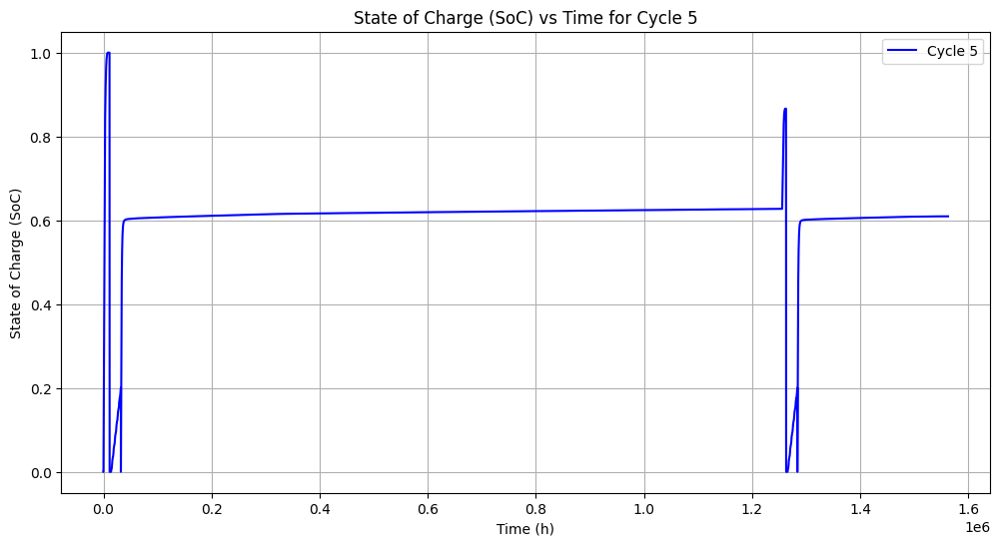

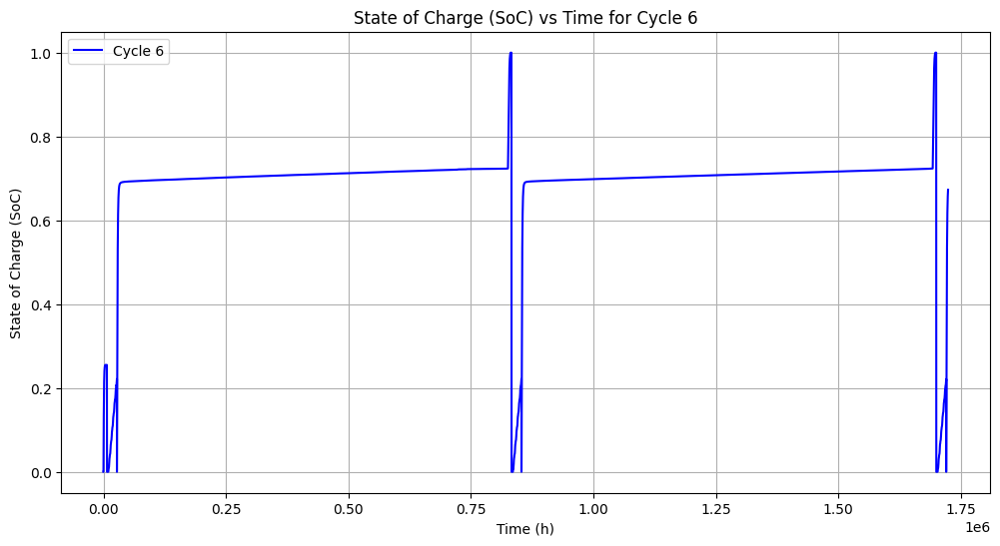

...

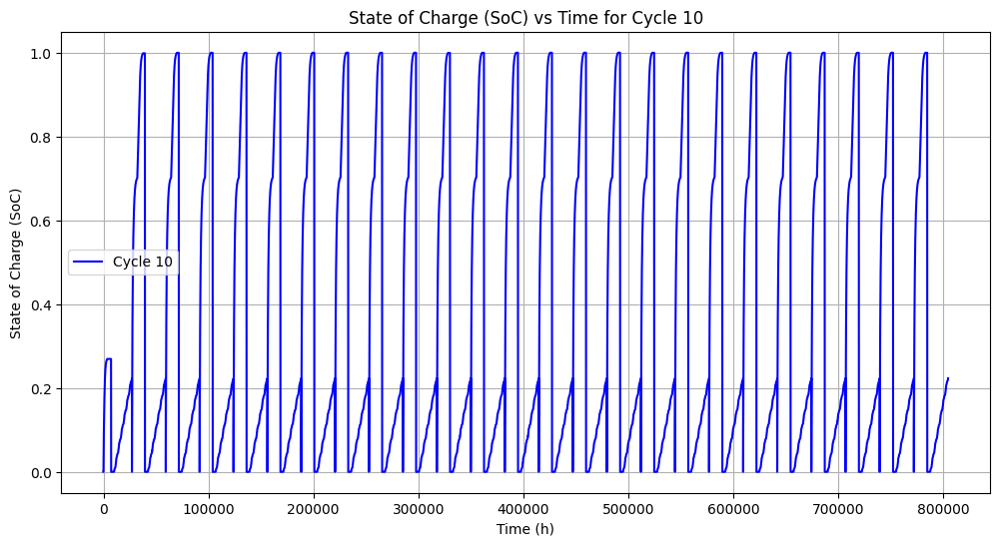

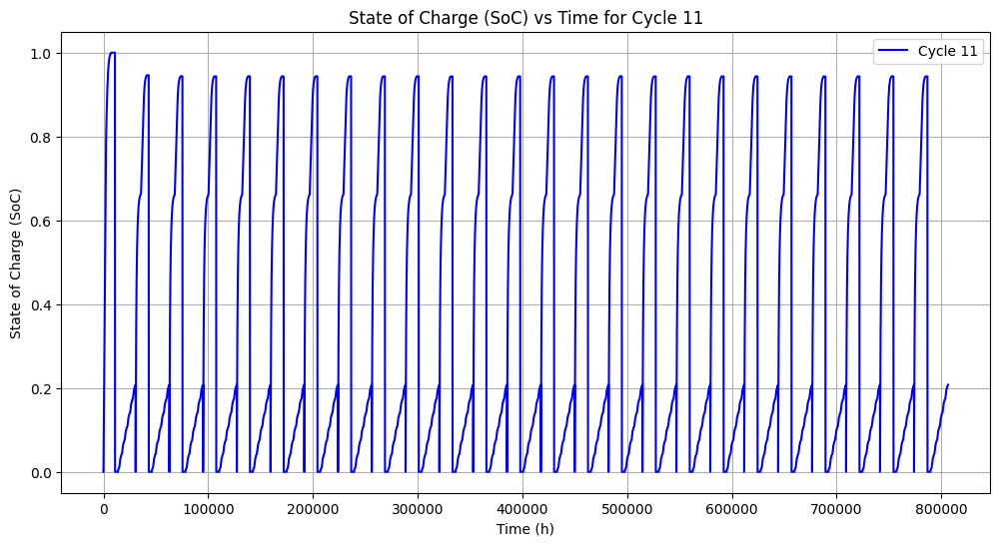

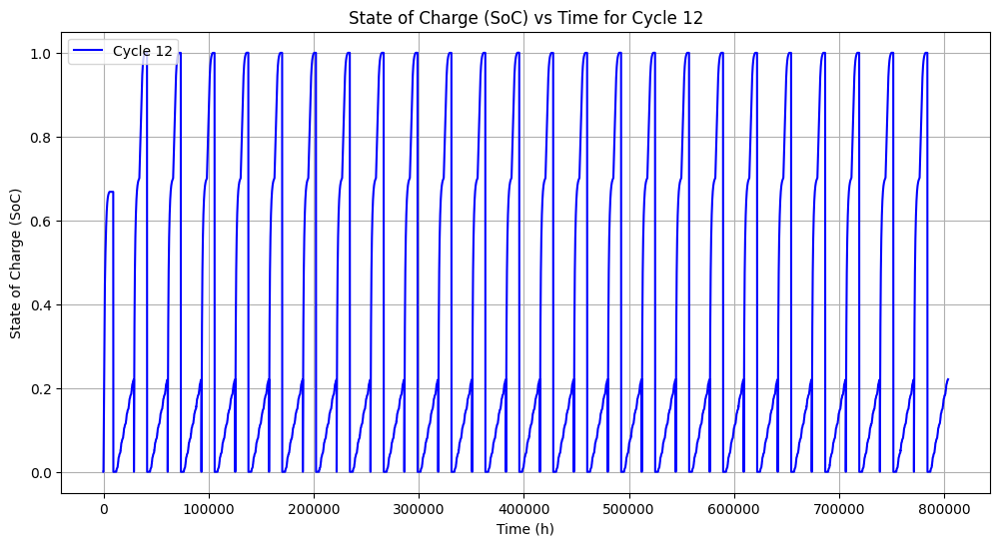

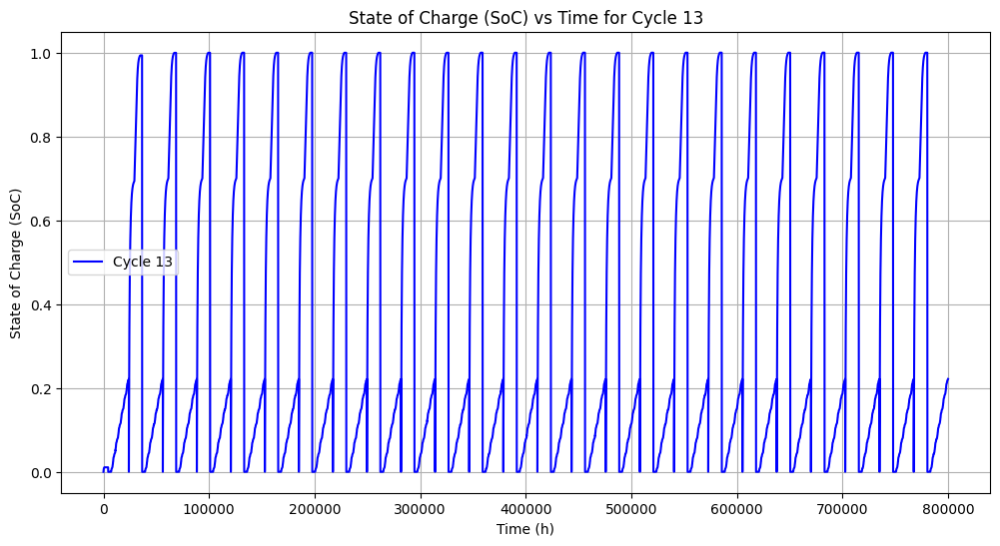

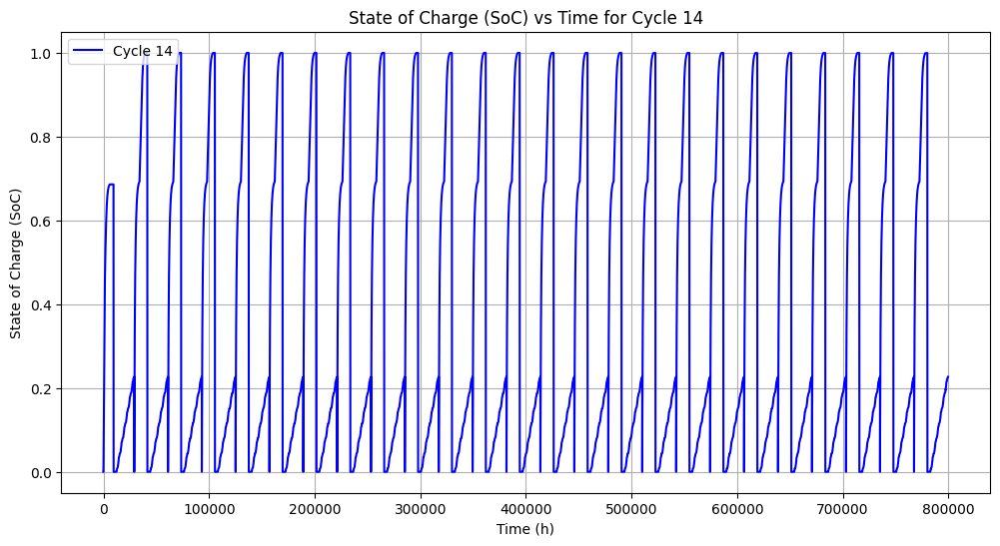

In [52]:
# Loop through each unique cycle and plot SoC vs. Time
for cycle in W10_combined_data['Cycle'].unique():
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    
    plt.figure(figsize=(12, 6))  # Adjust the figure size for better visibility
    plt.plot(cycle_data['Time'], cycle_data['SoC'], label=f'Cycle {cycle}', color='blue')
    plt.xlabel('Time (h)')
    plt.ylabel('State of Charge (SoC)')
    plt.title(f'State of Charge (SoC) vs Time for Cycle {cycle}')
    plt.legend()
    plt.grid()
    plt.show()



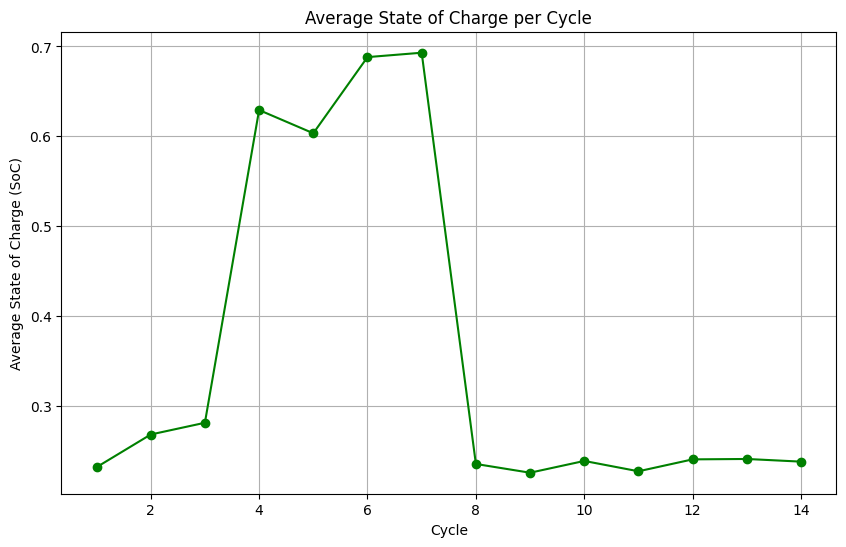

In [53]:
# Calculate average SoC per cycle
average_soc_per_cycle = W10_combined_data.groupby('Cycle')['SoC'].mean()

# Plot Average SoC per Cycle
plt.figure(figsize=(10, 6))
plt.plot(average_soc_per_cycle.index, average_soc_per_cycle.values, marker='o', color='green', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Average State of Charge (SoC)')
plt.title('Average State of Charge per Cycle')
plt.grid()
plt.show()


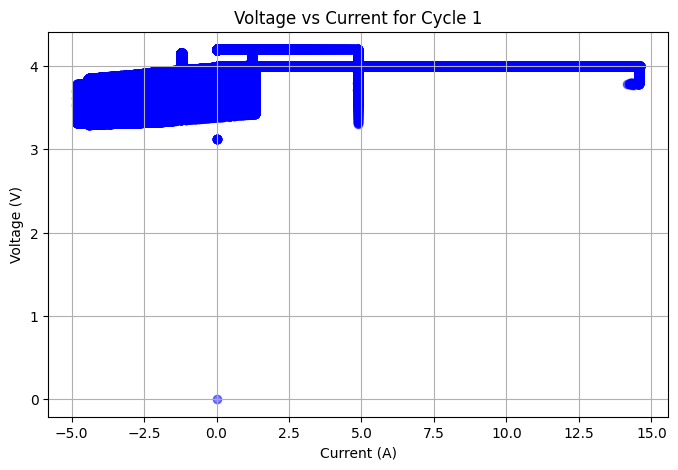

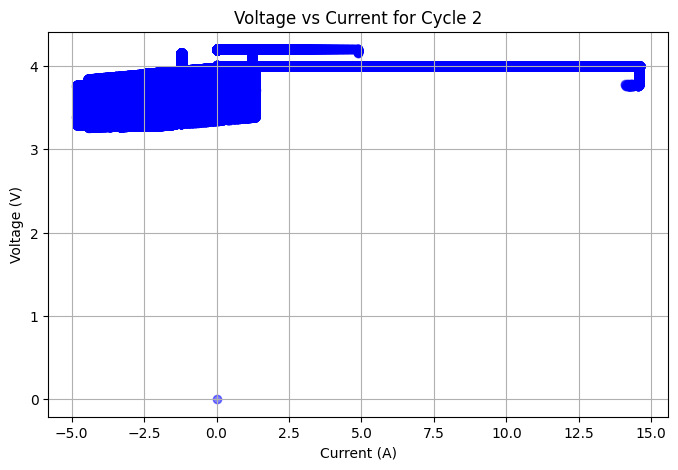

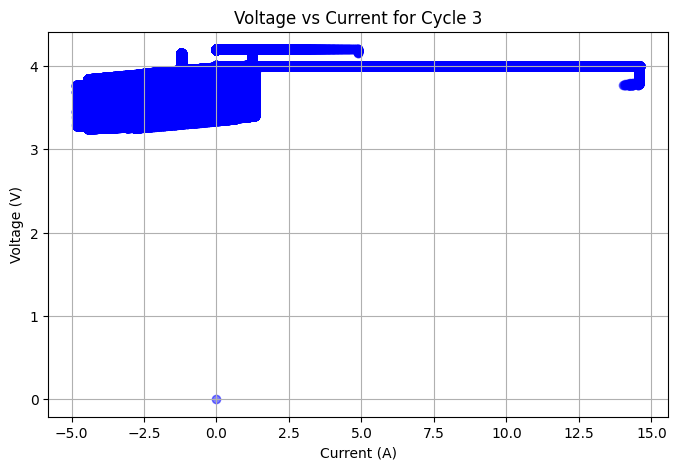

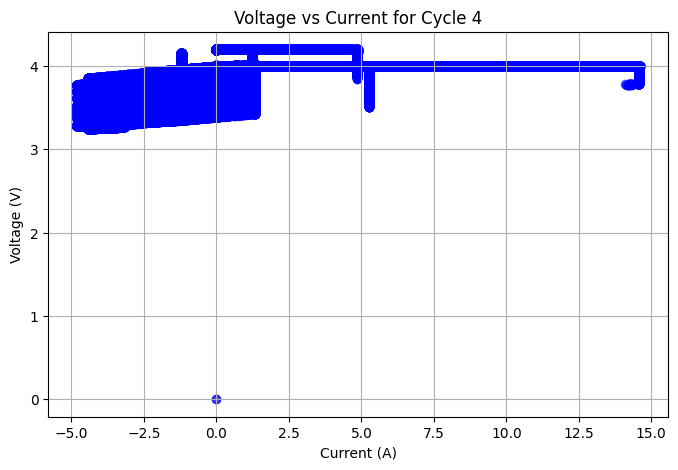

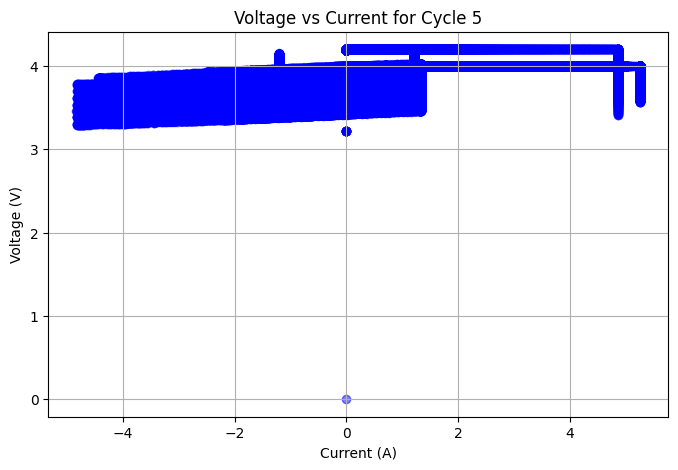

...

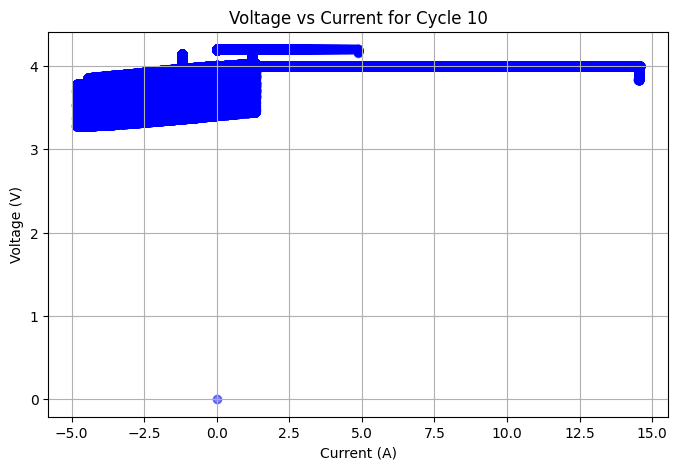

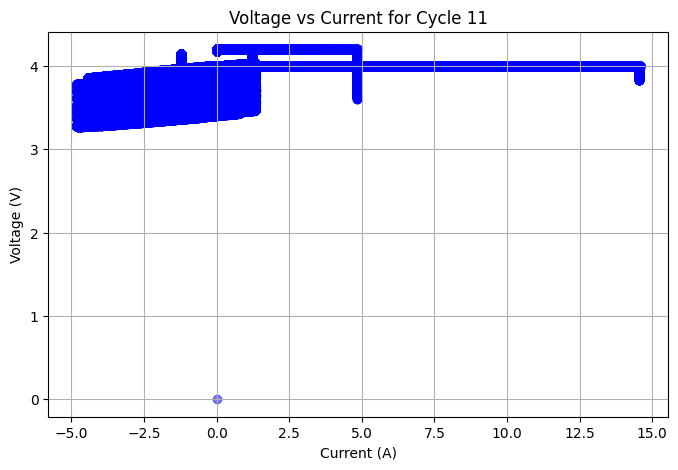

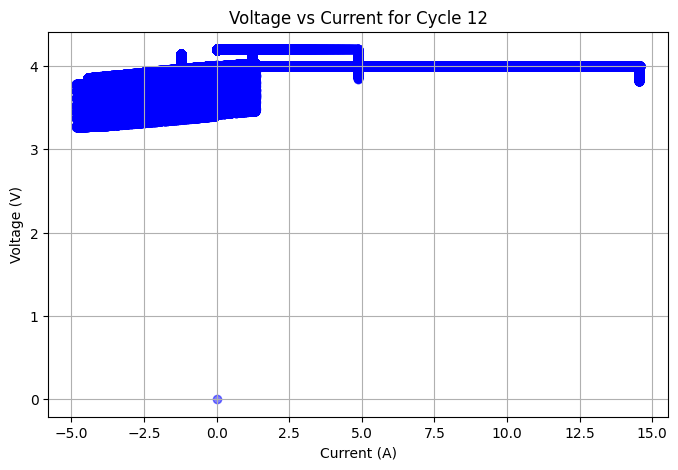

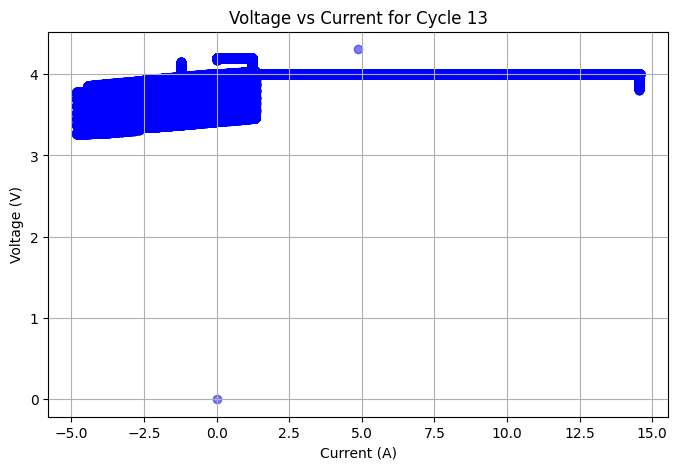

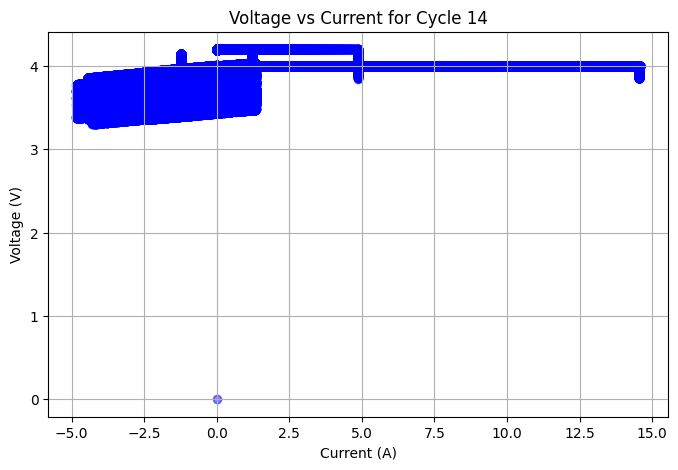

In [54]:
# Visualize the relationship between voltage and current for each cycle separately
for cycle in W10_combined_data['Cycle'].unique():
    cycle_data = W10_combined_data[W10_combined_data['Cycle'] == cycle]
    
    # Create a new figure for each cycle
    plt.figure(figsize=(8, 5))
    plt.scatter(cycle_data['Current'], cycle_data['Voltage'], color='blue', alpha=0.5)
    
    plt.xlabel('Current (A)')
    plt.ylabel('Voltage (V)')
    plt.title(f'Voltage vs Current for Cycle {cycle}')
    plt.grid()
    plt.show()


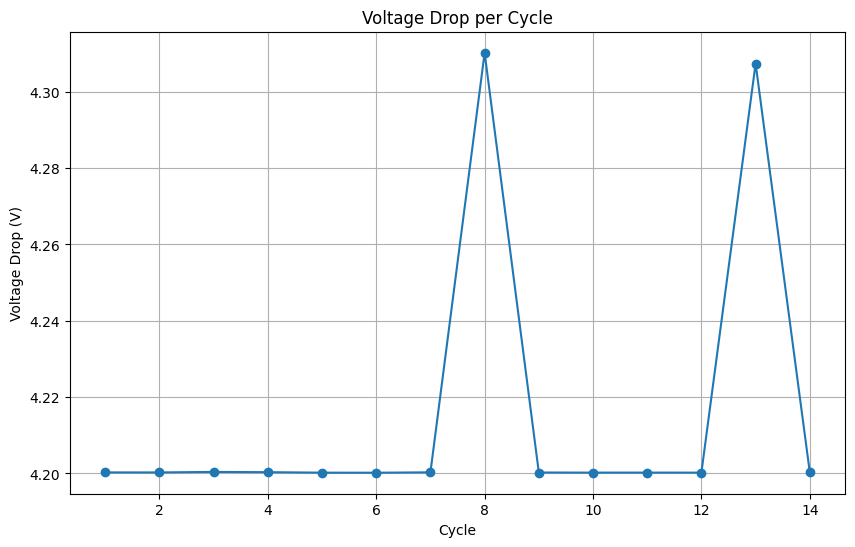

In [55]:
#Analyze how much the voltage drops within each cycle, which helps track battery degradation.
voltage_drop_per_cycle = W10_combined_data.groupby('Cycle').agg(
    max_voltage=('Voltage', 'max'),
    min_voltage=('Voltage', 'min')
)
voltage_drop_per_cycle['voltage_drop'] = voltage_drop_per_cycle['max_voltage'] - voltage_drop_per_cycle['min_voltage']

# Plot
plt.figure(figsize=(10, 6))
plt.plot(voltage_drop_per_cycle.index, voltage_drop_per_cycle['voltage_drop'], marker='o', linestyle='-')
plt.xlabel('Cycle')
plt.ylabel('Voltage Drop (V)')
plt.title('Voltage Drop per Cycle')
plt.grid()
plt.show()


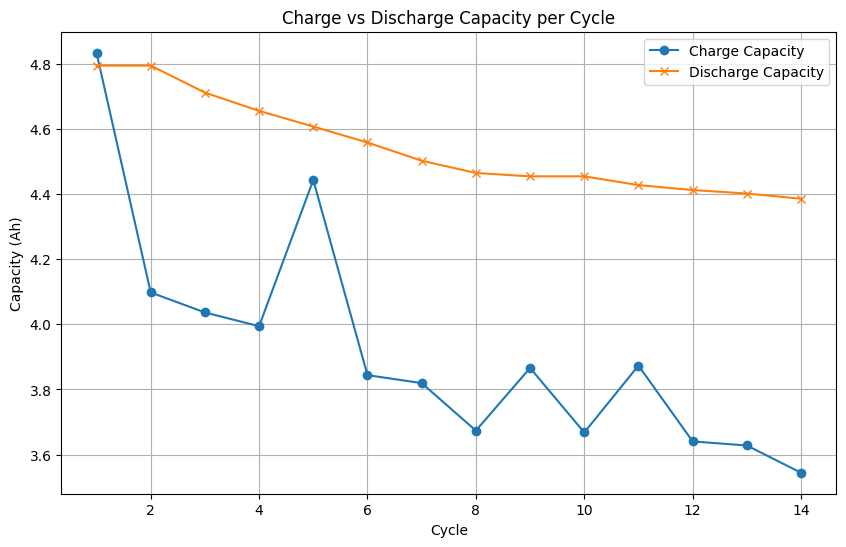

In [56]:
#Compare the charge and discharge capacity for each cycle. If there’s a growing difference, it indicates capacity loss.
capacity_per_cycle = W10_combined_data.groupby('Cycle').agg({
    'Charge_Capacity': 'max',
    'Discharge_Capacity': 'max'
})

plt.figure(figsize=(10, 6))
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Charge_Capacity'], label='Charge Capacity', marker='o')
plt.plot(capacity_per_cycle.index, capacity_per_cycle['Discharge_Capacity'], label='Discharge Capacity', marker='x')
plt.xlabel('Cycle')
plt.ylabel('Capacity (Ah)')
plt.title('Charge vs Discharge Capacity per Cycle')
plt.legend()
plt.grid()
plt.show()


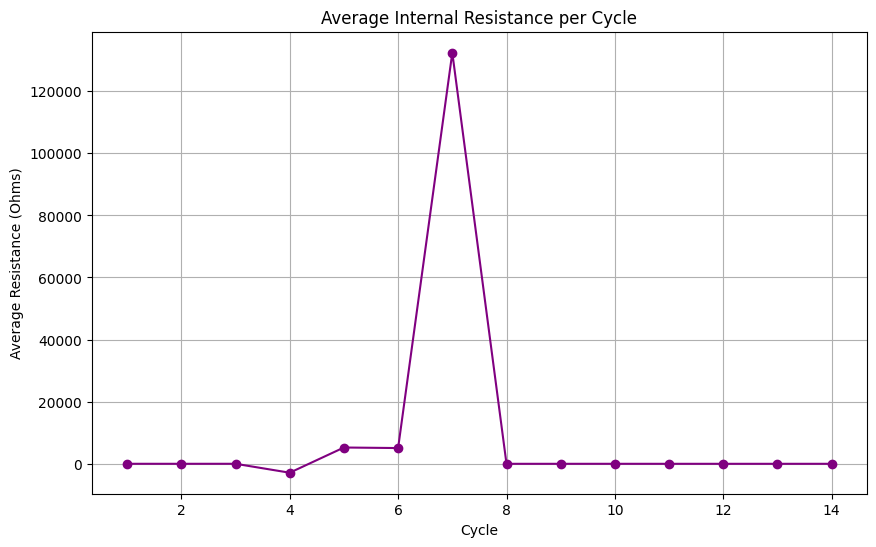

In [57]:
#Internal Resistance Over Time
W10_combined_data['Resistance'] = W10_combined_data['Voltage'] / W10_combined_data['Current']
W10_combined_data = W10_combined_data.replace([np.inf, -np.inf], np.nan).dropna(subset=['Resistance'])

# Average resistance per cycle
avg_resistance = W10_combined_data.groupby('Cycle')['Resistance'].mean()

# Plot
plt.figure(figsize=(10, 6))
plt.plot(avg_resistance.index, avg_resistance.values, marker='o', linestyle='-', color='purple')
plt.xlabel('Cycle')
plt.ylabel('Average Resistance (Ohms)')
plt.title('Average Internal Resistance per Cycle')
plt.grid()
plt.show()


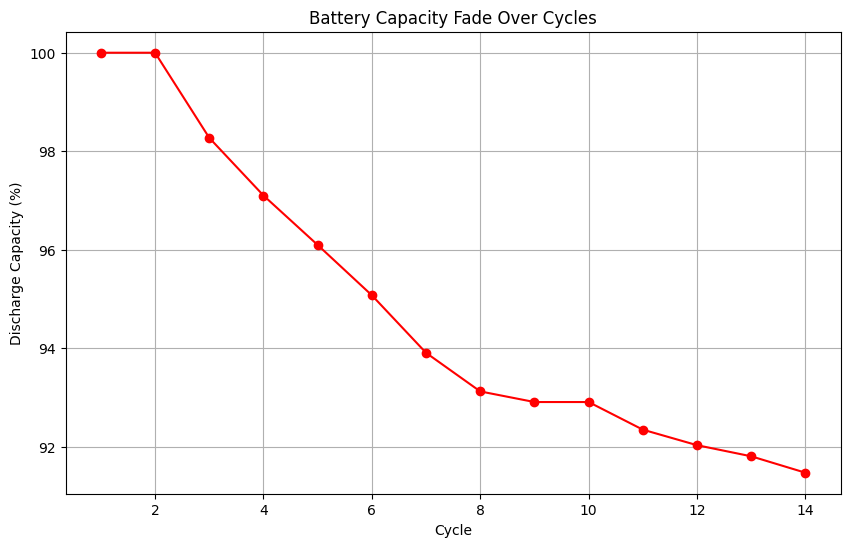

In [58]:
max_discharge_capacity = W10_combined_data['Discharge_Capacity'].max()

discharge_capacity_per_cycle = W10_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

#Visualize how discharge capacity decreases over time (cycle aging).
plt.figure(figsize=(10, 6))
plt.plot(discharge_capacity_percentage.index, discharge_capacity_percentage.values, 
         marker='o', linestyle='-', color='red')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Battery Capacity Fade Over Cycles')
plt.grid()
plt.show()


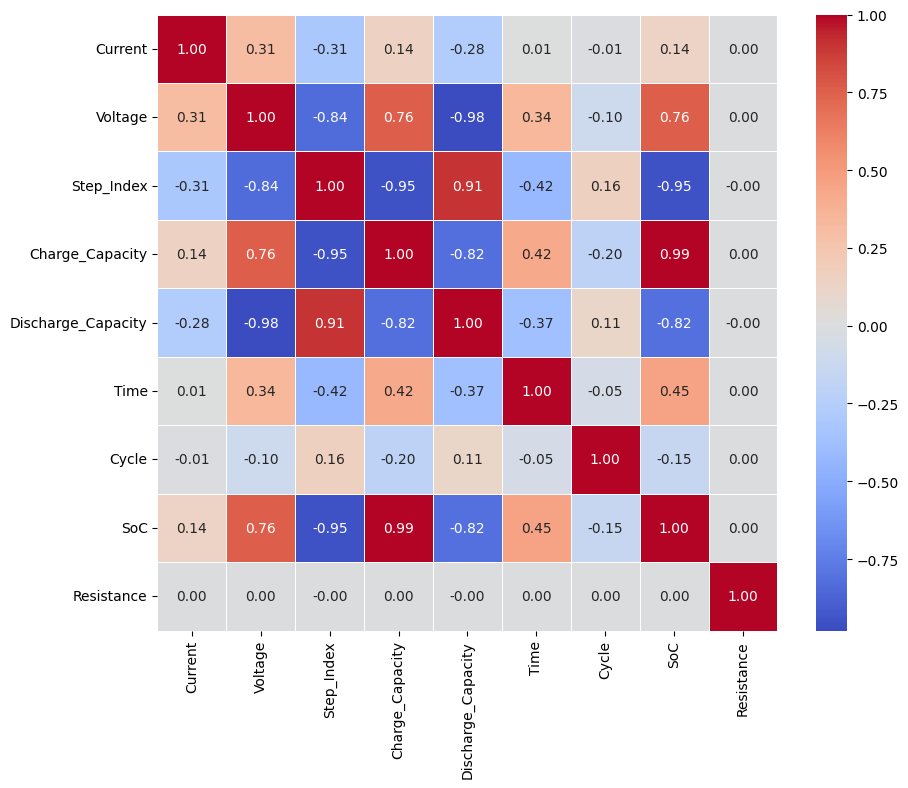

In [59]:
#Correlation analysis Check for correlations between numerical variables using a correlation matrix.
corr_matrix = W10_combined_data.corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.show()

In [60]:
#Normality tests Test whether certain columns (like Voltage, Current) follow a normal distribution using statistical tests such as Shapiro-Wilk.
from scipy.stats import shapiro

# Example: Shapiro-Wilk test for normality
stat, p_value = shapiro(W10_combined_data['Voltage'])
print(f"Shapiro-Wilk Test: Stat={stat}, P-value={p_value}")


Shapiro-Wilk Test: Stat=0.3245885372161865, P-value=0.0


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\scipy\stats\_morestats.py:1882: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


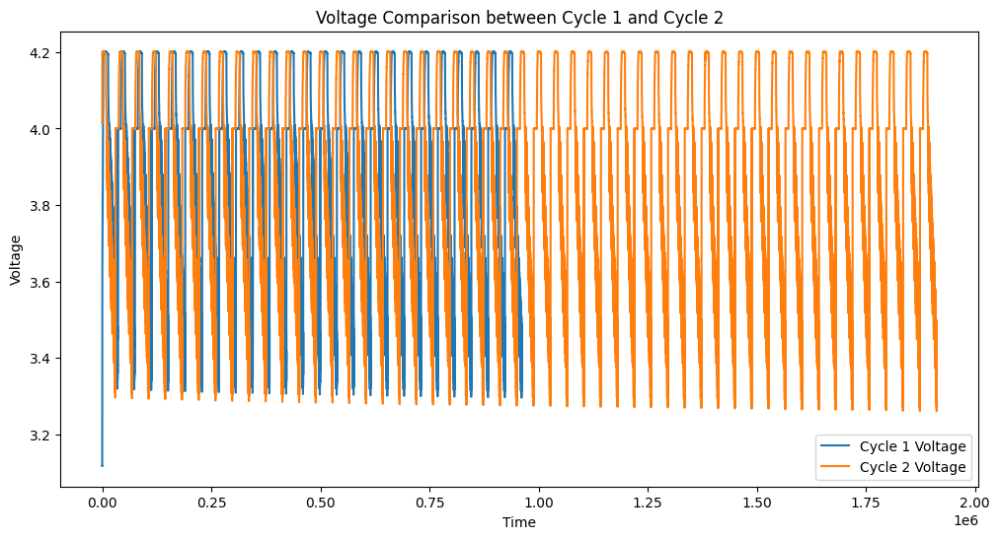

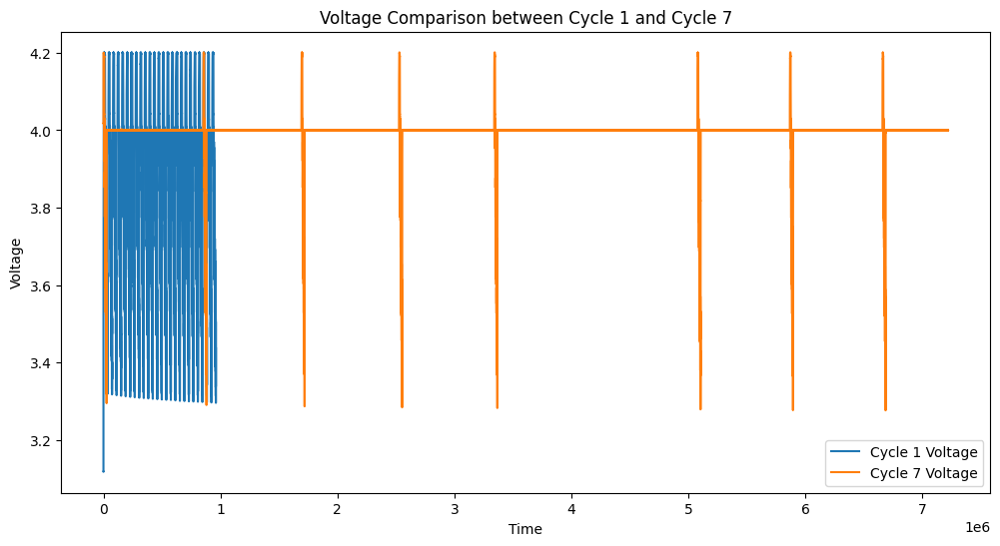

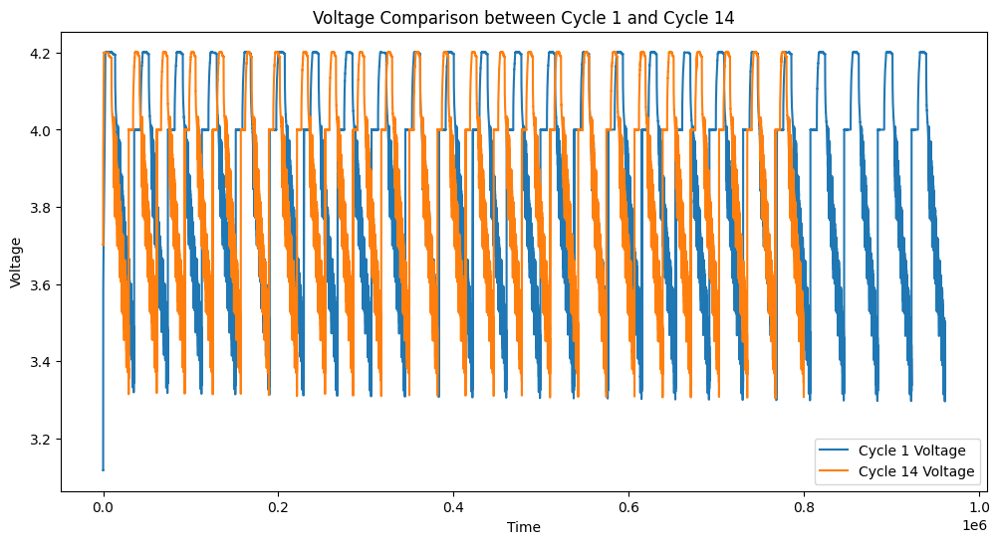

C:\Users\ymuba\AppData\Roaming\Python\Python311\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


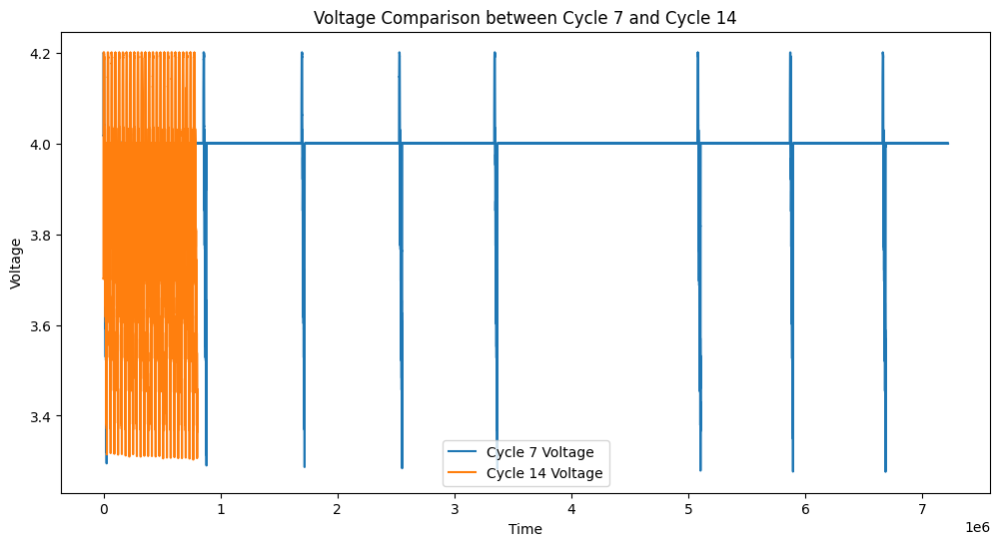

In [61]:
#Cycle-wise analysis Visualize data for different cycles separately to see if there are patterns or anomalies.
cycle_1 = W10_combined_data_cleaned[W10_combined_data_cleaned['Cycle'] == 1]
cycle_2 = W10_combined_data_cleaned[W10_combined_data_cleaned['Cycle'] == 2]
cycle_7 = W10_combined_data_cleaned[W10_combined_data_cleaned['Cycle'] == 7]
cycle_14 = W10_combined_data_cleaned[W10_combined_data_cleaned['Cycle'] == 14]


# Plot Voltage for Cycle 1 and Cycle 2
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_2['Time'], cycle_2['Voltage'], label='Cycle 2 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 2')
plt.legend()
plt.show()

# Plot Voltage for Cycle 1 and Cycle 7
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_7['Time'], cycle_7['Voltage'], label='Cycle 7 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 7')
plt.legend()
plt.show()

# Plot Voltage for Cycle 1 and Cycle 14
plt.figure(figsize=(12, 6))
plt.plot(cycle_1['Time'], cycle_1['Voltage'], label='Cycle 1 Voltage')
plt.plot(cycle_14['Time'], cycle_14['Voltage'], label='Cycle 14 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 1 and Cycle 14')
plt.legend()
plt.show()

# Plot Voltage for Cycle 7 and Cycle 14
plt.figure(figsize=(12, 6))
plt.plot(cycle_7['Time'], cycle_7['Voltage'], label='Cycle 7 Voltage')
plt.plot(cycle_14['Time'], cycle_14['Voltage'], label='Cycle 14 Voltage')
plt.xlabel('Time')
plt.ylabel('Voltage')
plt.title('Voltage Comparison between Cycle 7 and Cycle 14')
plt.legend()
plt.show()

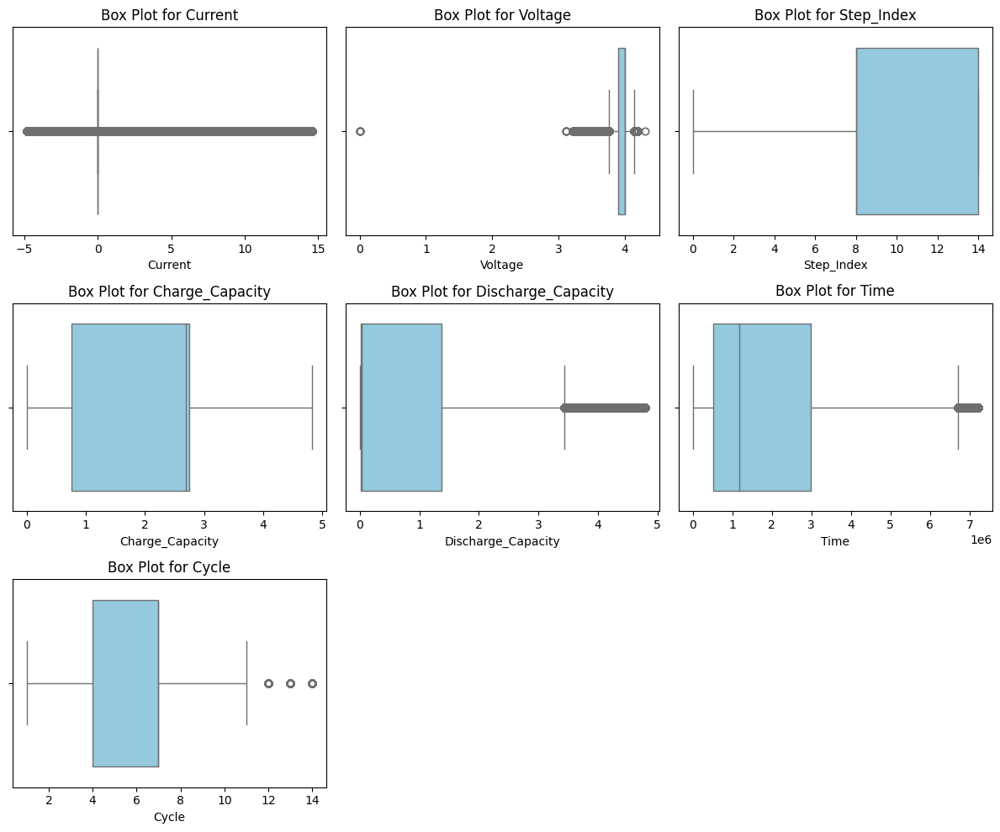

In [17]:
numerical_columns = ['Current', 'Voltage', 'Step_Index', 'Charge_Capacity', 
                     'Discharge_Capacity', 'Time', 'Cycle']

# Create a figure and a grid of subplots for boxplots
plt.figure(figsize=(12, 10))
for idx, column in enumerate(numerical_columns, 1):
    plt.subplot(3, 3, idx)  # 3x3 grid layout
    sns.boxplot(x=W10_combined_data[column], color='skyblue')
    plt.title(f'Box Plot for {column}')
    plt.xlabel(column)

# Adjust layout to avoid overlap
plt.tight_layout()
plt.show()

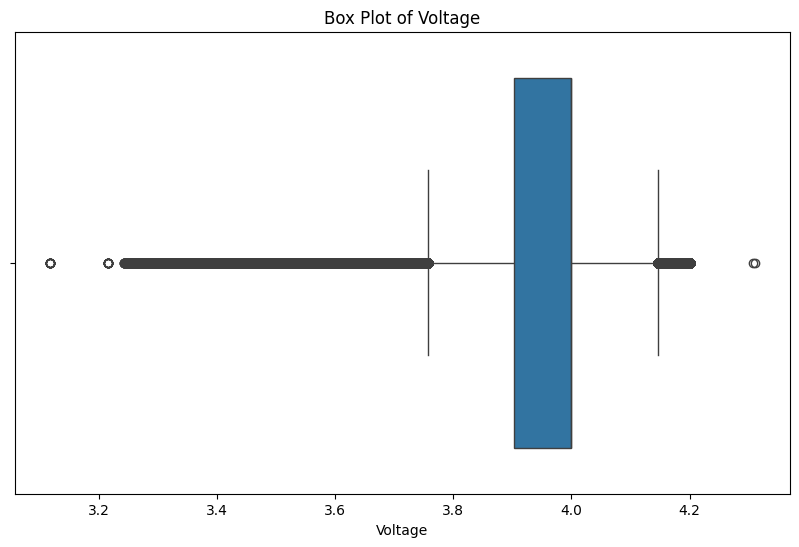

In [20]:
# Create a box plot of the 'Voltage' column after remove the 0 values
plt.figure(figsize=(10, 6))
sns.boxplot(x='Voltage', data=W10_combined_data_cleaned)
plt.title('Box Plot of Voltage')
plt.xlabel('Voltage')
plt.show()

In [21]:
W10_combined_data_cleaned.info()

<class 'pandas.core.frame.DataFrame'>
Index: 223007871 entries, 1 to 223007888
Data columns (total 7 columns):
 #   Column              Dtype  
---  ------              -----  
 0   Current             float64
 1   Voltage             float64
 2   Step_Index          int64  
 3   Charge_Capacity     float64
 4   Discharge_Capacity  float64
 5   Time                float64
 6   Cycle               int64  
dtypes: float64(5), int64(2)
memory usage: 13.3 GB


In [22]:
from scipy import stats

# Two-sample t-test between Charge Capacity and Discharge Capacity
t_stat, p_value = stats.ttest_ind(W10_combined_data['Charge_Capacity'], W10_combined_data['Discharge_Capacity'])
print(f"T-statistic: {t_stat}, P-value: {p_value}")


T-statistic: 10851.553343427524, P-value: 0.0


In [23]:
# ANOVA test for comparing discharge capacity over cycles
from scipy import stats

f_stat, p_value = stats.f_oneway(*[W10_combined_data[W10_combined_data['Cycle'] == cycle]['Discharge_Capacity'] for cycle in W10_combined_data['Cycle'].unique()])
print(f"ANOVA test: F-statistic = {f_stat}, P-value = {p_value}")


ANOVA test: F-statistic = 12589879.262968209, P-value = 0.0


In [24]:
# Pearson correlation test
pearson_corr, _ = stats.pearsonr(W10_combined_data['Discharge_Capacity'], W10_combined_data['Charge_Capacity'])
print(f"Pearson correlation: {pearson_corr}")


Pearson correlation: -0.8172664515036882


Maximum Discharge Capacity: 4.79383277893066


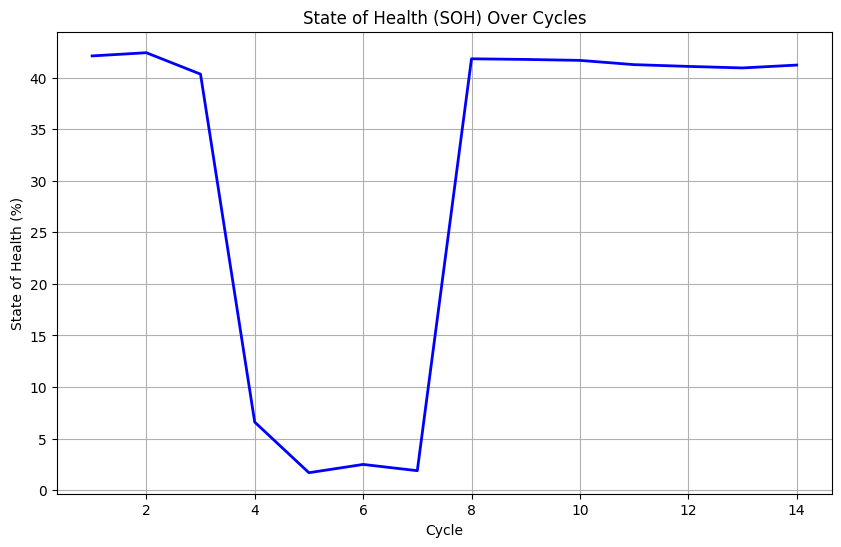

In [25]:

# Step 1: Calculate the maximum discharge capacity
max_discharge_capacity = W10_combined_data['Discharge_Capacity'].max()
print(f"Maximum Discharge Capacity: {max_discharge_capacity}")

# Step 2: Add the SOH column
W10_combined_data['SOH'] = (W10_combined_data['Discharge_Capacity'] / max_discharge_capacity) * 100

# Step 3: Group by cycle and calculate the mean SOH per cycle
soh_per_cycle = W10_combined_data.groupby('Cycle')['SOH'].mean().reset_index()

# Step 4: Plot the SOH per cycle
plt.figure(figsize=(10, 6))
plt.plot(soh_per_cycle['Cycle'], soh_per_cycle['SOH'], color='blue', linewidth=2)
plt.title("State of Health (SOH) Over Cycles")
plt.xlabel("Cycle")
plt.ylabel("State of Health (%)")
plt.grid()
plt.show()


## Comparing cells W8 vs W9 vs W10

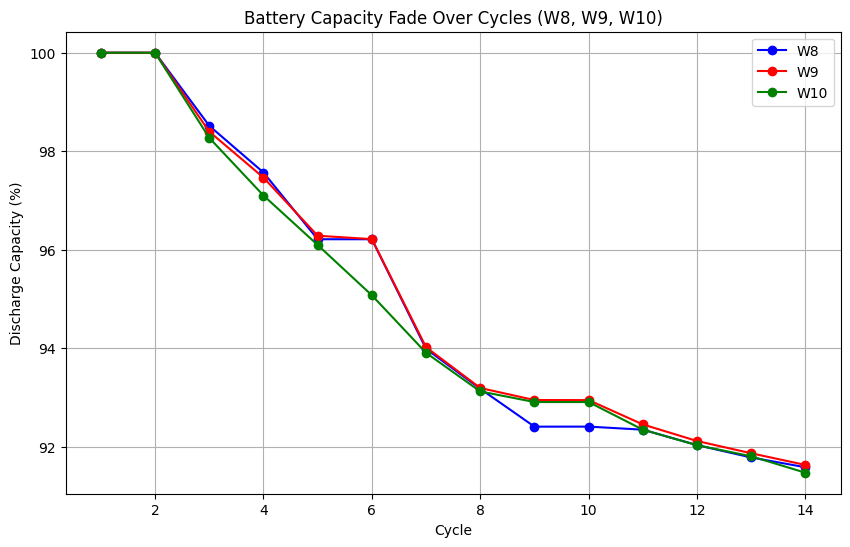

In [28]:
max_discharge_w8 = W8_combined_data['Discharge_Capacity'].max()
max_discharge_w9 = W9_combined_data['Discharge_Capacity'].max()
max_discharge_w10 = W10_combined_data['Discharge_Capacity'].max()

# Step 2: Group by Cycle and calculate percentage discharge capacity for each dataset
discharge_w8 = W8_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_w8_percentage = (discharge_w8 / max_discharge_w8) * 100

discharge_w9 = W9_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_w9_percentage = (discharge_w9 / max_discharge_w9) * 100

discharge_w10 = W10_combined_data.groupby('Cycle')['Discharge_Capacity'].max()
discharge_w10_percentage = (discharge_w10 / max_discharge_w10) * 100

# Step 3: Plot all datasets on one graph
plt.figure(figsize=(10, 6))

# W8 data
plt.plot(discharge_w8_percentage.index, discharge_w8_percentage.values, 
         marker='o', linestyle='-', label='W8', color='blue')

# W9 data
plt.plot(discharge_w9_percentage.index, discharge_w9_percentage.values, 
         marker='o', linestyle='-', label='W9', color='red')

# W10 data
plt.plot(discharge_w10_percentage.index, discharge_w10_percentage.values, 
         marker='o', linestyle='-', label='W10', color='green')

# Add labels and title
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.title('Battery Capacity Fade Over Cycles (W8, W9, W10)')
plt.legend()
plt.grid()
plt.show()

# PART 2 - Machine Learning including Linear and Logistic Regressings, Classification (Random Forest), Cross Validation, Confusion Matrix, Linear Discriminant Analysis, BAGG State (General Analysis) & Stacking Classifier in Python 

## running algorithms on W8 cell

In [30]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Select numerical columns
num_cols = ['Current', 'Voltage', 'Charge_Capacity', 'Discharge_Capacity']

# Apply scaling
W8_combined_data_scaled = W8_combined_data.copy()
W8_combined_data_scaled[num_cols] = scaler.fit_transform(W8_combined_data[num_cols])


d:\SN750\Anaconda\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


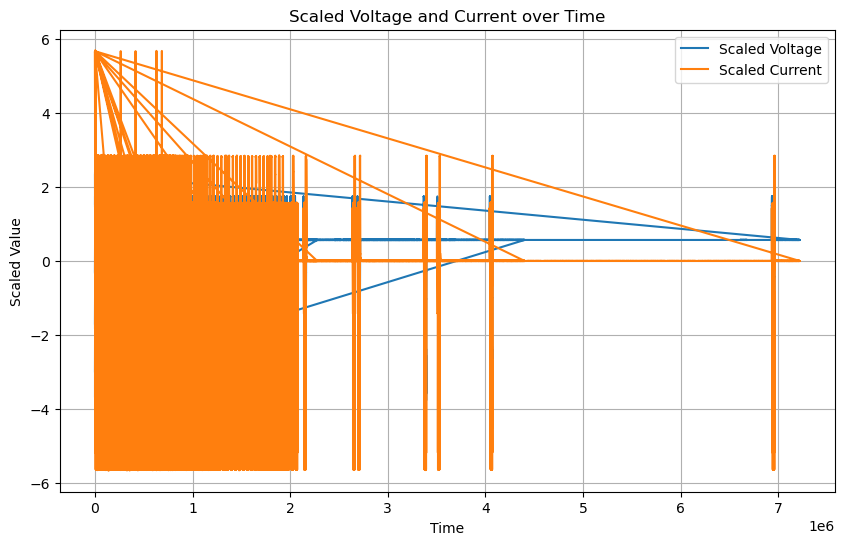

In [17]:
plt.figure(figsize=(10, 6))
plt.plot(W8_combined_data_scaled['Time'], W8_combined_data_scaled['Voltage'], label='Scaled Voltage')
plt.plot(W8_combined_data_scaled['Time'], W8_combined_data_scaled['Current'], label='Scaled Current')
plt.xlabel('Time')
plt.ylabel('Scaled Value')
plt.title('Scaled Voltage and Current over Time')
plt.legend()
plt.grid()
plt.show()


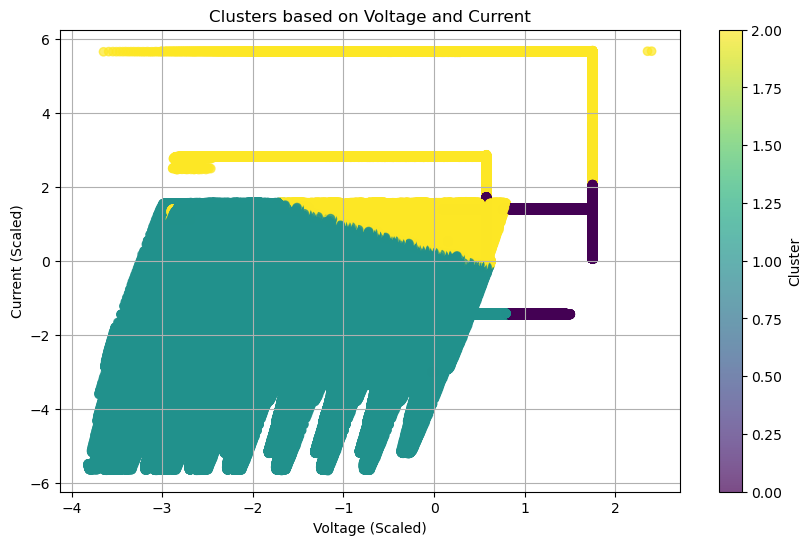

In [18]:
from sklearn.cluster import KMeans

# Apply K-Means to the scaled data
kmeans = KMeans(n_clusters=3, random_state=42)
W8_combined_data_scaled['Cluster'] = kmeans.fit_predict(W8_combined_data_scaled[num_cols])

# Visualize Clusters
plt.figure(figsize=(10, 6))
plt.scatter(W8_combined_data_scaled['Voltage'], W8_combined_data_scaled['Current'], 
            c=W8_combined_data_scaled['Cluster'], cmap='viridis', alpha=0.7)
plt.xlabel('Voltage (Scaled)')
plt.ylabel('Current (Scaled)')
plt.title('Clusters based on Voltage and Current')
plt.colorbar(label='Cluster')
plt.grid()
plt.show()


In [19]:
import numpy as np

# Calculate Z-scores
W8_combined_data_scaled['Z_Score'] = np.abs(W8_combined_data_scaled['Voltage'])

# Detect anomalies (Z-Score > 3)
anomalies = W8_combined_data_scaled[W8_combined_data_scaled['Z_Score'] > 3]
print("Anomalies detected based on Voltage Z-Scores:")
print(anomalies)


Anomalies detected based on Voltage Z-Scores:
            Current   Voltage  Step_Index  Charge_Capacity  \
12         5.664474 -3.647338           2        -1.833766   
13         5.669185 -3.589924           2        -1.832520   
14         5.669292 -3.544198           2        -1.831270   
15         5.667472 -3.505355           2        -1.830024   
16         5.668721 -3.468764           2        -1.828781   
...             ...       ...         ...              ...   
221293222 -5.517709 -3.815016          14        -1.089536   
221293223 -5.506476 -3.815332          14        -1.089536   
221293224 -5.498009 -3.817566          14        -1.089536   
221293225 -5.494325 -3.818828          14        -1.089536   
221293226 -5.484626 -3.817424          14        -1.089536   

           Discharge_Capacity           Time  Cycle  Resistance  Cluster  \
12                  -0.595400       2.050300      1    0.678042        2   
13                  -0.595400       3.049900      1    0.

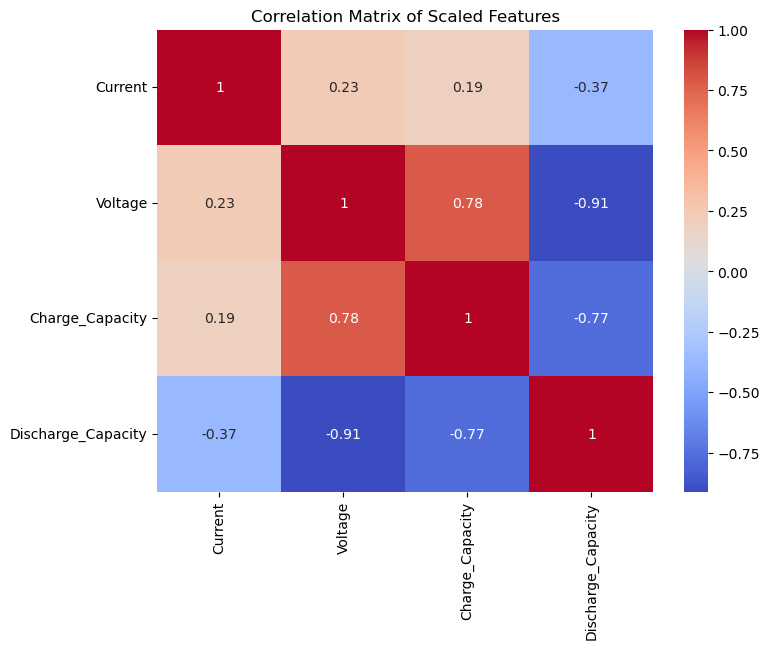

In [20]:
import seaborn as sns

plt.figure(figsize=(8, 6))
sns.heatmap(W8_combined_data_scaled[num_cols].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Scaled Features')
plt.show()


### Predicting Discharge Capacity

#### Linear Regression

In [31]:
# Define features (X) and target variable (y)
X = W8_combined_data.drop('Discharge_Capacity', axis=1)
y = W8_combined_data['Discharge_Capacity']

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [32]:
# Initialize and train the Linear Regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)

LinearRegression()

In [33]:

# Initialize and train the Linear Regression model
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)

# Make predictions on the test set
y_pred = lin_reg.predict(X_test)

# Evaluate the model
lin_reg_mse = mean_squared_error(y_test, y_pred)
lin_reg_r2 = r2_score(y_test, y_pred)
lin_reg_mae = mean_absolute_error(y_test, y_pred)

# Print results
print("Linear Regression Results:")
print("Mean Absolute Error (MAE):", lin_reg_mae)
print("Mean Squared Error (MSE):", lin_reg_mse)
print("R-squared (R²):", lin_reg_r2)


Linear Regression Results:
Mean Absolute Error (MAE): 0.04701433634683972
Mean Squared Error (MSE): 0.011883305482533513
R-squared (R²): 0.9881149528718398


Linear Regression gives us a MSE of 0.011 and a R-squared of 98.8% for cell W8

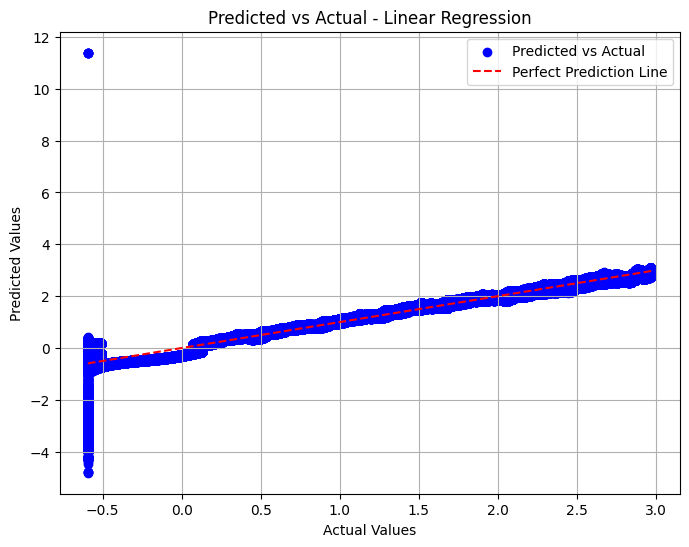

In [27]:
# Plot Predicted vs Actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', label='Predicted vs Actual')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect Prediction Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Predicted vs Actual - Linear Regression')
plt.legend()
plt.grid(True)
plt.show()

Random Forest Regression

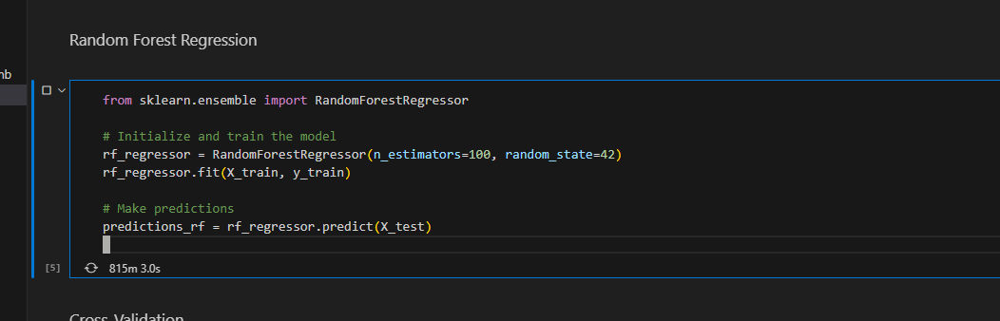

Due to the algorithm running for 13 hours i decided to try different models such as XGBoost LGBMRegressor and Gradiant boost regressor

#### XGBoost 

In [ ]:
from xgboost import XGBRegressor

# Initialize and train the model
xgb = XGBRegressor(n_estimators=30, learning_rate=0.1, max_depth=3, random_state=42)
xgb.fit(X_train, y_train)

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The XGBRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


AttributeError: 'super' object has no attribute '__sklearn_tags__'

AttributeError: 'super' object has no attribute '__sklearn_tags__'

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=10, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

The error above is related to the way the model is being displayed after fitting. it is just a rendering issue and does not affect the prediction as you can see below the model parameters are available

In [11]:
print(f"Model Parameters: n_estimators={xgb.n_estimators}, learning_rate={xgb.learning_rate}, max_depth={xgb.max_depth}")


Model Parameters: n_estimators=10, learning_rate=0.1, max_depth=3


In [13]:
# Predict on test data
predictions_xgb = xgb.predict(X_test)

# Evaluate performance
xgb_mae = mean_absolute_error(y_test, predictions_xgb)
xgb_mse = mean_squared_error(y_test, predictions_xgb)
xgb_r2 = r2_score(y_test, predictions_xgb)

print("XGBoost Results:")
print(f"MAE: {xgb_mae:.4f}")
print(f"MSE: {xgb_mse:.4f}")
print(f"R² Score: {xgb_r2:.4f}")


XGBoost Results:
MAE: 0.2876
MSE: 0.1265
R² Score: 0.8735


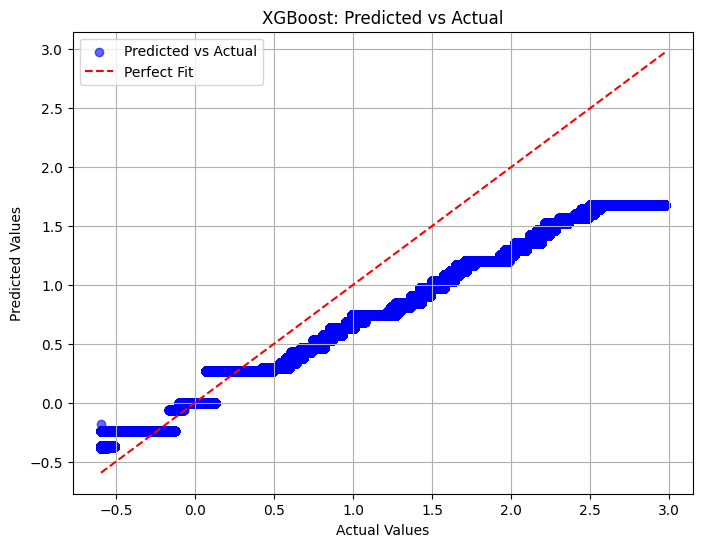

In [14]:
plt.figure(figsize=(8, 6))
plt.scatter(y_test, predictions_xgb, color="blue", alpha=0.6, label="Predicted vs Actual")
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color="red", linestyle="--", label="Perfect Fit")  # Diagonal line
plt.xlabel("Actual Values")
plt.ylabel("Predicted Values")
plt.title("XGBoost: Predicted vs Actual")
plt.legend()
plt.grid(True)
plt.show()

#### LightGBM regressor

In [15]:
from lightgbm import LGBMRegressor

# Initialize and train the model
lgbm = LGBMRegressor(n_estimators=10, learning_rate=0.1, max_depth=-1, random_state=42)
lgbm.fit(X_train, y_train)


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.812114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 177034581, number of used features: 6
[LightGBM] [Info] Start training from score 0.000043


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


LGBMRegressor(n_estimators=10, random_state=42)

In [16]:
# Predict on test data
predictions_lgbm = lgbm.predict(X_test)

# Evaluate performance
lgbm_mae = mean_absolute_error(y_test, predictions_lgbm)
lgbm_mse = mean_squared_error(y_test, predictions_lgbm)
lgbm_r2 = r2_score(y_test, predictions_lgbm)

print("LightGBM Results:")
print(f"MAE: {lgbm_mae:.4f}")
print(f"MSE: {lgbm_mse:.4f}")
print(f"R² Score: {lgbm_r2:.4f}")


LightGBM Results:
MAE: 0.2852
MSE: 0.1219
R² Score: 0.8781


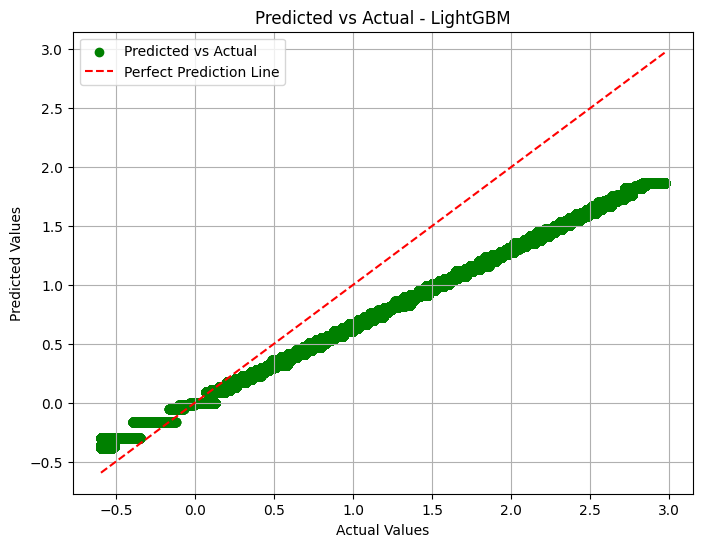

In [17]:
# Plot Predicted vs Actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, predictions_lgbm, color='green', label='Predicted vs Actual')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect Prediction Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Predicted vs Actual - LightGBM')
plt.legend()
plt.grid(True)
plt.show()

#### Gradient Boost Regressor

In [18]:
from sklearn.ensemble import GradientBoostingRegressor

# Initialize and train the model
gbr = GradientBoostingRegressor(n_estimators=10, learning_rate=0.1, max_depth=3, random_state=42)
gbr.fit(X_train, y_train)


GradientBoostingRegressor(n_estimators=10, random_state=42)

In [19]:
# Predict on test data
predictions_gbr = gbr.predict(X_test)

# Evaluate performance
gbr_mae = mean_absolute_error(y_test, predictions_gbr)
gbr_mse = mean_squared_error(y_test, predictions_gbr)
gbr_r2 = r2_score(y_test, predictions_gbr)

print("Gradient Boosting Results:")
print(f"MAE: {gbr_mae:.4f}")
print(f"MSE: {gbr_mse:.4f}")
print(f"R² Score: {gbr_r2:.4f}")


Gradient Boosting Results:
MAE: 0.2872
MSE: 0.1265
R² Score: 0.8735


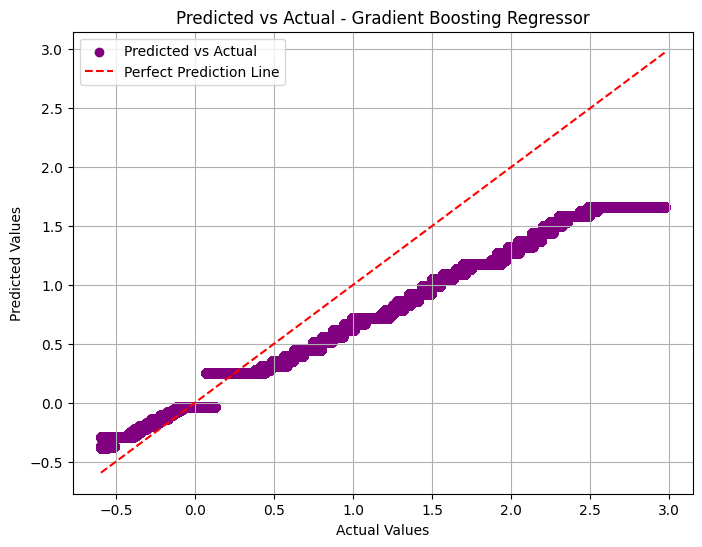

In [20]:
# Plot Predicted vs Actual values
plt.figure(figsize=(8, 6))
plt.scatter(y_test, predictions_gbr, color='purple', label='Predicted vs Actual')
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect Prediction Line')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Predicted vs Actual - Gradient Boosting Regressor')
plt.legend()
plt.grid(True)
plt.show()

#### GridSearchCV used to hyperparameter

In [47]:
from sklearn.model_selection import GridSearchCV

# Set the hyperparameters grid
param_grid = {
    'n_estimators': [10, 30, 50],
    'max_depth': [3, 5, 10],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 0.9, 1.0]
}

# Initialize the GridSearchCV
grid_search = GridSearchCV(estimator=XGBRegressor(random_state=42), param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)

# Fit the GridSearchCV on training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Print out the best parameters and score
print(f"Best Parameters: {best_params}")
print(f"Best Cross-Validation Score: {best_score}")


AttributeError: 'super' object has no attribute '__sklearn_tags__'

In [ ]:
##Due to the above error i had to use XGBoosts own cv() function to run the hyperparameter tuning

from xgboost import XGBRegressor, cv, DMatrix
import pandas as pd

# Example replacement:
params = {
    'n_estimators': 100,
    'max_depth': 5,
    'learning_rate': 0.1,
    'subsample': 0.9
}

xgb_model = XGBRegressor(**params)
xgb_model.fit(X_train, y_train)


In [48]:
from sklearn.model_selection import GridSearchCV

# Set the hyperparameters grid
param_grid = {
    'n_estimators': [10, 30, 50],
    'max_depth': [3, 5, 10],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 0.9, 1.0]
}

# Initialize the GridSearchCV
grid_search = GridSearchCV(estimator=LGBMRegressor(random_state=42), param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)

# Fit the GridSearchCV on training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Print out the best parameters and score
print(f"Best Parameters: {best_params}")
print(f"Best Cross-Validation Score: {best_score}")


Fitting 5 folds for each of 81 candidates, totalling 405 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.623485 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Lig

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.620532 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.598463 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.620428 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.656845 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.598949 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.732415 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.619840 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.611560 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.583508 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.613628 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.723609 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.539680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.525753 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.532629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.538573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.674992 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.763051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.567096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.695067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.565681 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.686321 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.636246 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.634173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.643139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.505537 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.601107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.670661 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.708943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.544536 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.513811 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.490810 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.667621 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.568893 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.591984 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.486814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.671530 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.526156 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.684709 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.635770 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.721024 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.665322 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.606851 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.691573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.520296 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.549857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.505834 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.648232 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.776051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.543618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.684996 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.536752 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000011


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.650257 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score -0.000011


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.525919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000115


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.691555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627665, number of used features: 6
[LightGBM] [Info] Start training from score 0.000067


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.635004 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1046
[LightGBM] [Info] Number of data points in the train set: 141627664, number of used features: 6
[LightGBM] [Info] Start training from score 0.000033


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.

KeyboardInterrupt: 

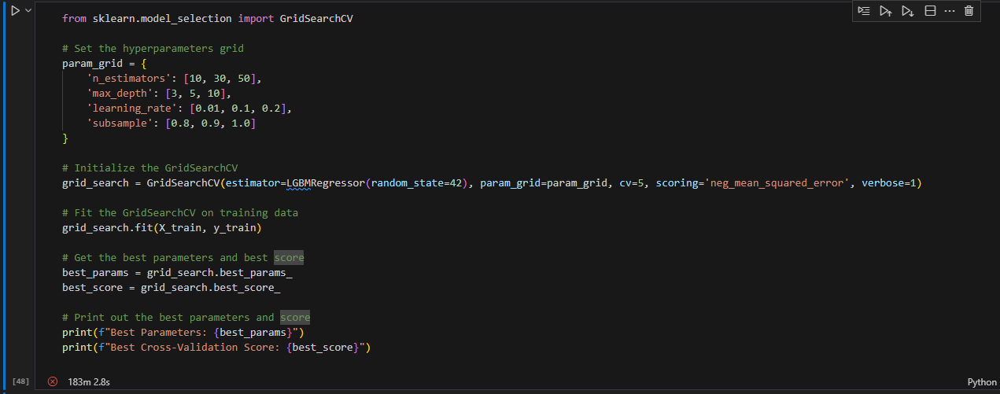

Due to it running for 183 mins i had to stop it to run other more important stuff

In [ ]:
from sklearn.model_selection import GridSearchCV

# Set the hyperparameters grid
param_grid = {
    'n_estimators': [10, 30, 50],
    'max_depth': [3, 5, 10],
    'learning_rate': [0.01, 0.1, 0.2],
    'subsample': [0.8, 0.9, 1.0]
}

# Initialize the GridSearchCV
grid_search = GridSearchCV(estimator=GradientBoostingRegressor(random_state=42), param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', verbose=1)

# Fit the GridSearchCV on training data
grid_search.fit(X_train, y_train)

# Get the best parameters and best score
best_params = grid_search.best_params_
best_score = grid_search.best_score_

# Print out the best parameters and score
print(f"Best Parameters: {best_params}")
print(f"Best Cross-Validation Score: {best_score}")


#### Rerunning the models with new parameters

In [28]:
# Results from the previous runs
models = ['Linear Regression', 'XGBoost', 'LightGBM', 'Gradient Boosting']
mae_scores = [lin_reg_mae, xgb_mae, lgbm_mae, gbr_mae]
mse_scores = [lin_reg_mse, xgb_mse, lgbm_mse, gbr_mse]
r2_scores = [lin_reg_r2, xgb_r2, lgbm_r2, gbr_r2]

# Print out the evaluation metrics
for model, mae, mse, r2 in zip(models, mae_scores, mse_scores, r2_scores):
    print(f"{model}:")
    print(f"  MAE: {mae:.4f}")
    print(f"  MSE: {mse:.4f}")
    print(f"  R²: {r2:.4f}")
    print("")


Linear Regression:
  MAE: 0.0470
  MSE: 0.0119
  R²: 0.9881

XGBoost:
  MAE: 0.2876
  MSE: 0.1265
  R²: 0.8735

LightGBM:
  MAE: 0.2852
  MSE: 0.1219
  R²: 0.8781

Gradient Boosting:
  MAE: 0.2872
  MSE: 0.1265
  R²: 0.8735



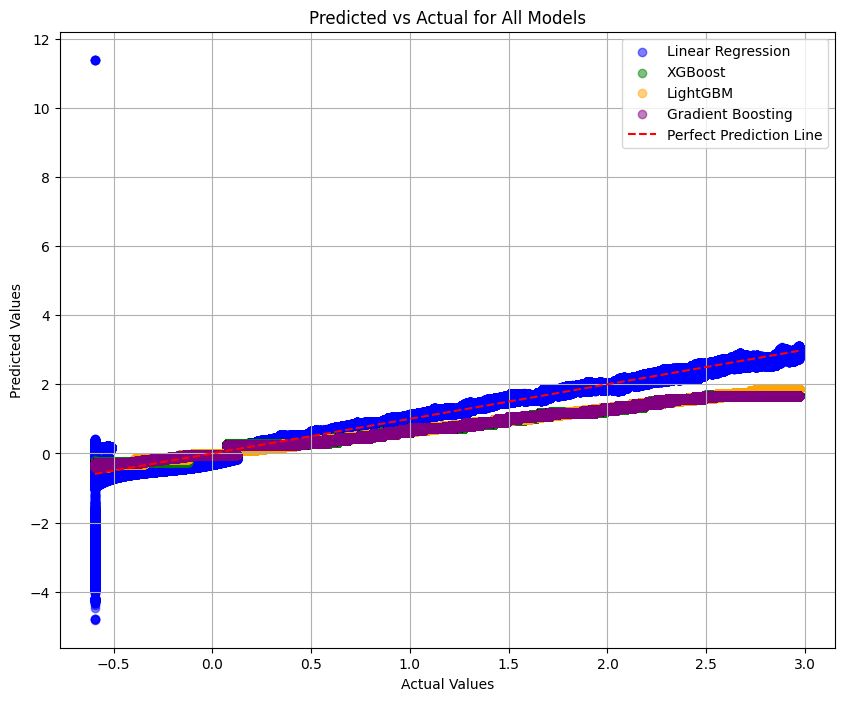

In [29]:
# Plot Predicted vs Actual for all models
plt.figure(figsize=(10, 8))

# Scatter plot for Linear Regression
plt.scatter(y_test, lin_reg.predict(X_test), color='blue', alpha=0.5, label='Linear Regression')

# Scatter plot for XGBoost
plt.scatter(y_test, predictions_xgb, color='green', alpha=0.5, label='XGBoost')

# Scatter plot for LightGBM
plt.scatter(y_test, predictions_lgbm, color='orange', alpha=0.5, label='LightGBM')

# Scatter plot for Gradient Boosting
plt.scatter(y_test, predictions_gbr, color='purple', alpha=0.5, label='Gradient Boosting')

# Line for perfect predictions
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--', label='Perfect Prediction Line')

# Adding labels and title
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Predicted vs Actual for All Models')
plt.legend()
plt.grid(True)

# Show plot
plt.show()

 ### Predicting Discharge per cycle

In [5]:
# Calculate max discharge capacity
max_discharge_capacity = W8_combined_data['Discharge_Capacity'].max()

# Group by Cycle to get max discharge capacity per cycle
discharge_capacity_per_cycle = W8_combined_data.groupby('Cycle')['Discharge_Capacity'].max()

# Convert to percentage
discharge_capacity_percentage = (discharge_capacity_per_cycle / max_discharge_capacity) * 100

# Prepare the data for modeling
data_for_model = discharge_capacity_percentage.reset_index()
data_for_model.columns = ['Cycle', 'Discharge_Capacity_Percentage']


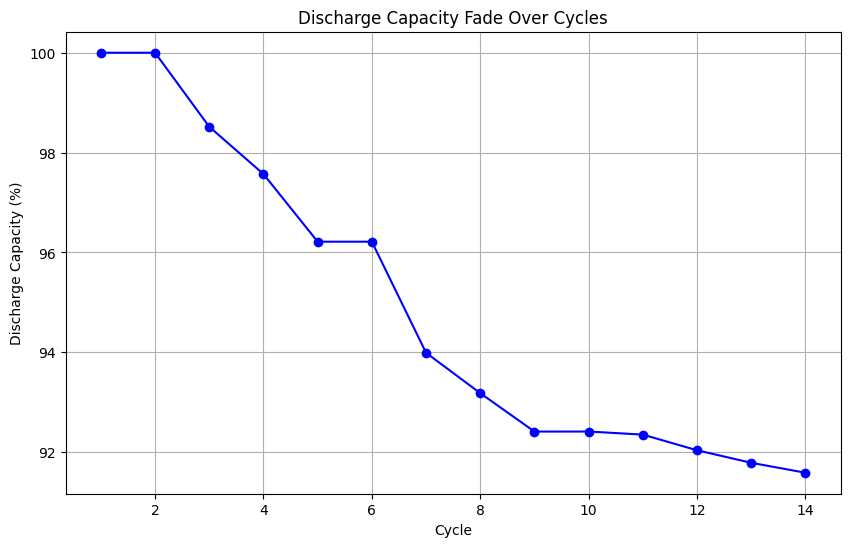

In [6]:
plt.figure(figsize=(10, 6))
plt.plot(data_for_model['Cycle'], data_for_model['Discharge_Capacity_Percentage'], 
         marker='o', linestyle='-', color='blue')
plt.title('Discharge Capacity Fade Over Cycles')
plt.xlabel('Cycle')
plt.ylabel('Discharge Capacity (%)')
plt.grid()
plt.show()


In [7]:
# Define X (features) and y (target)
X = data_for_model[['Cycle']]  # Start with Cycle alone
y = data_for_model['Discharge_Capacity_Percentage']

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


#### Linear Regression Model

In [8]:
# Train Linear Regression
lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)


LinearRegression()

In [21]:
# Make predictions on the test set
y_pred_lin = lin_reg.predict(X_test)

# Evaluate the model
lin_reg_mae = mean_absolute_error(y_test, y_pred_lin)
lin_reg_mse = mean_squared_error(y_test, y_pred_lin)
lin_reg_r2 = r2_score(y_test, y_pred_lin)

# Print results
print("Linear Regression Results:")
print(f"MAE: {lin_reg_mae:.4f}")
print(f"MSE: {lin_reg_mse:.4f}")
print(f"R²: {lin_reg_r2:.4f}")


Linear Regression Results:
MAE: 0.5422
MSE: 0.3219
R²: 0.9761


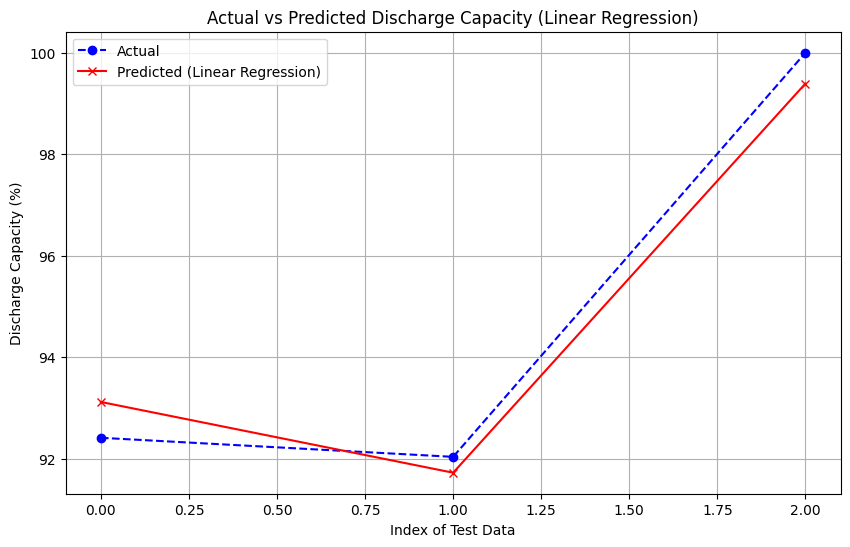

In [10]:
# Linear Regression: Actual vs Predicted
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual', color='blue', marker='o', linestyle='--')
plt.plot(y_pred_lin, label='Predicted (Linear Regression)', color='red', marker='x', linestyle='-')

plt.title('Actual vs Predicted Discharge Capacity (Linear Regression)')
plt.xlabel('Index of Test Data')
plt.ylabel('Discharge Capacity (%)')
plt.legend()
plt.grid()
plt.show()


#### XGBoost Model

In [11]:
from xgboost import XGBRegressor
# Initialize and train the XGBRegressor model
xgb = XGBRegressor(n_estimators=30, learning_rate=0.1, max_depth=3, random_state=42)
xgb.fit(X_train, y_train)

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The XGBRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


AttributeError: 'super' object has no attribute '__sklearn_tags__'

AttributeError: 'super' object has no attribute '__sklearn_tags__'

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=3, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=30, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [12]:
# Make predictions on the test set
y_pred_xgb = xgb.predict(X_test)

# Evaluate the model
xgb_mae = mean_absolute_error(y_test, y_pred_xgb)
xgb_mse = mean_squared_error(y_test, y_pred_xgb)
xgb_r2 = r2_score(y_test, y_pred_xgb)

# Print results
print("XGBoost Results:")
print(f"MAE: {xgb_mae:.4f}")
print(f"MSE: {xgb_mse:.4f}")
print(f"R²: {xgb_r2:.4f}")


XGBoost Results:
MAE: 0.5771
MSE: 0.4920
R²: 0.9634


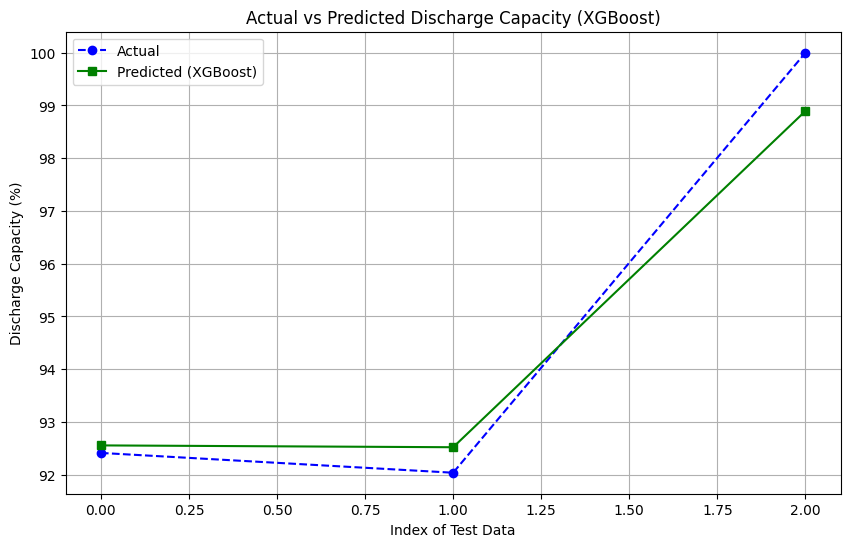

In [13]:
# XGBoost: Actual vs Predicted
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual', color='blue', marker='o', linestyle='--')
plt.plot(y_pred_xgb, label='Predicted (XGBoost)', color='green', marker='s', linestyle='-')

plt.title('Actual vs Predicted Discharge Capacity (XGBoost)')
plt.xlabel('Index of Test Data')
plt.ylabel('Discharge Capacity (%)')
plt.legend()
plt.grid()
plt.show()


#### LightGBM Model

In [14]:
from lightgbm import LGBMRegressor

# Initialize and train the LGBMRegressor model
lgbm = LGBMRegressor(n_estimators=30, learning_rate=0.1, max_depth=3, random_state=42)
lgbm.fit(X_train, y_train)


[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 11, number of used features: 0
[LightGBM] [Info] Start training from score 94.892540
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the spl

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\_tags.py:354: FutureWarning: The LGBMRegressor or classes from which it inherits use `_get_tags` and `_more_tags`. Please define the `__sklearn_tags__` method, or inherit from `sklearn.base.BaseEstimator` and/or other appropriate mixins such as `sklearn.base.TransformerMixin`, `sklearn.base.ClassifierMixin`, `sklearn.base.RegressorMixin`, and `sklearn.base.OutlierMixin`. From scikit-learn 1.7, not defining `__sklearn_tags__` will raise an error.
  warnings.warn(


LGBMRegressor(max_depth=3, n_estimators=30, random_state=42)

In [15]:

# Make predictions on the test set
y_pred_lgbm = lgbm.predict(X_test)

# Evaluate the model
lgbm_mae = mean_absolute_error(y_test, y_pred_lgbm)
lgbm_mse = mean_squared_error(y_test, y_pred_lgbm)
lgbm_r2 = r2_score(y_test, y_pred_lgbm)

# Print results
print("LightGBM Results:")
print(f"MAE: {lgbm_mae:.4f}")
print(f"MSE: {lgbm_mse:.4f}")
print(f"R²: {lgbm_r2:.4f}")


LightGBM Results:
MAE: 3.4814
MSE: 13.4654
R²: -0.0004


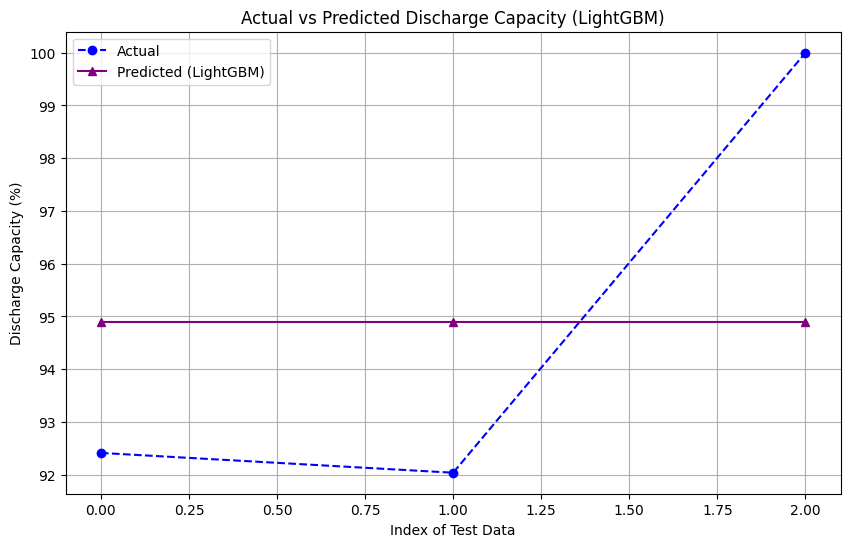

In [16]:
# LightGBM: Actual vs Predicted
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual', color='blue', marker='o', linestyle='--')
plt.plot(y_pred_lgbm, label='Predicted (LightGBM)', color='purple', marker='^', linestyle='-')

plt.title('Actual vs Predicted Discharge Capacity (LightGBM)')
plt.xlabel('Index of Test Data')
plt.ylabel('Discharge Capacity (%)')
plt.legend()
plt.grid()
plt.show()


#### Gradient Boosting Model

In [17]:
from sklearn.ensemble import GradientBoostingRegressor

# Initialize and train the GradientBoostingRegressor model
gbr = GradientBoostingRegressor(n_estimators=30, learning_rate=0.1, max_depth=3, random_state=42)
gbr.fit(X_train, y_train)


GradientBoostingRegressor(n_estimators=30, random_state=42)

In [18]:

# Make predictions on the test set
y_pred_gbr = gbr.predict(X_test)

# Evaluate the model
gbr_mae = mean_absolute_error(y_test, y_pred_gbr)
gbr_mse = mean_squared_error(y_test, y_pred_gbr)
gbr_r2 = r2_score(y_test, y_pred_gbr)

# Print results
print("Gradient Boosting Results:")
print(f"MAE: {gbr_mae:.4f}")
print(f"MSE: {gbr_mse:.4f}")
print(f"R²: {gbr_r2:.4f}")


Gradient Boosting Results:
MAE: 0.2447
MSE: 0.0784
R²: 0.9942


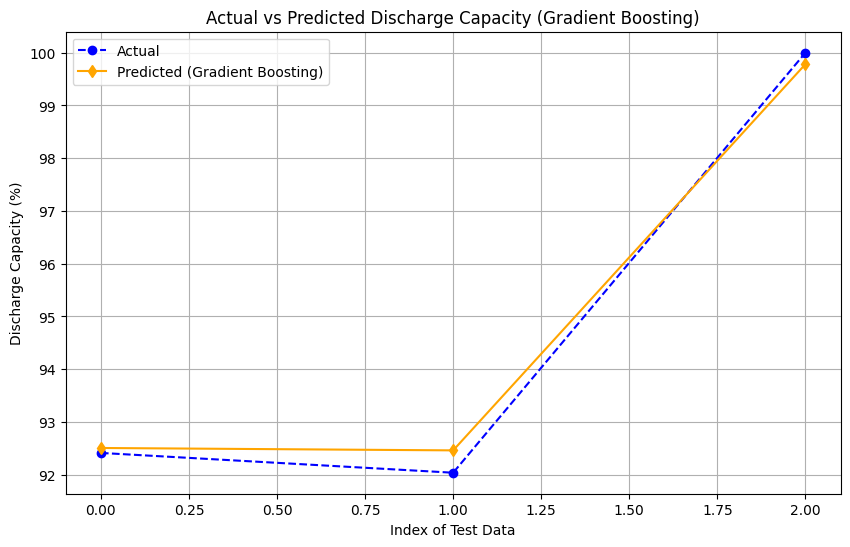

In [19]:
# Gradient Boosting: Actual vs Predicted
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual', color='blue', marker='o', linestyle='--')
plt.plot(y_pred_gbr, label='Predicted (Gradient Boosting)', color='orange', marker='d', linestyle='-')

plt.title('Actual vs Predicted Discharge Capacity (Gradient Boosting)')
plt.xlabel('Index of Test Data')
plt.ylabel('Discharge Capacity (%)')
plt.legend()
plt.grid()
plt.show()


In [ ]:
# Create a comparison DataFrame
results = pd.DataFrame({
    'Model': ['Linear Regression', 'XGBoost', 'LightGBM', 'Gradient Boosting'],
    'MAE': [lin_reg_mae, xgb_mae, lgbm_mae, gbr_mae],
    'MSE': [lin_reg_mse, xgb_mse, lgbm_mse, gbr_mse],
    'R²': [lin_reg_r2, xgb_r2, lgbm_r2, gbr_r2]
})

# Display the comparison
print("\nModel Comparison:")
print(results)


In [ ]:
# Plot Actual vs Predicted for all models
plt.figure(figsize=(12, 8))

plt.plot(y_test.values, label='Actual', color='blue', linestyle='--', marker='o')
plt.plot(y_pred_lin, label='Linear Regression', linestyle='-', marker='x')
plt.plot(y_pred_xgb, label='XGBoost', linestyle='-', marker='s')
plt.plot(y_pred_lgbm, label='LightGBM', linestyle='-', marker='^')
plt.plot(y_pred_gbr, label='Gradient Boosting', linestyle='-', marker='d')

plt.title('Actual vs Predicted Discharge Capacity')
plt.xlabel('Index of Test Data')
plt.ylabel('Discharge Capacity (%)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


#### Hyperparameter Grid and GridSearchCV for All Models

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.ensemble import GradientBoostingRegressor

# Define hyperparameter grids
param_grid_xgb = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1],
}

param_grid_lgbm = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1],
    'subsample': [0.8, 1.0]
}

param_grid_gbr = {
    'n_estimators': [50, 100],
    'max_depth': [3, 5, 7],
    'learning_rate': [0.01, 0.1],
}

# Initialize models
xgb = XGBRegressor(random_state=42)
lgbm = LGBMRegressor(random_state=42)
gbr = GradientBoostingRegressor(random_state=42)

# GridSearch for each model
cv = 5

grid_search_xgb = GridSearchCV(estimator=xgb, param_grid=param_grid_xgb, cv=cv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
grid_search_lgbm = GridSearchCV(estimator=lgbm, param_grid=param_grid_lgbm, cv=cv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
grid_search_gbr = GridSearchCV(estimator=gbr, param_grid=param_grid_gbr, cv=cv, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)


In [ ]:
# Train XGBoost
print("Training XGBoost...")
grid_search_xgb.fit(X_train, y_train)
print("Best Parameters (XGBoost):", grid_search_xgb.best_params_)

# Train LightGBM
print("Training LightGBM...")
grid_search_lgbm.fit(X_train, y_train)
print("Best Parameters (LightGBM):", grid_search_lgbm.best_params_)

# Train Gradient Boosting
print("Training Gradient Boosting...")
grid_search_gbr.fit(X_train, y_train)
print("Best Parameters (Gradient Boosting):", grid_search_gbr.best_params_)


## Using Feature engineering to try and predict SOH

In [5]:
charge_discharge_counts = {
    1: 25,
    2: 50,
    3: 50,
    4: 23,
    5: 2,
    6: 1,
    7: 6,
    8: 28,
    9: 37,
    10: 25,
    11: 25,
    12: 25,
    14: 25
}

In [6]:
# Convert to DataFrame
W8_combined_data_df = pd.DataFrame(W8_combined_data)

# Map the charge-discharge counts to a new column
W8_combined_data_df['Charge_Discharge_Counts'] = W8_combined_data_df['Cycle'].map(charge_discharge_counts)

W8_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)

# Display the result
print(W8_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.096483           1         0.000000   
2          0.000000  3.096541           1         0.000000   
3          0.000000  3.096607           1         0.000000   
4          0.000000  3.096365           1         0.000000   
...             ...       ...         ...              ...   
221293222 -4.726364  3.250176          14         0.803627   
221293223 -4.716759  3.250122          14         0.803627   
221293224 -4.709518  3.249741          14         0.803627   
221293225 -4.706367  3.249525          14         0.803627   
221293226 -4.698074  3.249765          14         0.803627   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  
0                    0.000000       0.000000      1                     25.0  
1                    0.000000       0.100800      1                     25.0  
2                 

In [7]:
# Group by 'Cycle' and calculate cumulative charge-discharge
cycle_counts = W8_combined_data_df.groupby('Cycle')['Charge_Discharge_Counts'].first().reset_index()
cycle_counts['Cumulative_Charge_Discharge'] = cycle_counts['Charge_Discharge_Counts'].cumsum()

# Map the cumulative values back to the original DataFrame
W8_combined_data_df['Cumulative_Charge_Discharge'] = W8_combined_data_df['Cycle'].map(
    cycle_counts.set_index('Cycle')['Cumulative_Charge_Discharge']
)

# Display the updated DataFrame
print(W8_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.096483           1         0.000000   
2          0.000000  3.096541           1         0.000000   
3          0.000000  3.096607           1         0.000000   
4          0.000000  3.096365           1         0.000000   
...             ...       ...         ...              ...   
221293222 -4.726364  3.250176          14         0.803627   
221293223 -4.716759  3.250122          14         0.803627   
221293224 -4.709518  3.249741          14         0.803627   
221293225 -4.706367  3.249525          14         0.803627   
221293226 -4.698074  3.249765          14         0.803627   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  \
0                    0.000000       0.000000      1                     25.0   
1                    0.000000       0.100800      1                     25.0   
2              

In [8]:
W8_combined_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221293227 entries, 0 to 221293226
Data columns (total 9 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   Current                      float64
 1   Voltage                      float64
 2   Step_Index                   int64  
 3   Charge_Capacity              float64
 4   Discharge_Capacity           float64
 5   Time                         float64
 6   Cycle                        int64  
 7   Charge_Discharge_Counts      float64
 8   Cumulative_Charge_Discharge  float64
dtypes: float64(7), int64(2)
memory usage: 14.8 GB


In [9]:
W8_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)
W8_combined_data_df['Cumulative_Charge_Discharge'].fillna(0, inplace=True)


In [10]:
print(W8_combined_data_df.isnull().sum())


Current                        0
Voltage                        0
Step_Index                     0
Charge_Capacity                0
Discharge_Capacity             0
Time                           0
Cycle                          0
Charge_Discharge_Counts        0
Cumulative_Charge_Discharge    0
dtype: int64


In [11]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Select numerical columns
num_cols = ['Current', 'Voltage', 'Charge_Capacity', 'Discharge_Capacity','Charge_Discharge_Counts','Cumulative_Charge_Discharge']

# Apply scaling
W8_combined_data_df_scaled = W8_combined_data_df.copy()
W8_combined_data_df_scaled[num_cols] = scaler.fit_transform(W8_combined_data_df[num_cols])

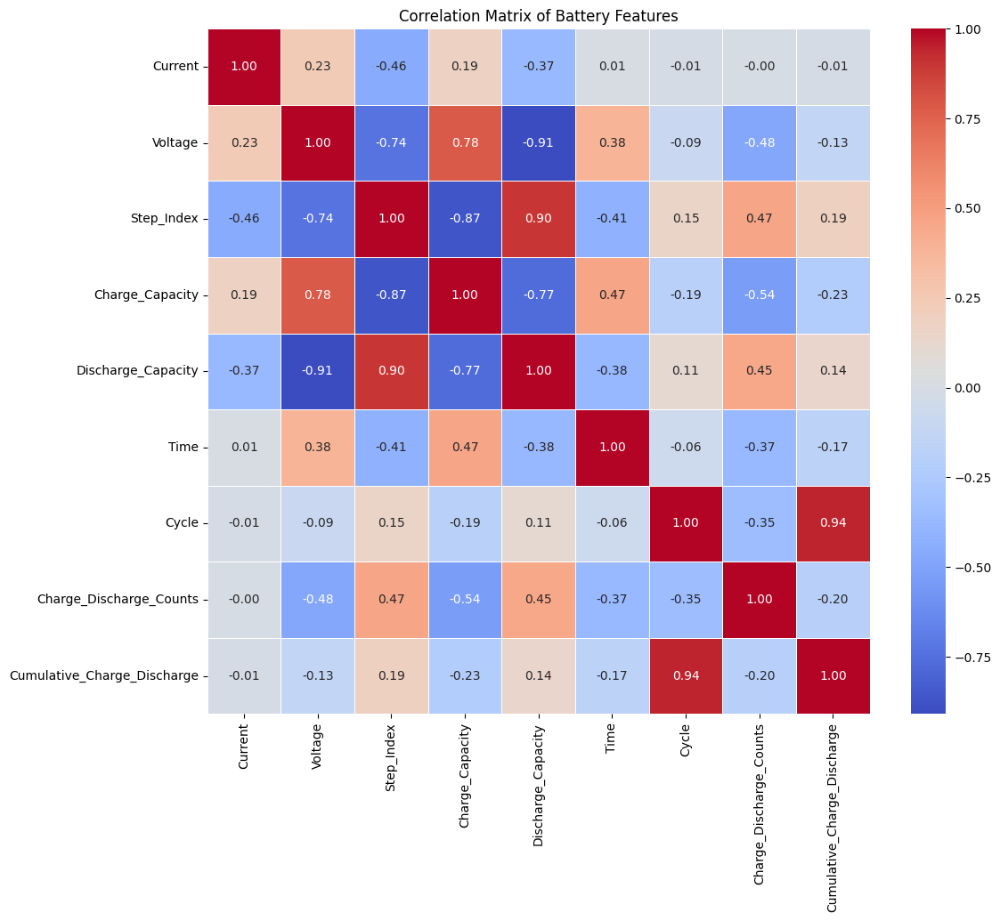

In [12]:
correlation_matrix = W8_combined_data_df_scaled.corr()

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Battery Features")
plt.show()

Correlation between Max Discharge Capacity and Cumulative Charge Discharge: -0.93


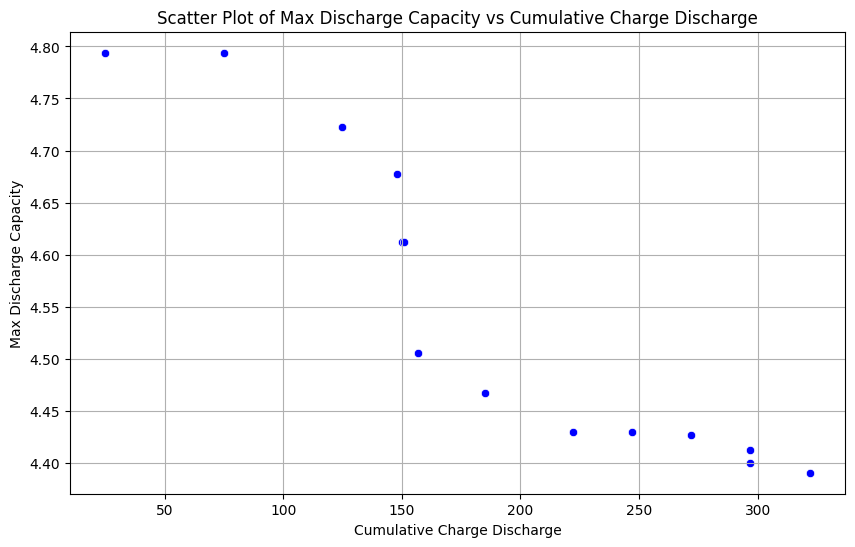

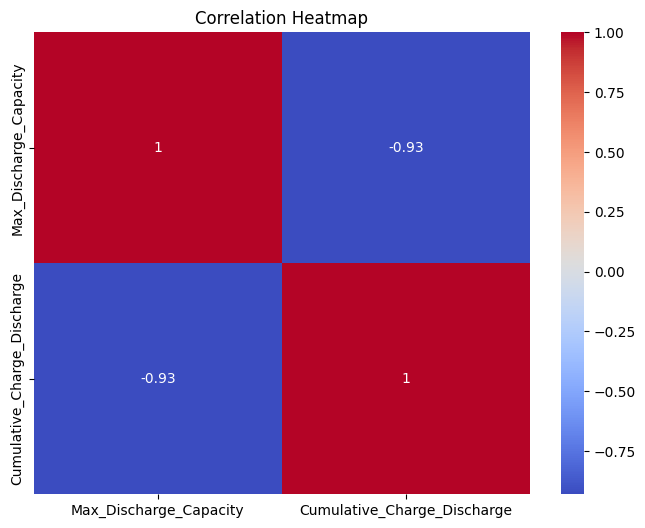

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

# Group by Cycle to get max discharge capacity
max_discharge_per_cycle = W8_combined_data_df.groupby('Cycle')['Discharge_Capacity'].max().reset_index()
max_discharge_per_cycle.rename(columns={'Discharge_Capacity': 'Max_Discharge_Capacity'}, inplace=True)

# Merge with cumulative charge discharge data
cumulative_data = W8_combined_data_df[['Cycle', 'Cumulative_Charge_Discharge']].drop_duplicates()
data = max_discharge_per_cycle.merge(cumulative_data, on='Cycle')

correlation = data['Max_Discharge_Capacity'].corr(data['Cumulative_Charge_Discharge'])
print(f"Correlation between Max Discharge Capacity and Cumulative Charge Discharge: {correlation:.2f}")

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Cumulative_Charge_Discharge', y='Max_Discharge_Capacity', data=data, color='blue')
plt.title('Scatter Plot of Max Discharge Capacity vs Cumulative Charge Discharge')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.grid(True)
plt.show()

plt.figure(figsize=(8, 6))
sns.heatmap(data[['Max_Discharge_Capacity', 'Cumulative_Charge_Discharge']].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()


In [14]:
X = data[['Cumulative_Charge_Discharge']].values  # Predictor
y = data['Max_Discharge_Capacity'].values        # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [24]:
model = LinearRegression()
model.fit(X_train, y_train)

# Predict on test data
y_pred = model.predict(X_test)

Root Mean Squared Error (RMSE): 0.031
R² Score: 0.969


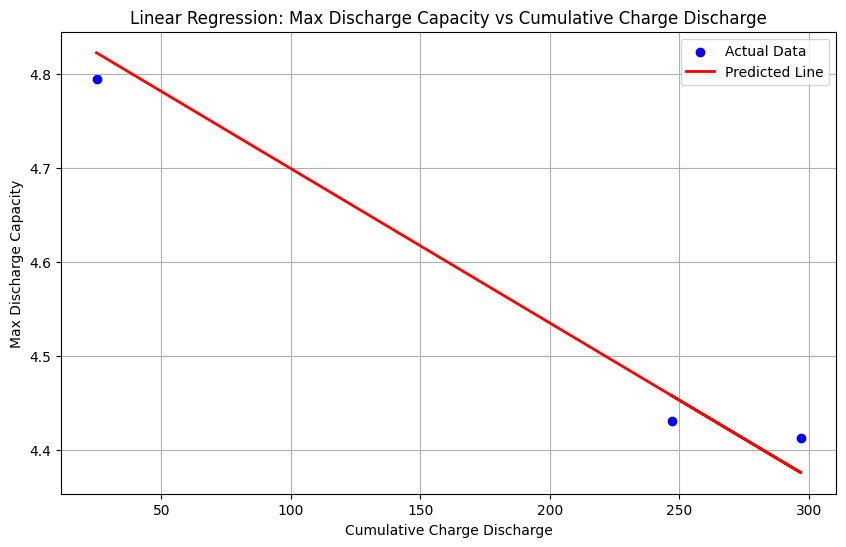

In [25]:
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)


print(f"Root Mean Squared Error (RMSE): {rmse:.3f}")
print(f"R² Score: {r2:.3f}")

# ---------------------- 5. Visualize Predictions ----------------------
plt.figure(figsize=(10, 6))
plt.scatter(X_test, y_test, color='blue', label='Actual Data')
plt.plot(X_test, y_pred, color='red', linewidth=2, label='Predicted Line')
plt.title('Linear Regression: Max Discharge Capacity vs Cumulative Charge Discharge')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.legend()
plt.grid(True)
plt.show()

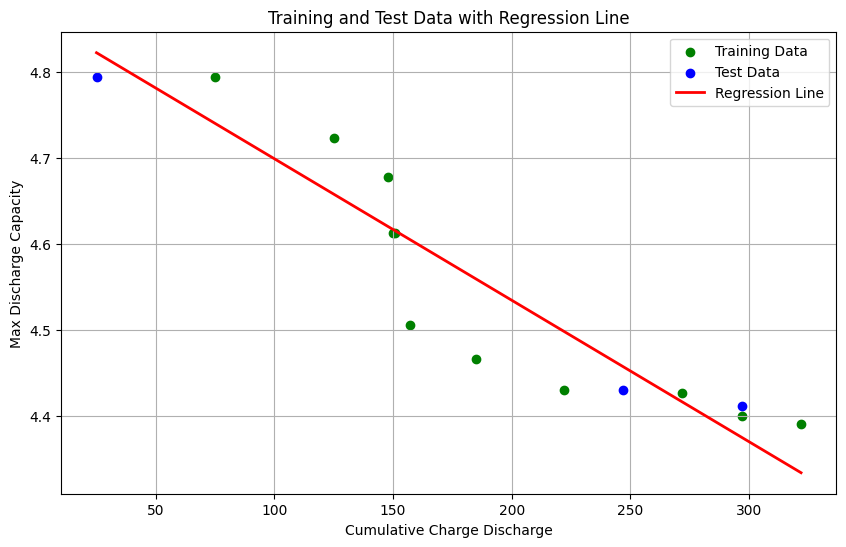

In [18]:
# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train the model
model = LinearRegression()
model.fit(X_train, y_train)

# Predictions
y_pred_test = model.predict(X_test)
y_pred_train = model.predict(X_train)

# Visualization
plt.figure(figsize=(10, 6))
plt.scatter(X_train, y_train, color='green', label='Training Data')  # Training points
plt.scatter(X_test, y_test, color='blue', label='Test Data')  # Test points
plt.plot(X, model.predict(X), color='red', linewidth=2, label='Regression Line')  # Predicted line
plt.title('Training and Test Data with Regression Line')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.legend()
plt.grid(True)
plt.show()


In [19]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR

models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
    "Support Vector Regressor": SVR(kernel='rbf')
}


In [20]:
results = []

for name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
    
    # Predict
    y_pred = model.predict(X_test)
    
    # Calculate Metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    
    # Store Results
    results.append({
        'Model': name,
        'MAE': mae,
        'MSE': mse,
        'R²': r2
    })
    
    # Print Results for Each Model
    print(f"Results for {name}:")
    print(f"MAE: {mae:.4f}")
    print(f"MSE: {mse:.4f}")
    print(f"R²: {r2:.4f}")
    print('-' * 50)


Results for Linear Regression:
MAE: 0.0308
MSE: 0.0010
R²: 0.9687
--------------------------------------------------
Results for Decision Tree:
MAE: 0.0040
MSE: 0.0000
R²: 0.9984
--------------------------------------------------
Results for Random Forest:
MAE: 0.0131
MSE: 0.0004
R²: 0.9876
--------------------------------------------------
Results for Support Vector Regressor:
MAE: 0.1027
MSE: 0.0113
R²: 0.6339
--------------------------------------------------


In [61]:


results_df = pd.DataFrame(results)

# Display Results
print("\nModel Comparison:")
print(results_df)




Model Comparison:
                      Model       MAE       MSE        R²
0         Linear Regression  0.030832  0.000969  0.968688
1             Decision Tree  0.004029  0.000048  0.998439
2             Random Forest  0.013066  0.000385  0.987566
3  Support Vector Regressor  0.102658  0.011325  0.633868


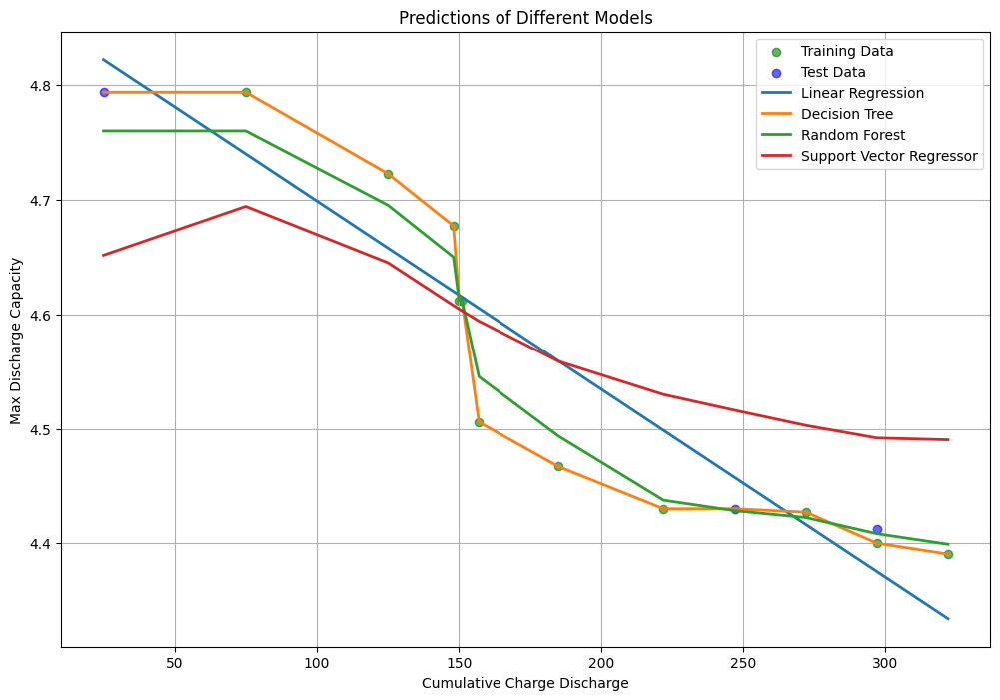

In [62]:
# Plot all models on one graph
plt.figure(figsize=(12, 8))

# Plot actual data
plt.scatter(X_train, y_train, color='green', label='Training Data', alpha=0.6)
plt.scatter(X_test, y_test, color='blue', label='Test Data', alpha=0.6)

# Add each model's prediction line
for name, model in models.items():
    model.fit(X_train, y_train)
    y_pred_all = model.predict(X)
    plt.plot(X, y_pred_all, linewidth=2, label=f'{name}')

# Graph styling
plt.title('Predictions of Different Models')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.legend()
plt.grid(True)
plt.show()


## running algorithms on W9 cell

Transferring the SOH model to W9 cell

In [65]:
charge_discharge_counts = {
    1: 25,
    2: 50,
    3: 50,
    4: 23,
    5: 2,
    6: 1,
    7: 6,
    8: 28,
    9: 37,
    10: 25,
    11: 25,
    12: 25,
    14: 25
}

In [76]:
# Convert to DataFrame
W9_combined_data_df = pd.DataFrame(W9_combined_data)

# Map the charge-discharge counts to a new column
W9_combined_data_df['Charge_Discharge_Counts'] = W9_combined_data_df['Cycle'].map(charge_discharge_counts)

W9_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)

# Display the result
print(W9_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.095433           1         0.000000   
2          0.000000  3.095472           1         0.000000   
3          0.000000  3.095478           1         0.000000   
4          0.000000  3.095448           1         0.000000   
...             ...       ...         ...              ...   
198233889 -4.501915  3.290081          14         0.803514   
198233890 -4.462578  3.290710          14         0.803514   
198233891 -4.431702  3.291940          14         0.803514   
198233892 -4.362900  3.293313          14         0.803514   
198233893 -4.364609  3.293377          14         0.803514   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  
0                    0.000000       0.000000      1                     25.0  
1                    0.000000       0.100300      1                     25.0  
2                 

In [88]:
# Group by 'Cycle' and calculate cumulative charge-discharge
cycle_counts = W9_combined_data_df.groupby('Cycle')['Charge_Discharge_Counts'].first().reset_index()
cycle_counts['Cumulative_Charge_Discharge'] = cycle_counts['Charge_Discharge_Counts'].cumsum()

# Map the cumulative values back to the original DataFrame
W9_combined_data_df['Cumulative_Charge_Discharge'] = W9_combined_data_df['Cycle'].map(
    cycle_counts.set_index('Cycle')['Cumulative_Charge_Discharge']
)

# Display the updated DataFrame
print(W9_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.095433           1         0.000000   
2          0.000000  3.095472           1         0.000000   
3          0.000000  3.095478           1         0.000000   
4          0.000000  3.095448           1         0.000000   
...             ...       ...         ...              ...   
198233889 -4.501915  3.290081          14         0.803514   
198233890 -4.462578  3.290710          14         0.803514   
198233891 -4.431702  3.291940          14         0.803514   
198233892 -4.362900  3.293313          14         0.803514   
198233893 -4.364609  3.293377          14         0.803514   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  \
0                    0.000000       0.000000      1                     25.0   
1                    0.000000       0.100300      1                     25.0   
2              

In [79]:
W9_combined_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 198233894 entries, 0 to 198233893
Data columns (total 9 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   Current                      float64
 1   Voltage                      float64
 2   Step_Index                   int64  
 3   Charge_Capacity              float64
 4   Discharge_Capacity           float64
 5   Time                         float64
 6   Cycle                        int64  
 7   Charge_Discharge_Counts      float64
 8   Cumulative_Charge_Discharge  float64
dtypes: float64(7), int64(2)
memory usage: 13.3 GB


In [81]:
W9_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)
W9_combined_data_df['Cumulative_Charge_Discharge'].fillna(0, inplace=True)


In [80]:
print(W9_combined_data_df.isnull().sum())


Current                        0
Voltage                        0
Step_Index                     0
Charge_Capacity                0
Discharge_Capacity             0
Time                           0
Cycle                          0
Charge_Discharge_Counts        0
Cumulative_Charge_Discharge    0
dtype: int64


In [72]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Select numerical columns
num_cols = ['Current', 'Voltage', 'Charge_Capacity', 'Discharge_Capacity','Charge_Discharge_Counts','Cumulative_Charge_Discharge']

# Apply scaling
W9_combined_data_df_scaled = W9_combined_data_df.copy()
W9_combined_data_df_scaled[num_cols] = scaler.fit_transform(W9_combined_data_df[num_cols])

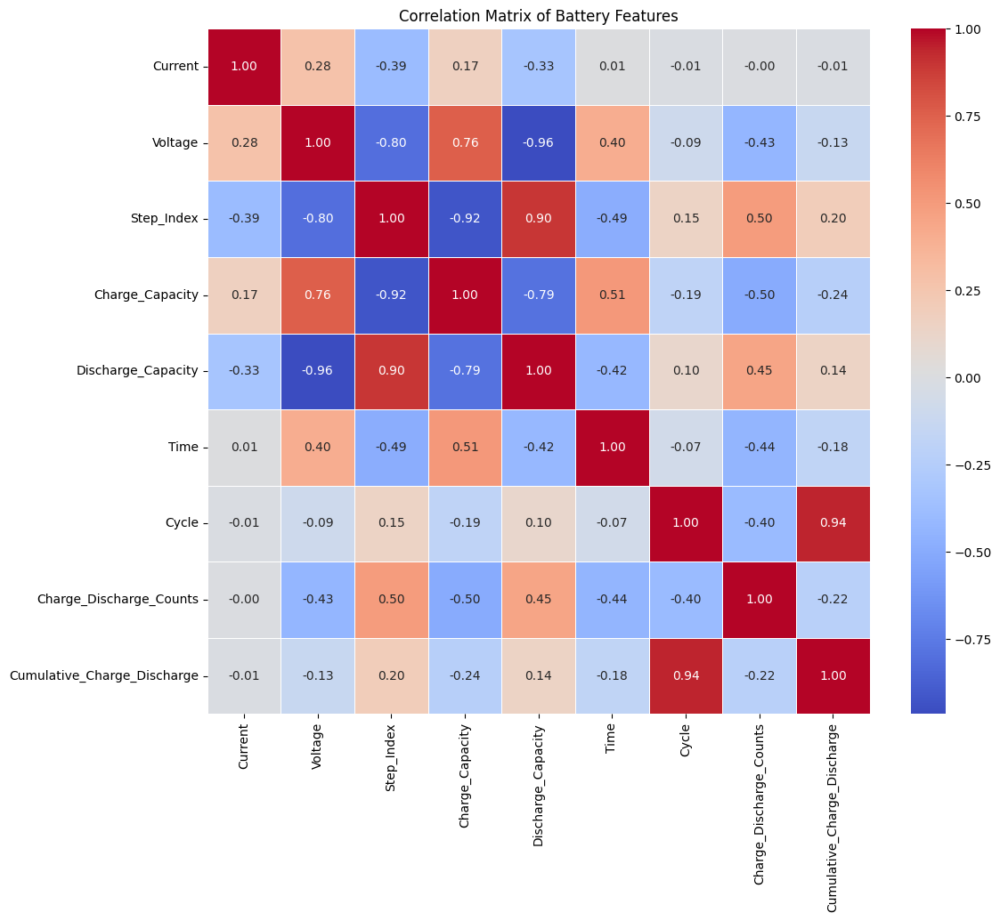

In [73]:
correlation_matrix = W9_combined_data_df_scaled.corr()

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Battery Features")
plt.show()

In [82]:
max_discharge_per_cycle_w9 = W9_combined_data_df.groupby('Cycle')['Discharge_Capacity'].max().reset_index()
max_discharge_per_cycle_w9.rename(columns={'Discharge_Capacity': 'Max_Discharge_Capacity'}, inplace=True)

# Merge with cumulative charge discharge data
cumulative_data_w9 = W9_combined_data_df[['Cycle', 'Cumulative_Charge_Discharge']].drop_duplicates()
data_w9 = max_discharge_per_cycle_w9.merge(cumulative_data_w9, on='Cycle')

In [84]:
# Features (X) and Target (y) for W9
X_w9 = data_w9[['Cumulative_Charge_Discharge']]
y_w9 = data_w9['Max_Discharge_Capacity']

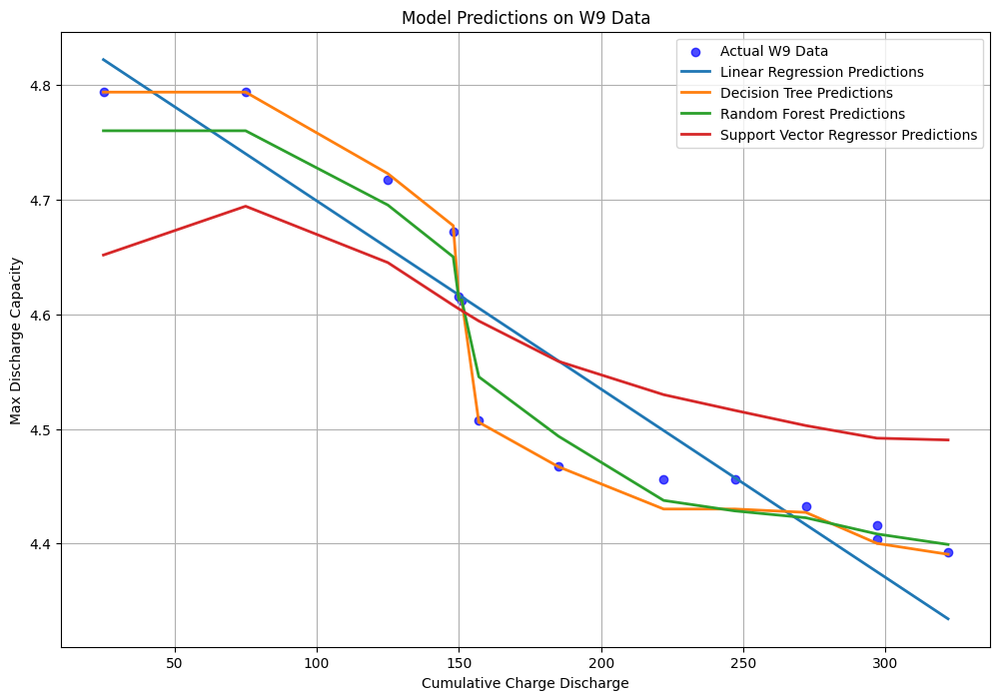

In [85]:
plt.figure(figsize=(12, 8))

# Scatter plot for actual W9 data
plt.scatter(X_w9, y_w9, color='blue', label='Actual W9 Data', alpha=0.7)

# Predictions for W9 Data
for name, model in models.items():
    y_pred_w9 = model.predict(X_w9)
    plt.plot(X_w9, y_pred_w9, label=f'{name} Predictions', linewidth=2)

# Graph Styling
plt.title('Model Predictions on W9 Data')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.legend()
plt.grid(True)
plt.show()

In [86]:

print("Model Evaluation on W9_combined_data_df:\n")
for name, model in models.items():
    y_pred_w9 = model.predict(X_w9)
    mae = mean_absolute_error(y_w9, y_pred_w9)
    mse = mean_squared_error(y_w9, y_pred_w9)
    r2 = r2_score(y_w9, y_pred_w9)
    print(f"{name}:\n MAE: {mae:.4f}, MSE: {mse:.4f}, R²: {r2:.4f}\n")

Model Evaluation on W9_combined_data_df:

Linear Regression:
 MAE: 0.0411, MSE: 0.0026, R²: 0.8689

Decision Tree:
 MAE: 0.0068, MSE: 0.0001, R²: 0.9938

Random Forest:
 MAE: 0.0180, MSE: 0.0005, R²: 0.9757

Support Vector Regressor:
 MAE: 0.0745, MSE: 0.0066, R²: 0.6620



In [87]:
# Display Actual vs Predicted for one of the models (e.g., Linear Regression)
model_name = 'Linear Regression'
y_pred_w9_lr = models['Linear Regression'].predict(X_w9)

results = pd.DataFrame({
    'Actual': y_w9,
    'Predicted': y_pred_w9_lr
}, index=data_w9['Cycle'])

print(f"Actual vs Predicted for {model_name} on W9 Data:\n")
print(results)

Actual vs Predicted for Linear Regression on W9 Data:

         Actual  Predicted
Cycle                     
1      4.793797   4.822266
2      4.717039   4.740116
3      4.672359   4.657965
4      4.615767   4.620176
5      4.612456   4.616890
6      4.507283   4.615247
7      4.467617   4.605389
8      4.455894   4.559385
9      4.455840   4.498594
10     4.432162   4.457519
11     4.416048   4.416443
12     4.404111   4.375368
13     4.392744   4.375368
14          NaN   4.334293


## running algorithms on W10 cell

Transferring the SOH model to W10 cell

In [ ]:
charge_discharge_counts = {
    1: 25,
    2: 50,
    3: 50,
    4: 23,
    5: 2,
    6: 1,
    7: 6,
    8: 28,
    9: 37,
    10: 25,
    11: 25,
    12: 25,
    14: 25
}

In [23]:
# Convert to DataFrame
W10_combined_data_df = pd.DataFrame(W10_combined_data)

# Map the charge-discharge counts to a new column
W10_combined_data_df['Charge_Discharge_Counts'] = W10_combined_data_df['Cycle'].map(charge_discharge_counts)

W10_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)

# Display the result
print(W10_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.117589           1         0.000000   
2          0.000000  3.117629           1         0.000000   
3          0.000000  3.117580           1         0.000000   
4          0.000000  3.117582           1         0.000000   
...             ...       ...         ...              ...   
223007884 -3.905632  3.315635          14         0.803516   
223007885 -3.907097  3.315074          14         0.803516   
223007886 -4.038940  3.311043          14         0.803516   
223007887 -4.100693  3.308866          14         0.803516   
223007888 -4.156906  3.307459          14         0.803516   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  
0                    0.000000       0.000000      1                     25.0  
1                    0.000000       0.100600      1                     25.0  
2                 

In [26]:
# Group by 'Cycle' and calculate cumulative charge-discharge
cycle_counts = W10_combined_data_df.groupby('Cycle')['Charge_Discharge_Counts'].first().reset_index()
cycle_counts['Cumulative_Charge_Discharge'] = cycle_counts['Charge_Discharge_Counts'].cumsum()

# Map the cumulative values back to the original DataFrame
W10_combined_data_df['Cumulative_Charge_Discharge'] = W10_combined_data_df['Cycle'].map(
    cycle_counts.set_index('Cycle')['Cumulative_Charge_Discharge']
)

# Display the updated DataFrame
print(W10_combined_data_df)

            Current   Voltage  Step_Index  Charge_Capacity  \
0          0.000000  0.000000           0         0.000000   
1          0.000000  3.117589           1         0.000000   
2          0.000000  3.117629           1         0.000000   
3          0.000000  3.117580           1         0.000000   
4          0.000000  3.117582           1         0.000000   
...             ...       ...         ...              ...   
223007884 -3.905632  3.315635          14         0.803516   
223007885 -3.907097  3.315074          14         0.803516   
223007886 -4.038940  3.311043          14         0.803516   
223007887 -4.100693  3.308866          14         0.803516   
223007888 -4.156906  3.307459          14         0.803516   

           Discharge_Capacity           Time  Cycle  Charge_Discharge_Counts  \
0                    0.000000       0.000000      1                     25.0   
1                    0.000000       0.100600      1                     25.0   
2              

In [27]:
W10_combined_data_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 223007889 entries, 0 to 223007888
Data columns (total 9 columns):
 #   Column                       Dtype  
---  ------                       -----  
 0   Current                      float64
 1   Voltage                      float64
 2   Step_Index                   int64  
 3   Charge_Capacity              float64
 4   Discharge_Capacity           float64
 5   Time                         float64
 6   Cycle                        int64  
 7   Charge_Discharge_Counts      float64
 8   Cumulative_Charge_Discharge  float64
dtypes: float64(7), int64(2)
memory usage: 15.0 GB


In [28]:
W10_combined_data_df['Charge_Discharge_Counts'].fillna(0, inplace=True)
W10_combined_data_df['Cumulative_Charge_Discharge'].fillna(0, inplace=True)


In [29]:
print(W10_combined_data_df.isnull().sum())


Current                        0
Voltage                        0
Step_Index                     0
Charge_Capacity                0
Discharge_Capacity             0
Time                           0
Cycle                          0
Charge_Discharge_Counts        0
Cumulative_Charge_Discharge    0
dtype: int64


In [30]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Select numerical columns
num_cols = ['Current', 'Voltage', 'Charge_Capacity', 'Discharge_Capacity','Charge_Discharge_Counts','Cumulative_Charge_Discharge']

# Apply scaling
W10_combined_data_df_scaled = W10_combined_data_df.copy()
W10_combined_data_df_scaled[num_cols] = scaler.fit_transform(W10_combined_data_df[num_cols])

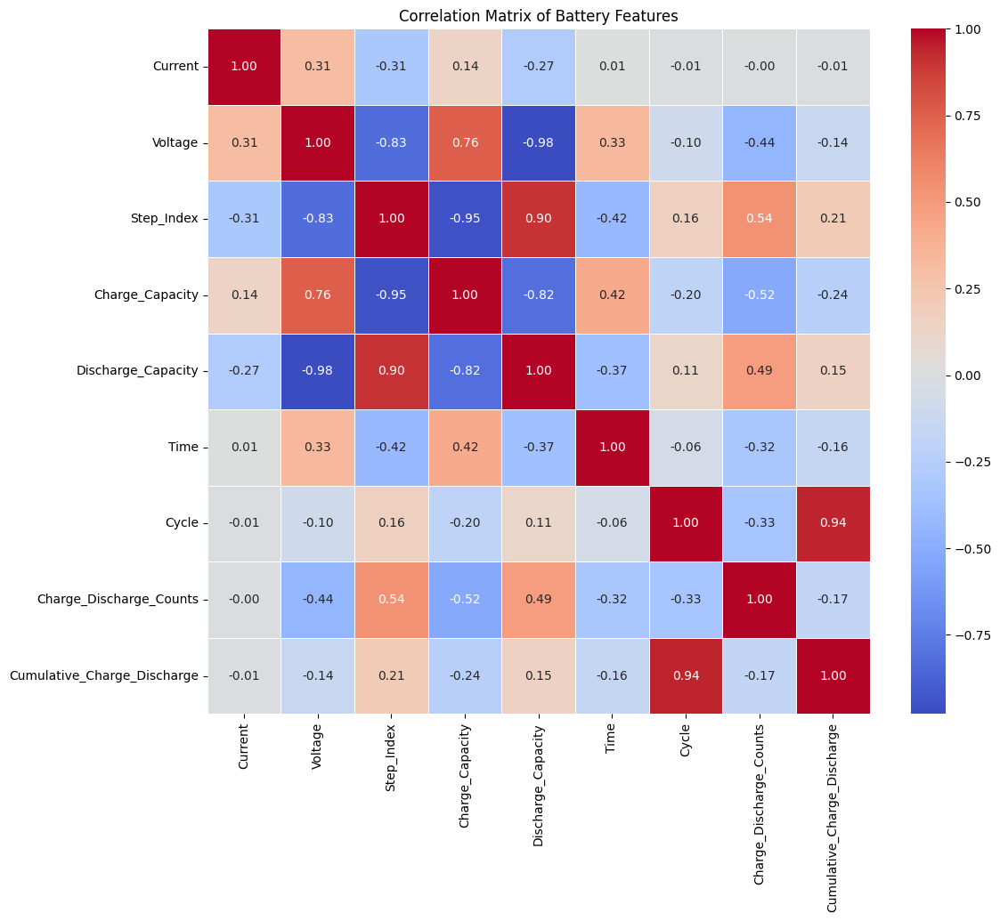

In [31]:
correlation_matrix = W10_combined_data_df_scaled.corr()

# Plot the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Matrix of Battery Features")
plt.show()

In [32]:
max_discharge_per_cycle_w10 = W10_combined_data_df.groupby('Cycle')['Discharge_Capacity'].max().reset_index()
max_discharge_per_cycle_w10.rename(columns={'Discharge_Capacity': 'Max_Discharge_Capacity'}, inplace=True)

# Merge with cumulative charge discharge data
cumulative_data_w10 = W10_combined_data_df[['Cycle', 'Cumulative_Charge_Discharge']].drop_duplicates()
data_w10 = max_discharge_per_cycle_w10.merge(cumulative_data_w10, on='Cycle')

In [33]:
# Features (X) and Target (y) for W9
X_w10 = data_w10[['Cumulative_Charge_Discharge']]
y_w10 = data_w10['Max_Discharge_Capacity']

c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but DecisionTreeRegressor was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but RandomForestRegressor was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but SVR was fitted without feature names
  warnings.warn(


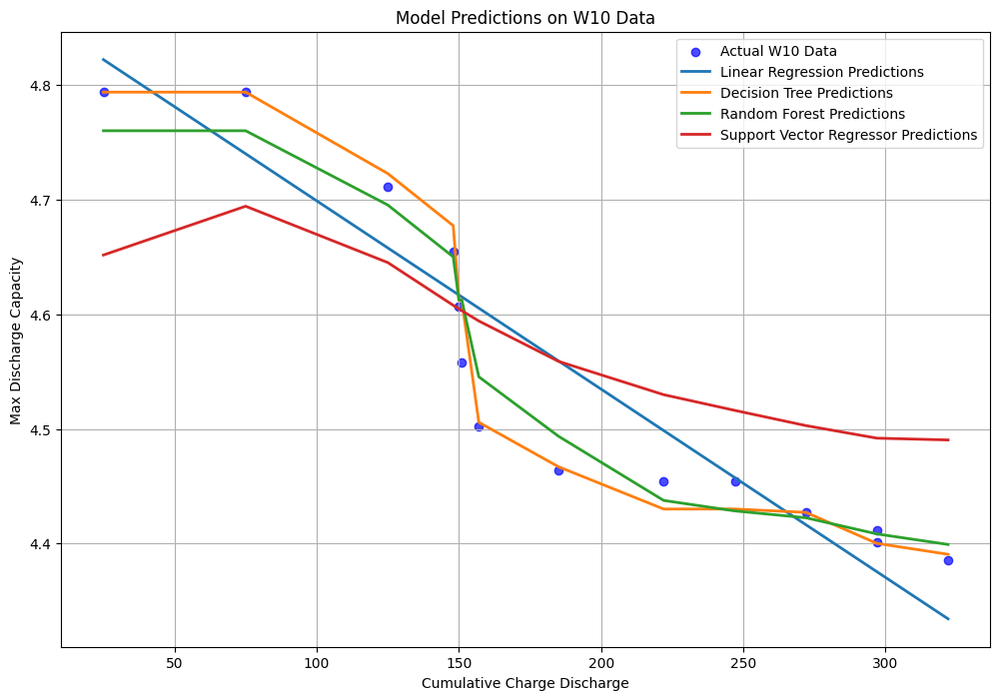

In [36]:
plt.figure(figsize=(12, 8))

# Scatter plot for actual W9 data
plt.scatter(X_w10, y_w10, color='blue', label='Actual W10 Data', alpha=0.7)

# Predictions for W9 Data
for name, model in models.items():
    y_pred_w10 = model.predict(X_w10)
    plt.plot(X_w10, y_pred_w10, label=f'{name} Predictions', linewidth=2)

# Graph Styling
plt.title('Model Predictions on W10 Data')
plt.xlabel('Cumulative Charge Discharge')
plt.ylabel('Max Discharge Capacity')
plt.legend()
plt.grid(True)
plt.show()

In [37]:

print("Model Evaluation on W10_combined_data_df:\n")
for name, model in models.items():
    y_pred_w10 = model.predict(X_w10)
    mae = mean_absolute_error(y_w10, y_pred_w10)
    mse = mean_squared_error(y_w10, y_pred_w10)
    r2 = r2_score(y_w10, y_pred_w10)
    print(f"{name}:\n MAE: {mae:.4f}, MSE: {mse:.4f}, R²: {r2:.4f}\n")

Model Evaluation on W10_combined_data_df:

Linear Regression:
 MAE: 0.0434, MSE: 0.0027, R²: 0.8609

Decision Tree:
 MAE: 0.0120, MSE: 0.0004, R²: 0.9815

Random Forest:
 MAE: 0.0209, MSE: 0.0007, R²: 0.9648

Support Vector Regressor:
 MAE: 0.0770, MSE: 0.0069, R²: 0.6401



c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but DecisionTreeRegressor was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but RandomForestRegressor was fitted without feature names
  warnings.warn(
c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but SVR was fitted without feature names
  warnings.warn(


In [44]:
# Display Actual vs Predicted for one of the models (e.g., Linear Regression)
model_name = 'Linear Regression'
y_pred_w10_lr = models['Linear Regression'].predict(X_w10)

results = pd.DataFrame({
    'Actual': y_w10,
    'Predicted': y_pred_w10_lr
}, index=data_w10['Cycle'])

print(f"Actual vs Predicted for {model_name} on W10 Data:\n")
print(results)

Actual vs Predicted for Linear Regression on W10 Data:

         Actual  Predicted
Cycle                     
1      4.793826   4.822266
2      4.711022   4.740116
3      4.654922   4.657965
4      4.606792   4.620176
5      4.557842   4.616890
6      4.501863   4.615247
7      4.464314   4.605389
8      4.453989   4.559385
9      4.453984   4.498594
10     4.427103   4.457519
11     4.411997   4.416443
12     4.401192   4.375368
13     4.385215   4.375368
14          NaN   4.334293


c:\Users\ymuba\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\validation.py:2732: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(
